In [2]:
import gc
import math
import os
import random
import warnings
from copy import deepcopy
from itertools import chain
from pathlib import Path
from time import sleep
from timeit import default_timer as timer

import albumentations as A
import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pvlib
import pywt
import requests
import segmentation_models_pytorch as smp
import torch
import torch.nn.functional as F
import torch.optim as optim
import torchmetrics
import torchvision.transforms.functional as TF
from IPython.display import clear_output
from patchify import patchify, unpatchify
from PIL import Image
from scipy.interpolate import RectBivariateSpline
from segmentation_models_pytorch import utils
from segmentation_models_pytorch.encoders import get_preprocessing_fn
from skimage.transform import resize as interp_resize
from sklearn.metrics import jaccard_score
from torch import einsum, nn
from torch.autograd import Variable
from torch.optim.lr_scheduler import CosineAnnealingLR
from torch.utils.data import DataLoader, Dataset, sampler
from torcheval.metrics.functional import multiclass_f1_score
from torchvision import transforms
from tqdm import tqdm

%matplotlib inline
warnings.filterwarnings("ignore")
torch.version.cuda, np.version.version

('11.6', '1.23.5')

In [3]:
import kornia as K
from kornia.augmentation import (
    CenterCrop,
    ColorJiggle,
    ColorJitter,
    PadTo,
    RandomAffine,
    RandomBoxBlur,
    RandomBrightness,
    RandomChannelShuffle,
    RandomContrast,
    RandomCrop,
    RandomCutMixV2,
    RandomElasticTransform,
    RandomEqualize,
    RandomErasing,
    RandomFisheye,
    RandomGamma,
    RandomGaussianBlur,
    RandomGaussianNoise,
    RandomGrayscale,
    RandomHorizontalFlip,
    RandomHue,
    RandomInvert,
    RandomJigsaw,
    RandomMixUpV2,
    RandomMosaic,
    RandomMotionBlur,
    RandomPerspective,
    RandomPlanckianJitter,
    RandomPlasmaBrightness,
    RandomPlasmaContrast,
    RandomPlasmaShadow,
    RandomPosterize,
    RandomResizedCrop,
    RandomRGBShift,
    RandomRotation,
    RandomSaturation,
    RandomSharpness,
    RandomSolarize,
    RandomThinPlateSpline,
    RandomVerticalFlip,
)

In [4]:
np.set_printoptions(threshold=1e7)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [3]:
# import netCDF4
# import pyproj
# import rasterio
# from pyproj import Transformer
# from rasterio.warp import reproject, transform_bounds

In [5]:
def seed_everything(seed=42):
    random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False


seed_everything(seed=42)

In [6]:
def batch_to_img(xb, idx=0):
    img = np.array(xb.squeeze(0))
    # print(img.shape)
    return np.array(img.transpose((1, 2, 0)) * 255)


def transpose_patch(patch):
    tr = np.array(patch).astype(np.uint8).transpose((2, 0, 1))
    return tr


def predb_to_mask(predb, idx=0):
    # print(predb.shape)
    p = torch.functional.F.softmax(predb.squeeze(0), 0)
    # print('pred after softmax shape',p.shape)
    # print(p.size(),torch.sum(p))
    return p.argmax(0).cpu()


def inverse_normalize(tensor, mean, std, num_shannels=5):
    tensor = tensor.detach().cpu().numpy()
    # unnormalize the RGB channels
    for i in range(num_shannels):
        tensor[i] = (tensor[i] * std[i]) + mean[i]
    # clip values to [0, 1] range
    tensor = np.clip(tensor, 0, 1)
    # convert back to uint8
    tensor = (tensor * 255).astype(np.uint8)
    return tensor


def inverse_normalize(tensor, num_channels=4):
    tensor = tensor.detach().cpu().numpy()
    # mean = np.array([ 0.49229294,  0.49588543,  0.49063835,  0.46576926])
    # std = np.array([ 0.16798317,  0.18459238,  0.20358132,  0.17362903])
    mean = np.array(
        [
            0.33852508171973034,
            0.24417021384913798,
            0.28669938065445844,
            0.28669938065445844,
            0,
            0,
            0,
        ]
    )
    std = np.array(
        [
            0.1279431776589227,
            0.1279651689319862,
            0.14410499167422117,
            0.14410499167422117,
            1,
            1,
            1,
        ]
    )
    # unnormalize the RGB channels
    for i in range(num_channels):
        tensor[i] = (tensor[i] * std[i]) + mean[i]
    # clip values to [0, 1] range
    tensor = np.clip(tensor, 0, 1)
    return tensor


def open_sample_as_pil(datacube):
    inversed_rgb = inverse_normalize(datacube[0:4], num_channels=4)
    rgb = (
        np.dstack((inversed_rgb[2, :, :], inversed_rgb[1, :, :], inversed_rgb[0, :, :]))
        * 255
    )
    return rgb.astype("uint8")


def open_sample_as_pil_no_norm(datacube):
    #     for i in range(12):
    #         print(np.max(datacube[i,:,:].numpy()))
    inversed_rgb = datacube[0:3]
    rgb = (
        np.dstack((inversed_rgb[2, :, :], inversed_rgb[1, :, :], inversed_rgb[0, :, :]))
        * 255
    )
    return rgb.astype("uint8")


def open_DEM(datacube):
    dem_arr = datacube[5]  # *255
    return dem_arr.numpy()  # .astype('uint8')


def open_mask_as_pil(seglabel):
    mask = seglabel.numpy()
    return mask

### UNZIP LEVIR_CS

In [1]:
# import zipfile
# path_to_zip_file1 = 'test_clean.zip'
# path_to_zip_file2 = 'train_clean.zip'
# with zipfile.ZipFile(path_to_zip_file1, 'r') as zip_ref:
#     zip_ref.extractall()
# with zipfile.ZipFile(path_to_zip_file2, 'r') as zip_ref:
#     zip_ref.extractall()

**USE RASTERIO or GDAL TO OPEN MULTISPECTRAL IMAGE IN GEOTIF**

**LETS TRY TO PARSE LEVIR_CS DATASET**

## REPRODUCE LEVIR_CS DATASET & TRAIN PIPELINE

In [7]:
import rasterio


def maskToTensor(img):
    return torch.from_numpy(np.array(img, dtype=np.int32)).long()


def toTensor(pic):
    if isinstance(pic, np.ndarray):
        # handle numpy array
        # print pic.shape
        pic = pic.transpose((2, 0, 1))
        # print pic.shape

        img = torch.from_numpy(pic.astype("float32"))
        # backward compatibility
        # for 8 bit images
        # return img.float().div(255.0)
        # for 16 bit images
        # return img.float().div(255.0)
        return img.float()


class LevirCS_MSS_CloudSnowDatasetV3(object):
    # image: mss 16 bit
    # label: 0,1 8 bit
    def __init__(
        self,
        TxtPath,
        rootPath="",
        joint_transform=None,
        image_transform=None,
        include_dem=True,
        include_lonlat=True,
        mode="train",
    ):
        self.TxtPath = TxtPath
        txtFile = open(self.TxtPath, "r")
        self.mode = mode
        # WE SHOULD USE THE SAME MEAN, STD FOR TRAIN AND TEST DATA To AVOID DATA LEAKAGE AND OVERFITTING!!!
        # self.mean = np.array([ 0.49229294,  0.49588543,  0.49063835,  0.46576926, 0,    0 ,0  ])
        self.std = np.array([0.16798317, 0.18459238, 0.20358132, 0.17362903, 1, 1, 1])
        self.mean = [257.0 / 1024.0, 268.0 / 1024.0, 276.0 / 1024.0, 238.0 / 1024.0]
        self.imgPath = []
        self.demPath = []
        self.seglabelPath = []
        self.lonlatPath = []
        self.include_lonlat = include_lonlat
        self.include_dem = include_dem
        self.joint_transform = joint_transform
        self.image_transform = image_transform
        print("loading data paths......")
        while 1:
            line = txtFile.readline()
            if not line:
                break
            if self.mode == "train":
                (imgPath_s, demPath_s, seglabelPath_s) = line.split()
                lonlatPath_s = imgPath_s[:-8] + "lonlat.tiff"
                lonlatPath_s = lonlatPath_s.replace("mss", "lonlat")
                self.imgPath.append(rootPath + imgPath_s)
                self.demPath.append(rootPath + demPath_s)
                self.seglabelPath.append(rootPath + seglabelPath_s)
                self.lonlatPath.append(rootPath + lonlatPath_s)
            else:
                (imgPath_s, demPath_s) = line.split()
                seglabelPath_s = imgPath_s.replace("mss.tiff", "roiMap.tif")
                lonlatPath_s = imgPath_s[:-8] + "lonlat.tiff"
                lonlatPath_s = lonlatPath_s.replace("mss", "lonlat")
                self.imgPath.append(rootPath + imgPath_s)
                self.demPath.append(rootPath + demPath_s)
                self.seglabelPath.append(rootPath + seglabelPath_s)
                self.lonlatPath.append(rootPath + lonlatPath_s)

        print("loading data paths finished......")

    def get_file_name(self, index):
        imgPath_s = self.imgPath[index]
        lonlatPath_s = imgPath_s[:-8] + "lonlat.tiff"
        lonlatPath_s = lonlatPath_s.replace("mss", "lonlat")
        return lonlatPath_s

    def __getitem__(self, index):
        imgPath_s = self.imgPath[index]
        demPath_s = self.demPath[index]
        lonlatPath_s = self.lonlatPath[index]
        seglabelPath_s = self.seglabelPath[index]
        imgDataset =  rasterio.open(imgPath_s)
        imgGeotransform = imgDataset.transform
        tmp = imgDataset.read(1)
        band1 = imgDataset.read(1)  # /1024.0
        band2 = imgDataset.read(2)  # /1024.0
        band3 = imgDataset.read(3)  # /1024.0
        band4 = imgDataset.read(4)  # /1024.0
    
        datacube = np.zeros((tmp.shape[0], tmp.shape[1], 7)).astype("float32")
        datacube[:, :, 0] = band1.copy()
        datacube[:, :, 1] = band2.copy()
        datacube[:, :, 2] = band3.copy()
        datacube[:, :, 3] = band4.copy()
        # USE clipping to avoid bad pixel values>1023 which are invalid
        for i in range(0, int(datacube.shape[-1])):
            datacube[:, :, i] = (datacube[:, :, i] > 1023) * 1023 + (
                datacube[:, :, i] <= 1023
            ) * datacube[:, :, i]
        for i in range(0, int(datacube.shape[-1])):
            datacube[:, :, i] = (datacube[:, :, i]) / 1023.0
        # append DEM
        if self.include_dem:
            demDataset = rasterio.open(demPath_s)
            tmp = rasterio.open(demPath_s)
            dem = ((demDataset.read(1)).astype("float32")) / 10000.0
            datacube[:,:,4] = dem
            demDataset = None
        # append lon and lat arrays to datacube
        if self.include_lonlat:
            lonlat_arr = np.load(lonlatPath_s + ".npy")
            lon_arr, lat_arr = lonlat_arr[0], lonlat_arr[1]
            if self.mode != "train":
                lon_arr, lat_arr = (lon_arr + 180.0) / 360.0, (lat_arr + 90.0) / 180.0
            datacube[:,:,5] = lon_arr
            datacube[:,:,6] = lat_arr
        # OPEN MASK
        seglabel = (np.array(cv2.imread(seglabelPath_s, 0)) // 127.0).astype("uint8")
        if self.joint_transform is not None:
            datacube, seglabel = self.joint_transform(datacube, seglabel)
            # print(datacube.shape, seglabel.shape)
        # then transform the input image to tensor
        if self.image_transform is not None:
            datacube = self.image_transform(datacube)
        datacube = toTensor(datacube)
        seglabel = maskToTensor(seglabel)
        return datacube, seglabel

    def __len__(self):
        return len(self.seglabelPath)

In [8]:
train_Path = "train_levir_cloud_snow_dataset_version3.txt"
test_Path = "test_levir_cloud_snow_dataset_version3.txt"
Levir_CS_Dataset_train = LevirCS_MSS_CloudSnowDatasetV3(
    TxtPath=train_Path, mode="train"
)
Levir_CS_Dataset_test = LevirCS_MSS_CloudSnowDatasetV3(
    TxtPath=test_Path, mode="test")  # trainTxtPath
len(Levir_CS_Dataset_train), len(Levir_CS_Dataset_test)  # ,Levir_CS_Dataset[0].shape

loading data paths......
loading data paths finished......
loading data paths......
loading data paths finished......


(3068, 1100)

In [9]:
# check if both train and test lon lat arrays are normalized to [0,1]
x, y = Levir_CS_Dataset_train[0]
lon_tr, lat_tr = x[5], x[6]
xx, yy = Levir_CS_Dataset_test[0]
print(xx.shape)
lon_test, lat_test = xx[5], xx[6]
print(
    "lon lat rot train ranges:",
    lon_tr.flatten().min(),
    lon_tr.flatten().max(),
    lat_tr.flatten().min(),
    lat_tr.flatten().max(),
)
print(
    "lon lat rot test ranges:",
    lon_test.flatten().min(),
    lon_test.flatten().max(),
    lat_test.flatten().min(),
    lat_test.flatten().max(),
)

torch.Size([7, 1340, 1200])
lon lat rot train ranges: tensor(0.8856) tensor(0.8951) tensor(0.7490) tensor(0.7614)
lon lat rot test ranges: tensor(0.6644) tensor(0.6711) tensor(0.6658) tensor(0.6780)


**DEFINE A PIPELINE CLASS OF GEOMETRIC TRANSFORM ON GPU USING Kornia**

In [9]:
import kornia as K
from kornia.augmentation.container import AugmentationSequential


class Geom_Augmentation(nn.Module):
    def __init__(self):
        super(Geom_Augmentation, self).__init__()
        # we define and cache our operators as class members
        # NEED TO UNDERSTAND GEOM AUGS PARAMS To MAKE IT ACCEPTABLE!
        self.augs = AugmentationSequential(
            RandomVerticalFlip(p=1),
            RandomHorizontalFlip(p=1),
            RandomPerspective(0.5, p=1.0),
            RandomAffine(
                (-80.0, 80.0),
                (0, 0.1),
                (1, 1.71),
                resample="nearest",
                padding_mode="reflection",
                align_corners=True,
                same_on_batch=False,
                keepdim=True,
                p=1,
            ),
            RandomElasticTransform(
                kernel_size=(33, 33),
                sigma=(6.0, 6.0),
                alpha=(1.0, 1.0),
                align_corners=True,
                resample="nearest",
                padding_mode="reflection",
                same_on_batch=False,
                p=1.0,
                keepdim=True,
            ),
            data_keys=["input", "mask"],
            same_on_batch=False,
            random_apply=2,
        )

    def forward(self, img: torch.Tensor, mask: torch.Tensor) -> torch.Tensor:
        # 1. apply color only in image
        # 2. apply geometric tranform
        out = self.augs(img, mask)
        img_out, mask_out = out[0], out[1]
        return img_out, mask_out


geom_augs = Geom_Augmentation()

## GEOINFONET ARCHITECTURE

In [10]:
class _DenseLayer(nn.Sequential):
    def __init__(self, num_input_features, growth_rate, bn_size, drop_rate):
        super(_DenseLayer, self).__init__()
        self.add_module("norm1", nn.BatchNorm2d(num_input_features)),
        self.add_module("relu1", nn.ReLU(inplace=True)),
        self.add_module(
            "conv1",
            nn.Conv2d(
                num_input_features,
                bn_size * growth_rate,
                kernel_size=1,
                stride=1,
                bias=False,
            ),
        ),
        self.add_module("norm2", nn.BatchNorm2d(bn_size * growth_rate)),
        self.add_module("relu2", nn.ReLU(inplace=True)),
        self.add_module(
            "conv2",
            nn.Conv2d(
                bn_size * growth_rate,
                growth_rate,
                kernel_size=3,
                stride=1,
                padding=1,
                bias=False,
            ),
        ),
        self.drop_rate = drop_rate

    def forward(self, x):
        new_features = super(_DenseLayer, self).forward(x)
        if self.drop_rate > 0:
            new_features = F.dropout(
                new_features, p=self.drop_rate, training=self.training
            )
        return torch.cat([x, new_features], 1)


class _DenseBlock(nn.Sequential):
    def __init__(self, num_layers, num_input_features, bn_size, growth_rate, drop_rate):
        super(_DenseBlock, self).__init__()
        for i in range(num_layers):
            layer = _DenseLayer(
                num_input_features + i * growth_rate, growth_rate, bn_size, drop_rate
            )
            self.add_module("denselayer%d" % (i + 1), layer)


class _Transition(nn.Sequential):
    def __init__(self, num_input_features, num_output_features):
        super(_Transition, self).__init__()
        self.add_module("norm", nn.BatchNorm2d(num_input_features))
        self.add_module("relu", nn.ReLU(inplace=True))
        self.add_module(
            "conv",
            nn.Conv2d(
                num_input_features,
                num_output_features,
                kernel_size=1,
                stride=1,
                bias=False,
            ),
        )
        self.add_module("pool", nn.AvgPool2d(kernel_size=2, stride=2))


class GIN(nn.Module):
    r"""Densenet-BC model class, based on
    `"Densely Connected Convolutional Networks" <https://arxiv.org/pdf/1608.06993.pdf>`_

    Args:
        growth_rate (int) - how many filters to add each layer (`k` in paper)
        block_config (list of 4 ints) - how many layers in each pooling block
        num_init_features (int) - the number of filters to learn in the first convolution layer
        bn_size (int) - multiplicative factor for number of bottle neck layers
          (i.e. bn_size * k features in the bottleneck layer)
        drop_rate (float) - dropout rate after each dense layer
        num_classes (int) - number of classification classes
    """

    # def __init__(self, growth_rate=32, block_config=(6, 12, 24, 16),
    #              num_init_features=64, bn_size=4, drop_rate=0, num_classes=1000):
    def __init__(self):
        # growth_rate=32, block_config=(6, 12, 24, 16),
        # num_init_features=64, bn_size=4, drop_rate=0, num_classes=1000
        # num_init_features=64, growth_rate=32, block_config=(6, 12, 32, 32)
        super(GIN, self).__init__()

        # First convolution

        self.conv0 = nn.Conv2d(4, 64, kernel_size=7, stride=1, padding=3, bias=False)
        self.norm0 = nn.BatchNorm2d(64)
        self.relu0 = nn.ReLU(inplace=True)
        self.conv0_feat = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.pool0 = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        # Each denseblock
        self.denseblock1 = _DenseBlock(
            num_layers=6, num_input_features=64, bn_size=4, growth_rate=32, drop_rate=0
        )
        self.dense1_feat = nn.Conv2d(256, 64, kernel_size=3, padding=1)
        self.transition1 = _Transition(num_input_features=256, num_output_features=128)
        self.denseblock2 = _DenseBlock(
            num_layers=12,
            num_input_features=128,
            bn_size=4,
            growth_rate=32,
            drop_rate=0,
        )
        self.dense2_feat = nn.Conv2d(512, 64, kernel_size=3, padding=1)
        self.transition2 = _Transition(num_input_features=512, num_output_features=256)
        self.denseblock3 = _DenseBlock(
            num_layers=32,
            num_input_features=256,
            bn_size=4,
            growth_rate=32,
            drop_rate=0,
        )
        self.dense3_feat = nn.Conv2d(1280, 64, kernel_size=3, padding=1)
        self.transition3 = _Transition(num_input_features=1280, num_output_features=640)
        self.denseblock4 = _DenseBlock(
            num_layers=32,
            num_input_features=640,
            bn_size=4,
            growth_rate=32,
            drop_rate=0,
        )
        self.dense4_feat = nn.Conv2d(1664, 64, kernel_size=3, padding=1)

        self.conv0_aux = nn.Conv2d(
            3, 64, kernel_size=7, stride=1, padding=3, bias=False
        )
        self.norm0_aux = nn.BatchNorm2d(64)
        self.relu0_aux = nn.ReLU(inplace=True)
        self.conv0_feat_aux = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.pool0_aux = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        # Each denseblock
        self.denseblock1_aux = _DenseBlock(
            num_layers=6, num_input_features=64, bn_size=4, growth_rate=32, drop_rate=0
        )
        self.dense1_feat_aux = nn.Conv2d(256, 64, kernel_size=3, padding=1)
        self.transition1_aux = _Transition(
            num_input_features=256, num_output_features=128
        )
        self.denseblock2_aux = _DenseBlock(
            num_layers=12,
            num_input_features=128,
            bn_size=4,
            growth_rate=32,
            drop_rate=0,
        )
        self.dense2_feat_aux = nn.Conv2d(512, 64, kernel_size=3, padding=1)
        self.transition2_aux = _Transition(
            num_input_features=512, num_output_features=256
        )
        self.denseblock3_aux = _DenseBlock(
            num_layers=32,
            num_input_features=256,
            bn_size=4,
            growth_rate=32,
            drop_rate=0,
        )
        self.dense3_feat_aux = nn.Conv2d(1280, 64, kernel_size=3, padding=1)
        self.transition3_aux = _Transition(
            num_input_features=1280, num_output_features=640
        )
        self.denseblock4_aux = _DenseBlock(
            num_layers=32,
            num_input_features=640,
            bn_size=4,
            growth_rate=32,
            drop_rate=0,
        )
        self.dense4_feat_aux = nn.Conv2d(1664, 64, kernel_size=3, padding=1)

        self.score = nn.Conv2d(640, 3, kernel_size=1, padding=0)

        # no transition4
        # self.transition4 = _Transition(num_input_features=1664, num_output_features=832)

        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight.data)
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()

    def forward(self, x):
        # inputTensor:
        # batch channel height width
        # img channel 0-3
        # dem channel 4
        # geo channel 5-6
        # time channel 7
        imageSize = x.shape[2:]

        img = x[:, :4, :, :]

        aux = x[:, 4:, :, :]

        img = self.conv0(img)
        img = self.norm0(img)
        img = self.relu0(img)
        img0 = self.conv0_feat(img)
        img0_upsample = F.interpolate(
            img0, size=imageSize, mode="bilinear", align_corners=True
        )

        img = self.pool0(img)
        img = self.denseblock1(img)
        img1 = self.dense1_feat(img)
        img1_upsample = F.interpolate(
            img1, size=imageSize, mode="bilinear", align_corners=True
        )
        img = self.transition1(img)

        img = self.denseblock2(img)
        img2 = self.dense2_feat(img)
        img2_upsample = F.interpolate(
            img2, size=imageSize, mode="bilinear", align_corners=True
        )
        img = self.transition2(img)

        img = self.denseblock3(img)
        img3 = self.dense3_feat(img)
        img3_upsample = F.interpolate(
            img3, size=imageSize, mode="bilinear", align_corners=True
        )
        img = self.transition3(img)

        img = self.denseblock4(img)
        img4 = self.dense4_feat(img)
        img4_upsample = F.interpolate(
            img4, size=imageSize, mode="bilinear", align_corners=True
        )

        aux = self.conv0_aux(aux)
        aux = self.norm0_aux(aux)
        aux = self.relu0_aux(aux)
        aux0 = self.conv0_feat_aux(aux)
        aux0_upsample = F.interpolate(
            aux0, size=imageSize, mode="bilinear", align_corners=True
        )

        aux = self.pool0_aux(aux)
        aux = self.denseblock1_aux(aux)
        aux1 = self.dense1_feat_aux(aux)
        aux1_upsample = F.interpolate(
            aux1, size=imageSize, mode="bilinear", align_corners=True
        )
        aux = self.transition1_aux(aux)

        aux = self.denseblock2_aux(aux)
        aux2 = self.dense2_feat_aux(aux)
        aux2_upsample = F.interpolate(
            aux2, size=imageSize, mode="bilinear", align_corners=True
        )
        aux = self.transition2_aux(aux)

        aux = self.denseblock3_aux(aux)
        aux3 = self.dense3_feat_aux(aux)
        aux3_upsample = F.interpolate(
            aux3, size=imageSize, mode="bilinear", align_corners=True
        )
        aux = self.transition3_aux(aux)

        aux = self.denseblock4_aux(aux)
        aux4 = self.dense4_feat_aux(aux)
        aux4_upsample = F.interpolate(
            aux4, size=imageSize, mode="bilinear", align_corners=True
        )

        x_final = self.score(
            torch.cat(
                (
                    img0_upsample,
                    img1_upsample,
                    img2_upsample,
                    img3_upsample,
                    img4_upsample,
                    aux0_upsample,
                    aux1_upsample,
                    aux2_upsample,
                    aux3_upsample,
                    aux4_upsample,
                ),
                1,
            )
        )

        self.coreHeight = x_final.shape[2]
        self.coreWidth = x_final.shape[3]

        return x_final


def gin(
    is_transfer=False,
    curr_epoch=2,
    snapshotInitPath="/home/c307/pytorch_learning/multitask_task_learning_cloud/model/vgg16_bn.pth",
    **kwargs
):
    r"""Densenet-169 model from
    `"Densely Connected Convolutional Networks" <https://arxiv.org/pdf/1608.06993.pdf>`_

    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
    """
    model = GIN(**kwargs)
    if is_transfer == False:
        # print('Training from start ......')
        curr_epoch = 1
    elif curr_epoch == 1:
        print("Training from resumed pths ......")
        net_dict = model.state_dict()
        pretrained_dict = torch.load(snapshotInitPath)

        conv1Weight = pretrained_dict["features.conv0.weight"].detach().numpy()
        if conv1Weight.shape[1] == 4:
            pass
        elif conv1Weight.shape[1] == 3:
            newConv1Weight = np.zeros(
                (conv1Weight.shape[0], 4, conv1Weight.shape[2], conv1Weight.shape[3])
            )
            for i in range(0, conv1Weight.shape[0]):
                newConv1Weight[i, 0, :, :] = conv1Weight[i, 0, :, :]
                newConv1Weight[i, 1, :, :] = conv1Weight[i, 1, :, :]
                newConv1Weight[i, 2, :, :] = conv1Weight[i, 2, :, :]
                newConv1Weight[i, 3, :, :] = (
                    conv1Weight[i, 0, :, :] / 3.0
                    + conv1Weight[i, 1, :, :] / 3.0
                    + conv1Weight[i, 2, :, :] / 3.0
                )
            pretrained_dict["features.conv0.weight"] = torch.from_numpy(newConv1Weight)
        else:
            print("Error! Conv0.weight channel is not 3 or 4!\n")

        spStrings = ["norm1", "relu1", "conv1", "norm2", "relu2", "conv2"]
        for i in range(0, conv1Weight.shape[0]):
            net_dict["conv0_aux.weight"][i, 0, :, :] = pretrained_dict[
                "features.conv0.weight"
            ][i, 3, :, :]
            net_dict["conv0_aux.weight"][i, 1, :, :] = pretrained_dict[
                "features.conv0.weight"
            ][i, 3, :, :]
            net_dict["conv0_aux.weight"][i, 2, :, :] = pretrained_dict[
                "features.conv0.weight"
            ][i, 3, :, :]

        for target_net_key in net_dict.keys():
            # print target_net_key
            if target_net_key == "conv0_aux.weight":
                continue

            target_net_key_temp = target_net_key
            if target_net_key.find("_aux") != -1:
                start = target_net_key.find("_aux")
                target_net_key_temp = (
                    target_net_key[:start] + target_net_key[start + len("_aux") :]
                )

            target_net_key_pretrained = "features." + target_net_key_temp
            for spString in spStrings:
                if target_net_key_temp.find(spString) != -1:
                    dot = target_net_key_temp.rfind(".")
                    target_net_key_pretrained = (
                        "features."
                        + target_net_key_temp[: dot - 1]
                        + "."
                        + target_net_key_temp[dot - 1 : dot]
                        + "."
                        + target_net_key_temp[dot + 1 :]
                    )
                    break

            if target_net_key_pretrained in pretrained_dict.keys():
                net_dict[target_net_key] = pretrained_dict[target_net_key_pretrained]

        model.load_state_dict(net_dict)

    else:
        net_dict = model.state_dict()
        pretrained_dict = torch.load(snapshotInitPath)
        pretrained_dict = {k: v for k, v in pretrained_dict.items() if k in net_dict}
        net_dict.update(pretrained_dict)
        model.load_state_dict(net_dict)
    return model

In [10]:
GeoInfoNet = GIN()
bs = 1
inp_ch = 7
crop_size = 240
GeoInfoNet.eval()
GeoInfoNet.cuda()
x = torch.randn((bs, inp_ch, 440, 400), dtype = torch.float32).cuda()
out = GeoInfoNet(x)
out.shape

torch.Size([1, 3, 440, 400])

In [9]:
!nvidia-smi

Sat Jan 13 16:50:08 2024       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.223.02   Driver Version: 470.223.02   CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ...  Off  | 00000000:01:00.0 Off |                  N/A |
|  0%   40C    P8    16W / 170W |    143MiB / 12053MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## CODE FOR REPRODUCING LEVIR_CS GIN PIPELINE from Git

In [11]:
import datetime
import random
from tqdm.contrib.concurrent import process_map
import cv2 as cv
import dataTransfer as inputTransform
import dataTransferJoint as jointTransform
from misc import AverageMeter, BatchStat, check_mkdir

In [ ]:
# from tqdm.contrib.concurrent import process_map  # or thread_map
# import time

# def _foo(my_number):
#    square = my_number * my_number
#    time.sleep(1)
#    return square 

# if __name__ == '__main__':
#    r = process_map(_foo, range(0, 30), max_workers=2)

In [ ]:
args = {
    "train_batch_size": 4,
    "lr": 0.001,
    "lr_decay": 0.9,
    "crop_size": 240,  # wait for design
    "weight_decay": 1e-4,
    "momentum": 0.9,
    "display": 100,
    "max_epoch": 220,
    "max_iter": 200000,
    "snapshot": "gin",
    "snapshot_freq": 20000,
    "snapshotInitName": "densenet169.pth",
    "model_dir": "models/",
    "log_dir": "logs/",
    "exp_name": "gin",
    "is_transfer": True,
    "curr_epoch": 58,
    "trainTxtPath": "train_levir_cloud_snow_dataset_version3.txt",
}
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
device = torch.device("cuda:0")
###############################
def save_best_model(net, epoch, path="models/GIN_ep_"):
    model_copy = deepcopy(net)
    best_model = model_copy
    best_model_name = path + str(epoch) + '.pth'
    torch.save(best_model.state_dict(), best_model_name)
    print("best model is on epoch =", epoch)
    return best_model

def train(train_loader, net, criterion_cls, optimizer, curr_epoch, best_iou, train_args):
    for curr_epoch in tqdm(range(train_args["curr_epoch"],train_args["curr_epoch"]+train_args["max_epoch"])):
        main_loss_recoder = AverageMeter()
        cls_loss_recoder = AverageMeter()
        batch_stat = BatchStat()
        curr_iter = (curr_epoch - 1) * len(train_loader)
        ep_f1, ep_iou = torch.zeros(3), torch.zeros(3)
        for i, data in enumerate(train_loader):
            optimizer.param_groups[0]["lr"] = (
                train_args["lr"]
                * (1 - float(curr_iter) / train_args["max_iter"])
                ** train_args["lr_decay"]
            )
            inputs, gts_seg = data
            inputs = inputs.to(device)
            optimizer.zero_grad()
            outputs_cls = net(inputs)
            ############################
            output = torch.functional.F.softmax(outputs_cls, 1)
            predictions = output.argmax(dim=1).cuda()
            tp, fp, fn, tn = smp.metrics.get_stats(predictions.cuda(), gts_seg.cuda(), num_classes=3, mode="multiclass")
            iou_score_sep = smp.metrics.iou_score(tp, fp, fn, tn, reduction=None) 
            f1_score_sep = smp.metrics.f1_score(tp, fp, fn, tn, reduction=None)
            iou_score_sep = torch.sum(iou_score_sep, dim=0) / len(inputs)
            f1_score_sep = torch.sum(f1_score_sep, dim=0) / len(inputs)
            ep_f1, ep_iou = ep_f1 + f1_score_sep, ep_iou + iou_score_sep
            ##############################
            gts_seg = gts_seg.to(device)
            cls_loss = criterion_cls(outputs_cls, gts_seg)
            loss = cls_loss
            loss.backward()
            optimizer.step()
            main_loss_recoder.update(loss.data.cpu().numpy(), inputs.size(2) * inputs.size(3))
            batch_stat.stat_update(outputs_cls, gts_seg)
            curr_iter += 1
            if (i + 1) % train_args["display"] == 0:
                mainLossOutput = (
                    "[epoch %d], [iter %d / %d], [train main loss %.5f],  [lr %.10f]"
                    % (curr_epoch,
                        i + 1,
                        len(train_loader),
                        main_loss_recoder.avg,
                        optimizer.param_groups[0]["lr"],)
                )
                print(mainLossOutput)
                open(
                    os.path.join(
                        args["log_dir"], args["time"] + "_" + args["snapshot"] + ".txt"
                    ),
                    "a",
                ).write(mainLossOutput)
                batch_statOutput = (
                    "[iter %d] [f1 %.5f,%.5f,%.5f], [iou %.5f,%.5f,%.5f]\n"
                    % (i + 1,f1_score_sep[0],f1_score_sep[1],f1_score_sep[2],iou_score_sep[0],iou_score_sep[1],iou_score_sep[2],)
                )
                print(batch_statOutput)
                open(
                    os.path.join(
                        args["log_dir"], args["time"] + "_" + args["snapshot"] + ".txt"
                    ),
                    "a",
                ).write(batch_statOutput)
            if curr_iter >= train_args["max_iter"]:
                return
        ep_f1  = ep_f1 / (i+1)
        ep_iou = ep_iou / (i+1)
        ep_statOutput = "[epoch %d] [f1 %.5f,%.5f,%.5f], [iou %.5f,%.5f,%.5f]\n" % (
            curr_epoch,ep_f1[0],ep_f1[1], ep_f1[2],ep_iou[0],ep_iou[1],ep_iou[2],)
        print(ep_statOutput)
        if (ep_iou[1] > best_iou[1]) and (ep_iou[2] > best_iou[2]):
            best_iou = ep_iou
            save_best_model(net, curr_epoch)
    return
###############################
train_joint_transform = jointTransform.Compose(
    [
        jointTransform.RandomImgCrop(args["crop_size"]),  # imgcrop:h,w
        jointTransform.RotateTransform(),  # random 90
    ]
)
train_set = LevirCS_MSS_CloudSnowDatasetV3(
    TxtPath=args["trainTxtPath"],
    rootPath="",
    joint_transform=train_joint_transform,
    image_transform=None,
)
train_loader = DataLoader(train_set, batch_size=args["train_batch_size"], num_workers = 8, shuffle=True)
curr_epoch = args["curr_epoch"]

net = gin(
    is_transfer=args["is_transfer"],
    curr_epoch=args["curr_epoch"],
    snapshotInitPath=args["model_dir"] + args["snapshotInitName"],
).to(device)
net_name = "models/GIN_ep_57.pth"
net.load_state_dict(torch.load(net_name))
net.train()

criterion_cls = nn.CrossEntropyLoss()

optimizer = optim.SGD(
    net.parameters(),
    lr=args["lr"],
    weight_decay=args["weight_decay"],
    momentum=args["momentum"],
    nesterov=True,
)

check_mkdir(args["model_dir"])
check_mkdir(args["log_dir"])
best_iou = torch.tensor([0.93446,0.75843,0.89068])
args["time"] = str(datetime.datetime.now().timestamp())
open(
    os.path.join(args["log_dir"], args["time"] + "_" + args["snapshot"] + ".txt"), "a"
).write(str(args) + "\n\n")

train(train_loader, net, criterion_cls, optimizer, curr_epoch, best_iou, args)

loading data paths......
loading data paths finished......


  0%|          | 0/220 [00:00<?, ?it/s]

[epoch 58], [iter 100 / 767], [train main loss 0.07454],  [lr 0.0008004623]
[iter 100] [f1 0.98237,0.87200,0.75000], [iou 0.96607,0.79748,0.75000]

[epoch 58], [iter 200 / 767], [train main loss 0.07078],  [lr 0.0008000010]
[iter 200] [f1 0.98362,0.98361,0.95345], [iou 0.96808,0.96844,0.92152]

[epoch 58], [iter 300 / 767], [train main loss 0.06880],  [lr 0.0007995397]
[iter 300] [f1 0.96904,0.82215,0.97171], [iou 0.94056,0.76373,0.94917]

[epoch 58], [iter 400 / 767], [train main loss 0.07050],  [lr 0.0007990784]
[iter 400] [f1 0.99318,0.97647,1.00000], [iou 0.98667,0.95509,1.00000]

[epoch 58], [iter 500 / 767], [train main loss 0.06854],  [lr 0.0007986170]
[iter 500] [f1 0.97378,0.70902,1.00000], [iou 0.95174,0.67427,1.00000]

[epoch 58], [iter 600 / 767], [train main loss 0.06914],  [lr 0.0007981556]
[iter 600] [f1 0.74120,0.96419,0.75000], [iou 0.73291,0.93256,0.75000]

[epoch 58], [iter 700 / 767], [train main loss 0.07018],  [lr 0.0007976942]
[iter 700] [f1 0.61234,0.74255,1.000

  0%|          | 1/220 [11:59<43:46:06, 719.48s/it]

[epoch 58] [f1 0.95357,0.80822,0.89246], [iou 0.93272,0.76446,0.88552]

[epoch 59], [iter 100 / 767], [train main loss 0.09914],  [lr 0.0007969235]
[iter 100] [f1 0.99240,1.00000,0.98827], [iou 0.98524,1.00000,0.97759]

[epoch 59], [iter 200 / 767], [train main loss 0.08260],  [lr 0.0007964620]
[iter 200] [f1 0.99239,0.72360,0.96859], [iou 0.98498,0.69922,0.94419]

[epoch 59], [iter 300 / 767], [train main loss 0.07460],  [lr 0.0007960005]
[iter 300] [f1 0.98783,0.84123,1.00000], [iou 0.97659,0.76957,1.00000]

[epoch 59], [iter 400 / 767], [train main loss 0.07408],  [lr 0.0007955389]
[iter 400] [f1 0.99197,0.59620,0.64589], [iou 0.98434,0.48660,0.60299]

[epoch 59], [iter 500 / 767], [train main loss 0.07169],  [lr 0.0007950773]
[iter 500] [f1 0.96541,0.98787,0.95670], [iou 0.93757,0.97636,0.92619]

[epoch 59], [iter 600 / 767], [train main loss 0.07111],  [lr 0.0007946157]
[iter 600] [f1 0.89028,0.96654,0.92540], [iou 0.84221,0.93643,0.88509]

[epoch 59], [iter 700 / 767], [train mai

  1%|          | 2/220 [23:33<42:39:31, 704.46s/it]

[epoch 59] [f1 0.95423,0.80088,0.89318], [iou 0.93365,0.75736,0.88598]

[epoch 60], [iter 100 / 767], [train main loss 0.08320],  [lr 0.0007933830]
[iter 100] [f1 0.99393,0.98819,1.00000], [iou 0.98801,0.97693,1.00000]

[epoch 60], [iter 200 / 767], [train main loss 0.08068],  [lr 0.0007929212]
[iter 200] [f1 0.84538,0.71407,0.75000], [iou 0.79008,0.68358,0.75000]

[epoch 60], [iter 300 / 767], [train main loss 0.07320],  [lr 0.0007924595]
[iter 300] [f1 0.96956,0.93294,1.00000], [iou 0.94261,0.87819,1.00000]

[epoch 60], [iter 400 / 767], [train main loss 0.07172],  [lr 0.0007919977]
[iter 400] [f1 0.98229,0.81395,0.78374], [iou 0.96559,0.70424,0.76809]

[epoch 60], [iter 500 / 767], [train main loss 0.07147],  [lr 0.0007915359]
[iter 500] [f1 0.95648,0.53353,0.96862], [iou 0.91987,0.51745,0.94424]

[epoch 60], [iter 600 / 767], [train main loss 0.07025],  [lr 0.0007910740]
[iter 600] [f1 0.99117,0.92896,1.00000], [iou 0.98257,0.86923,1.00000]

[epoch 60], [iter 700 / 767], [train mai

  1%|▏         | 3/220 [35:09<42:14:37, 700.82s/it]

[epoch 60] [f1 0.95474,0.79992,0.91264], [iou 0.93377,0.75637,0.90547]

[epoch 61], [iter 100 / 767], [train main loss 0.08005],  [lr 0.0007898407]
[iter 100] [f1 0.97010,0.93179,0.98386], [iou 0.94391,0.88852,0.96968]

[epoch 61], [iter 200 / 767], [train main loss 0.07799],  [lr 0.0007893787]
[iter 200] [f1 0.99566,0.74250,1.00000], [iou 0.99143,0.73543,1.00000]

[epoch 61], [iter 300 / 767], [train main loss 0.07456],  [lr 0.0007889167]
[iter 300] [f1 0.99946,0.72823,0.75000], [iou 0.99893,0.70995,0.75000]

[epoch 61], [iter 400 / 767], [train main loss 0.07317],  [lr 0.0007884547]
[iter 400] [f1 0.94524,0.55928,1.00000], [iou 0.90623,0.49415,1.00000]

[epoch 61], [iter 500 / 767], [train main loss 0.07079],  [lr 0.0007879926]
[iter 500] [f1 0.97879,0.65469,1.00000], [iou 0.95934,0.58886,1.00000]

[epoch 61], [iter 600 / 767], [train main loss 0.07249],  [lr 0.0007875306]
[iter 600] [f1 0.97285,0.80193,0.75000], [iou 0.94970,0.69286,0.75000]

[epoch 61], [iter 700 / 767], [train mai

  2%|▏         | 4/220 [46:46<41:56:38, 699.07s/it]

[epoch 61] [f1 0.95306,0.81375,0.89543], [iou 0.93191,0.76939,0.88840]

[epoch 62], [iter 100 / 767], [train main loss 0.07346],  [lr 0.0007862966]
[iter 100] [f1 0.89064,0.92639,0.97154], [iou 0.83392,0.87101,0.94890]

[epoch 62], [iter 200 / 767], [train main loss 0.06501],  [lr 0.0007858344]
[iter 200] [f1 0.99431,0.94526,1.00000], [iou 0.98873,0.89825,1.00000]

[epoch 62], [iter 300 / 767], [train main loss 0.06414],  [lr 0.0007853722]
[iter 300] [f1 0.99828,0.88722,1.00000], [iou 0.99656,0.82609,1.00000]

[epoch 62], [iter 400 / 767], [train main loss 0.06440],  [lr 0.0007849099]
[iter 400] [f1 0.99917,0.48795,1.00000], [iou 0.99834,0.47701,1.00000]

[epoch 62], [iter 500 / 767], [train main loss 0.06722],  [lr 0.0007844477]
[iter 500] [f1 0.99354,0.90558,1.00000], [iou 0.98731,0.84678,1.00000]

[epoch 62], [iter 600 / 767], [train main loss 0.06633],  [lr 0.0007839853]
[iter 600] [f1 0.95582,0.60656,0.97586], [iou 0.92253,0.53817,0.95598]

[epoch 62], [iter 700 / 767], [train mai

  2%|▏         | 5/220 [58:23<41:42:56, 698.49s/it]

best model is on epoch = 62
[epoch 63], [iter 100 / 767], [train main loss 0.06776],  [lr 0.0007827508]
[iter 100] [f1 0.99343,0.75856,0.75000], [iou 0.98704,0.67778,0.75000]

[epoch 63], [iter 200 / 767], [train main loss 0.07040],  [lr 0.0007822884]
[iter 200] [f1 0.82285,0.68258,0.73666], [iou 0.76433,0.62904,0.72467]

[epoch 63], [iter 400 / 767], [train main loss 0.06701],  [lr 0.0007813634]
[iter 400] [f1 0.99041,0.97832,1.00000], [iou 0.98152,0.95869,1.00000]

[epoch 63], [iter 500 / 767], [train main loss 0.06504],  [lr 0.0007809009]
[iter 500] [f1 0.95668,0.96556,0.75000], [iou 0.92009,0.93554,0.75000]

[epoch 63], [iter 600 / 767], [train main loss 0.06883],  [lr 0.0007804383]
[iter 600] [f1 0.85308,0.69101,0.75000], [iou 0.80055,0.64989,0.75000]

[epoch 63], [iter 700 / 767], [train main loss 0.06835],  [lr 0.0007799758]
[iter 700] [f1 0.89254,0.70394,0.84847], [iou 0.84372,0.66582,0.81131]



  3%|▎         | 6/220 [1:10:01<41:30:16, 698.21s/it]

[epoch 63] [f1 0.95621,0.81705,0.90157], [iou 0.93542,0.77464,0.89442]

[epoch 64], [iter 100 / 767], [train main loss 0.06166],  [lr 0.0007792032]
[iter 100] [f1 0.98843,0.71319,0.97245], [iou 0.97736,0.68032,0.95037]

[epoch 64], [iter 200 / 767], [train main loss 0.06692],  [lr 0.0007787405]
[iter 200] [f1 0.99887,0.73033,0.99059], [iou 0.99774,0.71353,0.98186]

[epoch 64], [iter 300 / 767], [train main loss 0.06449],  [lr 0.0007782778]
[iter 300] [f1 0.98335,0.63812,0.75000], [iou 0.96857,0.57815,0.75000]

[epoch 64], [iter 400 / 767], [train main loss 0.06742],  [lr 0.0007778151]
[iter 400] [f1 0.69592,0.95334,0.75000], [iou 0.65899,0.91425,0.75000]

[epoch 64], [iter 500 / 767], [train main loss 0.07278],  [lr 0.0007773523]
[iter 500] [f1 0.99659,0.98679,1.00000], [iou 0.99323,0.97431,1.00000]

[epoch 64], [iter 600 / 767], [train main loss 0.07168],  [lr 0.0007768896]
[iter 600] [f1 0.81448,0.85961,1.00000], [iou 0.75104,0.78496,1.00000]

[epoch 64], [iter 700 / 767], [train mai

  3%|▎         | 7/220 [1:21:35<41:14:02, 696.91s/it]

[epoch 64] [f1 0.95526,0.80084,0.90827], [iou 0.93372,0.75722,0.90140]

[epoch 65], [iter 100 / 767], [train main loss 0.05937],  [lr 0.0007756538]
[iter 100] [f1 0.99845,0.69605,0.75000], [iou 0.99691,0.65324,0.75000]

[epoch 65], [iter 200 / 767], [train main loss 0.06444],  [lr 0.0007751909]
[iter 200] [f1 0.96582,0.54010,0.98915], [iou 0.93754,0.52180,0.97920]

[epoch 65], [iter 300 / 767], [train main loss 0.06641],  [lr 0.0007747279]
[iter 300] [f1 0.97925,0.75231,1.00000], [iou 0.96030,0.64172,1.00000]

[epoch 65], [iter 400 / 767], [train main loss 0.07216],  [lr 0.0007742650]
[iter 400] [f1 0.93151,0.73109,0.96407], [iou 0.89128,0.71484,0.93717]

[epoch 65], [iter 500 / 767], [train main loss 0.07174],  [lr 0.0007738020]
[iter 500] [f1 0.99493,0.97019,0.98091], [iou 0.98998,0.94421,0.96453]

[epoch 65], [iter 600 / 767], [train main loss 0.07006],  [lr 0.0007733390]
[iter 600] [f1 0.82901,0.95254,1.00000], [iou 0.74467,0.91844,1.00000]

[epoch 65], [iter 700 / 767], [train mai

  4%|▎         | 8/220 [1:33:08<40:58:05, 695.69s/it]

[epoch 65] [f1 0.95300,0.81745,0.89486], [iou 0.93217,0.77523,0.88791]

[epoch 66], [iter 100 / 767], [train main loss 0.06649],  [lr 0.0007721025]
[iter 100] [f1 0.96782,0.81783,1.00000], [iou 0.93922,0.76524,1.00000]

[epoch 66], [iter 200 / 767], [train main loss 0.06804],  [lr 0.0007716394]
[iter 200] [f1 0.96237,0.71782,0.96020], [iou 0.93075,0.68987,0.93132]

[epoch 66], [iter 300 / 767], [train main loss 0.07257],  [lr 0.0007711762]
[iter 300] [f1 0.99724,0.98597,0.75000], [iou 0.99455,0.97343,0.75000]

[epoch 66], [iter 400 / 767], [train main loss 0.06951],  [lr 0.0007707130]
[iter 400] [f1 0.99314,0.98601,1.00000], [iou 0.98650,0.97291,1.00000]

[epoch 66], [iter 500 / 767], [train main loss 0.06982],  [lr 0.0007702498]
[iter 500] [f1 0.73949,0.49605,1.00000], [iou 0.72942,0.49221,1.00000]

[epoch 66], [iter 600 / 767], [train main loss 0.06878],  [lr 0.0007697866]
[iter 600] [f1 0.98887,0.98320,1.00000], [iou 0.97849,0.96775,1.00000]

[epoch 66], [iter 700 / 767], [train mai

  4%|▍         | 9/220 [1:44:41<40:43:38, 694.88s/it]

[epoch 66] [f1 0.95592,0.81341,0.90973], [iou 0.93469,0.76950,0.90273]

[epoch 67], [iter 100 / 767], [train main loss 0.09161],  [lr 0.0007685495]
[iter 100] [f1 0.97295,0.39286,0.82957], [iou 0.95110,0.35000,0.77088]

[epoch 67], [iter 200 / 767], [train main loss 0.08350],  [lr 0.0007680861]
[iter 200] [f1 0.95823,0.69191,0.96854], [iou 0.92554,0.64600,0.94411]

[epoch 67], [iter 300 / 767], [train main loss 0.07589],  [lr 0.0007676227]
[iter 300] [f1 0.94407,0.88245,1.00000], [iou 0.90612,0.81330,1.00000]

[epoch 67], [iter 400 / 767], [train main loss 0.07311],  [lr 0.0007671593]
[iter 400] [f1 0.90425,0.44353,0.47725], [iou 0.85758,0.40425,0.42577]

[epoch 67], [iter 500 / 767], [train main loss 0.07424],  [lr 0.0007666958]
[iter 500] [f1 0.90237,0.53387,0.73459], [iou 0.84273,0.50607,0.70864]

[epoch 67], [iter 600 / 767], [train main loss 0.07255],  [lr 0.0007662323]
[iter 600] [f1 0.97526,0.44952,1.00000], [iou 0.95395,0.40832,1.00000]

[epoch 67], [iter 700 / 767], [train mai

  5%|▍         | 10/220 [1:56:20<40:36:19, 696.09s/it]

[epoch 67] [f1 0.95480,0.82120,0.90381], [iou 0.93470,0.77698,0.89648]

[epoch 68], [iter 100 / 767], [train main loss 0.09114],  [lr 0.0007649946]
[iter 100] [f1 0.99176,0.72124,0.75000], [iou 0.98403,0.69690,0.75000]

[epoch 68], [iter 200 / 767], [train main loss 0.08385],  [lr 0.0007645310]
[iter 200] [f1 0.97825,0.92642,0.92889], [iou 0.95943,0.87981,0.88927]

[epoch 68], [iter 300 / 767], [train main loss 0.07721],  [lr 0.0007640674]
[iter 300] [f1 0.86316,0.96738,0.99123], [iou 0.81868,0.93893,0.98306]

[epoch 68], [iter 400 / 767], [train main loss 0.07188],  [lr 0.0007636037]
[iter 400] [f1 0.98096,0.74797,0.98935], [iou 0.96355,0.74598,0.97957]

[epoch 68], [iter 500 / 767], [train main loss 0.06978],  [lr 0.0007631400]
[iter 500] [f1 0.96778,0.73291,0.94997], [iou 0.93874,0.71720,0.90907]

[epoch 68], [iter 600 / 767], [train main loss 0.06855],  [lr 0.0007626763]
[iter 600] [f1 0.96841,0.96043,1.00000], [iou 0.94072,0.92781,1.00000]

[epoch 68], [iter 700 / 767], [train mai

  5%|▌         | 11/220 [2:07:53<40:21:38, 695.21s/it]

[epoch 68] [f1 0.95581,0.81095,0.91069], [iou 0.93480,0.76844,0.90374]

[epoch 69], [iter 100 / 767], [train main loss 0.07683],  [lr 0.0007614379]
[iter 100] [f1 0.99015,0.54775,0.75000], [iou 0.98068,0.46572,0.75000]

[epoch 69], [iter 200 / 767], [train main loss 0.06961],  [lr 0.0007609741]
[iter 200] [f1 0.98690,0.99237,0.98552], [iou 0.97497,0.98520,0.97262]

[epoch 69], [iter 300 / 767], [train main loss 0.06938],  [lr 0.0007605102]
[iter 300] [f1 0.98699,0.90643,1.00000], [iou 0.97482,0.84544,1.00000]

[epoch 69], [iter 400 / 767], [train main loss 0.06831],  [lr 0.0007600463]
[iter 400] [f1 0.98225,0.72243,0.92662], [iou 0.96598,0.69709,0.88654]

[epoch 69], [iter 500 / 767], [train main loss 0.07056],  [lr 0.0007595824]
[iter 500] [f1 0.77165,0.73019,0.92975], [iou 0.75059,0.71237,0.89032]

[epoch 69], [iter 600 / 767], [train main loss 0.07073],  [lr 0.0007591184]
[iter 600] [f1 0.99339,0.90099,0.75000], [iou 0.98695,0.83377,0.75000]

[epoch 69], [iter 700 / 767], [train mai

  5%|▌         | 12/220 [2:19:27<40:08:44, 694.83s/it]

[epoch 69] [f1 0.95427,0.80152,0.90727], [iou 0.93388,0.75849,0.90032]

[epoch 70], [iter 100 / 767], [train main loss 0.06659],  [lr 0.0007578794]
[iter 100] [f1 0.99490,0.96732,1.00000], [iou 0.98989,0.93707,1.00000]

[epoch 70], [iter 200 / 767], [train main loss 0.07820],  [lr 0.0007574153]
[iter 200] [f1 0.99387,0.91223,0.72986], [iou 0.98792,0.86629,0.71272]

[epoch 70], [iter 300 / 767], [train main loss 0.07675],  [lr 0.0007569512]
[iter 300] [f1 0.97035,0.97550,1.00000], [iou 0.94647,0.95368,1.00000]

[epoch 70], [iter 400 / 767], [train main loss 0.07548],  [lr 0.0007564870]
[iter 400] [f1 0.94623,0.69453,0.96188], [iou 0.90432,0.64959,0.93384]

[epoch 70], [iter 500 / 767], [train main loss 0.07366],  [lr 0.0007560228]
[iter 500] [f1 0.99765,0.40979,1.00000], [iou 0.99534,0.36742,1.00000]

[epoch 70], [iter 600 / 767], [train main loss 0.07131],  [lr 0.0007555586]
[iter 600] [f1 0.96984,0.84084,0.75000], [iou 0.94239,0.74202,0.75000]

[epoch 70], [iter 700 / 767], [train mai

  6%|▌         | 13/220 [2:31:08<40:03:08, 696.56s/it]

[epoch 70] [f1 0.95472,0.81160,0.89828], [iou 0.93412,0.76846,0.89136]

[epoch 71], [iter 100 / 767], [train main loss 0.06338],  [lr 0.0007543190]
[iter 100] [f1 0.99581,0.93952,1.00000], [iou 0.99173,0.89607,1.00000]

[epoch 71], [iter 200 / 767], [train main loss 0.06283],  [lr 0.0007538547]
[iter 200] [f1 0.95595,0.93179,0.75000], [iou 0.91793,0.87597,0.75000]

[epoch 71], [iter 300 / 767], [train main loss 0.06488],  [lr 0.0007533903]
[iter 300] [f1 0.97220,0.97325,1.00000], [iou 0.94753,0.94925,1.00000]

[epoch 71], [iter 400 / 767], [train main loss 0.06635],  [lr 0.0007529259]
[iter 400] [f1 0.98144,0.65354,0.75000], [iou 0.96521,0.59262,0.75000]

[epoch 71], [iter 500 / 767], [train main loss 0.06546],  [lr 0.0007524615]
[iter 500] [f1 0.93576,0.92042,0.96696], [iou 0.89334,0.85794,0.94164]

[epoch 71], [iter 600 / 767], [train main loss 0.06952],  [lr 0.0007519970]
[iter 600] [f1 0.99172,0.95943,0.97509], [iou 0.98373,0.92512,0.95469]

[epoch 71], [iter 700 / 767], [train mai

  6%|▋         | 14/220 [2:42:43<39:49:42, 696.03s/it]

[epoch 71] [f1 0.95563,0.81626,0.90579], [iou 0.93505,0.77264,0.89875]

[epoch 72], [iter 100 / 767], [train main loss 0.06773],  [lr 0.0007507567]
[iter 100] [f1 0.99967,0.72116,0.75000], [iou 0.99934,0.69829,0.75000]

[epoch 72], [iter 200 / 767], [train main loss 0.06616],  [lr 0.0007502921]
[iter 200] [f1 0.99372,0.57843,0.50000], [iou 0.98765,0.47410,0.50000]

[epoch 72], [iter 300 / 767], [train main loss 0.07291],  [lr 0.0007498275]
[iter 300] [f1 0.68351,0.95704,1.00000], [iou 0.62957,0.92054,1.00000]

[epoch 72], [iter 400 / 767], [train main loss 0.06897],  [lr 0.0007493629]
[iter 400] [f1 0.99910,0.44169,0.75000], [iou 0.99820,0.39724,0.75000]

[epoch 72], [iter 500 / 767], [train main loss 0.06851],  [lr 0.0007488982]
[iter 500] [f1 0.99138,0.97978,1.00000], [iou 0.98313,0.96145,1.00000]

[epoch 72], [iter 600 / 767], [train main loss 0.07388],  [lr 0.0007484335]
[iter 600] [f1 0.97066,0.70337,1.00000], [iou 0.94552,0.66508,1.00000]

[epoch 72], [iter 700 / 767], [train mai

  7%|▋         | 15/220 [2:54:25<39:44:51, 698.01s/it]

best model is on epoch = 72
[epoch 73], [iter 100 / 767], [train main loss 0.06917],  [lr 0.0007471926]
[iter 100] [f1 0.90949,0.71904,1.00000], [iou 0.86541,0.69076,1.00000]

[epoch 73], [iter 200 / 767], [train main loss 0.07680],  [lr 0.0007467278]
[iter 200] [f1 0.99806,0.49164,1.00000], [iou 0.99615,0.48382,1.00000]

[epoch 73], [iter 300 / 767], [train main loss 0.07146],  [lr 0.0007462629]
[iter 300] [f1 0.92865,0.74913,0.98110], [iou 0.88130,0.70886,0.96486]

[epoch 73], [iter 400 / 767], [train main loss 0.06770],  [lr 0.0007457980]
[iter 400] [f1 0.99518,0.95302,1.00000], [iou 0.99051,0.91607,1.00000]

[epoch 73], [iter 500 / 767], [train main loss 0.06788],  [lr 0.0007453331]
[iter 500] [f1 0.89393,0.92142,1.00000], [iou 0.81439,0.85566,1.00000]

[epoch 73], [iter 600 / 767], [train main loss 0.06929],  [lr 0.0007448681]
[iter 600] [f1 0.97063,0.74726,1.00000], [iou 0.94485,0.68041,1.00000]

[epoch 73], [iter 700 / 767], [train main loss 0.06960],  [lr 0.0007444031]
[iter 70

  7%|▋         | 16/220 [3:06:01<39:31:10, 697.41s/it]

[epoch 73] [f1 0.95476,0.81496,0.90712], [iou 0.93433,0.77211,0.89973]

[epoch 74], [iter 100 / 767], [train main loss 0.05793],  [lr 0.0007436265]
[iter 100] [f1 0.98188,0.75000,0.97979], [iou 0.96621,0.75000,0.96260]

[epoch 74], [iter 200 / 767], [train main loss 0.06186],  [lr 0.0007431615]
[iter 200] [f1 0.98535,0.97956,1.00000], [iou 0.97210,0.96076,1.00000]

[epoch 74], [iter 300 / 767], [train main loss 0.06464],  [lr 0.0007426964]
[iter 300] [f1 0.98838,0.89987,1.00000], [iou 0.97758,0.84520,1.00000]

[epoch 74], [iter 400 / 767], [train main loss 0.06903],  [lr 0.0007422312]
[iter 400] [f1 0.81562,0.88792,1.00000], [iou 0.77983,0.81185,1.00000]

[epoch 74], [iter 500 / 767], [train main loss 0.06985],  [lr 0.0007417660]
[iter 500] [f1 0.95677,0.62817,0.99029], [iou 0.92188,0.56929,0.98130]

[epoch 74], [iter 600 / 767], [train main loss 0.07121],  [lr 0.0007413008]
[iter 600] [f1 0.99211,0.94899,0.93593], [iou 0.98442,0.90717,0.89800]

[epoch 74], [iter 700 / 767], [train mai

  8%|▊         | 17/220 [3:17:33<39:13:29, 695.61s/it]

best model is on epoch = 74
[epoch 75], [iter 100 / 767], [train main loss 0.08605],  [lr 0.0007400586]
[iter 100] [f1 0.99782,0.70010,1.00000], [iou 0.99568,0.66681,1.00000]

[epoch 75], [iter 200 / 767], [train main loss 0.07791],  [lr 0.0007395933]
[iter 200] [f1 0.99588,0.68880,0.50000], [iou 0.99182,0.63947,0.50000]

[epoch 75], [iter 300 / 767], [train main loss 0.07663],  [lr 0.0007391279]
[iter 300] [f1 0.99654,0.48473,1.00000], [iou 0.99313,0.47121,1.00000]

[epoch 75], [iter 400 / 767], [train main loss 0.07711],  [lr 0.0007386625]
[iter 400] [f1 0.93063,0.98468,1.00000], [iou 0.88765,0.97004,1.00000]

[epoch 75], [iter 500 / 767], [train main loss 0.07328],  [lr 0.0007381971]
[iter 500] [f1 0.99262,0.88939,1.00000], [iou 0.98546,0.81938,1.00000]

[epoch 75], [iter 600 / 767], [train main loss 0.07401],  [lr 0.0007377317]
[iter 600] [f1 0.98873,0.19982,0.90598], [iou 0.97803,0.16642,0.86335]

[epoch 75], [iter 700 / 767], [train main loss 0.07323],  [lr 0.0007372662]
[iter 70

  8%|▊         | 18/220 [3:29:06<38:59:26, 694.88s/it]

[epoch 75] [f1 0.95387,0.80461,0.90684], [iou 0.93315,0.76122,0.89974]

[epoch 76], [iter 100 / 767], [train main loss 0.08384],  [lr 0.0007364887]
[iter 100] [f1 0.99874,0.46725,1.00000], [iou 0.99748,0.44208,1.00000]

[epoch 76], [iter 200 / 767], [train main loss 0.07988],  [lr 0.0007360232]
[iter 200] [f1 0.98110,0.92947,1.00000], [iou 0.96369,0.87220,1.00000]

[epoch 76], [iter 300 / 767], [train main loss 0.08029],  [lr 0.0007355576]
[iter 300] [f1 0.99926,0.64220,1.00000], [iou 0.99851,0.58295,1.00000]

[epoch 76], [iter 400 / 767], [train main loss 0.07535],  [lr 0.0007350919]
[iter 400] [f1 0.99307,0.46650,1.00000], [iou 0.98647,0.38871,1.00000]

[epoch 76], [iter 500 / 767], [train main loss 0.07364],  [lr 0.0007346263]
[iter 500] [f1 0.94430,0.72569,0.64879], [iou 0.89889,0.70412,0.60591]

[epoch 76], [iter 600 / 767], [train main loss 0.07307],  [lr 0.0007341606]
[iter 600] [f1 0.97482,0.22879,1.00000], [iou 0.95340,0.20156,1.00000]

[epoch 76], [iter 700 / 767], [train mai

  9%|▊         | 19/220 [3:40:37<38:43:34, 693.60s/it]

[epoch 76] [f1 0.95617,0.80148,0.91026], [iou 0.93561,0.75730,0.90317]

[epoch 77], [iter 100 / 767], [train main loss 0.07864],  [lr 0.0007329170]
[iter 100] [f1 0.99294,0.50909,0.91805], [iou 0.98607,0.46803,0.86391]

[epoch 77], [iter 200 / 767], [train main loss 0.07050],  [lr 0.0007324511]
[iter 200] [f1 0.97292,0.73995,1.00000], [iou 0.95064,0.73041,1.00000]

[epoch 77], [iter 300 / 767], [train main loss 0.06968],  [lr 0.0007319853]
[iter 300] [f1 0.99792,0.64516,0.75000], [iou 0.99586,0.58164,0.75000]

[epoch 77], [iter 400 / 767], [train main loss 0.07159],  [lr 0.0007315194]
[iter 400] [f1 0.98129,0.97592,1.00000], [iou 0.96496,0.95409,1.00000]

[epoch 77], [iter 500 / 767], [train main loss 0.07119],  [lr 0.0007310535]
[iter 500] [f1 0.98238,0.96598,1.00000], [iou 0.96621,0.93495,1.00000]

[epoch 77], [iter 600 / 767], [train main loss 0.07142],  [lr 0.0007305875]
[iter 600] [f1 0.97622,0.95797,1.00000], [iou 0.95376,0.91943,1.00000]

[epoch 77], [iter 700 / 767], [train mai

  9%|▉         | 20/220 [3:52:12<38:34:12, 694.26s/it]

[epoch 77] [f1 0.95677,0.81078,0.91218], [iou 0.93579,0.76743,0.90520]

[epoch 78], [iter 100 / 767], [train main loss 0.07501],  [lr 0.0007293433]
[iter 100] [f1 0.95174,0.94867,0.90579], [iou 0.90925,0.90402,0.86315]

[epoch 78], [iter 200 / 767], [train main loss 0.07002],  [lr 0.0007288772]
[iter 200] [f1 0.99624,0.86682,1.00000], [iou 0.99253,0.79699,1.00000]

[epoch 78], [iter 300 / 767], [train main loss 0.06935],  [lr 0.0007284111]
[iter 300] [f1 0.99751,0.99239,1.00000], [iou 0.99507,0.98523,1.00000]

[epoch 78], [iter 400 / 767], [train main loss 0.06676],  [lr 0.0007279449]
[iter 400] [f1 0.94988,0.97073,0.75000], [iou 0.91563,0.94442,0.75000]

[epoch 78], [iter 500 / 767], [train main loss 0.06725],  [lr 0.0007274787]
[iter 500] [f1 0.85459,0.96067,1.00000], [iou 0.79052,0.92605,1.00000]

[epoch 78], [iter 600 / 767], [train main loss 0.07000],  [lr 0.0007270125]
[iter 600] [f1 0.98908,0.94603,0.75000], [iou 0.97885,0.90042,0.75000]

[epoch 78], [iter 700 / 767], [train mai

 10%|▉         | 21/220 [4:03:57<38:33:07, 697.42s/it]

[epoch 78] [f1 0.95639,0.81416,0.91928], [iou 0.93597,0.77174,0.91253]

[epoch 79], [iter 100 / 767], [train main loss 0.06524],  [lr 0.0007257676]
[iter 100] [f1 0.97887,0.95370,1.00000], [iou 0.96002,0.91411,1.00000]

[epoch 79], [iter 200 / 767], [train main loss 0.06294],  [lr 0.0007253013]
[iter 200] [f1 0.96386,0.95676,0.93552], [iou 0.93218,0.91851,0.89748]

[epoch 79], [iter 300 / 767], [train main loss 0.06470],  [lr 0.0007248349]
[iter 300] [f1 0.98641,0.72556,0.73758], [iou 0.97345,0.70358,0.72634]

[epoch 79], [iter 400 / 767], [train main loss 0.06689],  [lr 0.0007243685]
[iter 400] [f1 0.99753,0.98736,0.75000], [iou 0.99509,0.97536,0.75000]

[epoch 79], [iter 500 / 767], [train main loss 0.06675],  [lr 0.0007239021]
[iter 500] [f1 0.98951,0.73566,0.89909], [iou 0.97984,0.72287,0.85622]

[epoch 79], [iter 600 / 767], [train main loss 0.06605],  [lr 0.0007234356]
[iter 600] [f1 0.94859,0.74156,1.00000], [iou 0.90362,0.72834,1.00000]

[epoch 79], [iter 700 / 767], [train mai

 10%|█         | 22/220 [4:15:32<38:18:49, 696.61s/it]

[epoch 79] [f1 0.95544,0.82203,0.91323], [iou 0.93541,0.78003,0.90618]

[epoch 80], [iter 100 / 767], [train main loss 0.06073],  [lr 0.0007221900]
[iter 100] [f1 0.99270,0.73951,0.75000], [iou 0.98581,0.72987,0.75000]

[epoch 80], [iter 200 / 767], [train main loss 0.06253],  [lr 0.0007217234]
[iter 200] [f1 0.98067,0.83143,0.96376], [iou 0.96239,0.76854,0.93670]

[epoch 80], [iter 300 / 767], [train main loss 0.06587],  [lr 0.0007212568]
[iter 300] [f1 0.88496,0.97857,0.98180], [iou 0.83609,0.95987,0.96607]

[epoch 80], [iter 400 / 767], [train main loss 0.06490],  [lr 0.0007207901]
[iter 400] [f1 0.97599,0.79222,1.00000], [iou 0.95396,0.75318,1.00000]

[epoch 80], [iter 500 / 767], [train main loss 0.06854],  [lr 0.0007203234]
[iter 500] [f1 0.98592,0.97344,1.00000], [iou 0.97237,0.94904,1.00000]

[epoch 80], [iter 600 / 767], [train main loss 0.06878],  [lr 0.0007198567]
[iter 600] [f1 0.95292,0.90989,0.74113], [iou 0.91698,0.86753,0.73287]

[epoch 80], [iter 700 / 767], [train mai

 10%|█         | 23/220 [4:27:08<38:06:29, 696.39s/it]

[epoch 80] [f1 0.95428,0.80931,0.91557], [iou 0.93412,0.76577,0.90895]

[epoch 81], [iter 100 / 767], [train main loss 0.07583],  [lr 0.0007186104]
[iter 100] [f1 0.95806,0.84250,0.95041], [iou 0.92185,0.78041,0.91724]

[epoch 81], [iter 200 / 767], [train main loss 0.07011],  [lr 0.0007181435]
[iter 200] [f1 0.97364,0.96643,1.00000], [iou 0.95211,0.93738,1.00000]

[epoch 81], [iter 300 / 767], [train main loss 0.07329],  [lr 0.0007176767]
[iter 300] [f1 0.97895,0.97133,1.00000], [iou 0.95935,0.94555,1.00000]

[epoch 81], [iter 400 / 767], [train main loss 0.07195],  [lr 0.0007172097]
[iter 400] [f1 0.98662,0.72056,0.74354], [iou 0.97392,0.69450,0.73741]

[epoch 81], [iter 500 / 767], [train main loss 0.07224],  [lr 0.0007167428]
[iter 500] [f1 0.98880,0.94138,1.00000], [iou 0.97834,0.89973,1.00000]

[epoch 81], [iter 600 / 767], [train main loss 0.07064],  [lr 0.0007162758]
[iter 600] [f1 0.99494,0.72625,0.98951], [iou 0.99007,0.70662,0.97986]

[epoch 81], [iter 700 / 767], [train mai

 11%|█         | 24/220 [4:38:41<37:52:10, 695.56s/it]

[epoch 81] [f1 0.95227,0.81035,0.91800], [iou 0.93069,0.76744,0.91167]

[epoch 82], [iter 100 / 767], [train main loss 0.06480],  [lr 0.0007150288]
[iter 100] [f1 0.93374,0.98417,0.75000], [iou 0.88587,0.96941,0.75000]

[epoch 82], [iter 200 / 767], [train main loss 0.06466],  [lr 0.0007145617]
[iter 200] [f1 0.99206,0.26645,0.98836], [iou 0.98456,0.23872,0.97776]

[epoch 82], [iter 300 / 767], [train main loss 0.07331],  [lr 0.0007140946]
[iter 300] [f1 0.92149,0.99475,1.00000], [iou 0.88051,0.98971,1.00000]

[epoch 82], [iter 400 / 767], [train main loss 0.07416],  [lr 0.0007136274]
[iter 400] [f1 0.99090,0.94792,1.00000], [iou 0.98219,0.90521,1.00000]

[epoch 82], [iter 500 / 767], [train main loss 0.07503],  [lr 0.0007131602]
[iter 500] [f1 0.96288,0.67078,0.75000], [iou 0.93321,0.61932,0.75000]

[epoch 82], [iter 600 / 767], [train main loss 0.07561],  [lr 0.0007126930]
[iter 600] [f1 0.93209,0.96765,1.00000], [iou 0.87875,0.93863,1.00000]

[epoch 82], [iter 700 / 767], [train mai

 11%|█▏        | 25/220 [4:50:17<37:40:44, 695.61s/it]

[epoch 82] [f1 0.95461,0.81656,0.91342], [iou 0.93519,0.77407,0.90686]

[epoch 83], [iter 100 / 767], [train main loss 0.06857],  [lr 0.0007114453]
[iter 100] [f1 0.74201,0.71974,0.98004], [iou 0.73432,0.69601,0.96186]

[epoch 83], [iter 200 / 767], [train main loss 0.07080],  [lr 0.0007109779]
[iter 200] [f1 0.97765,0.94241,0.75000], [iou 0.95885,0.89794,0.75000]

[epoch 83], [iter 300 / 767], [train main loss 0.06894],  [lr 0.0007105105]
[iter 300] [f1 0.97754,0.98899,0.92420], [iou 0.95703,0.97890,0.88367]

[epoch 83], [iter 400 / 767], [train main loss 0.07109],  [lr 0.0007100431]
[iter 400] [f1 0.99478,0.64407,1.00000], [iou 0.98975,0.58393,1.00000]

[epoch 83], [iter 500 / 767], [train main loss 0.06780],  [lr 0.0007095756]
[iter 500] [f1 0.97072,0.48885,0.94504], [iou 0.94557,0.47865,0.90351]

[epoch 83], [iter 600 / 767], [train main loss 0.06832],  [lr 0.0007091081]
[iter 600] [f1 0.97128,0.94178,1.00000], [iou 0.94688,0.90371,1.00000]

[epoch 83], [iter 700 / 767], [train mai

 12%|█▏        | 26/220 [5:01:52<37:28:28, 695.40s/it]

[epoch 83] [f1 0.95732,0.81741,0.91673], [iou 0.93716,0.77581,0.90994]

[epoch 84], [iter 100 / 767], [train main loss 0.05282],  [lr 0.0007078597]
[iter 100] [f1 0.99501,0.96394,1.00000], [iou 0.99009,0.93156,1.00000]

[epoch 84], [iter 200 / 767], [train main loss 0.06034],  [lr 0.0007073921]
[iter 200] [f1 0.99028,0.94910,1.00000], [iou 0.98080,0.90393,1.00000]

[epoch 84], [iter 300 / 767], [train main loss 0.06626],  [lr 0.0007069244]
[iter 300] [f1 0.98853,0.83384,1.00000], [iou 0.97759,0.75755,1.00000]

[epoch 84], [iter 400 / 767], [train main loss 0.06523],  [lr 0.0007064567]
[iter 400] [f1 0.99768,0.65000,0.74000], [iou 0.99540,0.60714,0.73077]

[epoch 84], [iter 500 / 767], [train main loss 0.06381],  [lr 0.0007059890]
[iter 500] [f1 0.99847,0.68317,1.00000], [iou 0.99696,0.63812,1.00000]

[epoch 84], [iter 600 / 767], [train main loss 0.06700],  [lr 0.0007055212]
[iter 600] [f1 0.74315,0.76332,0.75000], [iou 0.73664,0.67535,0.75000]

[epoch 84], [iter 700 / 767], [train mai

 12%|█▏        | 27/220 [5:13:24<37:13:13, 694.27s/it]

[epoch 84] [f1 0.95872,0.81311,0.91286], [iou 0.93838,0.77134,0.90610]

[epoch 85], [iter 100 / 767], [train main loss 0.06538],  [lr 0.0007042721]
[iter 100] [f1 0.93018,0.66969,0.75000], [iou 0.88365,0.61187,0.75000]

[epoch 85], [iter 200 / 767], [train main loss 0.06677],  [lr 0.0007038042]
[iter 200] [f1 0.98548,0.95203,0.97884], [iou 0.97156,0.91098,0.96098]

[epoch 85], [iter 300 / 767], [train main loss 0.06592],  [lr 0.0007033363]
[iter 300] [f1 0.99865,0.43421,0.75000], [iou 0.99731,0.33427,0.75000]

[epoch 85], [iter 400 / 767], [train main loss 0.06487],  [lr 0.0007028683]
[iter 400] [f1 0.99571,0.68651,0.75000], [iou 0.99148,0.63384,0.75000]

[epoch 85], [iter 500 / 767], [train main loss 0.06403],  [lr 0.0007024003]
[iter 500] [f1 0.87876,0.65726,1.00000], [iou 0.83665,0.60282,1.00000]

[epoch 85], [iter 600 / 767], [train main loss 0.06576],  [lr 0.0007019323]
[iter 600] [f1 0.98321,0.92341,1.00000], [iou 0.96801,0.86374,1.00000]

[epoch 85], [iter 700 / 767], [train mai

 13%|█▎        | 28/220 [5:24:55<36:59:11, 693.50s/it]

[epoch 85] [f1 0.95802,0.80107,0.91843], [iou 0.93810,0.75637,0.91186]

[epoch 86], [iter 100 / 767], [train main loss 0.05941],  [lr 0.0007006825]
[iter 100] [f1 0.99973,0.38936,0.75000], [iou 0.99946,0.33114,0.75000]

[epoch 86], [iter 200 / 767], [train main loss 0.05787],  [lr 0.0007002143]
[iter 200] [f1 0.78317,0.74265,0.75000], [iou 0.75774,0.69912,0.75000]

[epoch 86], [iter 300 / 767], [train main loss 0.06100],  [lr 0.0006997461]
[iter 300] [f1 0.98085,0.97328,0.98833], [iou 0.96317,0.94872,0.97770]

[epoch 86], [iter 400 / 767], [train main loss 0.06482],  [lr 0.0006992779]
[iter 400] [f1 0.99656,0.86832,1.00000], [iou 0.99321,0.81030,1.00000]

[epoch 86], [iter 500 / 767], [train main loss 0.06460],  [lr 0.0006988096]
[iter 500] [f1 0.98975,0.97082,1.00000], [iou 0.98009,0.94547,1.00000]

[epoch 86], [iter 600 / 767], [train main loss 0.06682],  [lr 0.0006983413]
[iter 600] [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]

[epoch 86], [iter 700 / 767], [train mai

 13%|█▎        | 29/220 [5:36:28<36:47:11, 693.36s/it]

[epoch 86] [f1 0.95552,0.80851,0.92461], [iou 0.93623,0.76674,0.91783]

[epoch 87], [iter 100 / 767], [train main loss 0.06316],  [lr 0.0006970908]
[iter 100] [f1 0.98908,0.94862,0.75000], [iou 0.97844,0.90255,0.75000]

[epoch 87], [iter 200 / 767], [train main loss 0.06035],  [lr 0.0006966224]
[iter 200] [f1 0.99843,0.63157,1.00000], [iou 0.99687,0.56725,1.00000]

[epoch 87], [iter 300 / 767], [train main loss 0.06045],  [lr 0.0006961539]
[iter 300] [f1 0.98024,0.72556,0.99108], [iou 0.96295,0.70548,0.98278]

[epoch 87], [iter 400 / 767], [train main loss 0.06410],  [lr 0.0006956854]
[iter 400] [f1 0.88114,0.66105,0.95837], [iou 0.80620,0.58810,0.92863]

[epoch 87], [iter 500 / 767], [train main loss 0.06365],  [lr 0.0006952169]
[iter 500] [f1 0.97325,0.68199,1.00000], [iou 0.94897,0.63212,1.00000]

[epoch 87], [iter 600 / 767], [train main loss 0.06333],  [lr 0.0006947483]
[iter 600] [f1 0.97748,0.75000,0.97608], [iou 0.95868,0.75000,0.95633]

[epoch 87], [iter 700 / 767], [train mai

 14%|█▎        | 30/220 [5:48:02<36:35:32, 693.33s/it]

[epoch 87] [f1 0.95808,0.81008,0.91653], [iou 0.93839,0.76694,0.90982]

[epoch 88], [iter 100 / 767], [train main loss 0.06119],  [lr 0.0006934971]
[iter 100] [f1 0.99862,0.48430,0.75000], [iou 0.99725,0.47046,0.75000]

[epoch 88], [iter 200 / 767], [train main loss 0.06741],  [lr 0.0006930284]
[iter 200] [f1 0.81485,0.93383,0.50747], [iou 0.72620,0.87626,0.50379]

[epoch 88], [iter 300 / 767], [train main loss 0.07447],  [lr 0.0006925596]
[iter 300] [f1 0.94541,0.98117,1.00000], [iou 0.90494,0.96356,1.00000]

[epoch 88], [iter 400 / 767], [train main loss 0.07631],  [lr 0.0006920909]
[iter 400] [f1 0.99330,0.47101,0.98694], [iou 0.98677,0.44535,0.97518]

[epoch 88], [iter 500 / 767], [train main loss 0.07432],  [lr 0.0006916221]
[iter 500] [f1 0.99567,0.88795,1.00000], [iou 0.99142,0.81033,1.00000]

[epoch 88], [iter 600 / 767], [train main loss 0.07428],  [lr 0.0006911532]
[iter 600] [f1 0.98626,0.71660,1.00000], [iou 0.97299,0.66428,1.00000]

[epoch 88], [iter 700 / 767], [train mai

 14%|█▍        | 31/220 [5:59:35<36:24:32, 693.50s/it]

[epoch 88] [f1 0.95308,0.80110,0.92663], [iou 0.93258,0.75859,0.92052]

[epoch 89], [iter 100 / 767], [train main loss 0.06691],  [lr 0.0006899013]
[iter 100] [f1 0.99015,0.98081,1.00000], [iou 0.98061,0.96265,1.00000]

[epoch 89], [iter 200 / 767], [train main loss 0.06482],  [lr 0.0006894323]
[iter 200] [f1 0.93731,0.87870,0.96071], [iou 0.88927,0.79558,0.93209]

[epoch 89], [iter 300 / 767], [train main loss 0.06385],  [lr 0.0006889633]
[iter 300] [f1 0.94080,0.88166,1.00000], [iou 0.89614,0.83076,1.00000]

[epoch 89], [iter 400 / 767], [train main loss 0.06515],  [lr 0.0006884943]
[iter 400] [f1 0.99324,0.40172,1.00000], [iou 0.98666,0.34524,1.00000]

[epoch 89], [iter 500 / 767], [train main loss 0.06524],  [lr 0.0006880252]
[iter 500] [f1 0.99232,0.98324,1.00000], [iou 0.98493,0.96812,1.00000]

[epoch 89], [iter 600 / 767], [train main loss 0.06453],  [lr 0.0006875561]
[iter 600] [f1 0.97996,0.82024,1.00000], [iou 0.96204,0.72041,1.00000]

[epoch 89], [iter 700 / 767], [train mai

 15%|█▍        | 32/220 [6:11:08<36:12:24, 693.32s/it]

[epoch 89] [f1 0.95435,0.80351,0.91931], [iou 0.93447,0.76184,0.91204]

[epoch 90], [iter 100 / 767], [train main loss 0.06823],  [lr 0.0006863034]
[iter 100] [f1 0.99271,0.73975,1.00000], [iou 0.98565,0.72993,1.00000]

[epoch 90], [iter 200 / 767], [train main loss 0.06738],  [lr 0.0006858342]
[iter 200] [f1 0.83512,0.92816,0.96413], [iou 0.77430,0.88836,0.93726]

[epoch 90], [iter 300 / 767], [train main loss 0.07044],  [lr 0.0006853649]
[iter 300] [f1 0.72325,0.95855,1.00000], [iou 0.69968,0.92072,1.00000]

[epoch 90], [iter 400 / 767], [train main loss 0.06836],  [lr 0.0006848956]
[iter 400] [f1 0.97769,0.96102,1.00000], [iou 0.95786,0.92686,1.00000]

[epoch 90], [iter 500 / 767], [train main loss 0.06857],  [lr 0.0006844262]
[iter 500] [f1 0.99145,0.99179,1.00000], [iou 0.98318,0.98398,1.00000]

[epoch 90], [iter 600 / 767], [train main loss 0.06719],  [lr 0.0006839569]
[iter 600] [f1 0.95963,0.73929,0.95686], [iou 0.92948,0.72945,0.92642]

[epoch 90], [iter 700 / 767], [train mai

 15%|█▌        | 33/220 [6:22:42<36:01:03, 693.39s/it]

[epoch 90] [f1 0.95633,0.80457,0.91821], [iou 0.93640,0.76208,0.91188]

[epoch 91], [iter 100 / 767], [train main loss 0.06936],  [lr 0.0006827034]
[iter 100] [f1 0.95031,0.91572,1.00000], [iou 0.91472,0.84936,1.00000]

[epoch 91], [iter 200 / 767], [train main loss 0.07063],  [lr 0.0006822339]
[iter 200] [f1 0.99020,0.71127,0.84987], [iou 0.98077,0.67969,0.81240]

[epoch 91], [iter 300 / 767], [train main loss 0.06968],  [lr 0.0006817644]
[iter 300] [f1 0.96791,0.97534,0.97976], [iou 0.94188,0.95378,0.96255]

[epoch 91], [iter 400 / 767], [train main loss 0.06799],  [lr 0.0006812948]
[iter 400] [f1 0.93001,0.74028,1.00000], [iou 0.88788,0.73110,1.00000]

[epoch 91], [iter 500 / 767], [train main loss 0.06621],  [lr 0.0006808252]
[iter 500] [f1 0.99201,0.94844,1.00000], [iou 0.98428,0.90630,1.00000]

[epoch 91], [iter 600 / 767], [train main loss 0.06835],  [lr 0.0006803555]
[iter 600] [f1 0.74999,0.68747,1.00000], [iou 0.74999,0.64994,1.00000]

[epoch 91], [iter 700 / 767], [train mai

 15%|█▌        | 34/220 [6:34:13<35:47:27, 692.73s/it]

[epoch 91] [f1 0.95614,0.80010,0.91422], [iou 0.93644,0.75761,0.90719]

[epoch 92], [iter 100 / 767], [train main loss 0.07457],  [lr 0.0006791013]
[iter 100] [f1 0.97833,0.73535,0.75000], [iou 0.95999,0.72233,0.75000]

[epoch 92], [iter 200 / 767], [train main loss 0.06565],  [lr 0.0006786316]
[iter 200] [f1 0.99654,0.68295,0.61111], [iou 0.99312,0.63369,0.57143]

[epoch 92], [iter 300 / 767], [train main loss 0.06677],  [lr 0.0006781617]
[iter 300] [f1 0.99732,0.73889,0.98751], [iou 0.99468,0.72872,0.97621]

[epoch 92], [iter 400 / 767], [train main loss 0.06590],  [lr 0.0006776919]
[iter 400] [f1 0.99742,0.89051,0.75000], [iou 0.99487,0.82165,0.75000]

[epoch 92], [iter 500 / 767], [train main loss 0.06624],  [lr 0.0006772220]
[iter 500] [f1 0.98177,0.98604,1.00000], [iou 0.96566,0.97285,1.00000]

[epoch 92], [iter 600 / 767], [train main loss 0.06730],  [lr 0.0006767520]
[iter 600] [f1 0.78232,0.95928,1.00000], [iou 0.76286,0.92463,1.00000]

[epoch 92], [iter 700 / 767], [train mai

 16%|█▌        | 35/220 [6:45:43<35:32:59, 691.78s/it]

[epoch 92] [f1 0.95506,0.81065,0.91885], [iou 0.93500,0.76758,0.91193]

[epoch 93], [iter 100 / 767], [train main loss 0.05857],  [lr 0.0006754971]
[iter 100] [f1 0.73199,0.50499,0.63361], [iou 0.71541,0.49611,0.56833]

[epoch 93], [iter 200 / 767], [train main loss 0.06235],  [lr 0.0006750271]
[iter 200] [f1 0.98763,0.94348,1.00000], [iou 0.97586,0.89533,1.00000]

[epoch 93], [iter 300 / 767], [train main loss 0.06435],  [lr 0.0006745570]
[iter 300] [f1 0.99476,0.97284,0.75000], [iou 0.98971,0.94869,0.75000]

[epoch 93], [iter 400 / 767], [train main loss 0.06786],  [lr 0.0006740868]
[iter 400] [f1 0.99617,0.93761,0.75000], [iou 0.99240,0.88750,0.75000]

[epoch 93], [iter 500 / 767], [train main loss 0.06784],  [lr 0.0006736166]
[iter 500] [f1 0.99558,0.93523,1.00000], [iou 0.99128,0.88354,1.00000]

[epoch 93], [iter 600 / 767], [train main loss 0.06713],  [lr 0.0006731464]
[iter 600] [f1 0.98889,0.51696,0.75000], [iou 0.97824,0.42871,0.75000]

[epoch 93], [iter 700 / 767], [train mai

 16%|█▋        | 36/220 [6:57:18<35:24:57, 692.92s/it]

[epoch 93] [f1 0.95524,0.82302,0.91403], [iou 0.93545,0.78051,0.90750]

[epoch 94], [iter 100 / 767], [train main loss 0.06801],  [lr 0.0006718908]
[iter 100] [f1 0.98112,0.95749,0.75000], [iou 0.96371,0.92042,0.75000]

[epoch 94], [iter 200 / 767], [train main loss 0.06953],  [lr 0.0006714204]
[iter 200] [f1 0.98769,0.46215,0.88817], [iou 0.97622,0.38523,0.84547]

[epoch 94], [iter 300 / 767], [train main loss 0.07022],  [lr 0.0006709501]
[iter 300] [f1 0.99234,0.96020,0.98608], [iou 0.98485,0.92860,0.97362]

[epoch 94], [iter 400 / 767], [train main loss 0.07742],  [lr 0.0006704796]
[iter 400] [f1 0.99396,0.95531,1.00000], [iou 0.98812,0.91810,1.00000]

[epoch 94], [iter 500 / 767], [train main loss 0.07409],  [lr 0.0006700092]
[iter 500] [f1 0.99456,0.98038,0.75000], [iou 0.98930,0.96275,0.75000]

[epoch 94], [iter 600 / 767], [train main loss 0.07188],  [lr 0.0006695387]
[iter 600] [f1 0.99262,0.65219,0.97890], [iou 0.98555,0.59978,0.96109]

[epoch 94], [iter 700 / 767], [train mai

 17%|█▋        | 37/220 [7:08:52<35:14:33, 693.30s/it]

[epoch 94] [f1 0.95777,0.81695,0.92724], [iou 0.93756,0.77501,0.92065]

[epoch 95], [iter 100 / 767], [train main loss 0.07555],  [lr 0.0006682823]
[iter 100] [f1 0.98852,0.65051,0.96019], [iou 0.97743,0.59801,0.93132]

[epoch 95], [iter 200 / 767], [train main loss 0.06624],  [lr 0.0006678117]
[iter 200] [f1 0.98965,0.89064,0.91150], [iou 0.97968,0.81323,0.86927]

[epoch 95], [iter 300 / 767], [train main loss 0.06476],  [lr 0.0006673410]
[iter 300] [f1 0.81885,0.94401,1.00000], [iou 0.78109,0.90112,1.00000]

[epoch 95], [iter 400 / 767], [train main loss 0.06781],  [lr 0.0006668703]
[iter 400] [f1 0.98914,0.97286,0.75000], [iou 0.97877,0.94768,0.75000]

[epoch 95], [iter 500 / 767], [train main loss 0.06970],  [lr 0.0006663995]
[iter 500] [f1 0.93237,0.97243,1.00000], [iou 0.87513,0.94652,1.00000]

[epoch 95], [iter 600 / 767], [train main loss 0.06919],  [lr 0.0006659288]
[iter 600] [f1 0.95370,0.95029,1.00000], [iou 0.91826,0.90598,1.00000]

[epoch 95], [iter 700 / 767], [train mai

 17%|█▋        | 38/220 [7:20:26<35:03:05, 693.32s/it]

best model is on epoch = 95
[epoch 96], [iter 100 / 767], [train main loss 0.06600],  [lr 0.0006646716]
[iter 100] [f1 0.87567,0.92596,1.00000], [iou 0.83099,0.86650,1.00000]

[epoch 96], [iter 200 / 767], [train main loss 0.06343],  [lr 0.0006642007]
[iter 200] [f1 0.99728,0.70791,1.00000], [iou 0.99460,0.62219,1.00000]

[epoch 96], [iter 300 / 767], [train main loss 0.06429],  [lr 0.0006637298]
[iter 300] [f1 0.98622,0.98915,0.98534], [iou 0.97372,0.97921,0.97231]

[epoch 96], [iter 400 / 767], [train main loss 0.06267],  [lr 0.0006632588]
[iter 400] [f1 0.99507,0.70604,0.75000], [iou 0.99025,0.67034,0.75000]

[epoch 96], [iter 500 / 767], [train main loss 0.06241],  [lr 0.0006627877]
[iter 500] [f1 0.94323,0.44728,0.50000], [iou 0.90414,0.40461,0.50000]

[epoch 96], [iter 600 / 767], [train main loss 0.06259],  [lr 0.0006623167]
[iter 600] [f1 0.99053,0.71657,1.00000], [iou 0.98156,0.67728,1.00000]

[epoch 96], [iter 700 / 767], [train main loss 0.06792],  [lr 0.0006618456]
[iter 70

 18%|█▊        | 39/220 [7:31:59<34:51:24, 693.29s/it]

[epoch 96] [f1 0.95684,0.81985,0.92104], [iou 0.93669,0.77705,0.91450]

[epoch 97], [iter 100 / 767], [train main loss 0.06532],  [lr 0.0006610588]
[iter 100] [f1 0.99061,0.73507,1.00000], [iou 0.98157,0.72101,1.00000]

[epoch 97], [iter 200 / 767], [train main loss 0.06792],  [lr 0.0006605876]
[iter 200] [f1 0.73802,0.91020,1.00000], [iou 0.72682,0.84049,1.00000]

[epoch 97], [iter 300 / 767], [train main loss 0.07148],  [lr 0.0006601163]
[iter 300] [f1 0.99675,0.68100,1.00000], [iou 0.99356,0.62666,1.00000]

[epoch 97], [iter 400 / 767], [train main loss 0.06777],  [lr 0.0006596451]
[iter 400] [f1 0.84206,0.73977,0.97436], [iou 0.76938,0.73032,0.95350]

[epoch 97], [iter 500 / 767], [train main loss 0.06504],  [lr 0.0006591738]
[iter 500] [f1 0.99120,0.93699,1.00000], [iou 0.98261,0.88375,1.00000]

[epoch 97], [iter 600 / 767], [train main loss 0.06546],  [lr 0.0006587024]
[iter 600] [f1 0.98073,0.61086,1.00000], [iou 0.96269,0.48399,1.00000]

[epoch 97], [iter 700 / 767], [train mai

 18%|█▊        | 40/220 [7:43:31<34:38:34, 692.86s/it]

[epoch 97] [f1 0.95627,0.81756,0.92368], [iou 0.93557,0.77511,0.91683]

[epoch 98], [iter 100 / 767], [train main loss 0.05636],  [lr 0.0006574437]
[iter 100] [f1 0.94935,0.47511,0.75000], [iou 0.91099,0.45292,0.75000]

[epoch 98], [iter 200 / 767], [train main loss 0.05853],  [lr 0.0006569722]
[iter 200] [f1 0.89446,0.76141,0.56853], [iou 0.82228,0.63892,0.53971]

[epoch 98], [iter 300 / 767], [train main loss 0.06073],  [lr 0.0006565007]
[iter 300] [f1 0.96847,0.95329,1.00000], [iou 0.94190,0.91342,1.00000]

[epoch 98], [iter 400 / 767], [train main loss 0.06467],  [lr 0.0006560292]
[iter 400] [f1 0.99160,0.72485,1.00000], [iou 0.98342,0.70134,1.00000]

[epoch 98], [iter 500 / 767], [train main loss 0.06767],  [lr 0.0006555576]
[iter 500] [f1 0.94586,0.76997,0.75000], [iou 0.90832,0.69853,0.75000]

[epoch 98], [iter 600 / 767], [train main loss 0.06658],  [lr 0.0006550859]
[iter 600] [f1 0.94874,0.69274,1.00000], [iou 0.91357,0.65543,1.00000]

[epoch 98], [iter 700 / 767], [train mai

 19%|█▊        | 41/220 [7:55:06<34:28:56, 693.50s/it]

[epoch 98] [f1 0.95853,0.81310,0.91116], [iou 0.93829,0.77154,0.90438]

[epoch 99], [iter 100 / 767], [train main loss 0.07626],  [lr 0.0006538265]
[iter 100] [f1 0.99594,0.73795,1.00000], [iou 0.99198,0.72651,1.00000]

[epoch 99], [iter 200 / 767], [train main loss 0.06711],  [lr 0.0006533547]
[iter 200] [f1 0.99888,0.93623,1.00000], [iou 0.99776,0.89501,1.00000]

[epoch 99], [iter 300 / 767], [train main loss 0.06876],  [lr 0.0006528829]
[iter 300] [f1 0.99975,0.48892,1.00000], [iou 0.99951,0.47878,1.00000]

[epoch 99], [iter 400 / 767], [train main loss 0.07073],  [lr 0.0006524110]
[iter 400] [f1 0.99237,0.70443,1.00000], [iou 0.98497,0.66428,1.00000]

[epoch 99], [iter 500 / 767], [train main loss 0.06993],  [lr 0.0006519392]
[iter 500] [f1 0.99670,0.98880,1.00000], [iou 0.99349,0.97856,1.00000]

[epoch 99], [iter 600 / 767], [train main loss 0.06857],  [lr 0.0006514672]
[iter 600] [f1 0.99997,0.30000,1.00000], [iou 0.99994,0.27778,1.00000]

[epoch 99], [iter 700 / 767], [train mai

 19%|█▉        | 42/220 [8:06:39<34:16:56, 693.35s/it]

[epoch 99] [f1 0.95862,0.82413,0.91378], [iou 0.93946,0.78098,0.90722]

[epoch 100], [iter 100 / 767], [train main loss 0.06545],  [lr 0.0006502070]
[iter 100] [f1 0.90770,0.94690,1.00000], [iou 0.85558,0.90128,1.00000]

[epoch 100], [iter 200 / 767], [train main loss 0.06732],  [lr 0.0006497349]
[iter 200] [f1 0.87954,0.92449,1.00000], [iou 0.81805,0.87581,1.00000]

[epoch 100], [iter 300 / 767], [train main loss 0.06928],  [lr 0.0006492628]
[iter 300] [f1 0.86321,0.71644,1.00000], [iou 0.82115,0.64127,1.00000]

[epoch 100], [iter 400 / 767], [train main loss 0.06513],  [lr 0.0006487907]
[iter 400] [f1 0.94191,0.88071,0.93134], [iou 0.90198,0.82080,0.89226]

[epoch 100], [iter 500 / 767], [train main loss 0.06449],  [lr 0.0006483185]
[iter 500] [f1 0.99803,0.74070,0.86486], [iou 0.99609,0.73207,0.82456]

[epoch 100], [iter 600 / 767], [train main loss 0.06500],  [lr 0.0006478463]
[iter 600] [f1 0.98332,0.86401,1.00000], [iou 0.96762,0.76905,1.00000]

[epoch 100], [iter 700 / 767], [tr

 20%|█▉        | 43/220 [8:18:11<34:03:59, 692.88s/it]

[epoch 100] [f1 0.95963,0.81654,0.91909], [iou 0.93998,0.77478,0.91271]

[epoch 101], [iter 100 / 767], [train main loss 0.06444],  [lr 0.0006465853]
[iter 100] [f1 0.96947,0.91504,1.00000], [iou 0.94215,0.85854,1.00000]

[epoch 101], [iter 200 / 767], [train main loss 0.06131],  [lr 0.0006461129]
[iter 200] [f1 0.99324,0.54571,1.00000], [iou 0.98665,0.45293,1.00000]

[epoch 101], [iter 300 / 767], [train main loss 0.06135],  [lr 0.0006456405]
[iter 300] [f1 0.99110,0.96649,1.00000], [iou 0.98238,0.93529,1.00000]

[epoch 101], [iter 400 / 767], [train main loss 0.05968],  [lr 0.0006451681]
[iter 400] [f1 0.90813,0.62564,0.96881], [iou 0.86275,0.55126,0.94455]

[epoch 101], [iter 500 / 767], [train main loss 0.06088],  [lr 0.0006446956]
[iter 500] [f1 0.99965,0.48234,1.00000], [iou 0.99929,0.46701,1.00000]

[epoch 101], [iter 600 / 767], [train main loss 0.06415],  [lr 0.0006442231]
[iter 600] [f1 0.97335,0.96951,1.00000], [iou 0.94993,0.94163,1.00000]

[epoch 101], [iter 700 / 767], [t

 20%|██        | 44/220 [8:29:42<33:51:11, 692.45s/it]

[epoch 101] [f1 0.95502,0.81983,0.92738], [iou 0.93503,0.77750,0.92080]

[epoch 102], [iter 100 / 767], [train main loss 0.05236],  [lr 0.0006429613]
[iter 100] [f1 0.97426,0.72629,0.94610], [iou 0.95180,0.70500,0.90387]

[epoch 102], [iter 200 / 767], [train main loss 0.06397],  [lr 0.0006424887]
[iter 200] [f1 0.99624,0.95328,1.00000], [iou 0.99252,0.91219,1.00000]

[epoch 102], [iter 300 / 767], [train main loss 0.06571],  [lr 0.0006420160]
[iter 300] [f1 0.94234,0.48318,1.00000], [iou 0.90305,0.46848,1.00000]

[epoch 102], [iter 400 / 767], [train main loss 0.06575],  [lr 0.0006415432]
[iter 400] [f1 0.92502,0.81440,0.75000], [iou 0.87163,0.69334,0.75000]

[epoch 102], [iter 500 / 767], [train main loss 0.06386],  [lr 0.0006410705]
[iter 500] [f1 0.98170,0.81627,1.00000], [iou 0.96452,0.71670,1.00000]

[epoch 102], [iter 600 / 767], [train main loss 0.06264],  [lr 0.0006405977]
[iter 600] [f1 0.99560,0.74449,0.98033], [iou 0.99127,0.73923,0.96353]

[epoch 102], [iter 700 / 767], [t

 20%|██        | 45/220 [8:41:13<33:38:41, 692.12s/it]

[epoch 102] [f1 0.95740,0.81389,0.92058], [iou 0.93866,0.77244,0.91359]

[epoch 103], [iter 100 / 767], [train main loss 0.07689],  [lr 0.0006393351]
[iter 100] [f1 0.74657,0.80236,1.00000], [iou 0.74324,0.76619,1.00000]

[epoch 103], [iter 200 / 767], [train main loss 0.07569],  [lr 0.0006388621]
[iter 200] [f1 0.86229,0.93903,1.00000], [iou 0.82165,0.90043,1.00000]

[epoch 103], [iter 300 / 767], [train main loss 0.07402],  [lr 0.0006383891]
[iter 300] [f1 0.98758,0.97638,0.97922], [iou 0.97593,0.95489,0.96164]

[epoch 103], [iter 400 / 767], [train main loss 0.07235],  [lr 0.0006379161]
[iter 400] [f1 0.94528,0.98597,1.00000], [iou 0.89938,0.97271,1.00000]

[epoch 103], [iter 500 / 767], [train main loss 0.07169],  [lr 0.0006374430]
[iter 500] [f1 0.98424,0.94294,0.75000], [iou 0.96951,0.89323,0.75000]

[epoch 103], [iter 600 / 767], [train main loss 0.06974],  [lr 0.0006369699]
[iter 600] [f1 0.98192,0.62281,0.91752], [iou 0.96620,0.58140,0.87597]

[epoch 103], [iter 700 / 767], [t

 21%|██        | 46/220 [8:52:45<33:26:41, 691.96s/it]

[epoch 103] [f1 0.95468,0.81485,0.91432], [iou 0.93462,0.77223,0.90707]

[epoch 104], [iter 100 / 767], [train main loss 0.06625],  [lr 0.0006357065]
[iter 100] [f1 0.99883,0.49403,1.00000], [iou 0.99767,0.48833,1.00000]

[epoch 104], [iter 200 / 767], [train main loss 0.06052],  [lr 0.0006352333]
[iter 200] [f1 0.98417,0.72455,0.75000], [iou 0.96904,0.61484,0.75000]

[epoch 104], [iter 300 / 767], [train main loss 0.06194],  [lr 0.0006347600]
[iter 300] [f1 0.99741,0.86131,0.75000], [iou 0.99486,0.78120,0.75000]

[epoch 104], [iter 400 / 767], [train main loss 0.06274],  [lr 0.0006342867]
[iter 400] [f1 0.98027,0.95162,1.00000], [iou 0.96189,0.90962,1.00000]

[epoch 104], [iter 500 / 767], [train main loss 0.06070],  [lr 0.0006338133]
[iter 500] [f1 0.97442,0.66678,0.98123], [iou 0.95115,0.61133,0.96508]

[epoch 104], [iter 600 / 767], [train main loss 0.06367],  [lr 0.0006333399]
[iter 600] [f1 0.98730,0.98171,1.00000], [iou 0.97524,0.96473,1.00000]

[epoch 104], [iter 700 / 767], [t

 21%|██▏       | 47/220 [9:04:15<33:13:06, 691.25s/it]

[epoch 104] [f1 0.95544,0.83941,0.91888], [iou 0.93457,0.79775,0.91224]

[epoch 105], [iter 100 / 767], [train main loss 0.06410],  [lr 0.0006320757]
[iter 100] [f1 0.99198,0.80998,0.97388], [iou 0.98413,0.74444,0.95271]

[epoch 105], [iter 200 / 767], [train main loss 0.06262],  [lr 0.0006316021]
[iter 200] [f1 0.78757,0.96112,0.99716], [iou 0.72602,0.93004,0.99438]

[epoch 105], [iter 300 / 767], [train main loss 0.06067],  [lr 0.0006311286]
[iter 300] [f1 0.85565,0.92483,0.75000], [iou 0.79433,0.86411,0.75000]

[epoch 105], [iter 400 / 767], [train main loss 0.06400],  [lr 0.0006306549]
[iter 400] [f1 0.97669,0.92964,0.97726], [iou 0.95487,0.87177,0.95832]

[epoch 105], [iter 500 / 767], [train main loss 0.06403],  [lr 0.0006301813]
[iter 500] [f1 0.95943,0.79225,1.00000], [iou 0.92947,0.67445,1.00000]

[epoch 105], [iter 600 / 767], [train main loss 0.06440],  [lr 0.0006297075]
[iter 600] [f1 0.99563,0.92227,0.89839], [iou 0.99133,0.87656,0.84791]

[epoch 105], [iter 700 / 767], [t

 22%|██▏       | 48/220 [9:15:46<33:01:16, 691.14s/it]

[epoch 105] [f1 0.95830,0.82465,0.92541], [iou 0.93829,0.78319,0.91869]

[epoch 106], [iter 100 / 767], [train main loss 0.07959],  [lr 0.0006284425]
[iter 100] [f1 0.99463,0.67479,1.00000], [iou 0.98949,0.60338,1.00000]

[epoch 106], [iter 200 / 767], [train main loss 0.07333],  [lr 0.0006279687]
[iter 200] [f1 0.99232,0.74140,1.00000], [iou 0.98499,0.73337,1.00000]

[epoch 106], [iter 300 / 767], [train main loss 0.07240],  [lr 0.0006274948]
[iter 300] [f1 0.98202,0.43808,1.00000], [iou 0.96576,0.38720,1.00000]

[epoch 106], [iter 400 / 767], [train main loss 0.07096],  [lr 0.0006270209]
[iter 400] [f1 0.87855,0.92717,0.94115], [iou 0.81201,0.87313,0.90165]

[epoch 106], [iter 500 / 767], [train main loss 0.07205],  [lr 0.0006265469]
[iter 500] [f1 0.98825,0.95368,1.00000], [iou 0.97730,0.91386,1.00000]

[epoch 106], [iter 600 / 767], [train main loss 0.07346],  [lr 0.0006260729]
[iter 600] [f1 0.99063,0.89766,1.00000], [iou 0.98176,0.82092,1.00000]

[epoch 106], [iter 700 / 767], [t

 22%|██▏       | 49/220 [9:27:18<32:50:50, 691.52s/it]

[epoch 106] [f1 0.95471,0.82090,0.91672], [iou 0.93325,0.77847,0.90933]

[epoch 107], [iter 100 / 767], [train main loss 0.07086],  [lr 0.0006248071]
[iter 100] [f1 0.73809,0.93888,0.99488], [iou 0.72683,0.88817,0.98997]

[epoch 107], [iter 200 / 767], [train main loss 0.06463],  [lr 0.0006243329]
[iter 200] [f1 0.99299,0.89035,1.00000], [iou 0.98631,0.81353,1.00000]

[epoch 107], [iter 300 / 767], [train main loss 0.06971],  [lr 0.0006238587]
[iter 300] [f1 0.95484,0.91320,1.00000], [iou 0.91883,0.86543,1.00000]

[epoch 107], [iter 400 / 767], [train main loss 0.06762],  [lr 0.0006233845]
[iter 400] [f1 0.95764,0.70782,1.00000], [iou 0.92569,0.67232,1.00000]

[epoch 107], [iter 500 / 767], [train main loss 0.06606],  [lr 0.0006229102]
[iter 500] [f1 0.99033,0.94470,1.00000], [iou 0.98096,0.90155,1.00000]

[epoch 107], [iter 600 / 767], [train main loss 0.06709],  [lr 0.0006224359]
[iter 600] [f1 0.99733,0.90469,0.78125], [iou 0.99468,0.83373,0.76667]

[epoch 107], [iter 700 / 767], [t

 23%|██▎       | 50/220 [9:38:47<32:37:28, 690.87s/it]

[epoch 107] [f1 0.95774,0.82167,0.92799], [iou 0.93841,0.77939,0.92111]

[epoch 108], [iter 100 / 767], [train main loss 0.06186],  [lr 0.0006211692]
[iter 100] [f1 0.99581,0.95352,1.00000], [iou 0.99171,0.91506,1.00000]

[epoch 108], [iter 200 / 767], [train main loss 0.06017],  [lr 0.0006206948]
[iter 200] [f1 0.99550,0.70876,1.00000], [iou 0.99111,0.67311,1.00000]

[epoch 108], [iter 300 / 767], [train main loss 0.06083],  [lr 0.0006202202]
[iter 300] [f1 0.98321,0.89295,1.00000], [iou 0.96758,0.82486,1.00000]

[epoch 108], [iter 400 / 767], [train main loss 0.06302],  [lr 0.0006197457]
[iter 400] [f1 0.91724,0.89447,0.96148], [iou 0.86062,0.82059,0.93324]

[epoch 108], [iter 500 / 767], [train main loss 0.06233],  [lr 0.0006192711]
[iter 500] [f1 0.87118,0.72493,0.99086], [iou 0.80462,0.70163,0.98237]

[epoch 108], [iter 600 / 767], [train main loss 0.06263],  [lr 0.0006187965]
[iter 600] [f1 0.90350,0.93126,1.00000], [iou 0.85158,0.87627,1.00000]

[epoch 108], [iter 700 / 767], [t

 23%|██▎       | 51/220 [9:50:17<32:25:04, 690.56s/it]

[epoch 108] [f1 0.96029,0.82769,0.92779], [iou 0.94101,0.78587,0.92122]

[epoch 109], [iter 100 / 767], [train main loss 0.07379],  [lr 0.0006175290]
[iter 100] [f1 0.97664,0.64660,0.82188], [iou 0.95539,0.57674,0.79198]

[epoch 109], [iter 200 / 767], [train main loss 0.06305],  [lr 0.0006170542]
[iter 200] [f1 0.99746,0.98011,1.00000], [iou 0.99495,0.96175,1.00000]

[epoch 109], [iter 300 / 767], [train main loss 0.06070],  [lr 0.0006165794]
[iter 300] [f1 0.98351,0.92274,1.00000], [iou 0.96864,0.87525,1.00000]

[epoch 109], [iter 400 / 767], [train main loss 0.06194],  [lr 0.0006161046]
[iter 400] [f1 0.97646,0.44880,0.72178], [iou 0.95595,0.41500,0.69730]

[epoch 109], [iter 500 / 767], [train main loss 0.06296],  [lr 0.0006156297]
[iter 500] [f1 0.98374,0.98514,0.99162], [iou 0.96920,0.97194,0.98379]

[epoch 109], [iter 600 / 767], [train main loss 0.06449],  [lr 0.0006151547]
[iter 600] [f1 0.93193,0.75481,1.00000], [iou 0.87988,0.66510,1.00000]

[epoch 109], [iter 700 / 767], [t

 24%|██▎       | 52/220 [10:01:52<32:16:53, 691.75s/it]

best model is on epoch = 109
[epoch 110], [iter 100 / 767], [train main loss 0.06243],  [lr 0.0006138864]
[iter 100] [f1 0.99455,0.98616,1.00000], [iou 0.98922,0.97307,1.00000]

[epoch 110], [iter 200 / 767], [train main loss 0.06008],  [lr 0.0006134113]
[iter 200] [f1 0.98689,0.87383,1.00000], [iou 0.97432,0.81757,1.00000]

[epoch 110], [iter 300 / 767], [train main loss 0.06360],  [lr 0.0006129362]
[iter 300] [f1 0.99738,0.97572,1.00000], [iou 0.99480,0.95392,1.00000]

[epoch 110], [iter 400 / 767], [train main loss 0.06280],  [lr 0.0006124610]
[iter 400] [f1 0.86589,0.93769,1.00000], [iou 0.80680,0.88697,1.00000]

[epoch 110], [iter 500 / 767], [train main loss 0.06294],  [lr 0.0006119858]
[iter 500] [f1 0.92511,0.69599,0.92251], [iou 0.87118,0.65416,0.86936]

[epoch 110], [iter 600 / 767], [train main loss 0.06319],  [lr 0.0006115106]
[iter 600] [f1 0.99540,0.39622,1.00000], [iou 0.99096,0.32914,1.00000]

[epoch 110], [iter 700 / 767], [train main loss 0.06368],  [lr 0.0006110353]


 24%|██▍       | 53/220 [10:13:22<32:04:22, 691.39s/it]

[epoch 110] [f1 0.95840,0.81161,0.92397], [iou 0.93846,0.76962,0.91741]

[epoch 111], [iter 100 / 767], [train main loss 0.06682],  [lr 0.0006102414]
[iter 100] [f1 0.98465,0.83080,0.93618], [iou 0.97052,0.76935,0.89670]

[epoch 111], [iter 200 / 767], [train main loss 0.06319],  [lr 0.0006097660]
[iter 200] [f1 0.99089,0.94769,1.00000], [iou 0.98207,0.90255,1.00000]

[epoch 111], [iter 300 / 767], [train main loss 0.06498],  [lr 0.0006092906]
[iter 300] [f1 0.99542,0.98703,1.00000], [iou 0.99096,0.97485,1.00000]

[epoch 111], [iter 400 / 767], [train main loss 0.06689],  [lr 0.0006088151]
[iter 400] [f1 0.97484,0.75000,0.93798], [iou 0.95264,0.75000,0.89216]

[epoch 111], [iter 500 / 767], [train main loss 0.06595],  [lr 0.0006083396]
[iter 500] [f1 0.92815,0.46637,0.58864], [iou 0.87379,0.43967,0.55387]

[epoch 111], [iter 600 / 767], [train main loss 0.06910],  [lr 0.0006078640]
[iter 600] [f1 0.75056,0.97938,1.00000], [iou 0.74953,0.96136,1.00000]

[epoch 111], [iter 700 / 767], [t

 25%|██▍       | 54/220 [10:24:53<31:52:22, 691.22s/it]

[epoch 111] [f1 0.95800,0.82189,0.92219], [iou 0.93792,0.77874,0.91532]

[epoch 112], [iter 100 / 767], [train main loss 0.05868],  [lr 0.0006065940]
[iter 100] [f1 0.98529,0.96332,0.70824], [iou 0.97170,0.93167,0.67843]

[epoch 112], [iter 200 / 767], [train main loss 0.06984],  [lr 0.0006061183]
[iter 200] [f1 0.98719,0.91871,1.00000], [iou 0.97483,0.86280,1.00000]

[epoch 112], [iter 300 / 767], [train main loss 0.06697],  [lr 0.0006056425]
[iter 300] [f1 0.99714,0.72512,0.75000], [iou 0.99431,0.70271,0.75000]

[epoch 112], [iter 400 / 767], [train main loss 0.06775],  [lr 0.0006051667]
[iter 400] [f1 0.89837,0.69366,0.90982], [iou 0.84373,0.65506,0.86746]

[epoch 112], [iter 500 / 767], [train main loss 0.06764],  [lr 0.0006046909]
[iter 500] [f1 0.97891,0.96735,0.75000], [iou 0.95972,0.93747,0.75000]

[epoch 112], [iter 600 / 767], [train main loss 0.06608],  [lr 0.0006042150]
[iter 600] [f1 0.99435,0.92695,1.00000], [iou 0.98883,0.86762,1.00000]

[epoch 112], [iter 700 / 767], [t

 25%|██▌       | 55/220 [10:36:24<31:40:19, 691.03s/it]

[epoch 112] [f1 0.95698,0.82367,0.92069], [iou 0.93688,0.78205,0.91375]

[epoch 113], [iter 100 / 767], [train main loss 0.07404],  [lr 0.0006029441]
[iter 100] [f1 0.83475,0.76799,0.90318], [iou 0.77411,0.68371,0.83861]

[epoch 113], [iter 200 / 767], [train main loss 0.06488],  [lr 0.0006024681]
[iter 200] [f1 0.73604,0.98015,1.00000], [iou 0.70553,0.96176,1.00000]

[epoch 113], [iter 300 / 767], [train main loss 0.06565],  [lr 0.0006019920]
[iter 300] [f1 0.96593,0.55182,0.88555], [iou 0.93532,0.47497,0.82714]

[epoch 113], [iter 400 / 767], [train main loss 0.06625],  [lr 0.0006015159]
[iter 400] [f1 0.97376,0.70795,0.94335], [iou 0.94936,0.67096,0.90763]

[epoch 113], [iter 500 / 767], [train main loss 0.06515],  [lr 0.0006010397]
[iter 500] [f1 0.98584,0.98259,0.97246], [iou 0.97246,0.96663,0.95038]

[epoch 113], [iter 600 / 767], [train main loss 0.06634],  [lr 0.0006005635]
[iter 600] [f1 0.98003,0.89724,1.00000], [iou 0.96142,0.83483,1.00000]

[epoch 113], [iter 700 / 767], [t

 25%|██▌       | 56/220 [10:47:53<31:27:07, 690.41s/it]

[epoch 113] [f1 0.95696,0.81987,0.91548], [iou 0.93712,0.77945,0.90877]

[epoch 114], [iter 100 / 767], [train main loss 0.05663],  [lr 0.0005992918]
[iter 100] [f1 0.98315,0.71843,0.80976], [iou 0.96835,0.69393,0.75692]

[epoch 114], [iter 200 / 767], [train main loss 0.05978],  [lr 0.0005988155]
[iter 200] [f1 0.97329,0.98510,1.00000], [iou 0.95174,0.97187,1.00000]

[epoch 114], [iter 300 / 767], [train main loss 0.05839],  [lr 0.0005983391]
[iter 300] [f1 0.97174,0.70472,1.00000], [iou 0.94599,0.64632,1.00000]

[epoch 114], [iter 400 / 767], [train main loss 0.05844],  [lr 0.0005978626]
[iter 400] [f1 0.96536,0.97765,0.78960], [iou 0.93438,0.95724,0.77150]

[epoch 114], [iter 500 / 767], [train main loss 0.05902],  [lr 0.0005973861]
[iter 500] [f1 0.99700,0.90447,1.00000], [iou 0.99404,0.85594,1.00000]

[epoch 114], [iter 600 / 767], [train main loss 0.06150],  [lr 0.0005969096]
[iter 600] [f1 0.77665,0.74986,0.71107], [iou 0.75534,0.74971,0.68263]

[epoch 114], [iter 700 / 767], [t

 26%|██▌       | 57/220 [10:59:28<31:19:38, 691.89s/it]

[epoch 114] [f1 0.95566,0.82697,0.92008], [iou 0.93633,0.78474,0.91365]

[epoch 115], [iter 100 / 767], [train main loss 0.06138],  [lr 0.0005956370]
[iter 100] [f1 0.96090,0.96536,0.98500], [iou 0.92551,0.93489,0.97170]

[epoch 115], [iter 200 / 767], [train main loss 0.06542],  [lr 0.0005951604]
[iter 200] [f1 0.96719,0.87173,1.00000], [iou 0.93974,0.78043,1.00000]

[epoch 115], [iter 300 / 767], [train main loss 0.06568],  [lr 0.0005946836]
[iter 300] [f1 0.94218,0.64399,1.00000], [iou 0.90199,0.57016,1.00000]

[epoch 115], [iter 400 / 767], [train main loss 0.06739],  [lr 0.0005942069]
[iter 400] [f1 0.94217,0.96277,1.00000], [iou 0.90350,0.93074,1.00000]

[epoch 115], [iter 500 / 767], [train main loss 0.06519],  [lr 0.0005937300]
[iter 500] [f1 0.99735,0.89775,1.00000], [iou 0.99473,0.81946,1.00000]

[epoch 115], [iter 600 / 767], [train main loss 0.06329],  [lr 0.0005932532]
[iter 600] [f1 0.99943,0.62476,1.00000], [iou 0.99887,0.56340,1.00000]

[epoch 115], [iter 700 / 767], [t

 26%|██▋       | 58/220 [11:10:57<31:05:56, 691.09s/it]

[epoch 115] [f1 0.95606,0.82482,0.92173], [iou 0.93582,0.78298,0.91529]

[epoch 116], [iter 100 / 767], [train main loss 0.06018],  [lr 0.0005919798]
[iter 100] [f1 0.99216,0.95199,0.50000], [iou 0.98450,0.91182,0.50000]

[epoch 116], [iter 200 / 767], [train main loss 0.06263],  [lr 0.0005915028]
[iter 200] [f1 0.99328,0.71337,1.00000], [iou 0.98669,0.68147,1.00000]

[epoch 116], [iter 300 / 767], [train main loss 0.06606],  [lr 0.0005910257]
[iter 300] [f1 0.95758,0.61808,0.68472], [iou 0.92151,0.54511,0.64648]

[epoch 116], [iter 400 / 767], [train main loss 0.06563],  [lr 0.0005905486]
[iter 400] [f1 0.89799,0.67505,1.00000], [iou 0.85175,0.63463,1.00000]

[epoch 116], [iter 500 / 767], [train main loss 0.06517],  [lr 0.0005900715]
[iter 500] [f1 0.99690,0.96782,1.00000], [iou 0.99382,0.93835,1.00000]

[epoch 116], [iter 600 / 767], [train main loss 0.06394],  [lr 0.0005895943]
[iter 600] [f1 0.98746,0.71655,0.97328], [iou 0.97553,0.68966,0.95173]

[epoch 116], [iter 700 / 767], [t

 27%|██▋       | 59/220 [11:22:30<30:55:26, 691.47s/it]

[epoch 116] [f1 0.95769,0.80711,0.91419], [iou 0.93841,0.76375,0.90737]

[epoch 117], [iter 100 / 767], [train main loss 0.05993],  [lr 0.0005883200]
[iter 100] [f1 0.98013,0.97445,1.00000], [iou 0.96184,0.95148,1.00000]

[epoch 117], [iter 200 / 767], [train main loss 0.05865],  [lr 0.0005878426]
[iter 200] [f1 0.95918,0.72652,0.50000], [iou 0.92772,0.70517,0.50000]

[epoch 117], [iter 300 / 767], [train main loss 0.06244],  [lr 0.0005873652]
[iter 300] [f1 0.96630,0.97789,1.00000], [iou 0.93778,0.95908,1.00000]

[epoch 117], [iter 400 / 767], [train main loss 0.06503],  [lr 0.0005868878]
[iter 400] [f1 0.83870,0.96783,0.75000], [iou 0.78051,0.93839,0.75000]

[epoch 117], [iter 500 / 767], [train main loss 0.06494],  [lr 0.0005864103]
[iter 500] [f1 0.95023,0.92482,1.00000], [iou 0.91362,0.87096,1.00000]

[epoch 117], [iter 600 / 767], [train main loss 0.06398],  [lr 0.0005859328]
[iter 600] [f1 0.91457,0.74171,0.94947], [iou 0.85726,0.73391,0.91593]

[epoch 117], [iter 700 / 767], [t

 27%|██▋       | 60/220 [11:34:05<30:46:44, 692.53s/it]

[epoch 117] [f1 0.95719,0.81932,0.92525], [iou 0.93744,0.77772,0.91852]

[epoch 118], [iter 100 / 767], [train main loss 0.05330],  [lr 0.0005846576]
[iter 100] [f1 0.97807,0.89704,1.00000], [iou 0.95898,0.83829,1.00000]

[epoch 118], [iter 200 / 767], [train main loss 0.05356],  [lr 0.0005841800]
[iter 200] [f1 0.98382,0.97431,0.73711], [iou 0.96861,0.95158,0.72549]

[epoch 118], [iter 300 / 767], [train main loss 0.05721],  [lr 0.0005837023]
[iter 300] [f1 0.93974,0.92359,1.00000], [iou 0.90210,0.87613,1.00000]

[epoch 118], [iter 400 / 767], [train main loss 0.05834],  [lr 0.0005832245]
[iter 400] [f1 0.99220,0.92299,1.00000], [iou 0.98464,0.86428,1.00000]

[epoch 118], [iter 500 / 767], [train main loss 0.06092],  [lr 0.0005827467]
[iter 500] [f1 0.99952,0.14706,1.00000], [iou 0.99905,0.10417,1.00000]

[epoch 118], [iter 600 / 767], [train main loss 0.06360],  [lr 0.0005822688]
[iter 600] [f1 0.72616,0.88329,0.75000], [iou 0.70400,0.80518,0.75000]

[epoch 118], [iter 700 / 767], [t

 28%|██▊       | 61/220 [11:45:36<30:34:26, 692.24s/it]

[epoch 118] [f1 0.95691,0.82065,0.92506], [iou 0.93737,0.77890,0.91867]

[epoch 119], [iter 100 / 767], [train main loss 0.06243],  [lr 0.0005809928]
[iter 100] [f1 0.99299,0.94783,1.00000], [iou 0.98625,0.90596,1.00000]

[epoch 119], [iter 200 / 767], [train main loss 0.06669],  [lr 0.0005805148]
[iter 200] [f1 0.98982,0.45134,1.00000], [iou 0.98006,0.41344,1.00000]

[epoch 119], [iter 300 / 767], [train main loss 0.06926],  [lr 0.0005800367]
[iter 300] [f1 0.98923,0.96434,1.00000], [iou 0.97882,0.93331,1.00000]

[epoch 119], [iter 400 / 767], [train main loss 0.06681],  [lr 0.0005795586]
[iter 400] [f1 0.99131,0.81964,0.75000], [iou 0.98293,0.73187,0.75000]

[epoch 119], [iter 500 / 767], [train main loss 0.06356],  [lr 0.0005790805]
[iter 500] [f1 0.97737,0.70626,1.00000], [iou 0.95786,0.66969,1.00000]

[epoch 119], [iter 600 / 767], [train main loss 0.06245],  [lr 0.0005786023]
[iter 600] [f1 0.98311,0.94979,0.75000], [iou 0.96773,0.90604,0.75000]

[epoch 119], [iter 700 / 767], [t

 28%|██▊       | 62/220 [11:57:08<30:22:24, 692.05s/it]

[epoch 119] [f1 0.96038,0.82014,0.92749], [iou 0.94070,0.77792,0.92072]

[epoch 120], [iter 100 / 767], [train main loss 0.05846],  [lr 0.0005773253]
[iter 100] [f1 0.99409,0.93892,0.75000], [iou 0.98833,0.89301,0.75000]

[epoch 120], [iter 200 / 767], [train main loss 0.06101],  [lr 0.0005768470]
[iter 200] [f1 0.98502,0.85598,1.00000], [iou 0.97063,0.77009,1.00000]

[epoch 120], [iter 300 / 767], [train main loss 0.06108],  [lr 0.0005763686]
[iter 300] [f1 0.99865,0.12747,1.00000], [iou 0.99731,0.08554,1.00000]

[epoch 120], [iter 400 / 767], [train main loss 0.06213],  [lr 0.0005758902]
[iter 400] [f1 0.96204,0.79375,0.89418], [iou 0.93140,0.73304,0.85130]

[epoch 120], [iter 500 / 767], [train main loss 0.06248],  [lr 0.0005754117]
[iter 500] [f1 0.94243,0.99037,0.96790], [iou 0.90429,0.98146,0.94310]

[epoch 120], [iter 600 / 767], [train main loss 0.06041],  [lr 0.0005749332]
[iter 600] [f1 0.99574,0.94273,1.00000], [iou 0.99155,0.89504,1.00000]

[epoch 120], [iter 700 / 767], [t

 29%|██▊       | 63/220 [12:08:42<30:12:33, 692.70s/it]

[epoch 120] [f1 0.95622,0.82189,0.93042], [iou 0.93649,0.78030,0.92366]

[epoch 121], [iter 100 / 767], [train main loss 0.05404],  [lr 0.0005736553]
[iter 100] [f1 0.99925,0.74492,1.00000], [iou 0.99851,0.74004,1.00000]

[epoch 121], [iter 200 / 767], [train main loss 0.05484],  [lr 0.0005731766]
[iter 200] [f1 0.97304,0.95289,1.00000], [iou 0.95063,0.91254,1.00000]

[epoch 121], [iter 300 / 767], [train main loss 0.05789],  [lr 0.0005726979]
[iter 300] [f1 0.97654,0.59147,0.76569], [iou 0.95637,0.51973,0.75810]

[epoch 121], [iter 400 / 767], [train main loss 0.05733],  [lr 0.0005722191]
[iter 400] [f1 0.99903,0.98711,1.00000], [iou 0.99807,0.97548,1.00000]

[epoch 121], [iter 500 / 767], [train main loss 0.05728],  [lr 0.0005717403]
[iter 500] [f1 0.98978,0.95795,1.00000], [iou 0.98004,0.92668,1.00000]

[epoch 121], [iter 600 / 767], [train main loss 0.05984],  [lr 0.0005712614]
[iter 600] [f1 0.99192,0.47174,0.75000], [iou 0.98409,0.44010,0.75000]

[epoch 121], [iter 700 / 767], [t

 29%|██▉       | 64/220 [12:20:16<30:01:53, 693.03s/it]

[epoch 121] [f1 0.96174,0.82181,0.92492], [iou 0.94237,0.78103,0.91840]

[epoch 122], [iter 100 / 767], [train main loss 0.07249],  [lr 0.0005699826]
[iter 100] [f1 0.99542,0.96721,1.00000], [iou 0.99093,0.93846,1.00000]

[epoch 122], [iter 200 / 767], [train main loss 0.07643],  [lr 0.0005695036]
[iter 200] [f1 0.93616,0.64081,1.00000], [iou 0.89722,0.56167,1.00000]

[epoch 122], [iter 300 / 767], [train main loss 0.07273],  [lr 0.0005690245]
[iter 300] [f1 0.92577,0.93769,0.75000], [iou 0.88122,0.88570,0.75000]

[epoch 122], [iter 400 / 767], [train main loss 0.07151],  [lr 0.0005685454]
[iter 400] [f1 0.98445,0.66595,1.00000], [iou 0.96986,0.60357,1.00000]

[epoch 122], [iter 500 / 767], [train main loss 0.07276],  [lr 0.0005680663]
[iter 500] [f1 0.89900,0.61770,0.95797], [iou 0.83498,0.47422,0.92804]

[epoch 122], [iter 600 / 767], [train main loss 0.06999],  [lr 0.0005675871]
[iter 600] [f1 0.99847,0.47427,1.00000], [iou 0.99695,0.45335,1.00000]

[epoch 122], [iter 700 / 767], [t

 30%|██▉       | 65/220 [12:31:49<29:50:35, 693.14s/it]

[epoch 122] [f1 0.95654,0.81790,0.92538], [iou 0.93655,0.77578,0.91846]

[epoch 123], [iter 100 / 767], [train main loss 0.05431],  [lr 0.0005663074]
[iter 100] [f1 0.92538,0.99339,0.88013], [iou 0.88192,0.98711,0.83796]

[epoch 123], [iter 200 / 767], [train main loss 0.05440],  [lr 0.0005658280]
[iter 200] [f1 0.96239,0.88037,1.00000], [iou 0.93057,0.80171,1.00000]

[epoch 123], [iter 300 / 767], [train main loss 0.06077],  [lr 0.0005653486]
[iter 300] [f1 0.98518,0.71935,1.00000], [iou 0.97147,0.69196,1.00000]

[epoch 123], [iter 400 / 767], [train main loss 0.06219],  [lr 0.0005648691]
[iter 400] [f1 0.99297,0.73192,1.00000], [iou 0.98617,0.71526,1.00000]

[epoch 123], [iter 500 / 767], [train main loss 0.06588],  [lr 0.0005643896]
[iter 500] [f1 0.99892,0.22093,0.50000], [iou 0.99784,0.19792,0.50000]

[epoch 123], [iter 600 / 767], [train main loss 0.06468],  [lr 0.0005639101]
[iter 600] [f1 0.74634,0.85343,1.00000], [iou 0.74274,0.78450,1.00000]

[epoch 123], [iter 700 / 767], [t

 30%|███       | 66/220 [12:43:22<29:38:51, 693.06s/it]

[epoch 123] [f1 0.95812,0.81611,0.92292], [iou 0.93869,0.77489,0.91612]

[epoch 124], [iter 100 / 767], [train main loss 0.05607],  [lr 0.0005626294]
[iter 100] [f1 0.99232,0.85089,1.00000], [iou 0.98492,0.79552,1.00000]

[epoch 124], [iter 200 / 767], [train main loss 0.05519],  [lr 0.0005621497]
[iter 200] [f1 0.95554,0.90893,1.00000], [iou 0.92279,0.84351,1.00000]

[epoch 124], [iter 300 / 767], [train main loss 0.05360],  [lr 0.0005616700]
[iter 300] [f1 0.99788,0.84473,1.00000], [iou 0.99580,0.74798,1.00000]

[epoch 124], [iter 400 / 767], [train main loss 0.05752],  [lr 0.0005611901]
[iter 400] [f1 0.99419,0.87597,1.00000], [iou 0.98851,0.81405,1.00000]

[epoch 124], [iter 500 / 767], [train main loss 0.05749],  [lr 0.0005607103]
[iter 500] [f1 0.97985,0.66089,0.98397], [iou 0.96152,0.60953,0.96987]

[epoch 124], [iter 600 / 767], [train main loss 0.05944],  [lr 0.0005602304]
[iter 600] [f1 0.99262,0.98753,1.00000], [iou 0.98546,0.97576,1.00000]

[epoch 124], [iter 700 / 767], [t

 30%|███       | 67/220 [12:54:53<29:25:37, 692.40s/it]

[epoch 124] [f1 0.95749,0.82716,0.92802], [iou 0.93753,0.78621,0.92176]

[epoch 125], [iter 100 / 767], [train main loss 0.07832],  [lr 0.0005589488]
[iter 100] [f1 0.98647,0.85403,0.75098], [iou 0.97347,0.75689,0.75049]

[epoch 125], [iter 200 / 767], [train main loss 0.06888],  [lr 0.0005584688]
[iter 200] [f1 0.95265,0.92960,1.00000], [iou 0.91373,0.86985,1.00000]

[epoch 125], [iter 300 / 767], [train main loss 0.06962],  [lr 0.0005579886]
[iter 300] [f1 0.96622,0.52727,0.97313], [iou 0.93851,0.45460,0.95148]

[epoch 125], [iter 400 / 767], [train main loss 0.06684],  [lr 0.0005575085]
[iter 400] [f1 0.99422,0.77626,1.00000], [iou 0.98858,0.73563,1.00000]

[epoch 125], [iter 500 / 767], [train main loss 0.06779],  [lr 0.0005570283]
[iter 500] [f1 0.99306,0.69064,1.00000], [iou 0.98633,0.64016,1.00000]

[epoch 125], [iter 600 / 767], [train main loss 0.06811],  [lr 0.0005565480]
[iter 600] [f1 0.99708,0.49521,0.75743], [iou 0.99420,0.44081,0.75377]

[epoch 125], [iter 700 / 767], [t

 31%|███       | 68/220 [13:06:24<29:12:50, 691.91s/it]

[epoch 125] [f1 0.95754,0.81896,0.92781], [iou 0.93792,0.77741,0.92090]

[epoch 126], [iter 100 / 767], [train main loss 0.06748],  [lr 0.0005552655]
[iter 100] [f1 0.81812,0.73514,1.00000], [iou 0.78231,0.72108,1.00000]

[epoch 126], [iter 200 / 767], [train main loss 0.06839],  [lr 0.0005547851]
[iter 200] [f1 0.99576,0.73564,1.00000], [iou 0.99166,0.72283,1.00000]

[epoch 126], [iter 300 / 767], [train main loss 0.06878],  [lr 0.0005543046]
[iter 300] [f1 0.92392,0.97227,0.96481], [iou 0.88030,0.94751,0.93831]

[epoch 126], [iter 400 / 767], [train main loss 0.06822],  [lr 0.0005538241]
[iter 400] [f1 0.93699,0.92130,1.00000], [iou 0.89094,0.85604,1.00000]

[epoch 126], [iter 500 / 767], [train main loss 0.06802],  [lr 0.0005533436]
[iter 500] [f1 0.99568,0.72899,1.00000], [iou 0.99146,0.70976,1.00000]

[epoch 126], [iter 600 / 767], [train main loss 0.06815],  [lr 0.0005528630]
[iter 600] [f1 0.99504,0.98072,1.00000], [iou 0.99015,0.96242,1.00000]

[epoch 126], [iter 700 / 767], [t

 31%|███▏      | 69/220 [13:17:55<29:01:18, 691.91s/it]

[epoch 126] [f1 0.95684,0.82517,0.92207], [iou 0.93653,0.78432,0.91560]

[epoch 127], [iter 100 / 767], [train main loss 0.05571],  [lr 0.0005515795]
[iter 100] [f1 0.98083,0.98283,1.00000], [iou 0.96338,0.96650,1.00000]

[epoch 127], [iter 200 / 767], [train main loss 0.05993],  [lr 0.0005510987]
[iter 200] [f1 0.81451,0.92918,0.75000], [iou 0.76982,0.88066,0.75000]

[epoch 127], [iter 300 / 767], [train main loss 0.06022],  [lr 0.0005506179]
[iter 300] [f1 0.99696,0.74057,0.75000], [iou 0.99399,0.73182,0.75000]

[epoch 127], [iter 400 / 767], [train main loss 0.05949],  [lr 0.0005501370]
[iter 400] [f1 0.98990,0.96717,1.00000], [iou 0.98021,0.93743,1.00000]

[epoch 127], [iter 500 / 767], [train main loss 0.06225],  [lr 0.0005496561]
[iter 500] [f1 0.98555,0.71567,0.75000], [iou 0.97169,0.68682,0.75000]

[epoch 127], [iter 600 / 767], [train main loss 0.06139],  [lr 0.0005491752]
[iter 600] [f1 0.99595,0.84851,1.00000], [iou 0.99200,0.80279,1.00000]

[epoch 127], [iter 700 / 767], [t

 32%|███▏      | 70/220 [13:29:26<28:48:55, 691.57s/it]

[epoch 127] [f1 0.95930,0.81749,0.92753], [iou 0.94069,0.77757,0.92076]

[epoch 128], [iter 100 / 767], [train main loss 0.05346],  [lr 0.0005478908]
[iter 100] [f1 0.98508,0.72374,0.75000], [iou 0.97116,0.69936,0.75000]

[epoch 128], [iter 200 / 767], [train main loss 0.05195],  [lr 0.0005474096]
[iter 200] [f1 0.94418,0.94457,1.00000], [iou 0.90048,0.90812,1.00000]

[epoch 128], [iter 300 / 767], [train main loss 0.05337],  [lr 0.0005469284]
[iter 300] [f1 0.99983,0.57143,0.75000], [iou 0.99966,0.54167,0.75000]

[epoch 128], [iter 400 / 767], [train main loss 0.05514],  [lr 0.0005464472]
[iter 400] [f1 0.98104,0.72016,1.00000], [iou 0.96434,0.69380,1.00000]

[epoch 128], [iter 500 / 767], [train main loss 0.05924],  [lr 0.0005459659]
[iter 500] [f1 0.99936,0.39206,1.00000], [iou 0.99872,0.32826,1.00000]

[epoch 128], [iter 600 / 767], [train main loss 0.05849],  [lr 0.0005454846]
[iter 600] [f1 0.97199,0.46175,0.92418], [iou 0.94685,0.43032,0.88365]

[epoch 128], [iter 700 / 767], [t

 32%|███▏      | 71/220 [13:40:59<28:38:29, 692.01s/it]

[epoch 128] [f1 0.95981,0.82022,0.92511], [iou 0.94118,0.77951,0.91826]

[epoch 129], [iter 100 / 767], [train main loss 0.07909],  [lr 0.0005441992]
[iter 100] [f1 0.98158,0.89442,1.00000], [iou 0.96454,0.81973,1.00000]

[epoch 129], [iter 200 / 767], [train main loss 0.07353],  [lr 0.0005437177]
[iter 200] [f1 0.99338,0.92856,1.00000], [iou 0.98699,0.88307,1.00000]

[epoch 129], [iter 300 / 767], [train main loss 0.06599],  [lr 0.0005432362]
[iter 300] [f1 0.96137,0.96172,1.00000], [iou 0.93037,0.93072,1.00000]

[epoch 129], [iter 400 / 767], [train main loss 0.06556],  [lr 0.0005427546]
[iter 400] [f1 0.78913,0.67240,0.75000], [iou 0.76226,0.62343,0.75000]

[epoch 129], [iter 500 / 767], [train main loss 0.06356],  [lr 0.0005422730]
[iter 500] [f1 0.99364,0.98848,1.00000], [iou 0.98751,0.97748,1.00000]

[epoch 129], [iter 600 / 767], [train main loss 0.06545],  [lr 0.0005417913]
[iter 600] [f1 0.98956,0.90039,0.75000], [iou 0.97953,0.82657,0.75000]

[epoch 129], [iter 700 / 767], [t

 33%|███▎      | 72/220 [13:52:31<28:26:21, 691.76s/it]

[epoch 129] [f1 0.95936,0.81706,0.92369], [iou 0.93969,0.77637,0.91719]

[epoch 130], [iter 100 / 767], [train main loss 0.06146],  [lr 0.0005405049]
[iter 100] [f1 0.96352,0.94758,0.75000], [iou 0.93604,0.90301,0.75000]

[epoch 130], [iter 200 / 767], [train main loss 0.06925],  [lr 0.0005400231]
[iter 200] [f1 0.90228,0.91180,1.00000], [iou 0.83436,0.84713,1.00000]

[epoch 130], [iter 300 / 767], [train main loss 0.06400],  [lr 0.0005395412]
[iter 300] [f1 0.98886,0.43225,1.00000], [iou 0.97858,0.38089,1.00000]

[epoch 130], [iter 400 / 767], [train main loss 0.06193],  [lr 0.0005390592]
[iter 400] [f1 0.96469,0.49006,0.94701], [iou 0.93443,0.48072,0.91256]

[epoch 130], [iter 500 / 767], [train main loss 0.06071],  [lr 0.0005385772]
[iter 500] [f1 0.97093,0.97057,0.71138], [iou 0.94384,0.94404,0.68310]

[epoch 130], [iter 600 / 767], [train main loss 0.06114],  [lr 0.0005380952]
[iter 600] [f1 0.87335,0.99251,0.94992], [iou 0.81230,0.98526,0.91655]

[epoch 130], [iter 700 / 767], [t

 33%|███▎      | 73/220 [14:04:03<28:15:14, 691.94s/it]

[epoch 130] [f1 0.95788,0.81840,0.92538], [iou 0.93782,0.77635,0.91847]

[epoch 131], [iter 100 / 767], [train main loss 0.06526],  [lr 0.0005368078]
[iter 100] [f1 0.99345,0.69602,1.00000], [iou 0.98723,0.66121,1.00000]

[epoch 131], [iter 200 / 767], [train main loss 0.06005],  [lr 0.0005363256]
[iter 200] [f1 0.81738,0.95096,0.94588], [iou 0.78287,0.90921,0.91102]

[epoch 131], [iter 300 / 767], [train main loss 0.06121],  [lr 0.0005358433]
[iter 300] [f1 0.99722,0.94207,1.00000], [iou 0.99448,0.90061,1.00000]

[epoch 131], [iter 400 / 767], [train main loss 0.05995],  [lr 0.0005353610]
[iter 400] [f1 0.99271,0.97162,1.00000], [iou 0.98567,0.94596,1.00000]

[epoch 131], [iter 500 / 767], [train main loss 0.06035],  [lr 0.0005348786]
[iter 500] [f1 0.86862,0.69598,0.73789], [iou 0.79255,0.65250,0.72689]

[epoch 131], [iter 600 / 767], [train main loss 0.06447],  [lr 0.0005343962]
[iter 600] [f1 0.99462,0.97087,1.00000], [iou 0.98947,0.94781,1.00000]

[epoch 131], [iter 700 / 767], [t

 34%|███▎      | 74/220 [14:15:32<28:02:02, 691.25s/it]

[epoch 131] [f1 0.95529,0.81169,0.92365], [iou 0.93555,0.77012,0.91725]

[epoch 132], [iter 100 / 767], [train main loss 0.07178],  [lr 0.0005331079]
[iter 100] [f1 0.99708,0.45958,0.87500], [iou 0.99423,0.43041,0.83333]

[epoch 132], [iter 200 / 767], [train main loss 0.07130],  [lr 0.0005326253]
[iter 200] [f1 0.97714,0.81955,1.00000], [iou 0.95790,0.77322,1.00000]

[epoch 132], [iter 300 / 767], [train main loss 0.06508],  [lr 0.0005321426]
[iter 300] [f1 0.99200,0.98556,1.00000], [iou 0.98450,0.97270,1.00000]

[epoch 132], [iter 400 / 767], [train main loss 0.06775],  [lr 0.0005316599]
[iter 400] [f1 0.98484,0.98945,1.00000], [iou 0.97090,0.97934,1.00000]

[epoch 132], [iter 500 / 767], [train main loss 0.07072],  [lr 0.0005311772]
[iter 500] [f1 0.98625,0.93945,0.75000], [iou 0.97348,0.88610,0.75000]

[epoch 132], [iter 600 / 767], [train main loss 0.06869],  [lr 0.0005306944]
[iter 600] [f1 0.93048,0.90898,0.90514], [iou 0.89055,0.86655,0.84067]

[epoch 132], [iter 700 / 767], [t

 34%|███▍      | 75/220 [14:27:03<27:50:00, 691.04s/it]

[epoch 132] [f1 0.95833,0.81173,0.92458], [iou 0.93832,0.77019,0.91750]

[epoch 133], [iter 100 / 767], [train main loss 0.06529],  [lr 0.0005294051]
[iter 100] [f1 0.95643,0.73229,1.00000], [iou 0.92407,0.71638,1.00000]

[epoch 133], [iter 200 / 767], [train main loss 0.06215],  [lr 0.0005289221]
[iter 200] [f1 0.98780,0.74591,0.73601], [iou 0.97617,0.74194,0.72351]

[epoch 133], [iter 300 / 767], [train main loss 0.06009],  [lr 0.0005284391]
[iter 300] [f1 0.99200,0.91154,0.75000], [iou 0.98420,0.83998,0.75000]

[epoch 133], [iter 400 / 767], [train main loss 0.06109],  [lr 0.0005279560]
[iter 400] [f1 0.99620,0.95796,0.75000], [iou 0.99246,0.92260,0.75000]

[epoch 133], [iter 500 / 767], [train main loss 0.06163],  [lr 0.0005274729]
[iter 500] [f1 0.97731,0.76783,0.97925], [iou 0.95645,0.70222,0.96167]

[epoch 133], [iter 600 / 767], [train main loss 0.06175],  [lr 0.0005269897]
[iter 600] [f1 0.99844,0.73863,0.66948], [iou 0.99688,0.72824,0.62820]

[epoch 133], [iter 700 / 767], [t

 35%|███▍      | 76/220 [14:38:36<27:39:38, 691.52s/it]

[epoch 133] [f1 0.96015,0.82064,0.92315], [iou 0.94135,0.77857,0.91640]

[epoch 134], [iter 100 / 767], [train main loss 0.06041],  [lr 0.0005256994]
[iter 100] [f1 0.99643,0.85587,1.00000], [iou 0.99297,0.78581,1.00000]

[epoch 134], [iter 200 / 767], [train main loss 0.06056],  [lr 0.0005252161]
[iter 200] [f1 0.96317,0.69222,1.00000], [iou 0.93424,0.64975,1.00000]

[epoch 134], [iter 300 / 767], [train main loss 0.06317],  [lr 0.0005247327]
[iter 300] [f1 0.74341,0.51093,0.50000], [iou 0.73714,0.47706,0.50000]

[epoch 134], [iter 400 / 767], [train main loss 0.06399],  [lr 0.0005242492]
[iter 400] [f1 0.99994,0.90645,1.00000], [iou 0.99988,0.85538,1.00000]

[epoch 134], [iter 500 / 767], [train main loss 0.06399],  [lr 0.0005237657]
[iter 500] [f1 0.98661,0.85975,0.98071], [iou 0.97380,0.78074,0.96418]

[epoch 134], [iter 600 / 767], [train main loss 0.06302],  [lr 0.0005232822]
[iter 600] [f1 0.99644,0.95871,1.00000], [iou 0.99293,0.92249,1.00000]

[epoch 134], [iter 700 / 767], [t

 35%|███▌      | 77/220 [14:50:08<27:28:47, 691.80s/it]

[epoch 134] [f1 0.95979,0.81379,0.92640], [iou 0.94064,0.77078,0.91970]

[epoch 135], [iter 100 / 767], [train main loss 0.05019],  [lr 0.0005219908]
[iter 100] [f1 0.99003,0.74246,1.00000], [iou 0.98053,0.73515,1.00000]

[epoch 135], [iter 200 / 767], [train main loss 0.05817],  [lr 0.0005215071]
[iter 200] [f1 0.99687,0.97159,1.00000], [iou 0.99379,0.94665,1.00000]

[epoch 135], [iter 300 / 767], [train main loss 0.05833],  [lr 0.0005210233]
[iter 300] [f1 0.97302,0.97624,1.00000], [iou 0.94965,0.95410,1.00000]

[epoch 135], [iter 400 / 767], [train main loss 0.06216],  [lr 0.0005205395]
[iter 400] [f1 0.97780,0.71224,0.91280], [iou 0.95678,0.68062,0.86008]

[epoch 135], [iter 500 / 767], [train main loss 0.06322],  [lr 0.0005200556]
[iter 500] [f1 0.99518,0.86103,1.00000], [iou 0.99045,0.77333,1.00000]

[epoch 135], [iter 600 / 767], [train main loss 0.06141],  [lr 0.0005195717]
[iter 600] [f1 0.99611,0.92309,1.00000], [iou 0.99228,0.86282,1.00000]

[epoch 135], [iter 700 / 767], [t

 35%|███▌      | 78/220 [15:01:39<27:16:36, 691.52s/it]

[epoch 135] [f1 0.95777,0.83497,0.92070], [iou 0.93859,0.79392,0.91423]

[epoch 136], [iter 100 / 767], [train main loss 0.06098],  [lr 0.0005182793]
[iter 100] [f1 0.98996,0.97460,1.00000], [iou 0.98027,0.95089,1.00000]

[epoch 136], [iter 200 / 767], [train main loss 0.06993],  [lr 0.0005177952]
[iter 200] [f1 0.99605,0.95688,1.00000], [iou 0.99214,0.91902,1.00000]

[epoch 136], [iter 300 / 767], [train main loss 0.06867],  [lr 0.0005173110]
[iter 300] [f1 0.98134,0.73448,1.00000], [iou 0.96467,0.71992,1.00000]

[epoch 136], [iter 400 / 767], [train main loss 0.06948],  [lr 0.0005168268]
[iter 400] [f1 0.91269,0.91599,1.00000], [iou 0.86943,0.85244,1.00000]

[epoch 136], [iter 500 / 767], [train main loss 0.07260],  [lr 0.0005163426]
[iter 500] [f1 0.96490,0.72309,1.00000], [iou 0.93586,0.69926,1.00000]

[epoch 136], [iter 600 / 767], [train main loss 0.07002],  [lr 0.0005158582]
[iter 600] [f1 0.99508,0.96553,1.00000], [iou 0.99029,0.93554,1.00000]

[epoch 136], [iter 700 / 767], [t

 36%|███▌      | 79/220 [15:13:10<27:04:58, 691.48s/it]

[epoch 136] [f1 0.95856,0.82978,0.91906], [iou 0.93887,0.78777,0.91278]

[epoch 137], [iter 100 / 767], [train main loss 0.06098],  [lr 0.0005145649]
[iter 100] [f1 0.99221,0.93829,0.75000], [iou 0.98470,0.88649,0.75000]

[epoch 137], [iter 200 / 767], [train main loss 0.05974],  [lr 0.0005140804]
[iter 200] [f1 0.96883,0.82557,0.73484], [iou 0.94266,0.74524,0.72142]

[epoch 137], [iter 300 / 767], [train main loss 0.05942],  [lr 0.0005135958]
[iter 300] [f1 0.95278,0.93564,0.92869], [iou 0.91338,0.89088,0.88903]

[epoch 137], [iter 400 / 767], [train main loss 0.06330],  [lr 0.0005131112]
[iter 400] [f1 0.95962,0.97298,0.75000], [iou 0.92403,0.94937,0.75000]

[epoch 137], [iter 500 / 767], [train main loss 0.06243],  [lr 0.0005126265]
[iter 500] [f1 0.97574,0.96106,0.75000], [iou 0.95394,0.92543,0.75000]

[epoch 137], [iter 600 / 767], [train main loss 0.06363],  [lr 0.0005121418]
[iter 600] [f1 0.85841,0.78186,1.00000], [iou 0.79959,0.76237,1.00000]

[epoch 137], [iter 700 / 767], [t

 36%|███▋      | 80/220 [15:24:42<26:53:39, 691.57s/it]

[epoch 137] [f1 0.95895,0.83016,0.92608], [iou 0.93939,0.78828,0.91949]

[epoch 138], [iter 100 / 767], [train main loss 0.06798],  [lr 0.0005108474]
[iter 100] [f1 0.98964,0.98755,0.99225], [iou 0.97965,0.97574,0.98496]

[epoch 138], [iter 200 / 767], [train main loss 0.06469],  [lr 0.0005103625]
[iter 200] [f1 0.95834,0.83630,0.90393], [iou 0.92459,0.74435,0.86120]

[epoch 138], [iter 300 / 767], [train main loss 0.06187],  [lr 0.0005098776]
[iter 300] [f1 0.95150,0.85573,0.75000], [iou 0.91727,0.75410,0.75000]

[epoch 138], [iter 400 / 767], [train main loss 0.06114],  [lr 0.0005093926]
[iter 400] [f1 0.98915,0.96152,0.98008], [iou 0.97873,0.92818,0.96309]

[epoch 138], [iter 500 / 767], [train main loss 0.06034],  [lr 0.0005089075]
[iter 500] [f1 0.99637,0.63664,0.75000], [iou 0.99278,0.56410,0.75000]

[epoch 138], [iter 600 / 767], [train main loss 0.06034],  [lr 0.0005084224]
[iter 600] [f1 0.99118,0.95828,0.97500], [iou 0.98277,0.92486,0.95455]

[epoch 138], [iter 700 / 767], [t

 37%|███▋      | 81/220 [15:36:16<26:43:39, 692.22s/it]

[epoch 138] [f1 0.95675,0.83138,0.92303], [iou 0.93668,0.79017,0.91685]

[epoch 139], [iter 100 / 767], [train main loss 0.04701],  [lr 0.0005071270]
[iter 100] [f1 0.98969,0.52089,1.00000], [iou 0.97980,0.48029,1.00000]

[epoch 139], [iter 200 / 767], [train main loss 0.05455],  [lr 0.0005066417]
[iter 200] [f1 0.99950,0.43548,0.75000], [iou 0.99901,0.39744,0.75000]

[epoch 139], [iter 300 / 767], [train main loss 0.05438],  [lr 0.0005061563]
[iter 300] [f1 0.97887,0.92944,1.00000], [iou 0.95952,0.87649,1.00000]

[epoch 139], [iter 400 / 767], [train main loss 0.05417],  [lr 0.0005056709]
[iter 400] [f1 0.99699,0.94953,1.00000], [iou 0.99403,0.90627,1.00000]

[epoch 139], [iter 500 / 767], [train main loss 0.05737],  [lr 0.0005051855]
[iter 500] [f1 0.99479,0.95695,1.00000], [iou 0.98966,0.91825,1.00000]

[epoch 139], [iter 600 / 767], [train main loss 0.05844],  [lr 0.0005047000]
[iter 600] [f1 0.93409,0.93697,1.00000], [iou 0.88880,0.88442,1.00000]

[epoch 139], [iter 700 / 767], [t

 37%|███▋      | 82/220 [15:47:48<26:31:47, 692.08s/it]

[epoch 139] [f1 0.95966,0.82146,0.92954], [iou 0.94082,0.78091,0.92273]

[epoch 140], [iter 100 / 767], [train main loss 0.06306],  [lr 0.0005034035]
[iter 100] [f1 0.98824,0.89389,1.00000], [iou 0.97712,0.81273,1.00000]

[epoch 140], [iter 200 / 767], [train main loss 0.06125],  [lr 0.0005029178]
[iter 200] [f1 0.99945,0.11881,0.75000], [iou 0.99891,0.07792,0.75000]

[epoch 140], [iter 300 / 767], [train main loss 0.06149],  [lr 0.0005024320]
[iter 300] [f1 0.98828,0.97415,1.00000], [iou 0.97709,0.95020,1.00000]

[epoch 140], [iter 400 / 767], [train main loss 0.06219],  [lr 0.0005019463]
[iter 400] [f1 0.90704,0.89816,0.98891], [iou 0.83349,0.83211,0.97877]

[epoch 140], [iter 500 / 767], [train main loss 0.06092],  [lr 0.0005014604]
[iter 500] [f1 0.99646,0.93369,1.00000], [iou 0.99296,0.89056,1.00000]

[epoch 140], [iter 600 / 767], [train main loss 0.06232],  [lr 0.0005009745]
[iter 600] [f1 0.99774,0.99243,1.00000], [iou 0.99551,0.98531,1.00000]

[epoch 140], [iter 700 / 767], [t

 38%|███▊      | 83/220 [15:59:20<26:20:15, 692.09s/it]

[epoch 140] [f1 0.95765,0.82021,0.92710], [iou 0.93764,0.78002,0.92041]

[epoch 141], [iter 100 / 767], [train main loss 0.06272],  [lr 0.0004996769]
[iter 100] [f1 0.99830,0.94671,1.00000], [iou 0.99661,0.90563,1.00000]

[epoch 141], [iter 200 / 767], [train main loss 0.07074],  [lr 0.0004991908]
[iter 200] [f1 0.99510,0.69549,0.75000], [iou 0.99030,0.65234,0.75000]

[epoch 141], [iter 300 / 767], [train main loss 0.06756],  [lr 0.0004987047]
[iter 300] [f1 0.99876,0.72461,1.00000], [iou 0.99753,0.70390,1.00000]

[epoch 141], [iter 400 / 767], [train main loss 0.06512],  [lr 0.0004982185]
[iter 400] [f1 0.93111,0.69603,1.00000], [iou 0.88863,0.65336,1.00000]

[epoch 141], [iter 500 / 767], [train main loss 0.06813],  [lr 0.0004977323]
[iter 500] [f1 0.98811,0.74258,1.00000], [iou 0.97728,0.73559,1.00000]

[epoch 141], [iter 600 / 767], [train main loss 0.06823],  [lr 0.0004972460]
[iter 600] [f1 0.99399,0.68772,0.75000], [iou 0.98815,0.64098,0.75000]

[epoch 141], [iter 700 / 767], [t

 38%|███▊      | 84/220 [16:10:55<26:10:36, 692.92s/it]

[epoch 141] [f1 0.95826,0.81536,0.93166], [iou 0.93865,0.77431,0.92522]

[epoch 142], [iter 100 / 767], [train main loss 0.06455],  [lr 0.0004959473]
[iter 100] [f1 0.99613,0.99271,1.00000], [iou 0.99238,0.98583,1.00000]

[epoch 142], [iter 200 / 767], [train main loss 0.06186],  [lr 0.0004954608]
[iter 200] [f1 0.99497,0.68976,0.82143], [iou 0.99010,0.64763,0.79167]

[epoch 142], [iter 300 / 767], [train main loss 0.06196],  [lr 0.0004949742]
[iter 300] [f1 0.99995,0.47093,1.00000], [iou 0.99990,0.44792,1.00000]

[epoch 142], [iter 400 / 767], [train main loss 0.06414],  [lr 0.0004944876]
[iter 400] [f1 0.97019,0.98966,0.96317], [iou 0.94630,0.98015,0.93579]

[epoch 142], [iter 500 / 767], [train main loss 0.06408],  [lr 0.0004940010]
[iter 500] [f1 0.96973,0.89858,1.00000], [iou 0.94364,0.82427,1.00000]

[epoch 142], [iter 600 / 767], [train main loss 0.06561],  [lr 0.0004935143]
[iter 600] [f1 0.99155,0.90487,1.00000], [iou 0.98338,0.83868,1.00000]

[epoch 142], [iter 700 / 767], [t

 39%|███▊      | 85/220 [16:22:27<25:58:54, 692.85s/it]

[epoch 142] [f1 0.95762,0.81448,0.92093], [iou 0.93809,0.77398,0.91414]

[epoch 143], [iter 100 / 767], [train main loss 0.07490],  [lr 0.0004922145]
[iter 100] [f1 0.84827,0.89144,0.75000], [iou 0.77644,0.81103,0.75000]

[epoch 143], [iter 200 / 767], [train main loss 0.06215],  [lr 0.0004917276]
[iter 200] [f1 0.98717,0.99510,0.98518], [iou 0.97517,0.99039,0.97201]

[epoch 143], [iter 300 / 767], [train main loss 0.05859],  [lr 0.0004912407]
[iter 300] [f1 0.96721,0.97878,1.00000], [iou 0.94041,0.95883,1.00000]

[epoch 143], [iter 400 / 767], [train main loss 0.06058],  [lr 0.0004907536]
[iter 400] [f1 0.87135,0.98731,0.95801], [iou 0.81442,0.97584,0.92253]

[epoch 143], [iter 500 / 767], [train main loss 0.06209],  [lr 0.0004902666]
[iter 500] [f1 0.99991,0.70059,1.00000], [iou 0.99982,0.66082,1.00000]

[epoch 143], [iter 600 / 767], [train main loss 0.06294],  [lr 0.0004897795]
[iter 600] [f1 0.98935,0.95373,1.00000], [iou 0.97924,0.91498,1.00000]

[epoch 143], [iter 700 / 767], [t

 39%|███▉      | 86/220 [16:34:00<25:47:04, 692.72s/it]

[epoch 143] [f1 0.96039,0.81838,0.91383], [iou 0.94094,0.77607,0.90722]

[epoch 144], [iter 100 / 767], [train main loss 0.07212],  [lr 0.0004884786]
[iter 100] [f1 0.55794,0.83843,0.99060], [iou 0.52807,0.74175,0.98188]

[epoch 144], [iter 200 / 767], [train main loss 0.06836],  [lr 0.0004879913]
[iter 200] [f1 0.99404,0.96803,1.00000], [iou 0.98828,0.94143,1.00000]

[epoch 144], [iter 300 / 767], [train main loss 0.06469],  [lr 0.0004875039]
[iter 300] [f1 0.98838,0.70462,1.00000], [iou 0.97749,0.66468,1.00000]

[epoch 144], [iter 400 / 767], [train main loss 0.06399],  [lr 0.0004870165]
[iter 400] [f1 0.98463,0.96444,1.00000], [iou 0.97103,0.93774,1.00000]

[epoch 144], [iter 500 / 767], [train main loss 0.06524],  [lr 0.0004865290]
[iter 500] [f1 0.96224,0.83079,0.83655], [iou 0.93421,0.77493,0.80233]

[epoch 144], [iter 600 / 767], [train main loss 0.06521],  [lr 0.0004860415]
[iter 600] [f1 0.99047,0.49526,1.00000], [iou 0.98164,0.49070,1.00000]

[epoch 144], [iter 700 / 767], [t

 40%|███▉      | 87/220 [16:45:31<25:34:14, 692.14s/it]

[epoch 144] [f1 0.95862,0.82199,0.91454], [iou 0.93992,0.77995,0.90797]

[epoch 145], [iter 100 / 767], [train main loss 0.05198],  [lr 0.0004847395]
[iter 100] [f1 0.99736,0.84002,0.75000], [iou 0.99477,0.75313,0.75000]

[epoch 145], [iter 200 / 767], [train main loss 0.05894],  [lr 0.0004842518]
[iter 200] [f1 0.99383,0.76582,0.75000], [iou 0.98776,0.67531,0.75000]

[epoch 145], [iter 300 / 767], [train main loss 0.05981],  [lr 0.0004837640]
[iter 300] [f1 0.99492,0.70719,0.98036], [iou 0.98995,0.67126,0.96358]

[epoch 145], [iter 400 / 767], [train main loss 0.06029],  [lr 0.0004832762]
[iter 400] [f1 0.97918,0.83429,0.98212], [iou 0.95976,0.78631,0.96663]

[epoch 145], [iter 500 / 767], [train main loss 0.06189],  [lr 0.0004827883]
[iter 500] [f1 0.98887,0.67602,0.63847], [iou 0.97814,0.62947,0.59575]

[epoch 145], [iter 600 / 767], [train main loss 0.06190],  [lr 0.0004823003]
[iter 600] [f1 0.86272,0.81066,0.58065], [iou 0.82004,0.70476,0.54808]

[epoch 145], [iter 700 / 767], [t

 40%|████      | 88/220 [16:57:06<25:24:36, 693.00s/it]

[epoch 145] [f1 0.95816,0.82240,0.91230], [iou 0.93911,0.78067,0.90611]

[epoch 146], [iter 100 / 767], [train main loss 0.05710],  [lr 0.0004809972]
[iter 100] [f1 0.98155,0.71775,1.00000], [iou 0.96527,0.68860,1.00000]

[epoch 146], [iter 200 / 767], [train main loss 0.06742],  [lr 0.0004805091]
[iter 200] [f1 0.95045,0.93377,0.99897], [iou 0.91023,0.89257,0.99795]

[epoch 146], [iter 300 / 767], [train main loss 0.06688],  [lr 0.0004800209]
[iter 300] [f1 0.99970,0.98358,1.00000], [iou 0.99941,0.96918,1.00000]

[epoch 146], [iter 400 / 767], [train main loss 0.06489],  [lr 0.0004795326]
[iter 400] [f1 0.99185,0.99433,1.00000], [iou 0.98422,0.98891,1.00000]

[epoch 146], [iter 500 / 767], [train main loss 0.06614],  [lr 0.0004790443]
[iter 500] [f1 0.98046,0.97774,1.00000], [iou 0.96289,0.95703,1.00000]

[epoch 146], [iter 600 / 767], [train main loss 0.06697],  [lr 0.0004785559]
[iter 600] [f1 0.98508,0.91234,1.00000], [iou 0.97081,0.85008,1.00000]

[epoch 146], [iter 700 / 767], [t

 40%|████      | 89/220 [17:08:38<25:12:45, 692.86s/it]

[epoch 146] [f1 0.95947,0.82726,0.92638], [iou 0.94071,0.78496,0.92033]

[epoch 147], [iter 100 / 767], [train main loss 0.06865],  [lr 0.0004772517]
[iter 100] [f1 0.99502,0.93009,1.00000], [iou 0.99011,0.87814,1.00000]

[epoch 147], [iter 200 / 767], [train main loss 0.06364],  [lr 0.0004767631]
[iter 200] [f1 0.86178,0.95596,1.00000], [iou 0.81647,0.91763,1.00000]

[epoch 147], [iter 300 / 767], [train main loss 0.06424],  [lr 0.0004762745]
[iter 300] [f1 0.82299,0.85944,1.00000], [iou 0.79269,0.81812,1.00000]

[epoch 147], [iter 400 / 767], [train main loss 0.06245],  [lr 0.0004757858]
[iter 400] [f1 0.99024,0.88100,0.75000], [iou 0.98074,0.81643,0.75000]

[epoch 147], [iter 500 / 767], [train main loss 0.06438],  [lr 0.0004752970]
[iter 500] [f1 0.98215,0.74709,0.94152], [iou 0.96522,0.74424,0.89595]

[epoch 147], [iter 600 / 767], [train main loss 0.06448],  [lr 0.0004748082]
[iter 600] [f1 0.95062,0.93579,1.00000], [iou 0.91279,0.88361,1.00000]

[epoch 147], [iter 700 / 767], [t

 41%|████      | 90/220 [17:20:10<25:00:36, 692.59s/it]

[epoch 147] [f1 0.96000,0.83704,0.92487], [iou 0.94082,0.79586,0.91797]

[epoch 148], [iter 100 / 767], [train main loss 0.06826],  [lr 0.0004735029]
[iter 100] [f1 0.99907,0.98451,1.00000], [iou 0.99815,0.97083,1.00000]

[epoch 148], [iter 200 / 767], [train main loss 0.06631],  [lr 0.0004730139]
[iter 200] [f1 0.99672,0.66026,0.75000], [iou 0.99349,0.59594,0.75000]

[epoch 148], [iter 300 / 767], [train main loss 0.06480],  [lr 0.0004725248]
[iter 300] [f1 0.99451,0.93996,1.00000], [iou 0.98918,0.89020,1.00000]

[epoch 148], [iter 400 / 767], [train main loss 0.06484],  [lr 0.0004720357]
[iter 400] [f1 0.95533,0.99824,1.00000], [iou 0.92420,0.99650,1.00000]

[epoch 148], [iter 500 / 767], [train main loss 0.06311],  [lr 0.0004715465]
[iter 500] [f1 0.99214,0.99331,1.00000], [iou 0.98452,0.98680,1.00000]

[epoch 148], [iter 600 / 767], [train main loss 0.06297],  [lr 0.0004710573]
[iter 600] [f1 0.91927,0.89050,0.75000], [iou 0.87614,0.80543,0.75000]

[epoch 148], [iter 700 / 767], [t

 41%|████▏     | 91/220 [17:31:44<24:50:14, 693.14s/it]

[epoch 148] [f1 0.96027,0.82514,0.92470], [iou 0.94130,0.78409,0.91853]

[epoch 149], [iter 100 / 767], [train main loss 0.06365],  [lr 0.0004697508]
[iter 100] [f1 0.98486,0.87837,0.75000], [iou 0.97027,0.79191,0.75000]

[epoch 149], [iter 200 / 767], [train main loss 0.06178],  [lr 0.0004692613]
[iter 200] [f1 0.74091,0.94980,0.75000], [iou 0.71575,0.90734,0.75000]

[epoch 149], [iter 300 / 767], [train main loss 0.05942],  [lr 0.0004687718]
[iter 300] [f1 0.86312,0.97699,1.00000], [iou 0.81527,0.95564,1.00000]

[epoch 149], [iter 400 / 767], [train main loss 0.05982],  [lr 0.0004682823]
[iter 400] [f1 0.98125,0.99094,0.98513], [iou 0.96383,0.98221,0.97193]

[epoch 149], [iter 500 / 767], [train main loss 0.05966],  [lr 0.0004677927]
[iter 500] [f1 0.93514,0.95946,1.00000], [iou 0.89027,0.92237,1.00000]

[epoch 149], [iter 600 / 767], [train main loss 0.05976],  [lr 0.0004673030]
[iter 600] [f1 0.98514,0.90020,1.00000], [iou 0.97116,0.83344,1.00000]

[epoch 149], [iter 700 / 767], [t

 42%|████▏     | 92/220 [17:43:19<24:39:17, 693.42s/it]

[epoch 149] [f1 0.96136,0.82832,0.92980], [iou 0.94251,0.78756,0.92329]

[epoch 150], [iter 100 / 767], [train main loss 0.07551],  [lr 0.0004659953]
[iter 100] [f1 0.99541,0.92645,1.00000], [iou 0.99091,0.87187,1.00000]

[epoch 150], [iter 200 / 767], [train main loss 0.06481],  [lr 0.0004655055]
[iter 200] [f1 0.92908,0.96930,0.71241], [iou 0.88646,0.94364,0.68465]

[epoch 150], [iter 300 / 767], [train main loss 0.06525],  [lr 0.0004650155]
[iter 300] [f1 0.87654,0.86357,0.91473], [iou 0.81262,0.79410,0.87283]

[epoch 150], [iter 400 / 767], [train main loss 0.06544],  [lr 0.0004645255]
[iter 400] [f1 0.99656,0.85071,0.98301], [iou 0.99315,0.76619,0.96818]

[epoch 150], [iter 500 / 767], [train main loss 0.06371],  [lr 0.0004640355]
[iter 500] [f1 0.99946,0.56510,1.00000], [iou 0.99892,0.48014,1.00000]

[epoch 150], [iter 600 / 767], [train main loss 0.06240],  [lr 0.0004635454]
[iter 600] [f1 0.98571,0.77475,1.00000], [iou 0.97226,0.72471,1.00000]

[epoch 150], [iter 700 / 767], [t

 42%|████▏     | 93/220 [17:54:51<24:26:59, 693.07s/it]

[epoch 150] [f1 0.95883,0.83245,0.92101], [iou 0.93881,0.79141,0.91420]

[epoch 151], [iter 100 / 767], [train main loss 0.06611],  [lr 0.0004622365]
[iter 100] [f1 0.99429,0.76168,0.72436], [iou 0.98867,0.73737,0.70349]

[epoch 151], [iter 200 / 767], [train main loss 0.06677],  [lr 0.0004617462]
[iter 200] [f1 0.98063,0.92863,0.75000], [iou 0.96263,0.87006,0.75000]

[epoch 151], [iter 300 / 767], [train main loss 0.06273],  [lr 0.0004612559]
[iter 300] [f1 0.98894,0.96033,1.00000], [iou 0.97841,0.92641,1.00000]

[epoch 151], [iter 400 / 767], [train main loss 0.06444],  [lr 0.0004607654]
[iter 400] [f1 0.90784,0.90015,1.00000], [iou 0.85618,0.83185,1.00000]

[epoch 151], [iter 500 / 767], [train main loss 0.06444],  [lr 0.0004602749]
[iter 500] [f1 0.99032,0.95329,0.75000], [iou 0.98096,0.91256,0.75000]

[epoch 151], [iter 600 / 767], [train main loss 0.06366],  [lr 0.0004597844]
[iter 600] [f1 0.82548,0.73230,0.96769], [iou 0.78589,0.71612,0.93957]

[epoch 151], [iter 700 / 767], [t

 43%|████▎     | 94/220 [18:06:22<24:14:19, 692.54s/it]

[epoch 151] [f1 0.95730,0.83027,0.91810], [iou 0.93796,0.78927,0.91091]

[epoch 152], [iter 100 / 767], [train main loss 0.06555],  [lr 0.0004584743]
[iter 100] [f1 0.99013,0.95981,1.00000], [iou 0.98061,0.92488,1.00000]

[epoch 152], [iter 200 / 767], [train main loss 0.06863],  [lr 0.0004579836]
[iter 200] [f1 0.99625,0.50000,0.68750], [iou 0.99260,0.50000,0.65000]

[epoch 152], [iter 300 / 767], [train main loss 0.06376],  [lr 0.0004574928]
[iter 300] [f1 0.98806,0.80263,0.73737], [iou 0.97720,0.77941,0.72596]

[epoch 152], [iter 400 / 767], [train main loss 0.06263],  [lr 0.0004570019]
[iter 400] [f1 0.99951,0.77334,1.00000], [iou 0.99903,0.70993,1.00000]

[epoch 152], [iter 500 / 767], [train main loss 0.06466],  [lr 0.0004565109]
[iter 500] [f1 0.89559,0.70020,0.75000], [iou 0.83135,0.66317,0.75000]

[epoch 152], [iter 600 / 767], [train main loss 0.06500],  [lr 0.0004560199]
[iter 600] [f1 0.99889,0.17773,1.00000], [iou 0.99778,0.13787,1.00000]

[epoch 152], [iter 700 / 767], [t

 43%|████▎     | 95/220 [18:17:54<24:02:26, 692.37s/it]

[epoch 152] [f1 0.95736,0.83122,0.92314], [iou 0.93757,0.79178,0.91736]

[epoch 153], [iter 100 / 767], [train main loss 0.07152],  [lr 0.0004547087]
[iter 100] [f1 0.97439,0.49247,0.66076], [iou 0.95071,0.48517,0.61847]

[epoch 153], [iter 200 / 767], [train main loss 0.06005],  [lr 0.0004542175]
[iter 200] [f1 0.96052,0.99850,1.00000], [iou 0.93130,0.99702,1.00000]

[epoch 153], [iter 300 / 767], [train main loss 0.06611],  [lr 0.0004537262]
[iter 300] [f1 0.92134,0.76702,1.00000], [iou 0.87835,0.67927,1.00000]

[epoch 153], [iter 400 / 767], [train main loss 0.06534],  [lr 0.0004532349]
[iter 400] [f1 0.98836,0.73928,0.98775], [iou 0.97733,0.72943,0.97665]

[epoch 153], [iter 500 / 767], [train main loss 0.06259],  [lr 0.0004527435]
[iter 500] [f1 0.99937,0.97157,1.00000], [iou 0.99875,0.94895,1.00000]

[epoch 153], [iter 600 / 767], [train main loss 0.06106],  [lr 0.0004522521]
[iter 600] [f1 0.98596,0.95356,1.00000], [iou 0.97236,0.91184,1.00000]

[epoch 153], [iter 700 / 767], [t

 44%|████▎     | 96/220 [18:29:26<23:50:52, 692.35s/it]

[epoch 153] [f1 0.95707,0.81828,0.92479], [iou 0.93774,0.77675,0.91854]

[epoch 154], [iter 100 / 767], [train main loss 0.05567],  [lr 0.0004509396]
[iter 100] [f1 0.99403,0.49098,1.00000], [iou 0.98831,0.48259,1.00000]

[epoch 154], [iter 200 / 767], [train main loss 0.06155],  [lr 0.0004504479]
[iter 200] [f1 0.99813,0.90968,1.00000], [iou 0.99629,0.86247,1.00000]

[epoch 154], [iter 300 / 767], [train main loss 0.05917],  [lr 0.0004499562]
[iter 300] [f1 0.91539,0.91007,0.93840], [iou 0.85614,0.84977,0.89774]

[epoch 154], [iter 400 / 767], [train main loss 0.06195],  [lr 0.0004494644]
[iter 400] [f1 0.94129,0.98312,0.95447], [iou 0.90191,0.96746,0.92296]

[epoch 154], [iter 500 / 767], [train main loss 0.05889],  [lr 0.0004489726]
[iter 500] [f1 0.98712,0.74628,0.78295], [iou 0.97502,0.73666,0.74955]

[epoch 154], [iter 600 / 767], [train main loss 0.06092],  [lr 0.0004484807]
[iter 600] [f1 0.99458,0.73399,1.00000], [iou 0.98928,0.71898,1.00000]

[epoch 154], [iter 700 / 767], [t

 44%|████▍     | 97/220 [18:41:00<23:40:17, 692.83s/it]

[epoch 154] [f1 0.95780,0.83170,0.92738], [iou 0.93845,0.79087,0.92027]

[epoch 155], [iter 100 / 767], [train main loss 0.06466],  [lr 0.0004471670]
[iter 100] [f1 0.99339,0.60244,0.75000], [iou 0.98707,0.51550,0.75000]

[epoch 155], [iter 200 / 767], [train main loss 0.06634],  [lr 0.0004466749]
[iter 200] [f1 0.97017,0.94345,0.75000], [iou 0.94426,0.89747,0.75000]

[epoch 155], [iter 300 / 767], [train main loss 0.06442],  [lr 0.0004461827]
[iter 300] [f1 0.99760,0.97369,0.75000], [iou 0.99522,0.95094,0.75000]

[epoch 155], [iter 400 / 767], [train main loss 0.06536],  [lr 0.0004456904]
[iter 400] [f1 0.98985,0.95891,1.00000], [iou 0.98025,0.92308,1.00000]

[epoch 155], [iter 500 / 767], [train main loss 0.06746],  [lr 0.0004451981]
[iter 500] [f1 0.95572,0.99221,1.00000], [iou 0.92476,0.98489,1.00000]

[epoch 155], [iter 600 / 767], [train main loss 0.06564],  [lr 0.0004447058]
[iter 600] [f1 0.95277,0.94203,1.00000], [iou 0.92045,0.90122,1.00000]

[epoch 155], [iter 700 / 767], [t

 45%|████▍     | 98/220 [18:52:32<23:28:09, 692.54s/it]

[epoch 155] [f1 0.96095,0.81414,0.92755], [iou 0.94114,0.77356,0.92097]

[epoch 156], [iter 100 / 767], [train main loss 0.06870],  [lr 0.0004433908]
[iter 100] [f1 0.99857,0.72947,0.98545], [iou 0.99714,0.71206,0.97250]

[epoch 156], [iter 200 / 767], [train main loss 0.05981],  [lr 0.0004428983]
[iter 200] [f1 0.90542,0.71495,0.75000], [iou 0.86086,0.68418,0.75000]

[epoch 156], [iter 300 / 767], [train main loss 0.06294],  [lr 0.0004424056]
[iter 300] [f1 0.97354,0.48656,1.00000], [iou 0.95074,0.45837,1.00000]

[epoch 156], [iter 400 / 767], [train main loss 0.06044],  [lr 0.0004419129]
[iter 400] [f1 0.99410,0.88588,1.00000], [iou 0.98833,0.81283,1.00000]

[epoch 156], [iter 500 / 767], [train main loss 0.06407],  [lr 0.0004414201]
[iter 500] [f1 0.99157,0.98054,1.00000], [iou 0.98340,0.96251,1.00000]

[epoch 156], [iter 600 / 767], [train main loss 0.06332],  [lr 0.0004409273]
[iter 600] [f1 0.83240,0.89634,1.00000], [iou 0.76523,0.82250,1.00000]

[epoch 156], [iter 700 / 767], [t

 45%|████▌     | 99/220 [19:03:59<23:13:20, 690.91s/it]

[epoch 156] [f1 0.96020,0.81788,0.93738], [iou 0.94102,0.77655,0.93026]

[epoch 157], [iter 100 / 767], [train main loss 0.08089],  [lr 0.0004396111]
[iter 100] [f1 0.78832,0.96331,0.75000], [iou 0.75441,0.92982,0.75000]

[epoch 157], [iter 200 / 767], [train main loss 0.07514],  [lr 0.0004391181]
[iter 200] [f1 0.99793,0.97620,1.00000], [iou 0.99590,0.95538,1.00000]

[epoch 157], [iter 300 / 767], [train main loss 0.06857],  [lr 0.0004386249]
[iter 300] [f1 0.98468,0.98200,1.00000], [iou 0.97059,0.96539,1.00000]

[epoch 157], [iter 400 / 767], [train main loss 0.06686],  [lr 0.0004381318]
[iter 400] [f1 0.99562,0.98579,1.00000], [iou 0.99131,0.97239,1.00000]

[epoch 157], [iter 500 / 767], [train main loss 0.06737],  [lr 0.0004376385]
[iter 500] [f1 0.95447,0.98702,0.94804], [iou 0.91764,0.97471,0.91396]

[epoch 157], [iter 600 / 767], [train main loss 0.06663],  [lr 0.0004371452]
[iter 600] [f1 0.99999,0.75000,1.00000], [iou 0.99998,0.75000,1.00000]

[epoch 157], [iter 700 / 767], [t

 45%|████▌     | 100/220 [19:15:40<23:07:25, 693.71s/it]

[epoch 157] [f1 0.95787,0.82126,0.93032], [iou 0.93834,0.77996,0.92382]

[epoch 158], [iter 100 / 767], [train main loss 0.06502],  [lr 0.0004358278]
[iter 100] [f1 0.99808,0.87976,1.00000], [iou 0.99618,0.83227,1.00000]

[epoch 158], [iter 200 / 767], [train main loss 0.06317],  [lr 0.0004353343]
[iter 200] [f1 0.99175,0.93042,0.75000], [iou 0.98368,0.87363,0.75000]

[epoch 158], [iter 300 / 767], [train main loss 0.06143],  [lr 0.0004348407]
[iter 300] [f1 0.99783,0.70041,1.00000], [iou 0.99567,0.65714,1.00000]

[epoch 158], [iter 400 / 767], [train main loss 0.06272],  [lr 0.0004343470]
[iter 400] [f1 0.99964,0.73834,0.75000], [iou 0.99928,0.72772,0.75000]

[epoch 158], [iter 500 / 767], [train main loss 0.06136],  [lr 0.0004338533]
[iter 500] [f1 0.75553,0.74942,1.00000], [iou 0.75279,0.74885,1.00000]

[epoch 158], [iter 600 / 767], [train main loss 0.06211],  [lr 0.0004333595]
[iter 600] [f1 0.93764,0.91561,0.99539], [iou 0.88912,0.86517,0.99096]

[epoch 158], [iter 700 / 767], [t

 46%|████▌     | 101/220 [19:27:09<22:53:37, 692.58s/it]

best model is on epoch = 158
[epoch 159], [iter 100 / 767], [train main loss 0.07028],  [lr 0.0004320408]
[iter 100] [f1 0.93076,0.78687,1.00000], [iou 0.88343,0.74609,1.00000]

[epoch 159], [iter 200 / 767], [train main loss 0.06641],  [lr 0.0004315468]
[iter 200] [f1 0.98742,0.49271,0.97849], [iou 0.97546,0.48563,0.96039]

[epoch 159], [iter 300 / 767], [train main loss 0.06480],  [lr 0.0004310527]
[iter 300] [f1 0.98484,0.92759,0.99681], [iou 0.97054,0.87026,0.99370]

[epoch 159], [iter 400 / 767], [train main loss 0.06414],  [lr 0.0004305586]
[iter 400] [f1 0.98995,0.99013,1.00000], [iou 0.98063,0.98084,1.00000]

[epoch 159], [iter 500 / 767], [train main loss 0.06440],  [lr 0.0004300644]
[iter 500] [f1 0.88338,0.73076,0.99358], [iou 0.82909,0.71291,0.98747]

[epoch 159], [iter 600 / 767], [train main loss 0.06135],  [lr 0.0004295701]
[iter 600] [f1 0.97815,0.71996,0.98013], [iou 0.95818,0.69334,0.96319]

[epoch 159], [iter 700 / 767], [train main loss 0.06244],  [lr 0.0004290758]


 46%|████▋     | 102/220 [19:38:45<22:43:46, 693.44s/it]

[epoch 159] [f1 0.95687,0.82354,0.92778], [iou 0.93715,0.78198,0.92163]

[epoch 160], [iter 100 / 767], [train main loss 0.05508],  [lr 0.0004282501]
[iter 100] [f1 0.84642,0.71816,0.50000], [iou 0.77720,0.68965,0.50000]

[epoch 160], [iter 200 / 767], [train main loss 0.05864],  [lr 0.0004277556]
[iter 200] [f1 0.99812,0.71656,1.00000], [iou 0.99626,0.68776,1.00000]

[epoch 160], [iter 300 / 767], [train main loss 0.06407],  [lr 0.0004272611]
[iter 300] [f1 0.99632,0.74256,1.00000], [iou 0.99274,0.73555,1.00000]

[epoch 160], [iter 400 / 767], [train main loss 0.06211],  [lr 0.0004267664]
[iter 400] [f1 0.90452,0.94265,1.00000], [iou 0.85896,0.90233,1.00000]

[epoch 160], [iter 500 / 767], [train main loss 0.06296],  [lr 0.0004262717]
[iter 500] [f1 0.99011,0.78233,1.00000], [iou 0.98061,0.69544,1.00000]

[epoch 160], [iter 600 / 767], [train main loss 0.06295],  [lr 0.0004257770]
[iter 600] [f1 0.98337,0.93210,1.00000], [iou 0.96817,0.87474,1.00000]

[epoch 160], [iter 700 / 767], [t

 47%|████▋     | 103/220 [19:50:16<22:30:47, 692.72s/it]

[epoch 160] [f1 0.96313,0.82747,0.92506], [iou 0.94383,0.78513,0.91890]

[epoch 161], [iter 100 / 767], [train main loss 0.06507],  [lr 0.0004244557]
[iter 100] [f1 0.97126,0.95125,0.75000], [iou 0.94448,0.90827,0.75000]

[epoch 161], [iter 200 / 767], [train main loss 0.05907],  [lr 0.0004239607]
[iter 200] [f1 0.97681,0.43585,1.00000], [iou 0.95752,0.39790,1.00000]

[epoch 161], [iter 300 / 767], [train main loss 0.06222],  [lr 0.0004234657]
[iter 300] [f1 0.99363,0.97781,0.75000], [iou 0.98748,0.95841,0.75000]

[epoch 161], [iter 400 / 767], [train main loss 0.06310],  [lr 0.0004229705]
[iter 400] [f1 0.97925,0.74894,0.73606], [iou 0.96031,0.72486,0.72359]

[epoch 161], [iter 500 / 767], [train main loss 0.06275],  [lr 0.0004224754]
[iter 500] [f1 0.99490,0.99470,1.00000], [iou 0.98990,0.98953,1.00000]

[epoch 161], [iter 600 / 767], [train main loss 0.06420],  [lr 0.0004219801]
[iter 600] [f1 0.99624,0.97718,1.00000], [iou 0.99258,0.95704,1.00000]

[epoch 161], [iter 700 / 767], [t

 47%|████▋     | 104/220 [20:01:46<22:17:41, 691.91s/it]

[epoch 161] [f1 0.95659,0.81820,0.92706], [iou 0.93637,0.77631,0.92070]

[epoch 162], [iter 100 / 767], [train main loss 0.05822],  [lr 0.0004206575]
[iter 100] [f1 0.94460,0.96708,1.00000], [iou 0.90654,0.93743,1.00000]

[epoch 162], [iter 200 / 767], [train main loss 0.06256],  [lr 0.0004201620]
[iter 200] [f1 0.99840,0.92721,0.75000], [iou 0.99680,0.86859,0.75000]

[epoch 162], [iter 300 / 767], [train main loss 0.05842],  [lr 0.0004196665]
[iter 300] [f1 0.99597,0.74503,1.00000], [iou 0.99206,0.74026,1.00000]

[epoch 162], [iter 400 / 767], [train main loss 0.05940],  [lr 0.0004191709]
[iter 400] [f1 0.99123,0.97613,1.00000], [iou 0.98284,0.95394,1.00000]

[epoch 162], [iter 500 / 767], [train main loss 0.06185],  [lr 0.0004186752]
[iter 500] [f1 0.73767,0.48290,1.00000], [iou 0.72650,0.46787,1.00000]

[epoch 162], [iter 600 / 767], [train main loss 0.06168],  [lr 0.0004181795]
[iter 600] [f1 0.94427,0.81370,0.98511], [iou 0.90300,0.74688,0.97190]

[epoch 162], [iter 700 / 767], [t

 48%|████▊     | 105/220 [20:13:19<22:06:33, 692.11s/it]

[epoch 162] [f1 0.96025,0.82835,0.93576], [iou 0.94120,0.78850,0.92954]

[epoch 163], [iter 100 / 767], [train main loss 0.05775],  [lr 0.0004168555]
[iter 100] [f1 0.99177,0.74224,1.00000], [iou 0.98394,0.64399,1.00000]

[epoch 163], [iter 200 / 767], [train main loss 0.06688],  [lr 0.0004163595]
[iter 200] [f1 0.98808,0.96042,0.75000], [iou 0.97656,0.92660,0.75000]

[epoch 163], [iter 300 / 767], [train main loss 0.06142],  [lr 0.0004158635]
[iter 300] [f1 0.91937,0.80529,1.00000], [iou 0.86982,0.72981,1.00000]

[epoch 163], [iter 400 / 767], [train main loss 0.06039],  [lr 0.0004153674]
[iter 400] [f1 0.99020,0.76034,0.75000], [iou 0.98107,0.67930,0.75000]

[epoch 163], [iter 500 / 767], [train main loss 0.05854],  [lr 0.0004148712]
[iter 500] [f1 0.99464,0.69250,0.94585], [iou 0.98938,0.65250,0.91098]

[epoch 163], [iter 600 / 767], [train main loss 0.06018],  [lr 0.0004143749]
[iter 600] [f1 0.97949,0.98375,0.70087], [iou 0.96106,0.96855,0.66788]

[epoch 163], [iter 700 / 767], [t

 48%|████▊     | 106/220 [20:24:49<21:54:06, 691.63s/it]

[epoch 163] [f1 0.95706,0.83099,0.93219], [iou 0.93797,0.79081,0.92576]

[epoch 164], [iter 100 / 767], [train main loss 0.06461],  [lr 0.0004130496]
[iter 100] [f1 0.92073,0.73826,0.75070], [iou 0.87021,0.72749,0.75035]

[epoch 164], [iter 200 / 767], [train main loss 0.06332],  [lr 0.0004125532]
[iter 200] [f1 0.96708,0.89651,1.00000], [iou 0.93811,0.81695,1.00000]

[epoch 164], [iter 300 / 767], [train main loss 0.05975],  [lr 0.0004120566]
[iter 300] [f1 0.99735,0.75000,0.95977], [iou 0.99476,0.75000,0.93070]

[epoch 164], [iter 400 / 767], [train main loss 0.06057],  [lr 0.0004115600]
[iter 400] [f1 0.99756,0.98380,1.00000], [iou 0.99514,0.96870,1.00000]

[epoch 164], [iter 500 / 767], [train main loss 0.05936],  [lr 0.0004110633]
[iter 500] [f1 0.99873,0.70208,1.00000], [iou 0.99748,0.66567,1.00000]

[epoch 164], [iter 600 / 767], [train main loss 0.06016],  [lr 0.0004105665]
[iter 600] [f1 0.98552,0.78649,1.00000], [iou 0.97176,0.70337,1.00000]

[epoch 164], [iter 700 / 767], [t

 49%|████▊     | 107/220 [20:36:18<21:41:12, 690.91s/it]

[epoch 164] [f1 0.95905,0.83827,0.92903], [iou 0.93949,0.79877,0.92278]

[epoch 165], [iter 100 / 767], [train main loss 0.06252],  [lr 0.0004092399]
[iter 100] [f1 0.98035,0.78991,0.95055], [iou 0.96186,0.73725,0.91743]

[epoch 165], [iter 200 / 767], [train main loss 0.06737],  [lr 0.0004087429]
[iter 200] [f1 0.99759,0.72049,1.00000], [iou 0.99519,0.69410,1.00000]

[epoch 165], [iter 300 / 767], [train main loss 0.06454],  [lr 0.0004082458]
[iter 300] [f1 0.98985,0.44182,0.78889], [iou 0.97993,0.40236,0.67504]

[epoch 165], [iter 400 / 767], [train main loss 0.06410],  [lr 0.0004077487]
[iter 400] [f1 0.98425,0.98379,1.00000], [iou 0.96936,0.96840,1.00000]

[epoch 165], [iter 500 / 767], [train main loss 0.06291],  [lr 0.0004072515]
[iter 500] [f1 0.92657,0.98318,0.75000], [iou 0.88607,0.96832,0.75000]

[epoch 165], [iter 600 / 767], [train main loss 0.06160],  [lr 0.0004067542]
[iter 600] [f1 0.95580,0.97644,0.75000], [iou 0.92394,0.95512,0.75000]

[epoch 165], [iter 700 / 767], [t

 49%|████▉     | 108/220 [20:47:49<21:29:43, 690.92s/it]

[epoch 165] [f1 0.95693,0.82402,0.92358], [iou 0.93736,0.78326,0.91685]

[epoch 166], [iter 100 / 767], [train main loss 0.05586],  [lr 0.0004054262]
[iter 100] [f1 0.97886,0.90365,0.75000], [iou 0.95889,0.83358,0.75000]

[epoch 166], [iter 200 / 767], [train main loss 0.05348],  [lr 0.0004049287]
[iter 200] [f1 0.99339,0.72545,1.00000], [iou 0.98699,0.70333,1.00000]

[epoch 166], [iter 300 / 767], [train main loss 0.05936],  [lr 0.0004044311]
[iter 300] [f1 0.99821,0.98455,1.00000], [iou 0.99645,0.97090,1.00000]

[epoch 166], [iter 400 / 767], [train main loss 0.05819],  [lr 0.0004039334]
[iter 400] [f1 0.94868,0.89377,0.93607], [iou 0.90533,0.82027,0.89818]

[epoch 166], [iter 500 / 767], [train main loss 0.05819],  [lr 0.0004034357]
[iter 500] [f1 0.94332,0.53564,0.94663], [iou 0.90179,0.44664,0.91203]

[epoch 166], [iter 600 / 767], [train main loss 0.05940],  [lr 0.0004029379]
[iter 600] [f1 0.99585,0.92980,1.00000], [iou 0.99177,0.88043,1.00000]

[epoch 166], [iter 700 / 767], [t

 50%|████▉     | 109/220 [20:59:19<21:17:47, 690.69s/it]

[epoch 166] [f1 0.96074,0.82844,0.92487], [iou 0.94171,0.78632,0.91843]

[epoch 167], [iter 100 / 767], [train main loss 0.05520],  [lr 0.0004016085]
[iter 100] [f1 0.99311,0.61752,0.57972], [iou 0.98638,0.54023,0.54742]

[epoch 167], [iter 200 / 767], [train main loss 0.06109],  [lr 0.0004011105]
[iter 200] [f1 0.98351,0.98719,0.97496], [iou 0.96828,0.97562,0.95448]

[epoch 167], [iter 300 / 767], [train main loss 0.06156],  [lr 0.0004006123]
[iter 300] [f1 0.98189,0.96637,1.00000], [iou 0.96510,0.93723,1.00000]

[epoch 167], [iter 400 / 767], [train main loss 0.06360],  [lr 0.0004001142]
[iter 400] [f1 0.98993,0.95813,1.00000], [iou 0.98007,0.92052,1.00000]

[epoch 167], [iter 500 / 767], [train main loss 0.06245],  [lr 0.0003996159]
[iter 500] [f1 0.99363,0.88237,1.00000], [iou 0.98737,0.80921,1.00000]

[epoch 167], [iter 600 / 767], [train main loss 0.06201],  [lr 0.0003991176]
[iter 600] [f1 0.99931,0.97878,1.00000], [iou 0.99862,0.95931,1.00000]

[epoch 167], [iter 700 / 767], [t

 50%|█████     | 110/220 [21:10:51<21:06:55, 691.05s/it]

[epoch 167] [f1 0.95786,0.83423,0.91869], [iou 0.93810,0.79216,0.91233]

[epoch 168], [iter 100 / 767], [train main loss 0.06308],  [lr 0.0003977868]
[iter 100] [f1 0.84154,0.92953,1.00000], [iou 0.78593,0.87135,1.00000]

[epoch 168], [iter 200 / 767], [train main loss 0.06462],  [lr 0.0003972882]
[iter 200] [f1 0.96736,0.82571,0.75000], [iou 0.93983,0.71561,0.75000]

[epoch 168], [iter 300 / 767], [train main loss 0.06739],  [lr 0.0003967896]
[iter 300] [f1 0.93934,0.95972,1.00000], [iou 0.90218,0.92897,1.00000]

[epoch 168], [iter 400 / 767], [train main loss 0.06442],  [lr 0.0003962908]
[iter 400] [f1 0.98320,0.71926,0.75000], [iou 0.96757,0.69117,0.75000]

[epoch 168], [iter 500 / 767], [train main loss 0.06572],  [lr 0.0003957921]
[iter 500] [f1 0.99726,0.74464,0.97496], [iou 0.99456,0.73951,0.95448]

[epoch 168], [iter 600 / 767], [train main loss 0.06398],  [lr 0.0003952932]
[iter 600] [f1 0.97457,0.73117,0.94235], [iou 0.95276,0.71497,0.89877]

[epoch 168], [iter 700 / 767], [t

 50%|█████     | 111/220 [21:22:21<20:54:43, 690.67s/it]

[epoch 168] [f1 0.95611,0.83806,0.92315], [iou 0.93683,0.79672,0.91664]

[epoch 169], [iter 100 / 767], [train main loss 0.06526],  [lr 0.0003939609]
[iter 100] [f1 0.98342,0.65135,1.00000], [iou 0.96786,0.58111,1.00000]

[epoch 169], [iter 200 / 767], [train main loss 0.06179],  [lr 0.0003934618]
[iter 200] [f1 0.99819,0.20803,0.50000], [iou 0.99640,0.14677,0.50000]

[epoch 169], [iter 300 / 767], [train main loss 0.05915],  [lr 0.0003929627]
[iter 300] [f1 0.92343,0.20043,1.00000], [iou 0.87790,0.16727,1.00000]

[epoch 169], [iter 400 / 767], [train main loss 0.05898],  [lr 0.0003924634]
[iter 400] [f1 0.99341,0.85309,1.00000], [iou 0.98702,0.76398,1.00000]

[epoch 169], [iter 500 / 767], [train main loss 0.06050],  [lr 0.0003919641]
[iter 500] [f1 0.99674,0.93571,1.00000], [iou 0.99351,0.89164,1.00000]

[epoch 169], [iter 600 / 767], [train main loss 0.06153],  [lr 0.0003914647]
[iter 600] [f1 0.89647,0.89910,1.00000], [iou 0.83655,0.83129,1.00000]

[epoch 169], [iter 700 / 767], [t

 51%|█████     | 112/220 [21:33:52<20:43:24, 690.78s/it]

[epoch 169] [f1 0.95903,0.83541,0.92783], [iou 0.94004,0.79463,0.92149]

[epoch 170], [iter 100 / 767], [train main loss 0.06342],  [lr 0.0003901310]
[iter 100] [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]

[epoch 170], [iter 200 / 767], [train main loss 0.06076],  [lr 0.0003896313]
[iter 200] [f1 0.87165,0.97618,1.00000], [iou 0.82707,0.95406,1.00000]

[epoch 170], [iter 300 / 767], [train main loss 0.05842],  [lr 0.0003891316]
[iter 300] [f1 0.99090,0.96518,0.98710], [iou 0.98208,0.93598,0.97546]

[epoch 170], [iter 400 / 767], [train main loss 0.06161],  [lr 0.0003886318]
[iter 400] [f1 0.99880,0.49335,0.93447], [iou 0.99761,0.48705,0.89615]

[epoch 170], [iter 500 / 767], [train main loss 0.05925],  [lr 0.0003881320]
[iter 500] [f1 0.98617,0.91029,0.73020], [iou 0.97319,0.84088,0.71331]

[epoch 170], [iter 600 / 767], [train main loss 0.06087],  [lr 0.0003876320]
[iter 600] [f1 0.99614,0.75000,0.97809], [iou 0.99239,0.75000,0.95971]

[epoch 170], [iter 700 / 767], [t

 51%|█████▏    | 113/220 [21:45:22<20:31:29, 690.56s/it]

[epoch 170] [f1 0.96037,0.81904,0.93452], [iou 0.94187,0.77772,0.92816]

[epoch 171], [iter 100 / 767], [train main loss 0.06365],  [lr 0.0003862969]
[iter 100] [f1 0.99527,0.73735,1.00000], [iou 0.99063,0.72544,1.00000]

[epoch 171], [iter 200 / 767], [train main loss 0.06399],  [lr 0.0003857967]
[iter 200] [f1 0.98860,0.70191,1.00000], [iou 0.97781,0.66121,1.00000]

[epoch 171], [iter 300 / 767], [train main loss 0.06352],  [lr 0.0003852964]
[iter 300] [f1 0.98554,0.87941,0.98244], [iou 0.97221,0.83172,0.96719]

[epoch 171], [iter 400 / 767], [train main loss 0.05986],  [lr 0.0003847961]
[iter 400] [f1 0.99636,0.89615,1.00000], [iou 0.99277,0.82329,1.00000]

[epoch 171], [iter 500 / 767], [train main loss 0.06255],  [lr 0.0003842956]
[iter 500] [f1 0.74930,0.92123,0.75000], [iou 0.74859,0.86877,0.75000]

[epoch 171], [iter 600 / 767], [train main loss 0.06119],  [lr 0.0003837952]
[iter 600] [f1 0.98746,0.94091,1.00000], [iou 0.97540,0.89212,1.00000]

[epoch 171], [iter 700 / 767], [t

 52%|█████▏    | 114/220 [21:56:55<20:20:59, 691.13s/it]

[epoch 171] [f1 0.95937,0.82286,0.92546], [iou 0.94004,0.78261,0.91911]

[epoch 172], [iter 100 / 767], [train main loss 0.05927],  [lr 0.0003824585]
[iter 100] [f1 0.98770,0.85035,0.97181], [iou 0.97634,0.77250,0.94933]

[epoch 172], [iter 200 / 767], [train main loss 0.05981],  [lr 0.0003819578]
[iter 200] [f1 0.99802,0.04630,0.93180], [iou 0.99607,0.02551,0.89284]

[epoch 172], [iter 300 / 767], [train main loss 0.05859],  [lr 0.0003814569]
[iter 300] [f1 0.98928,0.84705,0.99043], [iou 0.97902,0.80396,0.98156]

[epoch 172], [iter 400 / 767], [train main loss 0.06045],  [lr 0.0003809560]
[iter 400] [f1 0.99524,0.96043,0.75000], [iou 0.99054,0.92566,0.75000]

[epoch 172], [iter 500 / 767], [train main loss 0.05953],  [lr 0.0003804551]
[iter 500] [f1 0.99792,0.70201,1.00000], [iou 0.99587,0.66675,1.00000]

[epoch 172], [iter 600 / 767], [train main loss 0.05774],  [lr 0.0003799540]
[iter 600] [f1 0.99137,0.93630,1.00000], [iou 0.98290,0.88239,1.00000]

[epoch 172], [iter 700 / 767], [t

 52%|█████▏    | 115/220 [22:08:27<20:10:19, 691.61s/it]

[epoch 172] [f1 0.95573,0.82468,0.93201], [iou 0.93625,0.78463,0.92538]

[epoch 173], [iter 100 / 767], [train main loss 0.06088],  [lr 0.0003786159]
[iter 100] [f1 0.99085,0.96505,1.00000], [iou 0.98200,0.93391,1.00000]

[epoch 173], [iter 200 / 767], [train main loss 0.07089],  [lr 0.0003781145]
[iter 200] [f1 0.97966,0.87004,1.00000], [iou 0.96143,0.79009,1.00000]

[epoch 173], [iter 300 / 767], [train main loss 0.06360],  [lr 0.0003776132]
[iter 300] [f1 0.99926,0.46636,1.00000], [iou 0.99853,0.43860,1.00000]

[epoch 173], [iter 400 / 767], [train main loss 0.06270],  [lr 0.0003771117]
[iter 400] [f1 0.98698,0.65197,1.00000], [iou 0.97464,0.58910,1.00000]

[epoch 173], [iter 500 / 767], [train main loss 0.06200],  [lr 0.0003766102]
[iter 500] [f1 0.82324,0.98435,1.00000], [iou 0.78628,0.97015,1.00000]

[epoch 173], [iter 600 / 767], [train main loss 0.06221],  [lr 0.0003761085]
[iter 600] [f1 0.82864,0.96596,1.00000], [iou 0.76789,0.93564,1.00000]

[epoch 173], [iter 700 / 767], [t

 53%|█████▎    | 116/220 [22:20:01<19:59:43, 692.15s/it]

[epoch 173] [f1 0.96038,0.82579,0.92631], [iou 0.94138,0.78540,0.91955]

[epoch 174], [iter 100 / 767], [train main loss 0.05904],  [lr 0.0003747689]
[iter 100] [f1 0.99516,0.84845,0.82319], [iou 0.99042,0.79300,0.79287]

[epoch 174], [iter 200 / 767], [train main loss 0.06111],  [lr 0.0003742670]
[iter 200] [f1 0.78932,0.94538,1.00000], [iou 0.76984,0.90215,1.00000]

[epoch 174], [iter 300 / 767], [train main loss 0.05832],  [lr 0.0003737650]
[iter 300] [f1 0.91560,0.82208,1.00000], [iou 0.87364,0.73921,1.00000]

[epoch 174], [iter 400 / 767], [train main loss 0.06019],  [lr 0.0003732630]
[iter 400] [f1 0.96775,0.68923,0.98741], [iou 0.93825,0.64495,0.97602]

[epoch 174], [iter 500 / 767], [train main loss 0.05989],  [lr 0.0003727609]
[iter 500] [f1 0.98771,0.96103,1.00000], [iou 0.97634,0.92638,1.00000]

[epoch 174], [iter 600 / 767], [train main loss 0.05980],  [lr 0.0003722587]
[iter 600] [f1 0.98532,0.39715,0.91593], [iou 0.97160,0.33169,0.87417]

[epoch 174], [iter 700 / 767], [t

 53%|█████▎    | 117/220 [22:31:31<19:47:02, 691.48s/it]

[epoch 174] [f1 0.95540,0.83009,0.93152], [iou 0.93562,0.78851,0.92515]

[epoch 175], [iter 100 / 767], [train main loss 0.05811],  [lr 0.0003709175]
[iter 100] [f1 0.98727,0.84468,0.75000], [iou 0.97508,0.74502,0.75000]

[epoch 175], [iter 200 / 767], [train main loss 0.06687],  [lr 0.0003704150]
[iter 200] [f1 0.98558,0.27500,0.94601], [iou 0.97268,0.19048,0.91120]

[epoch 175], [iter 300 / 767], [train main loss 0.06408],  [lr 0.0003699125]
[iter 300] [f1 0.97538,0.96631,0.98611], [iou 0.95349,0.93591,0.97368]

[epoch 175], [iter 400 / 767], [train main loss 0.06512],  [lr 0.0003694099]
[iter 400] [f1 0.97644,0.89189,1.00000], [iou 0.95663,0.80858,1.00000]

[epoch 175], [iter 500 / 767], [train main loss 0.06347],  [lr 0.0003689072]
[iter 500] [f1 0.99867,0.43745,0.83333], [iou 0.99736,0.38913,0.80000]

[epoch 175], [iter 600 / 767], [train main loss 0.06333],  [lr 0.0003684044]
[iter 600] [f1 0.88248,0.81994,1.00000], [iou 0.83922,0.73902,1.00000]

[epoch 175], [iter 700 / 767], [t

 54%|█████▎    | 118/220 [22:43:00<19:34:38, 690.97s/it]

[epoch 175] [f1 0.96001,0.83430,0.92918], [iou 0.94095,0.79445,0.92242]

[epoch 176], [iter 100 / 767], [train main loss 0.05833],  [lr 0.0003670617]
[iter 100] [f1 0.99713,0.78145,0.75000], [iou 0.99429,0.66909,0.75000]

[epoch 176], [iter 200 / 767], [train main loss 0.06320],  [lr 0.0003665586]
[iter 200] [f1 0.96988,0.98320,0.97824], [iou 0.94401,0.96852,0.95997]

[epoch 176], [iter 300 / 767], [train main loss 0.06460],  [lr 0.0003660555]
[iter 300] [f1 0.99264,0.90955,1.00000], [iou 0.98546,0.84526,1.00000]

[epoch 176], [iter 400 / 767], [train main loss 0.06691],  [lr 0.0003655523]
[iter 400] [f1 0.90113,0.45350,0.98433], [iou 0.84235,0.41594,0.97050]

[epoch 176], [iter 500 / 767], [train main loss 0.06431],  [lr 0.0003650490]
[iter 500] [f1 0.93439,0.75795,0.99455], [iou 0.88857,0.74790,0.98933]

[epoch 176], [iter 600 / 767], [train main loss 0.06187],  [lr 0.0003645457]
[iter 600] [f1 0.99561,0.64921,0.75000], [iou 0.99130,0.59153,0.75000]

[epoch 176], [iter 700 / 767], [t

 54%|█████▍    | 119/220 [22:54:32<19:23:10, 691.00s/it]

best model is on epoch = 176
[epoch 177], [iter 100 / 767], [train main loss 0.05454],  [lr 0.0003632013]
[iter 100] [f1 0.99556,0.89499,0.75000], [iou 0.99119,0.82449,0.75000]

[epoch 177], [iter 200 / 767], [train main loss 0.05422],  [lr 0.0003626977]
[iter 200] [f1 0.96908,0.70650,0.95246], [iou 0.94138,0.67199,0.92012]

[epoch 177], [iter 300 / 767], [train main loss 0.05979],  [lr 0.0003621940]
[iter 300] [f1 0.95916,0.20420,0.50748], [iou 0.92948,0.17258,0.50379]

[epoch 177], [iter 400 / 767], [train main loss 0.05969],  [lr 0.0003616902]
[iter 400] [f1 0.99755,0.96583,1.00000], [iou 0.99513,0.93613,1.00000]

[epoch 177], [iter 500 / 767], [train main loss 0.05905],  [lr 0.0003611863]
[iter 500] [f1 0.95014,0.93685,1.00000], [iou 0.91090,0.88487,1.00000]

[epoch 177], [iter 600 / 767], [train main loss 0.05968],  [lr 0.0003606824]
[iter 600] [f1 0.99362,0.88973,1.00000], [iou 0.98742,0.83051,1.00000]

[epoch 177], [iter 700 / 767], [train main loss 0.05943],  [lr 0.0003601783]


 55%|█████▍    | 120/220 [23:06:07<19:14:08, 692.49s/it]

[epoch 177] [f1 0.95806,0.83424,0.93760], [iou 0.93884,0.79474,0.93143]

[epoch 178], [iter 100 / 767], [train main loss 0.05628],  [lr 0.0003593364]
[iter 100] [f1 0.98786,0.84371,1.00000], [iou 0.97675,0.75265,1.00000]

[epoch 178], [iter 200 / 767], [train main loss 0.05860],  [lr 0.0003588322]
[iter 200] [f1 0.94255,0.57805,1.00000], [iou 0.89890,0.51726,1.00000]

[epoch 178], [iter 300 / 767], [train main loss 0.05842],  [lr 0.0003583279]
[iter 300] [f1 0.74227,0.85652,1.00000], [iou 0.73479,0.79362,1.00000]

[epoch 178], [iter 400 / 767], [train main loss 0.05947],  [lr 0.0003578235]
[iter 400] [f1 0.97802,0.74912,1.00000], [iou 0.95959,0.74825,1.00000]

[epoch 178], [iter 500 / 767], [train main loss 0.05852],  [lr 0.0003573190]
[iter 500] [f1 0.99805,0.97465,1.00000], [iou 0.99613,0.95175,1.00000]

[epoch 178], [iter 600 / 767], [train main loss 0.05795],  [lr 0.0003568145]
[iter 600] [f1 0.97260,0.50907,1.00000], [iou 0.94760,0.46841,1.00000]

[epoch 178], [iter 700 / 767], [t

 55%|█████▌    | 121/220 [23:17:36<19:00:38, 691.30s/it]

[epoch 178] [f1 0.95903,0.83244,0.93716], [iou 0.93895,0.79407,0.93067]

[epoch 179], [iter 100 / 767], [train main loss 0.06716],  [lr 0.0003554669]
[iter 100] [f1 0.98436,0.93538,1.00000], [iou 0.96966,0.87982,1.00000]

[epoch 179], [iter 200 / 767], [train main loss 0.06472],  [lr 0.0003549621]
[iter 200] [f1 0.96065,0.91507,1.00000], [iou 0.92861,0.85138,1.00000]

[epoch 179], [iter 300 / 767], [train main loss 0.06117],  [lr 0.0003544571]
[iter 300] [f1 0.98222,0.69249,0.96808], [iou 0.96671,0.65225,0.94339]

[epoch 179], [iter 400 / 767], [train main loss 0.06056],  [lr 0.0003539521]
[iter 400] [f1 0.99801,0.59339,1.00000], [iou 0.99604,0.50052,1.00000]

[epoch 179], [iter 500 / 767], [train main loss 0.06093],  [lr 0.0003534471]
[iter 500] [f1 0.99936,0.93268,1.00000], [iou 0.99873,0.88189,1.00000]

[epoch 179], [iter 600 / 767], [train main loss 0.06116],  [lr 0.0003529419]
[iter 600] [f1 0.97378,0.94206,1.00000], [iou 0.95178,0.90018,1.00000]

[epoch 179], [iter 700 / 767], [t

 55%|█████▌    | 122/220 [23:29:06<18:48:29, 690.91s/it]

[epoch 179] [f1 0.95809,0.82186,0.93297], [iou 0.93852,0.78048,0.92588]

[epoch 180], [iter 100 / 767], [train main loss 0.07782],  [lr 0.0003515927]
[iter 100] [f1 0.77683,0.89579,1.00000], [iou 0.75121,0.82789,1.00000]

[epoch 180], [iter 200 / 767], [train main loss 0.06686],  [lr 0.0003510872]
[iter 200] [f1 0.95189,0.91918,1.00000], [iou 0.91887,0.86429,1.00000]

[epoch 180], [iter 300 / 767], [train main loss 0.06299],  [lr 0.0003505817]
[iter 300] [f1 0.98772,0.99006,1.00000], [iou 0.97629,0.98052,1.00000]

[epoch 180], [iter 400 / 767], [train main loss 0.05959],  [lr 0.0003500761]
[iter 400] [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]

[epoch 180], [iter 500 / 767], [train main loss 0.05864],  [lr 0.0003495704]
[iter 500] [f1 0.97391,0.73100,1.00000], [iou 0.95192,0.71360,1.00000]

[epoch 180], [iter 600 / 767], [train main loss 0.05924],  [lr 0.0003490646]
[iter 600] [f1 0.94199,0.96164,1.00000], [iou 0.89684,0.92881,1.00000]

[epoch 180], [iter 700 / 767], [t

 56%|█████▌    | 123/220 [23:40:38<18:37:41, 691.35s/it]

[epoch 180] [f1 0.95877,0.82384,0.93836], [iou 0.94005,0.78259,0.93174]

[epoch 181], [iter 100 / 767], [train main loss 0.07000],  [lr 0.0003477137]
[iter 100] [f1 0.98135,0.96480,1.00000], [iou 0.96491,0.93331,1.00000]

[epoch 181], [iter 200 / 767], [train main loss 0.07069],  [lr 0.0003472077]
[iter 200] [f1 0.99301,0.73458,1.00000], [iou 0.98631,0.72024,1.00000]

[epoch 181], [iter 300 / 767], [train main loss 0.06963],  [lr 0.0003467015]
[iter 300] [f1 0.87350,0.24470,0.96871], [iou 0.80550,0.23962,0.94112]

[epoch 181], [iter 400 / 767], [train main loss 0.06553],  [lr 0.0003461952]
[iter 400] [f1 0.98596,0.97437,0.75225], [iou 0.97264,0.95062,0.75113]

[epoch 181], [iter 500 / 767], [train main loss 0.06336],  [lr 0.0003456889]
[iter 500] [f1 0.98609,0.93758,0.96733], [iou 0.97271,0.89053,0.94221]

[epoch 181], [iter 600 / 767], [train main loss 0.06225],  [lr 0.0003451825]
[iter 600] [f1 0.74715,0.50000,0.72736], [iou 0.74436,0.50000,0.70698]

[epoch 181], [iter 700 / 767], [t

 56%|█████▋    | 124/220 [23:52:09<18:25:57, 691.23s/it]

[epoch 181] [f1 0.95774,0.82870,0.92852], [iou 0.93888,0.78752,0.92225]

[epoch 182], [iter 100 / 767], [train main loss 0.05205],  [lr 0.0003438300]
[iter 100] [f1 0.99860,0.98430,1.00000], [iou 0.99721,0.97046,1.00000]

[epoch 182], [iter 200 / 767], [train main loss 0.05564],  [lr 0.0003433233]
[iter 200] [f1 0.93237,0.58703,1.00000], [iou 0.89241,0.51534,1.00000]

[epoch 182], [iter 300 / 767], [train main loss 0.05868],  [lr 0.0003428165]
[iter 300] [f1 0.98653,0.72815,1.00000], [iou 0.97357,0.70779,1.00000]

[epoch 182], [iter 400 / 767], [train main loss 0.05791],  [lr 0.0003423096]
[iter 400] [f1 0.99045,0.87745,1.00000], [iou 0.98150,0.83105,1.00000]

[epoch 182], [iter 500 / 767], [train main loss 0.05736],  [lr 0.0003418026]
[iter 500] [f1 0.95470,0.96939,0.70542], [iou 0.92174,0.94270,0.67434]

[epoch 182], [iter 600 / 767], [train main loss 0.05751],  [lr 0.0003412956]
[iter 600] [f1 0.98651,0.91841,1.00000], [iou 0.97372,0.86748,1.00000]

[epoch 182], [iter 700 / 767], [t

 57%|█████▋    | 125/220 [24:03:44<18:15:50, 692.11s/it]

[epoch 182] [f1 0.96153,0.83826,0.93285], [iou 0.94280,0.79877,0.92656]

[epoch 183], [iter 100 / 767], [train main loss 0.07803],  [lr 0.0003399413]
[iter 100] [f1 0.88571,0.73630,0.84608], [iou 0.84103,0.68618,0.80946]

[epoch 183], [iter 200 / 767], [train main loss 0.06965],  [lr 0.0003394340]
[iter 200] [f1 0.98189,0.83579,0.75000], [iou 0.96550,0.76142,0.75000]

[epoch 183], [iter 300 / 767], [train main loss 0.06319],  [lr 0.0003389265]
[iter 300] [f1 0.97609,0.97322,1.00000], [iou 0.95608,0.94908,1.00000]

[epoch 183], [iter 400 / 767], [train main loss 0.06060],  [lr 0.0003384190]
[iter 400] [f1 0.94230,0.68738,1.00000], [iou 0.90402,0.64589,1.00000]

[epoch 183], [iter 500 / 767], [train main loss 0.06142],  [lr 0.0003379114]
[iter 500] [f1 0.97788,0.91529,1.00000], [iou 0.95743,0.84924,1.00000]

[epoch 183], [iter 600 / 767], [train main loss 0.06142],  [lr 0.0003374037]
[iter 600] [f1 0.96806,0.81423,0.92278], [iou 0.94134,0.73774,0.88201]

[epoch 183], [iter 700 / 767], [t

 57%|█████▋    | 126/220 [24:15:40<18:15:32, 699.29s/it]

[epoch 183] [f1 0.95865,0.83733,0.93285], [iou 0.93925,0.79856,0.92570]

[epoch 184], [iter 100 / 767], [train main loss 0.07140],  [lr 0.0003360477]
[iter 100] [f1 0.99336,0.55725,0.95458], [iou 0.98701,0.51483,0.92312]

[epoch 184], [iter 200 / 767], [train main loss 0.06189],  [lr 0.0003355397]
[iter 200] [f1 0.76694,0.80633,0.93222], [iou 0.71129,0.73593,0.89335]

[epoch 184], [iter 300 / 767], [train main loss 0.05956],  [lr 0.0003350316]
[iter 300] [f1 0.99306,0.58767,0.75000], [iou 0.98632,0.51771,0.75000]

[epoch 184], [iter 400 / 767], [train main loss 0.06109],  [lr 0.0003345234]
[iter 400] [f1 0.99762,0.93443,1.00000], [iou 0.99527,0.88870,1.00000]

[epoch 184], [iter 500 / 767], [train main loss 0.05941],  [lr 0.0003340152]
[iter 500] [f1 0.92018,0.70588,0.75929], [iou 0.85868,0.66773,0.75473]

[epoch 184], [iter 600 / 767], [train main loss 0.05968],  [lr 0.0003335068]
[iter 600] [f1 0.97080,0.81042,1.00000], [iou 0.94603,0.75917,1.00000]

[epoch 184], [iter 700 / 767], [t

 58%|█████▊    | 127/220 [24:27:27<18:07:39, 701.71s/it]

[epoch 184] [f1 0.96071,0.82863,0.92114], [iou 0.94221,0.78741,0.91421]

[epoch 185], [iter 100 / 767], [train main loss 0.06109],  [lr 0.0003321491]
[iter 100] [f1 0.96666,0.69650,0.75000], [iou 0.94110,0.65383,0.75000]

[epoch 185], [iter 200 / 767], [train main loss 0.06070],  [lr 0.0003316404]
[iter 200] [f1 0.99539,0.83411,1.00000], [iou 0.99089,0.75644,1.00000]

[epoch 185], [iter 300 / 767], [train main loss 0.05879],  [lr 0.0003311317]
[iter 300] [f1 0.98404,0.81789,1.00000], [iou 0.96918,0.78464,1.00000]

[epoch 185], [iter 400 / 767], [train main loss 0.05991],  [lr 0.0003306228]
[iter 400] [f1 0.99601,0.90259,1.00000], [iou 0.99209,0.83781,1.00000]

[epoch 185], [iter 500 / 767], [train main loss 0.06071],  [lr 0.0003301139]
[iter 500] [f1 0.99111,0.86547,0.98726], [iou 0.98256,0.77107,0.97575]

[epoch 185], [iter 600 / 767], [train main loss 0.06202],  [lr 0.0003296049]
[iter 600] [f1 0.99083,0.69015,0.78313], [iou 0.98199,0.65002,0.74691]

[epoch 185], [iter 700 / 767], [t

 58%|█████▊    | 128/220 [24:39:02<17:52:42, 699.59s/it]

[epoch 185] [f1 0.95974,0.83043,0.92659], [iou 0.94049,0.78902,0.91996]

[epoch 186], [iter 100 / 767], [train main loss 0.05879],  [lr 0.0003282454]
[iter 100] [f1 0.99021,0.96234,0.98146], [iou 0.98068,0.92946,0.96548]

[epoch 186], [iter 200 / 767], [train main loss 0.05531],  [lr 0.0003277360]
[iter 200] [f1 0.99437,0.99448,0.98989], [iou 0.98892,0.98920,0.98057]

[epoch 186], [iter 300 / 767], [train main loss 0.05783],  [lr 0.0003272266]
[iter 300] [f1 0.98245,0.71218,1.00000], [iou 0.96698,0.68282,1.00000]

[epoch 186], [iter 400 / 767], [train main loss 0.05889],  [lr 0.0003267171]
[iter 400] [f1 0.99660,0.59912,0.84431], [iou 0.99326,0.55468,0.80812]

[epoch 186], [iter 500 / 767], [train main loss 0.06138],  [lr 0.0003262075]
[iter 500] [f1 0.99761,0.49713,0.75000], [iou 0.99526,0.44665,0.75000]

[epoch 186], [iter 600 / 767], [train main loss 0.06036],  [lr 0.0003256978]
[iter 600] [f1 0.95502,0.97383,1.00000], [iou 0.91847,0.95013,1.00000]

[epoch 186], [iter 700 / 767], [t

 59%|█████▊    | 129/220 [24:50:34<17:37:35, 697.31s/it]

[epoch 186] [f1 0.95973,0.82757,0.92719], [iou 0.94140,0.78761,0.92043]

[epoch 187], [iter 100 / 767], [train main loss 0.04918],  [lr 0.0003243365]
[iter 100] [f1 0.97796,0.72531,0.99697], [iou 0.95888,0.70304,0.99401]

[epoch 187], [iter 200 / 767], [train main loss 0.05412],  [lr 0.0003238265]
[iter 200] [f1 0.97182,0.59026,1.00000], [iou 0.94678,0.55218,1.00000]

[epoch 187], [iter 300 / 767], [train main loss 0.06018],  [lr 0.0003233164]
[iter 300] [f1 0.94281,0.64563,1.00000], [iou 0.89569,0.58720,1.00000]

[epoch 187], [iter 400 / 767], [train main loss 0.05932],  [lr 0.0003228062]
[iter 400] [f1 0.99711,0.97811,1.00000], [iou 0.99426,0.95839,1.00000]

[epoch 187], [iter 500 / 767], [train main loss 0.06175],  [lr 0.0003222959]
[iter 500] [f1 0.99885,0.81508,0.82985], [iou 0.99771,0.72632,0.79751]

[epoch 187], [iter 600 / 767], [train main loss 0.06381],  [lr 0.0003217855]
[iter 600] [f1 0.98387,0.73617,1.00000], [iou 0.96879,0.72356,1.00000]

[epoch 187], [iter 700 / 767], [t

 59%|█████▉    | 130/220 [25:02:03<17:22:35, 695.06s/it]

[epoch 187] [f1 0.95772,0.82444,0.92945], [iou 0.93905,0.78343,0.92306]

[epoch 188], [iter 100 / 767], [train main loss 0.05971],  [lr 0.0003204224]
[iter 100] [f1 0.98535,0.71430,1.00000], [iou 0.97187,0.63866,1.00000]

[epoch 188], [iter 200 / 767], [train main loss 0.06037],  [lr 0.0003199117]
[iter 200] [f1 0.93276,0.94841,0.75000], [iou 0.88974,0.90514,0.75000]

[epoch 188], [iter 300 / 767], [train main loss 0.05838],  [lr 0.0003194009]
[iter 300] [f1 0.82118,0.91376,0.99874], [iou 0.78900,0.84955,0.99749]

[epoch 188], [iter 400 / 767], [train main loss 0.06178],  [lr 0.0003188900]
[iter 400] [f1 0.87774,0.67099,1.00000], [iou 0.80706,0.61360,1.00000]

[epoch 188], [iter 500 / 767], [train main loss 0.06092],  [lr 0.0003183790]
[iter 500] [f1 0.98459,0.83152,0.97290], [iou 0.97038,0.78304,0.95110]

[epoch 188], [iter 600 / 767], [train main loss 0.06063],  [lr 0.0003178680]
[iter 600] [f1 0.99445,0.99461,0.99281], [iou 0.98907,0.98945,0.98603]

[epoch 188], [iter 700 / 767], [t

 60%|█████▉    | 131/220 [25:13:32<17:08:08, 693.13s/it]

[epoch 188] [f1 0.95975,0.83299,0.92913], [iou 0.94110,0.79140,0.92223]

[epoch 189], [iter 100 / 767], [train main loss 0.05598],  [lr 0.0003165030]
[iter 100] [f1 0.99121,0.47288,0.67105], [iou 0.98276,0.45106,0.63000]

[epoch 189], [iter 200 / 767], [train main loss 0.06098],  [lr 0.0003159915]
[iter 200] [f1 0.99591,0.67619,0.75000], [iou 0.99193,0.61876,0.75000]

[epoch 189], [iter 300 / 767], [train main loss 0.06163],  [lr 0.0003154800]
[iter 300] [f1 0.99265,0.48024,0.70098], [iou 0.98553,0.46296,0.66804]

[epoch 189], [iter 400 / 767], [train main loss 0.06113],  [lr 0.0003149685]
[iter 400] [f1 0.74528,0.92337,0.99889], [iou 0.74066,0.87799,0.99779]

[epoch 189], [iter 500 / 767], [train main loss 0.06067],  [lr 0.0003144568]
[iter 500] [f1 0.98660,0.85751,1.00000], [iou 0.97389,0.77729,1.00000]

[epoch 189], [iter 600 / 767], [train main loss 0.06230],  [lr 0.0003139450]
[iter 600] [f1 0.99668,0.98805,1.00000], [iou 0.99340,0.97675,1.00000]

[epoch 189], [iter 700 / 767], [t

 60%|██████    | 132/220 [25:25:06<16:56:46, 693.26s/it]

[epoch 189] [f1 0.95731,0.83609,0.92725], [iou 0.93729,0.79651,0.92120]

[epoch 190], [iter 100 / 767], [train main loss 0.06560],  [lr 0.0003125781]
[iter 100] [f1 0.96447,0.93408,1.00000], [iou 0.93316,0.88407,1.00000]

[epoch 190], [iter 200 / 767], [train main loss 0.06876],  [lr 0.0003120660]
[iter 200] [f1 0.99661,0.84037,0.75000], [iou 0.99327,0.78732,0.75000]

[epoch 190], [iter 300 / 767], [train main loss 0.06396],  [lr 0.0003115538]
[iter 300] [f1 0.99829,0.44941,1.00000], [iou 0.99661,0.40847,1.00000]

[epoch 190], [iter 400 / 767], [train main loss 0.06283],  [lr 0.0003110415]
[iter 400] [f1 0.99816,0.82339,1.00000], [iou 0.99633,0.75771,1.00000]

[epoch 190], [iter 500 / 767], [train main loss 0.06285],  [lr 0.0003105291]
[iter 500] [f1 0.99954,0.61545,0.75000], [iou 0.99909,0.54566,0.75000]

[epoch 190], [iter 600 / 767], [train main loss 0.06208],  [lr 0.0003100166]
[iter 600] [f1 0.88592,0.96037,0.75000], [iou 0.82900,0.92533,0.75000]

[epoch 190], [iter 700 / 767], [t

 60%|██████    | 133/220 [25:36:39<16:45:25, 693.40s/it]

[epoch 190] [f1 0.96262,0.84041,0.92542], [iou 0.94428,0.80044,0.91899]

[epoch 191], [iter 100 / 767], [train main loss 0.06384],  [lr 0.0003086478]
[iter 100] [f1 0.97025,0.93111,0.75000], [iou 0.94276,0.87380,0.75000]

[epoch 191], [iter 200 / 767], [train main loss 0.06329],  [lr 0.0003081350]
[iter 200] [f1 0.89910,0.79187,0.69531], [iou 0.83183,0.75330,0.66025]

[epoch 191], [iter 300 / 767], [train main loss 0.05922],  [lr 0.0003076220]
[iter 300] [f1 0.95806,0.91767,1.00000], [iou 0.92413,0.86219,1.00000]

[epoch 191], [iter 400 / 767], [train main loss 0.06038],  [lr 0.0003071090]
[iter 400] [f1 0.87859,0.81302,1.00000], [iou 0.81548,0.74047,1.00000]

[epoch 191], [iter 500 / 767], [train main loss 0.06236],  [lr 0.0003065959]
[iter 500] [f1 0.99014,0.88586,0.99110], [iou 0.98060,0.83821,0.98281]

[epoch 191], [iter 600 / 767], [train main loss 0.06181],  [lr 0.0003060827]
[iter 600] [f1 0.95392,0.90508,1.00000], [iou 0.91613,0.83226,1.00000]

[epoch 191], [iter 700 / 767], [t

 61%|██████    | 134/220 [25:48:14<16:34:39, 693.94s/it]

[epoch 191] [f1 0.95940,0.82340,0.92853], [iou 0.94007,0.78303,0.92160]

[epoch 192], [iter 100 / 767], [train main loss 0.06991],  [lr 0.0003047119]
[iter 100] [f1 0.99453,0.97195,1.00000], [iou 0.98922,0.94633,1.00000]

[epoch 192], [iter 200 / 767], [train main loss 0.06289],  [lr 0.0003041983]
[iter 200] [f1 0.89344,0.93781,1.00000], [iou 0.84121,0.89442,1.00000]

[epoch 192], [iter 300 / 767], [train main loss 0.05686],  [lr 0.0003036847]
[iter 300] [f1 0.99237,0.75664,0.94730], [iou 0.98511,0.69043,0.91295]

[epoch 192], [iter 400 / 767], [train main loss 0.05743],  [lr 0.0003031709]
[iter 400] [f1 0.96967,0.83701,1.00000], [iou 0.94518,0.74567,1.00000]

[epoch 192], [iter 500 / 767], [train main loss 0.05642],  [lr 0.0003026570]
[iter 500] [f1 0.82262,0.94600,0.98552], [iou 0.77871,0.90939,0.97262]

[epoch 192], [iter 600 / 767], [train main loss 0.05664],  [lr 0.0003021431]
[iter 600] [f1 0.85844,0.74448,1.00000], [iou 0.81500,0.73910,1.00000]

[epoch 192], [iter 700 / 767], [t

 61%|██████▏   | 135/220 [25:59:44<16:21:01, 692.48s/it]

[epoch 192] [f1 0.96061,0.82321,0.93411], [iou 0.94238,0.78230,0.92701]

[epoch 193], [iter 100 / 767], [train main loss 0.05595],  [lr 0.0003007703]
[iter 100] [f1 0.96423,0.88704,0.85482], [iou 0.93241,0.82912,0.81631]

[epoch 193], [iter 200 / 767], [train main loss 0.05924],  [lr 0.0003002560]
[iter 200] [f1 0.96783,0.93870,1.00000], [iou 0.93915,0.88831,1.00000]

[epoch 193], [iter 300 / 767], [train main loss 0.05644],  [lr 0.0002997416]
[iter 300] [f1 0.99349,0.99033,1.00000], [iou 0.98721,0.98112,1.00000]

[epoch 193], [iter 400 / 767], [train main loss 0.05583],  [lr 0.0002992271]
[iter 400] [f1 0.80967,0.92741,1.00000], [iou 0.78388,0.88749,1.00000]

[epoch 193], [iter 500 / 767], [train main loss 0.05612],  [lr 0.0002987125]
[iter 500] [f1 0.97494,0.94502,0.75000], [iou 0.95236,0.89905,0.75000]

[epoch 193], [iter 600 / 767], [train main loss 0.05712],  [lr 0.0002981978]
[iter 600] [f1 0.94530,0.31550,0.89262], [iou 0.90523,0.23408,0.84977]

[epoch 193], [iter 700 / 767], [t

 62%|██████▏   | 136/220 [26:11:18<16:10:17, 693.07s/it]

[epoch 193] [f1 0.96093,0.83310,0.93403], [iou 0.94216,0.79296,0.92811]

[epoch 194], [iter 100 / 767], [train main loss 0.06176],  [lr 0.0002968231]
[iter 100] [f1 0.99692,0.74589,0.93561], [iou 0.99387,0.74192,0.88595]

[epoch 194], [iter 200 / 767], [train main loss 0.06050],  [lr 0.0002963080]
[iter 200] [f1 0.98953,0.73844,0.75000], [iou 0.97958,0.72790,0.75000]

[epoch 194], [iter 300 / 767], [train main loss 0.06009],  [lr 0.0002957928]
[iter 300] [f1 0.99788,0.99279,1.00000], [iou 0.99577,0.98580,1.00000]

[epoch 194], [iter 400 / 767], [train main loss 0.06066],  [lr 0.0002952775]
[iter 400] [f1 0.92035,0.89912,0.75000], [iou 0.86695,0.83116,0.75000]

[epoch 194], [iter 500 / 767], [train main loss 0.06036],  [lr 0.0002947622]
[iter 500] [f1 0.74627,0.96793,0.75000], [iou 0.74264,0.93974,0.75000]

[epoch 194], [iter 600 / 767], [train main loss 0.06075],  [lr 0.0002942467]
[iter 600] [f1 0.98413,0.98077,1.00000], [iou 0.96912,0.96258,1.00000]

[epoch 194], [iter 700 / 767], [t

 62%|██████▏   | 137/220 [26:22:51<15:58:45, 693.08s/it]

[epoch 194] [f1 0.95788,0.83515,0.92452], [iou 0.93884,0.79579,0.91787]

[epoch 195], [iter 100 / 767], [train main loss 0.05508],  [lr 0.0002928699]
[iter 100] [f1 0.99637,0.64178,1.00000], [iou 0.99279,0.56750,1.00000]

[epoch 195], [iter 200 / 767], [train main loss 0.05615],  [lr 0.0002923541]
[iter 200] [f1 0.95945,0.45701,0.96199], [iou 0.92326,0.42450,0.93401]

[epoch 195], [iter 300 / 767], [train main loss 0.05885],  [lr 0.0002918381]
[iter 300] [f1 0.93507,0.64610,0.92746], [iou 0.88902,0.59211,0.88755]

[epoch 195], [iter 400 / 767], [train main loss 0.06016],  [lr 0.0002913221]
[iter 400] [f1 0.92800,0.86373,0.74692], [iou 0.88355,0.79358,0.73882]

[epoch 195], [iter 500 / 767], [train main loss 0.06099],  [lr 0.0002908060]
[iter 500] [f1 0.97888,0.97655,1.00000], [iou 0.95944,0.95487,1.00000]

[epoch 195], [iter 600 / 767], [train main loss 0.06069],  [lr 0.0002902897]
[iter 600] [f1 0.98132,0.82253,1.00000], [iou 0.96358,0.77787,1.00000]

[epoch 195], [iter 700 / 767], [t

 63%|██████▎   | 138/220 [26:34:26<15:48:03, 693.70s/it]

[epoch 195] [f1 0.96088,0.83498,0.92741], [iou 0.94284,0.79390,0.92108]

[epoch 196], [iter 100 / 767], [train main loss 0.06239],  [lr 0.0002889108]
[iter 100] [f1 0.98340,0.71343,0.75000], [iou 0.96783,0.68028,0.75000]

[epoch 196], [iter 200 / 767], [train main loss 0.05854],  [lr 0.0002883942]
[iter 200] [f1 0.96684,0.98217,1.00000], [iou 0.94131,0.96556,1.00000]

[epoch 196], [iter 300 / 767], [train main loss 0.05900],  [lr 0.0002878775]
[iter 300] [f1 0.99642,0.89607,1.00000], [iou 0.99289,0.81805,1.00000]

[epoch 196], [iter 400 / 767], [train main loss 0.05644],  [lr 0.0002873607]
[iter 400] [f1 0.99076,0.90239,1.00000], [iou 0.98188,0.84445,1.00000]

[epoch 196], [iter 500 / 767], [train main loss 0.05510],  [lr 0.0002868437]
[iter 500] [f1 0.99959,0.83667,1.00000], [iou 0.99918,0.75538,1.00000]

[epoch 196], [iter 600 / 767], [train main loss 0.05766],  [lr 0.0002863267]
[iter 600] [f1 0.99647,0.66341,1.00000], [iou 0.99302,0.61711,1.00000]

[epoch 196], [iter 700 / 767], [t

 63%|██████▎   | 139/220 [26:45:59<15:36:07, 693.42s/it]

[epoch 196] [f1 0.95983,0.82537,0.93548], [iou 0.94133,0.78551,0.92913]

[epoch 197], [iter 100 / 767], [train main loss 0.04500],  [lr 0.0002849457]
[iter 100] [f1 0.99079,0.71840,0.75000], [iou 0.98213,0.69087,0.75000]

[epoch 197], [iter 200 / 767], [train main loss 0.05019],  [lr 0.0002844283]
[iter 200] [f1 0.99581,0.72035,1.00000], [iou 0.99171,0.69411,1.00000]

[epoch 197], [iter 300 / 767], [train main loss 0.05371],  [lr 0.0002839108]
[iter 300] [f1 0.99808,0.69961,1.00000], [iou 0.99617,0.66120,1.00000]

[epoch 197], [iter 400 / 767], [train main loss 0.05535],  [lr 0.0002833932]
[iter 400] [f1 0.99444,0.93492,1.00000], [iou 0.98910,0.88387,1.00000]

[epoch 197], [iter 500 / 767], [train main loss 0.05578],  [lr 0.0002828754]
[iter 500] [f1 0.99325,0.48203,0.97688], [iou 0.98679,0.46647,0.95768]

[epoch 197], [iter 600 / 767], [train main loss 0.05881],  [lr 0.0002823576]
[iter 600] [f1 0.91917,0.93105,1.00000], [iou 0.86345,0.87718,1.00000]

[epoch 197], [iter 700 / 767], [t

 64%|██████▎   | 140/220 [26:57:32<15:24:25, 693.32s/it]

[epoch 197] [f1 0.96013,0.83185,0.93957], [iou 0.94057,0.79165,0.93305]

[epoch 198], [iter 100 / 767], [train main loss 0.05881],  [lr 0.0002809745]
[iter 100] [f1 0.99134,0.98682,1.00000], [iou 0.98326,0.97496,1.00000]

[epoch 198], [iter 200 / 767], [train main loss 0.05028],  [lr 0.0002804562]
[iter 200] [f1 0.98975,0.87808,1.00000], [iou 0.98030,0.82772,1.00000]

[epoch 198], [iter 300 / 767], [train main loss 0.05288],  [lr 0.0002799379]
[iter 300] [f1 0.99547,0.96081,1.00000], [iou 0.99109,0.93132,1.00000]

[epoch 198], [iter 400 / 767], [train main loss 0.05530],  [lr 0.0002794195]
[iter 400] [f1 0.95129,0.70594,0.93930], [iou 0.91357,0.67247,0.90231]

[epoch 198], [iter 500 / 767], [train main loss 0.05626],  [lr 0.0002789009]
[iter 500] [f1 0.99152,0.97834,0.93984], [iou 0.98327,0.95819,0.90301]

[epoch 198], [iter 600 / 767], [train main loss 0.05881],  [lr 0.0002783823]
[iter 600] [f1 0.98827,0.68908,0.81579], [iou 0.97706,0.64318,0.78788]

[epoch 198], [iter 700 / 767], [t

 64%|██████▍   | 141/220 [27:09:00<15:10:52, 691.81s/it]

[epoch 198] [f1 0.95735,0.83108,0.93526], [iou 0.93823,0.79173,0.92860]

[epoch 199], [iter 100 / 767], [train main loss 0.06458],  [lr 0.0002769970]
[iter 100] [f1 0.92441,0.97654,1.00000], [iou 0.86182,0.95440,1.00000]

[epoch 199], [iter 200 / 767], [train main loss 0.06397],  [lr 0.0002764779]
[iter 200] [f1 0.74124,0.74201,0.72350], [iou 0.73288,0.73451,0.70208]

[epoch 199], [iter 300 / 767], [train main loss 0.06406],  [lr 0.0002759588]
[iter 300] [f1 0.99345,0.88678,0.99353], [iou 0.98709,0.82161,0.98739]

[epoch 199], [iter 400 / 767], [train main loss 0.06262],  [lr 0.0002754395]
[iter 400] [f1 0.99685,0.96098,1.00000], [iou 0.99375,0.92817,1.00000]

[epoch 199], [iter 500 / 767], [train main loss 0.06289],  [lr 0.0002749201]
[iter 500] [f1 0.94890,0.71991,0.75000], [iou 0.91323,0.69254,0.75000]

[epoch 199], [iter 600 / 767], [train main loss 0.06301],  [lr 0.0002744007]
[iter 600] [f1 0.98280,0.83893,0.96671], [iou 0.96675,0.78541,0.94125]

[epoch 199], [iter 700 / 767], [t

 65%|██████▍   | 142/220 [27:20:33<14:59:31, 691.94s/it]

[epoch 199] [f1 0.95838,0.82575,0.93450], [iou 0.93933,0.78555,0.92825]

[epoch 200], [iter 100 / 767], [train main loss 0.06269],  [lr 0.0002730131]
[iter 100] [f1 0.99097,0.95400,1.00000], [iou 0.98222,0.91417,1.00000]

[epoch 200], [iter 200 / 767], [train main loss 0.05960],  [lr 0.0002724932]
[iter 200] [f1 0.74465,0.97623,0.99975], [iou 0.73939,0.95457,0.99949]

[epoch 200], [iter 300 / 767], [train main loss 0.05784],  [lr 0.0002719732]
[iter 300] [f1 0.99618,0.98279,1.00000], [iou 0.99243,0.96684,1.00000]

[epoch 200], [iter 400 / 767], [train main loss 0.05689],  [lr 0.0002714531]
[iter 400] [f1 0.99525,0.90262,1.00000], [iou 0.99060,0.84237,1.00000]

[epoch 200], [iter 500 / 767], [train main loss 0.05612],  [lr 0.0002709329]
[iter 500] [f1 0.83881,0.97625,1.00000], [iou 0.79762,0.95654,1.00000]

[epoch 200], [iter 600 / 767], [train main loss 0.05645],  [lr 0.0002704126]
[iter 600] [f1 0.99828,0.98482,1.00000], [iou 0.99657,0.97066,1.00000]

[epoch 200], [iter 700 / 767], [t

 65%|██████▌   | 143/220 [27:32:04<14:47:48, 691.79s/it]

[epoch 200] [f1 0.96099,0.82589,0.93451], [iou 0.94272,0.78534,0.92804]

[epoch 201], [iter 100 / 767], [train main loss 0.07168],  [lr 0.0002690228]
[iter 100] [f1 0.99914,0.72306,1.00000], [iou 0.99829,0.70028,1.00000]

[epoch 201], [iter 200 / 767], [train main loss 0.06218],  [lr 0.0002685021]
[iter 200] [f1 0.99823,0.77893,0.75000], [iou 0.99649,0.67186,0.75000]

[epoch 201], [iter 300 / 767], [train main loss 0.06133],  [lr 0.0002679812]
[iter 300] [f1 0.96953,0.90534,0.50000], [iou 0.94243,0.83543,0.50000]

[epoch 201], [iter 400 / 767], [train main loss 0.06039],  [lr 0.0002674602]
[iter 400] [f1 0.95505,0.96176,1.00000], [iou 0.91778,0.92805,1.00000]

[epoch 201], [iter 500 / 767], [train main loss 0.05915],  [lr 0.0002669392]
[iter 500] [f1 0.94695,0.71304,1.00000], [iou 0.91083,0.68313,1.00000]

[epoch 201], [iter 600 / 767], [train main loss 0.05967],  [lr 0.0002664180]
[iter 600] [f1 0.99251,0.93456,1.00000], [iou 0.98528,0.88240,1.00000]

[epoch 201], [iter 700 / 767], [t

 65%|██████▌   | 144/220 [27:43:34<14:35:39, 691.31s/it]

[epoch 201] [f1 0.95677,0.82695,0.93335], [iou 0.93788,0.78771,0.92720]

[epoch 202], [iter 100 / 767], [train main loss 0.05384],  [lr 0.0002650259]
[iter 100] [f1 0.99814,0.71684,1.00000], [iou 0.99631,0.69145,1.00000]

[epoch 202], [iter 200 / 767], [train main loss 0.05651],  [lr 0.0002645043]
[iter 200] [f1 0.97322,0.91657,0.75000], [iou 0.95110,0.85542,0.75000]

[epoch 202], [iter 300 / 767], [train main loss 0.06116],  [lr 0.0002639826]
[iter 300] [f1 0.99734,0.89052,1.00000], [iou 0.99471,0.81908,1.00000]

[epoch 202], [iter 400 / 767], [train main loss 0.06023],  [lr 0.0002634607]
[iter 400] [f1 0.92171,0.93527,1.00000], [iou 0.88003,0.88423,1.00000]

[epoch 202], [iter 500 / 767], [train main loss 0.06019],  [lr 0.0002629388]
[iter 500] [f1 0.99786,0.96506,0.75000], [iou 0.99574,0.93512,0.75000]

[epoch 202], [iter 600 / 767], [train main loss 0.06014],  [lr 0.0002624167]
[iter 600] [f1 0.99837,0.99314,1.00000], [iou 0.99677,0.98665,1.00000]

[epoch 202], [iter 700 / 767], [t

 66%|██████▌   | 145/220 [27:55:02<14:22:36, 690.09s/it]

[epoch 202] [f1 0.95808,0.82424,0.93481], [iou 0.93915,0.78448,0.92852]

[epoch 203], [iter 100 / 767], [train main loss 0.06077],  [lr 0.0002610222]
[iter 100] [f1 0.99049,0.89421,1.00000], [iou 0.98165,0.84447,1.00000]

[epoch 203], [iter 200 / 767], [train main loss 0.06735],  [lr 0.0002604998]
[iter 200] [f1 0.93871,0.91792,1.00000], [iou 0.89879,0.86032,1.00000]

[epoch 203], [iter 300 / 767], [train main loss 0.06272],  [lr 0.0002599772]
[iter 300] [f1 0.98928,0.95322,0.75000], [iou 0.97910,0.91725,0.75000]

[epoch 203], [iter 400 / 767], [train main loss 0.06042],  [lr 0.0002594544]
[iter 400] [f1 0.99547,0.94275,1.00000], [iou 0.99109,0.90119,1.00000]

[epoch 203], [iter 500 / 767], [train main loss 0.06023],  [lr 0.0002589316]
[iter 500] [f1 0.97515,0.84542,1.00000], [iou 0.95284,0.77416,1.00000]

[epoch 203], [iter 600 / 767], [train main loss 0.06076],  [lr 0.0002584087]
[iter 600] [f1 0.99139,0.71284,0.75000], [iou 0.98328,0.68163,0.75000]

[epoch 203], [iter 700 / 767], [t

 66%|██████▋   | 146/220 [28:06:35<14:12:16, 691.04s/it]

[epoch 203] [f1 0.95863,0.83350,0.93521], [iou 0.93902,0.79358,0.92882]

[epoch 204], [iter 100 / 767], [train main loss 0.06077],  [lr 0.0002570118]
[iter 100] [f1 0.94841,0.92011,0.97618], [iou 0.90941,0.87720,0.95651]

[epoch 204], [iter 200 / 767], [train main loss 0.05986],  [lr 0.0002564884]
[iter 200] [f1 0.99367,0.72928,1.00000], [iou 0.98753,0.71026,1.00000]

[epoch 204], [iter 300 / 767], [train main loss 0.05761],  [lr 0.0002559649]
[iter 300] [f1 0.98140,0.90878,1.00000], [iou 0.96455,0.84950,1.00000]

[epoch 204], [iter 400 / 767], [train main loss 0.05896],  [lr 0.0002554413]
[iter 400] [f1 0.97172,0.93452,0.75000], [iou 0.94576,0.88185,0.75000]

[epoch 204], [iter 500 / 767], [train main loss 0.06134],  [lr 0.0002549175]
[iter 500] [f1 0.99805,0.74234,1.00000], [iou 0.99612,0.73514,1.00000]

[epoch 204], [iter 600 / 767], [train main loss 0.06085],  [lr 0.0002543937]
[iter 600] [f1 0.97503,0.84844,1.00000], [iou 0.95312,0.78383,1.00000]

[epoch 204], [iter 700 / 767], [t

 67%|██████▋   | 147/220 [28:18:09<14:02:05, 692.13s/it]

[epoch 204] [f1 0.95945,0.83457,0.93183], [iou 0.94039,0.79455,0.92535]

[epoch 205], [iter 100 / 767], [train main loss 0.05786],  [lr 0.0002529944]
[iter 100] [f1 0.94643,0.91081,0.75000], [iou 0.90420,0.83968,0.75000]

[epoch 205], [iter 200 / 767], [train main loss 0.04951],  [lr 0.0002524701]
[iter 200] [f1 0.99502,0.96390,1.00000], [iou 0.99013,0.93116,1.00000]

[epoch 205], [iter 300 / 767], [train main loss 0.05241],  [lr 0.0002519456]
[iter 300] [f1 0.94971,0.96472,1.00000], [iou 0.90851,0.93309,1.00000]

[epoch 205], [iter 400 / 767], [train main loss 0.05340],  [lr 0.0002514211]
[iter 400] [f1 0.99556,0.57856,0.96647], [iou 0.99120,0.52301,0.94088]

[epoch 205], [iter 500 / 767], [train main loss 0.05381],  [lr 0.0002508964]
[iter 500] [f1 0.98480,0.96755,1.00000], [iou 0.97036,0.93774,1.00000]

[epoch 205], [iter 600 / 767], [train main loss 0.05509],  [lr 0.0002503716]
[iter 600] [f1 0.96217,0.98566,1.00000], [iou 0.93174,0.97281,1.00000]

[epoch 205], [iter 700 / 767], [t

 67%|██████▋   | 148/220 [28:29:43<13:51:01, 692.53s/it]

[epoch 205] [f1 0.96023,0.83622,0.92754], [iou 0.94116,0.79768,0.92123]

[epoch 206], [iter 100 / 767], [train main loss 0.05606],  [lr 0.0002489698]
[iter 100] [f1 0.99764,0.81766,1.00000], [iou 0.99532,0.74155,1.00000]

[epoch 206], [iter 200 / 767], [train main loss 0.05459],  [lr 0.0002484446]
[iter 200] [f1 0.99598,0.98841,1.00000], [iou 0.99208,0.97785,1.00000]

[epoch 206], [iter 300 / 767], [train main loss 0.05870],  [lr 0.0002479192]
[iter 300] [f1 0.99538,0.96566,1.00000], [iou 0.99083,0.93456,1.00000]

[epoch 206], [iter 400 / 767], [train main loss 0.05870],  [lr 0.0002473937]
[iter 400] [f1 0.99998,0.75000,1.00000], [iou 0.99997,0.75000,1.00000]

[epoch 206], [iter 500 / 767], [train main loss 0.05871],  [lr 0.0002468681]
[iter 500] [f1 0.99913,0.96863,1.00000], [iou 0.99826,0.94173,1.00000]

[epoch 206], [iter 600 / 767], [train main loss 0.05824],  [lr 0.0002463424]
[iter 600] [f1 0.99921,0.62541,1.00000], [iou 0.99842,0.55203,1.00000]

[epoch 206], [iter 700 / 767], [t

 68%|██████▊   | 149/220 [28:41:12<13:38:26, 691.64s/it]

[epoch 206] [f1 0.96333,0.84264,0.91741], [iou 0.94480,0.80354,0.91067]

[epoch 207], [iter 100 / 767], [train main loss 0.05597],  [lr 0.0002449381]
[iter 100] [f1 0.87582,0.85041,1.00000], [iou 0.82710,0.77756,1.00000]

[epoch 207], [iter 200 / 767], [train main loss 0.05712],  [lr 0.0002444119]
[iter 200] [f1 0.99302,0.88512,1.00000], [iou 0.98621,0.80893,1.00000]

[epoch 207], [iter 300 / 767], [train main loss 0.05824],  [lr 0.0002438856]
[iter 300] [f1 0.72563,0.73266,0.64239], [iou 0.70414,0.71652,0.59444]

[epoch 207], [iter 400 / 767], [train main loss 0.05887],  [lr 0.0002433591]
[iter 400] [f1 0.96840,0.76279,1.00000], [iou 0.94141,0.69723,1.00000]

[epoch 207], [iter 500 / 767], [train main loss 0.05778],  [lr 0.0002428325]
[iter 500] [f1 0.99962,0.48131,0.75000], [iou 0.99924,0.46522,0.75000]

[epoch 207], [iter 600 / 767], [train main loss 0.05807],  [lr 0.0002423058]
[iter 600] [f1 0.99641,0.97898,1.00000], [iou 0.99291,0.95996,1.00000]

[epoch 207], [iter 700 / 767], [t

 68%|██████▊   | 150/220 [28:52:46<13:27:42, 692.32s/it]

best model is on epoch = 207
[epoch 208], [iter 100 / 767], [train main loss 0.05757],  [lr 0.0002408989]
[iter 100] [f1 0.97747,0.73424,1.00000], [iou 0.95620,0.62644,1.00000]

[epoch 208], [iter 200 / 767], [train main loss 0.05871],  [lr 0.0002403717]
[iter 200] [f1 0.98674,0.89266,1.00000], [iou 0.97447,0.82267,1.00000]

[epoch 208], [iter 300 / 767], [train main loss 0.05944],  [lr 0.0002398444]
[iter 300] [f1 0.99765,0.94640,1.00000], [iou 0.99534,0.90690,1.00000]

[epoch 208], [iter 400 / 767], [train main loss 0.06070],  [lr 0.0002393170]
[iter 400] [f1 0.97651,0.87174,1.00000], [iou 0.95534,0.78192,1.00000]

[epoch 208], [iter 500 / 767], [train main loss 0.05988],  [lr 0.0002387895]
[iter 500] [f1 0.91898,0.96117,1.00000], [iou 0.87102,0.92691,1.00000]

[epoch 208], [iter 600 / 767], [train main loss 0.06088],  [lr 0.0002382618]
[iter 600] [f1 0.99936,0.91355,1.00000], [iou 0.99873,0.85851,1.00000]

[epoch 208], [iter 700 / 767], [train main loss 0.06199],  [lr 0.0002377340]


 69%|██████▊   | 151/220 [29:04:21<13:16:47, 692.87s/it]

[epoch 208] [f1 0.96062,0.82679,0.92529], [iou 0.94170,0.78612,0.91873]

[epoch 209], [iter 100 / 767], [train main loss 0.05703],  [lr 0.0002368522]
[iter 100] [f1 0.63131,0.99364,0.93627], [iou 0.58064,0.98758,0.89844]

[epoch 209], [iter 200 / 767], [train main loss 0.05642],  [lr 0.0002363241]
[iter 200] [f1 0.92522,0.58270,0.71476], [iou 0.86992,0.52188,0.68823]

[epoch 209], [iter 300 / 767], [train main loss 0.05630],  [lr 0.0002357958]
[iter 300] [f1 0.99252,0.94782,1.00000], [iou 0.98537,0.90914,1.00000]

[epoch 209], [iter 400 / 767], [train main loss 0.05944],  [lr 0.0002352673]
[iter 400] [f1 0.79879,0.45134,0.49302], [iou 0.71677,0.32837,0.48641]

[epoch 209], [iter 500 / 767], [train main loss 0.05887],  [lr 0.0002347388]
[iter 500] [f1 0.96800,0.91563,0.93255], [iou 0.93903,0.85413,0.89376]

[epoch 209], [iter 600 / 767], [train main loss 0.05859],  [lr 0.0002342101]
[iter 600] [f1 0.71548,0.98529,1.00000], [iou 0.68550,0.97106,1.00000]

[epoch 209], [iter 700 / 767], [t

 69%|██████▉   | 152/220 [29:15:50<13:04:04, 691.84s/it]

[epoch 209] [f1 0.96198,0.83276,0.92898], [iou 0.94320,0.79353,0.92328]

[epoch 210], [iter 100 / 767], [train main loss 0.05666],  [lr 0.0002327978]
[iter 100] [f1 0.96861,0.95704,0.75000], [iou 0.94117,0.91966,0.75000]

[epoch 210], [iter 200 / 767], [train main loss 0.06166],  [lr 0.0002322687]
[iter 200] [f1 0.97811,0.96266,1.00000], [iou 0.95921,0.92831,1.00000]

[epoch 210], [iter 300 / 767], [train main loss 0.06161],  [lr 0.0002317393]
[iter 300] [f1 0.96657,0.71736,0.75000], [iou 0.93895,0.69039,0.75000]

[epoch 210], [iter 400 / 767], [train main loss 0.05821],  [lr 0.0002312099]
[iter 400] [f1 0.96961,0.92661,1.00000], [iou 0.94214,0.86494,1.00000]

[epoch 210], [iter 500 / 767], [train main loss 0.05816],  [lr 0.0002306803]
[iter 500] [f1 0.93813,0.32236,0.95610], [iou 0.89743,0.28237,0.91934]

[epoch 210], [iter 600 / 767], [train main loss 0.06007],  [lr 0.0002301506]
[iter 600] [f1 0.99401,0.94918,1.00000], [iou 0.98818,0.90803,1.00000]

[epoch 210], [iter 700 / 767], [t

 70%|██████▉   | 153/220 [29:27:21<12:52:21, 691.67s/it]

[epoch 210] [f1 0.96084,0.83734,0.93357], [iou 0.94205,0.79801,0.92736]

[epoch 211], [iter 100 / 767], [train main loss 0.05683],  [lr 0.0002287356]
[iter 100] [f1 0.97059,0.87783,0.60606], [iou 0.94422,0.79438,0.56731]

[epoch 211], [iter 200 / 767], [train main loss 0.06126],  [lr 0.0002282054]
[iter 200] [f1 0.94548,0.83591,0.75000], [iou 0.90876,0.75200,0.75000]

[epoch 211], [iter 300 / 767], [train main loss 0.05856],  [lr 0.0002276750]
[iter 300] [f1 0.90181,0.55733,1.00000], [iou 0.85895,0.49324,1.00000]

[epoch 211], [iter 400 / 767], [train main loss 0.05737],  [lr 0.0002271445]
[iter 400] [f1 0.98887,0.97322,1.00000], [iou 0.97799,0.94845,1.00000]

[epoch 211], [iter 500 / 767], [train main loss 0.05711],  [lr 0.0002266139]
[iter 500] [f1 0.98654,0.96665,1.00000], [iou 0.97438,0.93639,1.00000]

[epoch 211], [iter 600 / 767], [train main loss 0.05699],  [lr 0.0002260831]
[iter 600] [f1 0.96664,0.97187,0.97544], [iou 0.93832,0.94711,0.95528]

[epoch 211], [iter 700 / 767], [t

 70%|███████   | 154/220 [29:38:52<12:40:25, 691.29s/it]

[epoch 211] [f1 0.96044,0.83681,0.93782], [iou 0.94202,0.79690,0.93143]

[epoch 212], [iter 100 / 767], [train main loss 0.06636],  [lr 0.0002246653]
[iter 100] [f1 0.99466,0.89032,1.00000], [iou 0.98947,0.83740,1.00000]

[epoch 212], [iter 200 / 767], [train main loss 0.06567],  [lr 0.0002241340]
[iter 200] [f1 0.96060,0.50406,0.87262], [iou 0.92661,0.49369,0.80446]

[epoch 212], [iter 300 / 767], [train main loss 0.06053],  [lr 0.0002236026]
[iter 300] [f1 0.99796,0.96696,1.00000], [iou 0.99595,0.93807,1.00000]

[epoch 212], [iter 400 / 767], [train main loss 0.06006],  [lr 0.0002230710]
[iter 400] [f1 0.99538,0.94114,1.00000], [iou 0.99085,0.89961,1.00000]

[epoch 212], [iter 500 / 767], [train main loss 0.05977],  [lr 0.0002225393]
[iter 500] [f1 0.78632,0.94823,1.00000], [iou 0.74008,0.90261,1.00000]

[epoch 212], [iter 600 / 767], [train main loss 0.06067],  [lr 0.0002220075]
[iter 600] [f1 0.99236,0.98004,1.00000], [iou 0.98500,0.96180,1.00000]

[epoch 212], [iter 700 / 767], [t

 70%|███████   | 155/220 [29:50:26<12:29:53, 692.21s/it]

[epoch 212] [f1 0.95834,0.82916,0.92959], [iou 0.93915,0.78839,0.92333]

[epoch 213], [iter 100 / 767], [train main loss 0.05161],  [lr 0.0002205868]
[iter 100] [f1 0.99455,0.93144,1.00000], [iou 0.98922,0.87963,1.00000]

[epoch 213], [iter 200 / 767], [train main loss 0.05289],  [lr 0.0002200544]
[iter 200] [f1 0.98258,0.91524,1.00000], [iou 0.96635,0.84890,1.00000]

[epoch 213], [iter 300 / 767], [train main loss 0.05284],  [lr 0.0002195219]
[iter 300] [f1 0.99866,0.95702,1.00000], [iou 0.99733,0.92665,1.00000]

[epoch 213], [iter 400 / 767], [train main loss 0.05587],  [lr 0.0002189893]
[iter 400] [f1 0.99076,0.87219,0.96139], [iou 0.98173,0.80260,0.93312]

[epoch 213], [iter 500 / 767], [train main loss 0.05537],  [lr 0.0002184565]
[iter 500] [f1 0.95779,0.54791,0.85168], [iou 0.92163,0.51911,0.77284]

[epoch 213], [iter 600 / 767], [train main loss 0.05609],  [lr 0.0002179236]
[iter 600] [f1 0.98971,0.72559,1.00000], [iou 0.98023,0.70552,1.00000]

[epoch 213], [iter 700 / 767], [t

 71%|███████   | 156/220 [30:01:59<12:18:40, 692.50s/it]

[epoch 213] [f1 0.96039,0.83623,0.92964], [iou 0.94102,0.79785,0.92347]

[epoch 214], [iter 100 / 767], [train main loss 0.05638],  [lr 0.0002164999]
[iter 100] [f1 0.94820,0.92199,0.75000], [iou 0.90826,0.86179,0.75000]

[epoch 214], [iter 200 / 767], [train main loss 0.05370],  [lr 0.0002159664]
[iter 200] [f1 0.99059,0.89701,1.00000], [iou 0.98158,0.83730,1.00000]

[epoch 214], [iter 300 / 767], [train main loss 0.05361],  [lr 0.0002154328]
[iter 300] [f1 0.99555,0.73104,1.00000], [iou 0.99121,0.71383,1.00000]

[epoch 214], [iter 400 / 767], [train main loss 0.05829],  [lr 0.0002148991]
[iter 400] [f1 0.99474,0.96464,1.00000], [iou 0.98956,0.93337,1.00000]

[epoch 214], [iter 500 / 767], [train main loss 0.05797],  [lr 0.0002143651]
[iter 500] [f1 0.93136,0.70766,0.84694], [iou 0.87644,0.67752,0.79998]

[epoch 214], [iter 600 / 767], [train main loss 0.06001],  [lr 0.0002138311]
[iter 600] [f1 0.99098,0.76947,1.00000], [iou 0.98230,0.74749,1.00000]

[epoch 214], [iter 700 / 767], [t

 71%|███████▏  | 157/220 [30:13:31<12:06:47, 692.18s/it]

[epoch 214] [f1 0.95953,0.83606,0.93066], [iou 0.94078,0.79534,0.92455]

[epoch 215], [iter 100 / 767], [train main loss 0.05605],  [lr 0.0002124044]
[iter 100] [f1 0.95833,0.95815,1.00000], [iou 0.92244,0.92251,1.00000]

[epoch 215], [iter 200 / 767], [train main loss 0.05556],  [lr 0.0002118698]
[iter 200] [f1 0.99613,0.97252,1.00000], [iou 0.99235,0.94792,1.00000]

[epoch 215], [iter 300 / 767], [train main loss 0.05658],  [lr 0.0002113351]
[iter 300] [f1 0.98563,0.95369,1.00000], [iou 0.97175,0.91359,1.00000]

[epoch 215], [iter 400 / 767], [train main loss 0.05651],  [lr 0.0002108002]
[iter 400] [f1 0.97254,0.93052,1.00000], [iou 0.94713,0.87501,1.00000]

[epoch 215], [iter 500 / 767], [train main loss 0.05773],  [lr 0.0002102651]
[iter 500] [f1 0.99573,0.44751,0.83889], [iou 0.99153,0.40634,0.80405]

[epoch 215], [iter 600 / 767], [train main loss 0.05668],  [lr 0.0002097299]
[iter 600] [f1 0.97296,0.97768,1.00000], [iou 0.95051,0.95770,1.00000]

[epoch 215], [iter 700 / 767], [t

 72%|███████▏  | 158/220 [30:24:59<11:54:09, 691.13s/it]

[epoch 215] [f1 0.96042,0.83499,0.93586], [iou 0.94146,0.79470,0.92931]

[epoch 216], [iter 100 / 767], [train main loss 0.05819],  [lr 0.0002083001]
[iter 100] [f1 0.97352,0.83889,1.00000], [iou 0.94944,0.76727,1.00000]

[epoch 216], [iter 200 / 767], [train main loss 0.06066],  [lr 0.0002077644]
[iter 200] [f1 0.95030,0.99443,1.00000], [iou 0.91001,0.98898,1.00000]

[epoch 216], [iter 300 / 767], [train main loss 0.06064],  [lr 0.0002072285]
[iter 300] [f1 0.98440,0.96660,1.00000], [iou 0.96951,0.93575,1.00000]

[epoch 216], [iter 400 / 767], [train main loss 0.05847],  [lr 0.0002066924]
[iter 400] [f1 0.99735,0.95036,1.00000], [iou 0.99474,0.90772,1.00000]

[epoch 216], [iter 500 / 767], [train main loss 0.05896],  [lr 0.0002061562]
[iter 500] [f1 0.99441,0.70832,1.00000], [iou 0.98891,0.62756,1.00000]

[epoch 216], [iter 600 / 767], [train main loss 0.05868],  [lr 0.0002056198]
[iter 600] [f1 0.94520,0.64153,0.75000], [iou 0.90432,0.56843,0.75000]

[epoch 216], [iter 700 / 767], [t

 72%|███████▏  | 159/220 [30:36:32<11:43:05, 691.57s/it]

[epoch 216] [f1 0.95881,0.83441,0.93126], [iou 0.94007,0.79399,0.92521]

[epoch 217], [iter 100 / 767], [train main loss 0.05428],  [lr 0.0002041869]
[iter 100] [f1 0.96864,0.95588,0.97617], [iou 0.94029,0.91855,0.95649]

[epoch 217], [iter 200 / 767], [train main loss 0.05698],  [lr 0.0002036499]
[iter 200] [f1 0.94186,0.96968,0.98230], [iou 0.90087,0.94473,0.96693]

[epoch 217], [iter 300 / 767], [train main loss 0.05847],  [lr 0.0002031128]
[iter 300] [f1 0.96450,0.43310,0.97132], [iou 0.93414,0.39049,0.94855]

[epoch 217], [iter 400 / 767], [train main loss 0.06039],  [lr 0.0002025755]
[iter 400] [f1 0.95983,0.79391,1.00000], [iou 0.92519,0.70402,1.00000]

[epoch 217], [iter 500 / 767], [train main loss 0.06087],  [lr 0.0002020381]
[iter 500] [f1 0.99831,0.49514,1.00000], [iou 0.99663,0.49046,1.00000]

[epoch 217], [iter 600 / 767], [train main loss 0.06040],  [lr 0.0002015005]
[iter 600] [f1 0.99529,0.97388,1.00000], [iou 0.99067,0.95097,1.00000]

[epoch 217], [iter 700 / 767], [t

 73%|███████▎  | 160/220 [30:48:06<11:32:18, 692.31s/it]

[epoch 217] [f1 0.96116,0.83062,0.93778], [iou 0.94234,0.79033,0.93133]

[epoch 218], [iter 100 / 767], [train main loss 0.06400],  [lr 0.0002000644]
[iter 100] [f1 0.97067,0.88320,0.75000], [iou 0.94450,0.83151,0.75000]

[epoch 218], [iter 200 / 767], [train main loss 0.06174],  [lr 0.0001995262]
[iter 200] [f1 0.96981,0.96624,1.00000], [iou 0.94336,0.93579,1.00000]

[epoch 218], [iter 300 / 767], [train main loss 0.06036],  [lr 0.0001989878]
[iter 300] [f1 0.99093,0.95436,1.00000], [iou 0.98218,0.91938,1.00000]

[epoch 218], [iter 400 / 767], [train main loss 0.06038],  [lr 0.0001984493]
[iter 400] [f1 0.99891,0.63928,1.00000], [iou 0.99782,0.58908,1.00000]

[epoch 218], [iter 500 / 767], [train main loss 0.06152],  [lr 0.0001979107]
[iter 500] [f1 0.99691,0.68132,0.97244], [iou 0.99385,0.63132,0.95036]

[epoch 218], [iter 600 / 767], [train main loss 0.05954],  [lr 0.0001973718]
[iter 600] [f1 0.99453,0.92797,1.00000], [iou 0.98917,0.87579,1.00000]

[epoch 218], [iter 700 / 767], [t

 73%|███████▎  | 161/220 [30:59:32<11:18:56, 690.44s/it]

[epoch 218] [f1 0.96082,0.83708,0.94078], [iou 0.94198,0.79648,0.93416]

[epoch 219], [iter 100 / 767], [train main loss 0.05331],  [lr 0.0001959324]
[iter 100] [f1 0.99033,0.78268,0.88924], [iou 0.98109,0.75869,0.84649]

[epoch 219], [iter 200 / 767], [train main loss 0.05629],  [lr 0.0001953930]
[iter 200] [f1 0.96840,0.63439,0.76276], [iou 0.94090,0.59190,0.74595]

[epoch 219], [iter 300 / 767], [train main loss 0.05843],  [lr 0.0001948534]
[iter 300] [f1 0.96519,0.88404,0.64272], [iou 0.93515,0.81728,0.59987]

[epoch 219], [iter 400 / 767], [train main loss 0.05875],  [lr 0.0001943136]
[iter 400] [f1 0.98094,0.86465,1.00000], [iou 0.96385,0.77806,1.00000]

[epoch 219], [iter 500 / 767], [train main loss 0.05894],  [lr 0.0001937737]
[iter 500] [f1 0.96864,0.49201,0.99033], [iou 0.94178,0.48437,0.98139]

[epoch 219], [iter 600 / 767], [train main loss 0.05787],  [lr 0.0001932336]
[iter 600] [f1 0.92284,0.99995,1.00000], [iou 0.88208,0.99989,1.00000]

[epoch 219], [iter 700 / 767], [t

 74%|███████▎  | 162/220 [31:11:02<11:07:12, 690.21s/it]

[epoch 219] [f1 0.95999,0.82985,0.93486], [iou 0.94088,0.78941,0.92842]

[epoch 220], [iter 100 / 767], [train main loss 0.06402],  [lr 0.0001917907]
[iter 100] [f1 0.91004,0.89467,1.00000], [iou 0.83978,0.81368,1.00000]

[epoch 220], [iter 200 / 767], [train main loss 0.06068],  [lr 0.0001912500]
[iter 200] [f1 0.99562,0.73281,0.75000], [iou 0.99133,0.71681,0.75000]

[epoch 220], [iter 300 / 767], [train main loss 0.06297],  [lr 0.0001907091]
[iter 300] [f1 0.91285,0.93522,1.00000], [iou 0.87012,0.88538,1.00000]

[epoch 220], [iter 400 / 767], [train main loss 0.06251],  [lr 0.0001901681]
[iter 400] [f1 0.98078,0.85116,0.75000], [iou 0.96287,0.75255,0.75000]

[epoch 220], [iter 500 / 767], [train main loss 0.06160],  [lr 0.0001896268]
[iter 500] [f1 0.74049,0.95705,0.75000], [iou 0.67776,0.92097,0.75000]

[epoch 220], [iter 600 / 767], [train main loss 0.06108],  [lr 0.0001890854]
[iter 600] [f1 0.98887,0.97243,1.00000], [iou 0.97851,0.94852,1.00000]

[epoch 220], [iter 700 / 767], [t

 74%|███████▍  | 163/220 [31:22:32<10:55:46, 690.29s/it]

[epoch 220] [f1 0.95693,0.83228,0.92847], [iou 0.93750,0.79157,0.92187]

[epoch 221], [iter 100 / 767], [train main loss 0.06201],  [lr 0.0001876391]
[iter 100] [f1 0.96265,0.96219,0.95823], [iou 0.93166,0.92819,0.92843]

[epoch 221], [iter 200 / 767], [train main loss 0.06003],  [lr 0.0001870970]
[iter 200] [f1 0.98752,0.64079,0.98828], [iou 0.97559,0.57973,0.97761]

[epoch 221], [iter 300 / 767], [train main loss 0.06087],  [lr 0.0001865548]
[iter 300] [f1 0.92256,0.97869,1.00000], [iou 0.87778,0.95939,1.00000]

[epoch 221], [iter 400 / 767], [train main loss 0.05998],  [lr 0.0001860124]
[iter 400] [f1 0.94663,0.93691,0.75000], [iou 0.90647,0.88541,0.75000]

[epoch 221], [iter 500 / 767], [train main loss 0.06173],  [lr 0.0001854699]
[iter 500] [f1 0.96562,0.93150,1.00000], [iou 0.93438,0.87848,1.00000]

[epoch 221], [iter 600 / 767], [train main loss 0.06046],  [lr 0.0001849272]
[iter 600] [f1 0.99998,0.41667,1.00000], [iou 0.99997,0.37500,1.00000]

[epoch 221], [iter 700 / 767], [t

 75%|███████▍  | 164/220 [31:34:06<10:45:22, 691.47s/it]

[epoch 221] [f1 0.95875,0.82655,0.93395], [iou 0.93941,0.78596,0.92781]

[epoch 222], [iter 100 / 767], [train main loss 0.04901],  [lr 0.0001834772]
[iter 100] [f1 0.96172,0.95134,0.75000], [iou 0.93165,0.91114,0.75000]

[epoch 222], [iter 200 / 767], [train main loss 0.05410],  [lr 0.0001829338]
[iter 200] [f1 0.94684,0.67676,0.86253], [iou 0.90943,0.63007,0.82261]

[epoch 222], [iter 300 / 767], [train main loss 0.05563],  [lr 0.0001823902]
[iter 300] [f1 0.98344,0.98839,1.00000], [iou 0.96846,0.97733,1.00000]

[epoch 222], [iter 400 / 767], [train main loss 0.05967],  [lr 0.0001818465]
[iter 400] [f1 0.99050,0.95470,1.00000], [iou 0.98131,0.91369,1.00000]

[epoch 222], [iter 500 / 767], [train main loss 0.06186],  [lr 0.0001813026]
[iter 500] [f1 0.99929,0.53998,1.00000], [iou 0.99859,0.47884,1.00000]

[epoch 222], [iter 600 / 767], [train main loss 0.06061],  [lr 0.0001807585]
[iter 600] [f1 0.77622,0.88798,1.00000], [iou 0.76287,0.83889,1.00000]

[epoch 222], [iter 700 / 767], [t

 75%|███████▌  | 165/220 [31:45:42<10:34:58, 692.70s/it]

[epoch 222] [f1 0.96001,0.83195,0.93201], [iou 0.94115,0.79262,0.92594]

[epoch 223], [iter 100 / 767], [train main loss 0.06757],  [lr 0.0001793048]
[iter 100] [f1 0.99128,0.80447,1.00000], [iou 0.98281,0.75942,1.00000]

[epoch 223], [iter 200 / 767], [train main loss 0.06466],  [lr 0.0001787600]
[iter 200] [f1 0.98289,0.97546,1.00000], [iou 0.96703,0.95267,1.00000]

[epoch 223], [iter 300 / 767], [train main loss 0.06210],  [lr 0.0001782151]
[iter 300] [f1 0.96536,0.95142,1.00000], [iou 0.93490,0.90977,1.00000]

[epoch 223], [iter 400 / 767], [train main loss 0.06049],  [lr 0.0001776699]
[iter 400] [f1 0.95729,0.72741,0.93751], [iou 0.92307,0.70755,0.89232]

[epoch 223], [iter 500 / 767], [train main loss 0.05950],  [lr 0.0001771246]
[iter 500] [f1 0.99163,0.97991,0.75000], [iou 0.98361,0.96161,0.75000]

[epoch 223], [iter 600 / 767], [train main loss 0.05859],  [lr 0.0001765791]
[iter 600] [f1 0.99729,0.69275,0.75000], [iou 0.99461,0.65042,0.75000]

[epoch 223], [iter 700 / 767], [t

 75%|███████▌  | 166/220 [31:57:13<10:22:56, 692.16s/it]

[epoch 223] [f1 0.95809,0.82996,0.93608], [iou 0.93866,0.78910,0.92993]

[epoch 224], [iter 100 / 767], [train main loss 0.05479],  [lr 0.0001751216]
[iter 100] [f1 0.98670,0.97843,0.98041], [iou 0.97450,0.96029,0.96367]

[epoch 224], [iter 200 / 767], [train main loss 0.05104],  [lr 0.0001745754]
[iter 200] [f1 0.98663,0.74137,0.92530], [iou 0.97402,0.73310,0.87516]

[epoch 224], [iter 300 / 767], [train main loss 0.05039],  [lr 0.0001740290]
[iter 300] [f1 0.99168,0.91283,1.00000], [iou 0.98371,0.84746,1.00000]

[epoch 224], [iter 400 / 767], [train main loss 0.05235],  [lr 0.0001734824]
[iter 400] [f1 0.99594,0.92919,1.00000], [iou 0.99194,0.87220,1.00000]

[epoch 224], [iter 500 / 767], [train main loss 0.05300],  [lr 0.0001729356]
[iter 500] [f1 0.98867,0.98209,1.00000], [iou 0.97787,0.96502,1.00000]

[epoch 224], [iter 600 / 767], [train main loss 0.05431],  [lr 0.0001723886]
[iter 600] [f1 0.97704,0.68802,1.00000], [iou 0.95551,0.63755,1.00000]

[epoch 224], [iter 700 / 767], [t

 76%|███████▌  | 167/220 [32:08:45<10:11:18, 692.05s/it]

[epoch 224] [f1 0.96319,0.84329,0.93137], [iou 0.94558,0.80414,0.92536]

[epoch 225], [iter 100 / 767], [train main loss 0.04799],  [lr 0.0001709273]
[iter 100] [f1 0.93620,0.77559,0.99061], [iou 0.89797,0.75425,0.98189]

[epoch 225], [iter 200 / 767], [train main loss 0.05501],  [lr 0.0001703796]
[iter 200] [f1 0.99404,0.97617,1.00000], [iou 0.98826,0.95478,1.00000]

[epoch 225], [iter 300 / 767], [train main loss 0.05287],  [lr 0.0001698317]
[iter 300] [f1 0.78807,0.99089,1.00000], [iou 0.76856,0.98237,1.00000]

[epoch 225], [iter 400 / 767], [train main loss 0.05517],  [lr 0.0001692836]
[iter 400] [f1 0.98854,0.93583,0.75000], [iou 0.97787,0.88709,0.75000]

[epoch 225], [iter 500 / 767], [train main loss 0.05770],  [lr 0.0001687353]
[iter 500] [f1 0.76055,0.92331,1.00000], [iou 0.67306,0.86571,1.00000]

[epoch 225], [iter 600 / 767], [train main loss 0.05782],  [lr 0.0001681868]
[iter 600] [f1 0.98730,0.97933,1.00000], [iou 0.97565,0.96053,1.00000]

[epoch 225], [iter 700 / 767], [t

 76%|███████▋  | 168/220 [32:20:16<9:59:39, 691.92s/it] 

[epoch 225] [f1 0.96046,0.84531,0.93036], [iou 0.94220,0.80540,0.92442]

[epoch 226], [iter 100 / 767], [train main loss 0.04984],  [lr 0.0001667214]
[iter 100] [f1 0.94050,0.90821,1.00000], [iou 0.89728,0.84320,1.00000]

[epoch 226], [iter 200 / 767], [train main loss 0.05226],  [lr 0.0001661722]
[iter 200] [f1 0.99614,0.94494,1.00000], [iou 0.99233,0.90004,1.00000]

[epoch 226], [iter 300 / 767], [train main loss 0.05522],  [lr 0.0001656228]
[iter 300] [f1 0.95796,0.73371,0.75000], [iou 0.92462,0.71817,0.75000]

[epoch 226], [iter 400 / 767], [train main loss 0.05987],  [lr 0.0001650732]
[iter 400] [f1 0.97637,0.84753,1.00000], [iou 0.95429,0.76437,1.00000]

[epoch 226], [iter 500 / 767], [train main loss 0.05860],  [lr 0.0001645234]
[iter 500] [f1 0.99589,0.98592,1.00000], [iou 0.99192,0.97334,1.00000]

[epoch 226], [iter 600 / 767], [train main loss 0.06092],  [lr 0.0001639734]
[iter 600] [f1 0.76265,0.99748,1.00000], [iou 0.75561,0.99501,1.00000]

[epoch 226], [iter 700 / 767], [t

 77%|███████▋  | 169/220 [32:31:54<9:49:41, 693.75s/it]

[epoch 226] [f1 0.96104,0.82757,0.92660], [iou 0.94248,0.78768,0.92018]

[epoch 227], [iter 100 / 767], [train main loss 0.05808],  [lr 0.0001625038]
[iter 100] [f1 0.98243,0.99152,1.00000], [iou 0.96611,0.98339,1.00000]

[epoch 227], [iter 200 / 767], [train main loss 0.06081],  [lr 0.0001619530]
[iter 200] [f1 0.99220,0.92327,0.92751], [iou 0.98478,0.87287,0.88761]

[epoch 227], [iter 300 / 767], [train main loss 0.06000],  [lr 0.0001614020]
[iter 300] [f1 0.99915,0.43503,1.00000], [iou 0.99829,0.36022,1.00000]

[epoch 227], [iter 400 / 767], [train main loss 0.05948],  [lr 0.0001608509]
[iter 400] [f1 0.99224,0.95934,0.99074], [iou 0.98478,0.92353,0.98213]

[epoch 227], [iter 500 / 767], [train main loss 0.05739],  [lr 0.0001602994]
[iter 500] [f1 0.99671,0.62815,0.88235], [iou 0.99346,0.56515,0.84000]

[epoch 227], [iter 600 / 767], [train main loss 0.05660],  [lr 0.0001597478]
[iter 600] [f1 0.79536,0.96990,1.00000], [iou 0.76616,0.94352,1.00000]

[epoch 227], [iter 700 / 767], [t

 77%|███████▋  | 170/220 [32:43:27<9:37:57, 693.56s/it]

[epoch 227] [f1 0.96032,0.83222,0.93404], [iou 0.94160,0.79182,0.92748]

[epoch 228], [iter 100 / 767], [train main loss 0.06366],  [lr 0.0001582740]
[iter 100] [f1 0.94186,0.96216,0.91820], [iou 0.89933,0.93134,0.87674]

[epoch 228], [iter 200 / 767], [train main loss 0.07381],  [lr 0.0001577216]
[iter 200] [f1 0.91146,0.90548,1.00000], [iou 0.86297,0.84850,1.00000]

[epoch 228], [iter 300 / 767], [train main loss 0.06935],  [lr 0.0001571690]
[iter 300] [f1 0.85704,0.98525,0.98925], [iou 0.81076,0.97165,0.97939]

[epoch 228], [iter 400 / 767], [train main loss 0.06546],  [lr 0.0001566161]
[iter 400] [f1 0.99914,0.71266,1.00000], [iou 0.99829,0.68056,1.00000]

[epoch 228], [iter 500 / 767], [train main loss 0.06327],  [lr 0.0001560631]
[iter 500] [f1 0.99705,0.71185,0.78650], [iou 0.99414,0.67911,0.74183]

[epoch 228], [iter 600 / 767], [train main loss 0.06153],  [lr 0.0001555098]
[iter 600] [f1 0.95766,0.98395,1.00000], [iou 0.92581,0.96876,1.00000]

[epoch 228], [iter 700 / 767], [t

 78%|███████▊  | 171/220 [32:55:03<9:26:47, 694.03s/it]

[epoch 228] [f1 0.95851,0.84623,0.93676], [iou 0.93956,0.80719,0.93039]

[epoch 229], [iter 100 / 767], [train main loss 0.05653],  [lr 0.0001540315]
[iter 100] [f1 0.97581,0.98352,1.00000], [iou 0.95466,0.96824,1.00000]

[epoch 229], [iter 200 / 767], [train main loss 0.05371],  [lr 0.0001534775]
[iter 200] [f1 0.98735,0.73009,1.00000], [iou 0.97564,0.71205,1.00000]

[epoch 229], [iter 300 / 767], [train main loss 0.05501],  [lr 0.0001529232]
[iter 300] [f1 0.99862,0.72048,1.00000], [iou 0.99725,0.69515,1.00000]

[epoch 229], [iter 400 / 767], [train main loss 0.05553],  [lr 0.0001523687]
[iter 400] [f1 0.99655,0.77489,1.00000], [iou 0.99316,0.73991,1.00000]

[epoch 229], [iter 500 / 767], [train main loss 0.05483],  [lr 0.0001518139]
[iter 500] [f1 0.99810,0.99129,1.00000], [iou 0.99623,0.98316,1.00000]

[epoch 229], [iter 600 / 767], [train main loss 0.05387],  [lr 0.0001512590]
[iter 600] [f1 0.98395,0.71607,0.92306], [iou 0.96917,0.62399,0.88233]

[epoch 229], [iter 700 / 767], [t

 78%|███████▊  | 172/220 [33:06:32<9:14:07, 692.65s/it]

[epoch 229] [f1 0.96053,0.84396,0.93137], [iou 0.94192,0.80620,0.92514]

[epoch 230], [iter 100 / 767], [train main loss 0.05712],  [lr 0.0001497761]
[iter 100] [f1 0.99481,0.96230,1.00000], [iou 0.98969,0.92763,1.00000]

[epoch 230], [iter 200 / 767], [train main loss 0.06399],  [lr 0.0001492203]
[iter 200] [f1 0.95519,0.96844,1.00000], [iou 0.92070,0.93950,1.00000]

[epoch 230], [iter 300 / 767], [train main loss 0.06239],  [lr 0.0001486643]
[iter 300] [f1 0.98753,0.67842,1.00000], [iou 0.97553,0.62821,1.00000]

[epoch 230], [iter 400 / 767], [train main loss 0.06158],  [lr 0.0001481080]
[iter 400] [f1 0.99238,0.94011,1.00000], [iou 0.98517,0.89705,1.00000]

[epoch 230], [iter 500 / 767], [train main loss 0.06181],  [lr 0.0001475515]
[iter 500] [f1 0.99872,0.98365,1.00000], [iou 0.99745,0.96837,1.00000]

[epoch 230], [iter 600 / 767], [train main loss 0.06080],  [lr 0.0001469948]
[iter 600] [f1 0.95569,0.71823,0.74720], [iou 0.92305,0.69051,0.74446]

[epoch 230], [iter 700 / 767], [t

 79%|███████▊  | 173/220 [33:18:07<9:03:10, 693.42s/it]

[epoch 230] [f1 0.95829,0.84204,0.94009], [iou 0.93937,0.80319,0.93354]

[epoch 231], [iter 100 / 767], [train main loss 0.04028],  [lr 0.0001455072]
[iter 100] [f1 0.99912,0.95685,0.75000], [iou 0.99825,0.92277,0.75000]

[epoch 231], [iter 200 / 767], [train main loss 0.04761],  [lr 0.0001449496]
[iter 200] [f1 0.98120,0.92165,1.00000], [iou 0.96362,0.85945,1.00000]

[epoch 231], [iter 300 / 767], [train main loss 0.05106],  [lr 0.0001443917]
[iter 300] [f1 0.99437,0.93439,1.00000], [iou 0.98887,0.88457,1.00000]

[epoch 231], [iter 400 / 767], [train main loss 0.05452],  [lr 0.0001438337]
[iter 400] [f1 0.95398,0.92127,0.75000], [iou 0.91472,0.86278,0.75000]

[epoch 231], [iter 500 / 767], [train main loss 0.05675],  [lr 0.0001432753]
[iter 500] [f1 0.99446,0.88508,1.00000], [iou 0.98905,0.82346,1.00000]

[epoch 231], [iter 600 / 767], [train main loss 0.05678],  [lr 0.0001427168]
[iter 600] [f1 0.98603,0.96540,0.75000], [iou 0.97353,0.93921,0.75000]

[epoch 231], [iter 700 / 767], [t

 79%|███████▉  | 174/220 [33:29:36<8:50:36, 692.10s/it]

[epoch 231] [f1 0.96208,0.83901,0.92815], [iou 0.94388,0.79882,0.92169]

[epoch 232], [iter 100 / 767], [train main loss 0.06067],  [lr 0.0001412243]
[iter 100] [f1 0.98443,0.98054,0.95312], [iou 0.97033,0.96258,0.92105]

[epoch 232], [iter 200 / 767], [train main loss 0.06157],  [lr 0.0001406648]
[iter 200] [f1 0.74653,0.72884,0.75000], [iou 0.74315,0.71097,0.75000]

[epoch 232], [iter 300 / 767], [train main loss 0.06016],  [lr 0.0001401051]
[iter 300] [f1 0.91018,0.95671,1.00000], [iou 0.86640,0.92331,1.00000]

[epoch 232], [iter 400 / 767], [train main loss 0.06127],  [lr 0.0001395452]
[iter 400] [f1 0.99564,0.89776,0.75000], [iou 0.99136,0.82679,0.75000]

[epoch 232], [iter 500 / 767], [train main loss 0.06116],  [lr 0.0001389850]
[iter 500] [f1 0.99187,0.89902,0.99107], [iou 0.98414,0.83007,0.98275]

[epoch 232], [iter 600 / 767], [train main loss 0.05993],  [lr 0.0001384245]
[iter 600] [f1 0.98254,0.71372,0.83043], [iou 0.96649,0.68092,0.79793]

[epoch 232], [iter 700 / 767], [t

 80%|███████▉  | 175/220 [33:41:06<8:38:40, 691.57s/it]

[epoch 232] [f1 0.95901,0.82855,0.93595], [iou 0.94021,0.78815,0.92919]

[epoch 233], [iter 100 / 767], [train main loss 0.06587],  [lr 0.0001369269]
[iter 100] [f1 0.99130,0.99015,1.00000], [iou 0.98295,0.98073,1.00000]

[epoch 233], [iter 200 / 767], [train main loss 0.06075],  [lr 0.0001363655]
[iter 200] [f1 0.94161,0.92848,0.75000], [iou 0.89947,0.86932,0.75000]

[epoch 233], [iter 300 / 767], [train main loss 0.05947],  [lr 0.0001358039]
[iter 300] [f1 0.99100,0.88761,1.00000], [iou 0.98233,0.82828,1.00000]

[epoch 233], [iter 400 / 767], [train main loss 0.06070],  [lr 0.0001352420]
[iter 400] [f1 0.99541,0.95122,1.00000], [iou 0.99092,0.91120,1.00000]

[epoch 233], [iter 500 / 767], [train main loss 0.05883],  [lr 0.0001346798]
[iter 500] [f1 0.99406,0.92702,1.00000], [iou 0.98827,0.87776,1.00000]

[epoch 233], [iter 600 / 767], [train main loss 0.06030],  [lr 0.0001341174]
[iter 600] [f1 0.99776,0.98997,0.75000], [iou 0.99555,0.98037,0.75000]

[epoch 233], [iter 700 / 767], [t

 80%|████████  | 176/220 [33:52:40<8:27:37, 692.22s/it]

[epoch 233] [f1 0.95999,0.83260,0.93735], [iou 0.94111,0.79291,0.93041]

[epoch 234], [iter 100 / 767], [train main loss 0.05425],  [lr 0.0001326145]
[iter 100] [f1 0.98897,0.97142,1.00000], [iou 0.97850,0.94532,1.00000]

[epoch 234], [iter 200 / 767], [train main loss 0.05736],  [lr 0.0001320511]
[iter 200] [f1 0.97851,0.91968,1.00000], [iou 0.95821,0.85161,1.00000]

[epoch 234], [iter 300 / 767], [train main loss 0.05680],  [lr 0.0001314874]
[iter 300] [f1 0.97444,0.98657,1.00000], [iou 0.95169,0.97377,1.00000]

[epoch 234], [iter 400 / 767], [train main loss 0.05877],  [lr 0.0001309235]
[iter 400] [f1 0.94739,0.96915,1.00000], [iou 0.90727,0.94192,1.00000]

[epoch 234], [iter 500 / 767], [train main loss 0.05803],  [lr 0.0001303593]
[iter 500] [f1 0.63710,0.85913,1.00000], [iou 0.57945,0.80805,1.00000]

[epoch 234], [iter 600 / 767], [train main loss 0.05787],  [lr 0.0001297948]
[iter 600] [f1 0.96584,0.95981,1.00000], [iou 0.93745,0.92426,1.00000]

[epoch 234], [iter 700 / 767], [t

 80%|████████  | 177/220 [34:04:11<8:15:46, 691.77s/it]

[epoch 234] [f1 0.96060,0.83392,0.94056], [iou 0.94247,0.79477,0.93429]

[epoch 235], [iter 100 / 767], [train main loss 0.06384],  [lr 0.0001282864]
[iter 100] [f1 0.75388,0.78436,1.00000], [iou 0.73961,0.74943,1.00000]

[epoch 235], [iter 200 / 767], [train main loss 0.05856],  [lr 0.0001277209]
[iter 200] [f1 0.95658,0.47732,1.00000], [iou 0.92480,0.40300,1.00000]

[epoch 235], [iter 300 / 767], [train main loss 0.06032],  [lr 0.0001271552]
[iter 300] [f1 0.99395,0.97577,1.00000], [iou 0.98801,0.95341,1.00000]

[epoch 235], [iter 400 / 767], [train main loss 0.05739],  [lr 0.0001265891]
[iter 400] [f1 0.99018,0.90833,1.00000], [iou 0.98078,0.83958,1.00000]

[epoch 235], [iter 500 / 767], [train main loss 0.05890],  [lr 0.0001260228]
[iter 500] [f1 0.96351,0.80249,1.00000], [iou 0.93225,0.73767,1.00000]

[epoch 235], [iter 600 / 767], [train main loss 0.05730],  [lr 0.0001254562]
[iter 600] [f1 0.99441,0.74217,0.95306], [iou 0.98894,0.73482,0.92096]

[epoch 235], [iter 700 / 767], [t

 81%|████████  | 178/220 [34:15:44<8:04:24, 692.01s/it]

[epoch 235] [f1 0.96078,0.82687,0.92232], [iou 0.94193,0.78649,0.91573]

[epoch 236], [iter 100 / 767], [train main loss 0.06204],  [lr 0.0001239420]
[iter 100] [f1 0.99643,0.97582,1.00000], [iou 0.99292,0.95433,1.00000]

[epoch 236], [iter 200 / 767], [train main loss 0.06141],  [lr 0.0001233744]
[iter 200] [f1 0.93976,0.89151,0.99310], [iou 0.89468,0.82080,0.98657]

[epoch 236], [iter 300 / 767], [train main loss 0.06031],  [lr 0.0001228065]
[iter 300] [f1 0.98782,0.23538,0.72975], [iou 0.97650,0.22238,0.71254]

[epoch 236], [iter 400 / 767], [train main loss 0.05945],  [lr 0.0001222382]
[iter 400] [f1 0.88534,0.94111,1.00000], [iou 0.83911,0.89603,1.00000]

[epoch 236], [iter 500 / 767], [train main loss 0.05744],  [lr 0.0001216697]
[iter 500] [f1 0.99387,0.85575,1.00000], [iou 0.98800,0.77949,1.00000]

[epoch 236], [iter 600 / 767], [train main loss 0.05753],  [lr 0.0001211009]
[iter 600] [f1 0.78288,0.82587,0.75000], [iou 0.75603,0.73713,0.75000]

[epoch 236], [iter 700 / 767], [t

 81%|████████▏ | 179/220 [34:27:15<7:52:49, 691.94s/it]

[epoch 236] [f1 0.96166,0.83097,0.93517], [iou 0.94242,0.79119,0.92847]

[epoch 237], [iter 100 / 767], [train main loss 0.06199],  [lr 0.0001195807]
[iter 100] [f1 0.99996,0.75000,0.75000], [iou 0.99992,0.75000,0.75000]

[epoch 237], [iter 200 / 767], [train main loss 0.06351],  [lr 0.0001190108]
[iter 200] [f1 0.98776,0.95069,1.00000], [iou 0.97635,0.90627,1.00000]

[epoch 237], [iter 300 / 767], [train main loss 0.06134],  [lr 0.0001184406]
[iter 300] [f1 0.99639,0.75868,0.75000], [iou 0.99288,0.75441,0.75000]

[epoch 237], [iter 400 / 767], [train main loss 0.05969],  [lr 0.0001178700]
[iter 400] [f1 0.99543,0.81087,0.75000], [iou 0.99093,0.71181,0.75000]

[epoch 237], [iter 500 / 767], [train main loss 0.05929],  [lr 0.0001172992]
[iter 500] [f1 0.98341,0.96202,1.00000], [iou 0.96749,0.92711,1.00000]

[epoch 237], [iter 600 / 767], [train main loss 0.05849],  [lr 0.0001167281]
[iter 600] [f1 0.99868,0.73129,1.00000], [iou 0.99737,0.71393,1.00000]

[epoch 237], [iter 700 / 767], [t

 82%|████████▏ | 180/220 [34:38:49<7:41:37, 692.43s/it]

[epoch 237] [f1 0.96130,0.83250,0.93376], [iou 0.94223,0.79264,0.92733]

[epoch 238], [iter 100 / 767], [train main loss 0.06072],  [lr 0.0001152016]
[iter 100] [f1 0.87693,0.98526,1.00000], [iou 0.80212,0.97123,1.00000]

[epoch 238], [iter 200 / 767], [train main loss 0.06319],  [lr 0.0001146293]
[iter 200] [f1 0.96073,0.48527,0.85452], [iou 0.92921,0.47217,0.81607]

[epoch 238], [iter 300 / 767], [train main loss 0.06329],  [lr 0.0001140567]
[iter 300] [f1 0.99083,0.94046,1.00000], [iou 0.98211,0.89231,1.00000]

[epoch 238], [iter 400 / 767], [train main loss 0.06043],  [lr 0.0001134838]
[iter 400] [f1 0.99968,0.73216,1.00000], [iou 0.99935,0.71669,1.00000]

[epoch 238], [iter 500 / 767], [train main loss 0.05905],  [lr 0.0001129105]
[iter 500] [f1 0.97598,0.89945,0.91307], [iou 0.95552,0.82734,0.87100]

[epoch 238], [iter 600 / 767], [train main loss 0.06019],  [lr 0.0001123370]
[iter 600] [f1 0.97982,0.94905,0.96395], [iou 0.96143,0.90495,0.93699]

[epoch 238], [iter 700 / 767], [t

 82%|████████▏ | 181/220 [34:50:25<7:30:47, 693.52s/it]

[epoch 238] [f1 0.96056,0.83952,0.93662], [iou 0.94242,0.79952,0.93059]

[epoch 239], [iter 100 / 767], [train main loss 0.05684],  [lr 0.0001108039]
[iter 100] [f1 0.98612,0.95478,1.00000], [iou 0.97323,0.91558,1.00000]

[epoch 239], [iter 200 / 767], [train main loss 0.05943],  [lr 0.0001102292]
[iter 200] [f1 0.94563,0.72169,0.92784], [iou 0.89963,0.69582,0.88801]

[epoch 239], [iter 300 / 767], [train main loss 0.05583],  [lr 0.0001096540]
[iter 300] [f1 0.98278,0.96238,1.00000], [iou 0.96654,0.92847,1.00000]

[epoch 239], [iter 400 / 767], [train main loss 0.05975],  [lr 0.0001090786]
[iter 400] [f1 0.99302,0.72800,0.75000], [iou 0.98623,0.70791,0.75000]

[epoch 239], [iter 500 / 767], [train main loss 0.06115],  [lr 0.0001085028]
[iter 500] [f1 0.99436,0.92944,1.00000], [iou 0.98886,0.87978,1.00000]

[epoch 239], [iter 600 / 767], [train main loss 0.06025],  [lr 0.0001079267]
[iter 600] [f1 0.97998,0.81491,1.00000], [iou 0.96085,0.70779,1.00000]

[epoch 239], [iter 700 / 767], [t

 83%|████████▎ | 182/220 [35:02:03<7:20:05, 694.89s/it]

[epoch 239] [f1 0.96046,0.83622,0.93358], [iou 0.94183,0.79625,0.92728]

[epoch 240], [iter 100 / 767], [train main loss 0.06256],  [lr 0.0001063868]
[iter 100] [f1 0.99394,0.97332,0.75000], [iou 0.98801,0.94860,0.75000]

[epoch 240], [iter 200 / 767], [train main loss 0.05760],  [lr 0.0001058094]
[iter 200] [f1 0.81473,0.91608,1.00000], [iou 0.78717,0.87383,1.00000]

[epoch 240], [iter 300 / 767], [train main loss 0.05721],  [lr 0.0001052316]
[iter 300] [f1 0.80854,0.98922,0.97732], [iou 0.77009,0.97926,0.95842]

[epoch 240], [iter 400 / 767], [train main loss 0.05740],  [lr 0.0001046536]
[iter 400] [f1 0.99937,0.45070,1.00000], [iou 0.99873,0.41765,1.00000]

[epoch 240], [iter 500 / 767], [train main loss 0.05634],  [lr 0.0001040751]
[iter 500] [f1 0.82585,0.87478,0.99509], [iou 0.78965,0.80741,0.99037]

[epoch 240], [iter 600 / 767], [train main loss 0.05528],  [lr 0.0001034963]
[iter 600] [f1 0.99096,0.59919,1.00000], [iou 0.98235,0.50517,1.00000]

[epoch 240], [iter 700 / 767], [t

 83%|████████▎ | 183/220 [35:13:33<7:07:34, 693.37s/it]

[epoch 240] [f1 0.96172,0.83773,0.93439], [iou 0.94323,0.79859,0.92874]

[epoch 241], [iter 100 / 767], [train main loss 0.05571],  [lr 0.0001019491]
[iter 100] [f1 0.98973,0.97657,1.00000], [iou 0.97994,0.95673,1.00000]

[epoch 241], [iter 200 / 767], [train main loss 0.05568],  [lr 0.0001013690]
[iter 200] [f1 0.96021,0.84097,0.77283], [iou 0.92679,0.76696,0.76196]

[epoch 241], [iter 300 / 767], [train main loss 0.05592],  [lr 0.0001007885]
[iter 300] [f1 0.96660,0.91179,1.00000], [iou 0.93958,0.84856,1.00000]

[epoch 241], [iter 400 / 767], [train main loss 0.05492],  [lr 0.0001002076]
[iter 400] [f1 0.64976,0.93668,0.99110], [iou 0.59551,0.88716,0.98281]

[epoch 241], [iter 500 / 767], [train main loss 0.05420],  [lr 0.0000996264]
[iter 500] [f1 0.99448,0.94558,1.00000], [iou 0.98903,0.89937,1.00000]

[epoch 241], [iter 600 / 767], [train main loss 0.05661],  [lr 0.0000990447]
[iter 600] [f1 0.98571,0.69573,1.00000], [iou 0.97244,0.65325,1.00000]

[epoch 241], [iter 700 / 767], [t

 84%|████████▎ | 184/220 [35:25:03<6:55:24, 692.36s/it]

[epoch 241] [f1 0.96024,0.83742,0.93549], [iou 0.94122,0.79772,0.92917]

[epoch 242], [iter 100 / 767], [train main loss 0.05886],  [lr 0.0000974899]
[iter 100] [f1 0.98940,0.97152,1.00000], [iou 0.97950,0.94679,1.00000]

[epoch 242], [iter 200 / 767], [train main loss 0.05810],  [lr 0.0000969069]
[iter 200] [f1 0.97558,0.72244,0.91809], [iou 0.95439,0.70036,0.87660]

[epoch 242], [iter 300 / 767], [train main loss 0.06355],  [lr 0.0000963235]
[iter 300] [f1 0.95296,0.82584,0.97850], [iou 0.91916,0.78169,0.96041]

[epoch 242], [iter 400 / 767], [train main loss 0.06556],  [lr 0.0000957396]
[iter 400] [f1 0.98335,0.94854,1.00000], [iou 0.96856,0.90428,1.00000]

[epoch 242], [iter 500 / 767], [train main loss 0.06518],  [lr 0.0000951554]
[iter 500] [f1 0.99945,0.93186,0.75000], [iou 0.99891,0.88027,0.75000]

[epoch 242], [iter 600 / 767], [train main loss 0.06393],  [lr 0.0000945708]
[iter 600] [f1 0.99888,0.74462,1.00000], [iou 0.99776,0.65660,1.00000]

[epoch 242], [iter 700 / 767], [t

 84%|████████▍ | 185/220 [35:36:35<6:43:46, 692.18s/it]

[epoch 242] [f1 0.95708,0.83741,0.93534], [iou 0.93759,0.79762,0.92912]

[epoch 243], [iter 100 / 767], [train main loss 0.05198],  [lr 0.0000930079]
[iter 100] [f1 0.99239,0.91970,1.00000], [iou 0.98511,0.85800,1.00000]

[epoch 243], [iter 200 / 767], [train main loss 0.05063],  [lr 0.0000924218]
[iter 200] [f1 0.99383,0.96098,1.00000], [iou 0.98781,0.92642,1.00000]

[epoch 243], [iter 300 / 767], [train main loss 0.05599],  [lr 0.0000918353]
[iter 300] [f1 0.96787,0.78786,1.00000], [iou 0.94218,0.74440,1.00000]

[epoch 243], [iter 400 / 767], [train main loss 0.05559],  [lr 0.0000912484]
[iter 400] [f1 0.98012,0.45655,0.79476], [iou 0.96247,0.41440,0.77458]

[epoch 243], [iter 500 / 767], [train main loss 0.05752],  [lr 0.0000906610]
[iter 500] [f1 0.98694,0.99654,0.99036], [iou 0.97503,0.99317,0.98144]

[epoch 243], [iter 600 / 767], [train main loss 0.05877],  [lr 0.0000900732]
[iter 600] [f1 0.99659,0.94437,1.00000], [iou 0.99323,0.90230,1.00000]

[epoch 243], [iter 700 / 767], [t

 85%|████████▍ | 186/220 [35:48:08<6:32:27, 692.58s/it]

[epoch 243] [f1 0.96314,0.84068,0.93625], [iou 0.94425,0.80036,0.92993]

[epoch 244], [iter 100 / 767], [train main loss 0.06186],  [lr 0.0000885018]
[iter 100] [f1 0.95427,0.87709,0.90407], [iou 0.92171,0.82760,0.86135]

[epoch 244], [iter 200 / 767], [train main loss 0.06377],  [lr 0.0000879124]
[iter 200] [f1 0.99134,0.71103,1.00000], [iou 0.98289,0.67621,1.00000]

[epoch 244], [iter 300 / 767], [train main loss 0.05976],  [lr 0.0000873226]
[iter 300] [f1 0.98564,0.92729,0.99104], [iou 0.97207,0.87585,0.98271]

[epoch 244], [iter 400 / 767], [train main loss 0.05884],  [lr 0.0000867324]
[iter 400] [f1 0.91222,0.98214,1.00000], [iou 0.86446,0.96573,1.00000]

[epoch 244], [iter 500 / 767], [train main loss 0.05814],  [lr 0.0000861417]
[iter 500] [f1 0.94371,0.96524,1.00000], [iou 0.90788,0.93396,1.00000]

[epoch 244], [iter 600 / 767], [train main loss 0.05735],  [lr 0.0000855506]
[iter 600] [f1 0.93095,0.97701,0.93919], [iou 0.88535,0.95583,0.90218]

[epoch 244], [iter 700 / 767], [t

 85%|████████▌ | 187/220 [35:59:38<6:20:25, 691.69s/it]

[epoch 244] [f1 0.95915,0.84505,0.93525], [iou 0.94032,0.80604,0.92906]

[epoch 245], [iter 100 / 767], [train main loss 0.05682],  [lr 0.0000839700]
[iter 100] [f1 0.97129,0.97416,0.94387], [iou 0.94531,0.95087,0.90832]

[epoch 245], [iter 200 / 767], [train main loss 0.05270],  [lr 0.0000833772]
[iter 200] [f1 0.74470,0.97363,0.99628], [iou 0.73961,0.95010,0.99268]

[epoch 245], [iter 300 / 767], [train main loss 0.05514],  [lr 0.0000827839]
[iter 300] [f1 0.90798,0.98707,1.00000], [iou 0.84702,0.97508,1.00000]

[epoch 245], [iter 400 / 767], [train main loss 0.05323],  [lr 0.0000821901]
[iter 400] [f1 0.99022,0.94588,1.00000], [iou 0.98082,0.90663,1.00000]

[epoch 245], [iter 500 / 767], [train main loss 0.05472],  [lr 0.0000815959]
[iter 500] [f1 0.98569,0.94855,0.75000], [iou 0.97195,0.90341,0.75000]

[epoch 245], [iter 600 / 767], [train main loss 0.05509],  [lr 0.0000810012]
[iter 600] [f1 0.99441,0.97916,0.99019], [iou 0.98899,0.96153,0.98113]

[epoch 245], [iter 700 / 767], [t

 85%|████████▌ | 188/220 [36:11:07<6:08:32, 691.01s/it]

[epoch 245] [f1 0.96190,0.84611,0.93267], [iou 0.94345,0.80613,0.92584]

[epoch 246], [iter 100 / 767], [train main loss 0.05478],  [lr 0.0000794109]
[iter 100] [f1 0.96408,0.99297,0.49638], [iou 0.93489,0.98615,0.49287]

[epoch 246], [iter 200 / 767], [train main loss 0.05550],  [lr 0.0000788143]
[iter 200] [f1 0.77892,0.81188,0.94621], [iou 0.70987,0.78527,0.91147]

[epoch 246], [iter 300 / 767], [train main loss 0.05677],  [lr 0.0000782173]
[iter 300] [f1 0.99848,0.96865,1.00000], [iou 0.99698,0.94215,1.00000]

[epoch 246], [iter 400 / 767], [train main loss 0.05541],  [lr 0.0000776198]
[iter 400] [f1 0.98147,0.70061,1.00000], [iou 0.96510,0.66481,1.00000]

[epoch 246], [iter 500 / 767], [train main loss 0.05653],  [lr 0.0000770217]
[iter 500] [f1 0.99433,0.99789,1.00000], [iou 0.98891,0.99581,1.00000]

[epoch 246], [iter 600 / 767], [train main loss 0.05785],  [lr 0.0000764232]
[iter 600] [f1 0.99129,1.00000,0.99427], [iou 0.98317,1.00000,0.98880]

[epoch 246], [iter 700 / 767], [t

 86%|████████▌ | 189/220 [36:22:39<5:57:11, 691.32s/it]

[epoch 246] [f1 0.95844,0.84186,0.93448], [iou 0.93937,0.80257,0.92798]

[epoch 247], [iter 100 / 767], [train main loss 0.05487],  [lr 0.0000748224]
[iter 100] [f1 0.99895,0.91298,1.00000], [iou 0.99791,0.85790,1.00000]

[epoch 247], [iter 200 / 767], [train main loss 0.05853],  [lr 0.0000742219]
[iter 200] [f1 0.99082,0.96711,0.73412], [iou 0.98199,0.93764,0.72013]

[epoch 247], [iter 300 / 767], [train main loss 0.05862],  [lr 0.0000736209]
[iter 300] [f1 0.97272,0.97272,1.00000], [iou 0.94862,0.94767,1.00000]

[epoch 247], [iter 400 / 767], [train main loss 0.05738],  [lr 0.0000730193]
[iter 400] [f1 0.99494,0.95749,1.00000], [iou 0.98999,0.92170,1.00000]

[epoch 247], [iter 500 / 767], [train main loss 0.05671],  [lr 0.0000724171]
[iter 500] [f1 0.99859,0.23256,1.00000], [iou 0.99720,0.21739,1.00000]

[epoch 247], [iter 600 / 767], [train main loss 0.05691],  [lr 0.0000718145]
[iter 600] [f1 0.99553,0.93750,0.96043], [iou 0.99117,0.90000,0.93167]

[epoch 247], [iter 700 / 767], [t

 86%|████████▋ | 190/220 [36:34:11<5:45:41, 691.37s/it]

[epoch 247] [f1 0.96016,0.82949,0.92795], [iou 0.94138,0.79034,0.92149]

[epoch 248], [iter 100 / 767], [train main loss 0.05074],  [lr 0.0000702025]
[iter 100] [f1 0.99314,0.72540,0.93775], [iou 0.98643,0.70315,0.90032]

[epoch 248], [iter 200 / 767], [train main loss 0.05713],  [lr 0.0000695977]
[iter 200] [f1 0.97049,0.94164,0.96879], [iou 0.94421,0.89295,0.94451]

[epoch 248], [iter 300 / 767], [train main loss 0.05460],  [lr 0.0000689923]
[iter 300] [f1 0.99646,0.96985,1.00000], [iou 0.99300,0.94411,1.00000]

[epoch 248], [iter 400 / 767], [train main loss 0.05172],  [lr 0.0000683864]
[iter 400] [f1 0.93817,0.90061,0.75000], [iou 0.89676,0.82843,0.75000]

[epoch 248], [iter 500 / 767], [train main loss 0.05306],  [lr 0.0000677798]
[iter 500] [f1 0.99283,0.97762,1.00000], [iou 0.98583,0.95670,1.00000]

[epoch 248], [iter 600 / 767], [train main loss 0.05266],  [lr 0.0000671726]
[iter 600] [f1 0.96482,0.72686,1.00000], [iou 0.93467,0.70595,1.00000]

[epoch 248], [iter 700 / 767], [t

 87%|████████▋ | 191/220 [36:45:40<5:33:54, 690.84s/it]

[epoch 248] [f1 0.95938,0.83570,0.93190], [iou 0.94093,0.79709,0.92577]

[epoch 249], [iter 100 / 767], [train main loss 0.05754],  [lr 0.0000655485]
[iter 100] [f1 0.72678,0.96067,0.95458], [iou 0.70642,0.92776,0.91686]

[epoch 249], [iter 200 / 767], [train main loss 0.05872],  [lr 0.0000649390]
[iter 200] [f1 0.99760,0.70508,0.97260], [iou 0.99521,0.66758,0.95061]

[epoch 249], [iter 300 / 767], [train main loss 0.05954],  [lr 0.0000643290]
[iter 300] [f1 0.95402,0.94989,1.00000], [iou 0.91583,0.90742,1.00000]

[epoch 249], [iter 400 / 767], [train main loss 0.05912],  [lr 0.0000637183]
[iter 400] [f1 0.98420,0.96155,0.75000], [iou 0.96898,0.92670,0.75000]

[epoch 249], [iter 500 / 767], [train main loss 0.05878],  [lr 0.0000631069]
[iter 500] [f1 0.97730,0.96476,1.00000], [iou 0.95739,0.93276,1.00000]

[epoch 249], [iter 600 / 767], [train main loss 0.05865],  [lr 0.0000624949]
[iter 600] [f1 0.97597,0.94253,0.96721], [iou 0.95369,0.89604,0.94202]

[epoch 249], [iter 700 / 767], [t

 87%|████████▋ | 192/220 [36:57:14<5:22:47, 691.71s/it]

[epoch 249] [f1 0.95969,0.83463,0.93252], [iou 0.94086,0.79460,0.92656]

[epoch 250], [iter 100 / 767], [train main loss 0.05862],  [lr 0.0000608574]
[iter 100] [f1 0.99740,0.94032,1.00000], [iou 0.99482,0.89456,1.00000]

[epoch 250], [iter 200 / 767], [train main loss 0.06511],  [lr 0.0000602429]
[iter 200] [f1 0.96470,0.92769,1.00000], [iou 0.93411,0.87638,1.00000]

[epoch 250], [iter 300 / 767], [train main loss 0.06151],  [lr 0.0000596277]
[iter 300] [f1 0.98774,0.94376,0.75000], [iou 0.97592,0.89728,0.75000]

[epoch 250], [iter 400 / 767], [train main loss 0.06078],  [lr 0.0000590118]
[iter 400] [f1 0.98771,0.28571,0.95737], [iou 0.97618,0.26923,0.92193]

[epoch 250], [iter 500 / 767], [train main loss 0.05910],  [lr 0.0000583952]
[iter 500] [f1 0.95500,0.65058,0.75000], [iou 0.92048,0.57901,0.75000]

[epoch 250], [iter 600 / 767], [train main loss 0.05802],  [lr 0.0000577778]
[iter 600] [f1 0.99530,0.87234,1.00000], [iou 0.99068,0.79299,1.00000]

[epoch 250], [iter 700 / 767], [t

 88%|████████▊ | 193/220 [37:08:44<5:11:00, 691.12s/it]

[epoch 250] [f1 0.95964,0.83872,0.93647], [iou 0.94087,0.79878,0.93021]

[epoch 251], [iter 100 / 767], [train main loss 0.05067],  [lr 0.0000561258]
[iter 100] [f1 0.98746,0.75382,1.00000], [iou 0.97593,0.74314,1.00000]

[epoch 251], [iter 200 / 767], [train main loss 0.05265],  [lr 0.0000555057]
[iter 200] [f1 0.98023,0.68389,1.00000], [iou 0.96333,0.64261,1.00000]

[epoch 251], [iter 300 / 767], [train main loss 0.05637],  [lr 0.0000548849]
[iter 300] [f1 0.99270,0.95761,0.75000], [iou 0.98560,0.92182,0.75000]

[epoch 251], [iter 400 / 767], [train main loss 0.05357],  [lr 0.0000542632]
[iter 400] [f1 0.99450,0.61589,0.75000], [iou 0.98913,0.56462,0.75000]

[epoch 251], [iter 500 / 767], [train main loss 0.05464],  [lr 0.0000536408]
[iter 500] [f1 0.95009,0.96608,1.00000], [iou 0.91678,0.93649,1.00000]

[epoch 251], [iter 600 / 767], [train main loss 0.05549],  [lr 0.0000530175]
[iter 600] [f1 0.98993,0.87566,0.75000], [iou 0.98017,0.78018,0.75000]

[epoch 251], [iter 700 / 767], [t

 88%|████████▊ | 194/220 [37:20:18<4:59:51, 691.96s/it]

[epoch 251] [f1 0.95968,0.83476,0.93362], [iou 0.94065,0.79516,0.92726]

[epoch 252], [iter 100 / 767], [train main loss 0.05429],  [lr 0.0000513494]
[iter 100] [f1 0.99061,0.72017,1.00000], [iou 0.98163,0.69483,1.00000]

[epoch 252], [iter 200 / 767], [train main loss 0.05664],  [lr 0.0000507231]
[iter 200] [f1 0.97811,0.89876,0.98821], [iou 0.95902,0.83855,0.97748]

[epoch 252], [iter 300 / 767], [train main loss 0.05517],  [lr 0.0000500960]
[iter 300] [f1 0.78285,0.99088,1.00000], [iou 0.75448,0.98212,1.00000]

[epoch 252], [iter 400 / 767], [train main loss 0.05652],  [lr 0.0000494679]
[iter 400] [f1 0.97098,0.95287,0.75000], [iou 0.94436,0.91067,0.75000]

[epoch 252], [iter 500 / 767], [train main loss 0.05737],  [lr 0.0000488390]
[iter 500] [f1 0.99946,0.33476,0.75000], [iou 0.99892,0.28377,0.75000]

[epoch 252], [iter 600 / 767], [train main loss 0.05756],  [lr 0.0000482092]
[iter 600] [f1 0.99791,0.99398,1.00000], [iou 0.99585,0.98825,1.00000]

[epoch 252], [iter 700 / 767], [t

 89%|████████▊ | 195/220 [37:31:47<4:47:59, 691.19s/it]

[epoch 252] [f1 0.96005,0.84256,0.93476], [iou 0.94153,0.80296,0.92841]

[epoch 253], [iter 100 / 767], [train main loss 0.04965],  [lr 0.0000465230]
[iter 100] [f1 0.98236,0.98398,1.00000], [iou 0.96701,0.96969,1.00000]

[epoch 253], [iter 200 / 767], [train main loss 0.05491],  [lr 0.0000458898]
[iter 200] [f1 0.98492,0.76760,1.00000], [iou 0.97098,0.68275,1.00000]

[epoch 253], [iter 300 / 767], [train main loss 0.05420],  [lr 0.0000452555]
[iter 300] [f1 0.99322,0.94083,1.00000], [iou 0.98658,0.89732,1.00000]

[epoch 253], [iter 400 / 767], [train main loss 0.05440],  [lr 0.0000446203]
[iter 400] [f1 0.98919,0.84237,0.75000], [iou 0.97869,0.75190,0.75000]

[epoch 253], [iter 500 / 767], [train main loss 0.05455],  [lr 0.0000439841]
[iter 500] [f1 0.97325,0.94100,0.75000], [iou 0.94960,0.89395,0.75000]

[epoch 253], [iter 600 / 767], [train main loss 0.05591],  [lr 0.0000433469]
[iter 600] [f1 0.99778,0.56672,1.00000], [iou 0.99560,0.45865,1.00000]

[epoch 253], [iter 700 / 767], [t

 89%|████████▉ | 196/220 [37:43:16<4:36:14, 690.60s/it]

[epoch 253] [f1 0.96107,0.84225,0.93830], [iou 0.94224,0.80233,0.93205]

[epoch 254], [iter 100 / 767], [train main loss 0.04934],  [lr 0.0000416402]
[iter 100] [f1 0.99571,0.99402,1.00000], [iou 0.99156,0.98832,1.00000]

[epoch 254], [iter 200 / 767], [train main loss 0.05563],  [lr 0.0000409991]
[iter 200] [f1 0.99293,0.97269,0.75000], [iou 0.98597,0.94740,0.75000]

[epoch 254], [iter 300 / 767], [train main loss 0.05752],  [lr 0.0000403568]
[iter 300] [f1 0.74809,0.74389,0.75000], [iou 0.74619,0.73806,0.75000]

[epoch 254], [iter 400 / 767], [train main loss 0.05821],  [lr 0.0000397134]
[iter 400] [f1 0.98792,0.59866,0.77500], [iou 0.97664,0.51933,0.76316]

[epoch 254], [iter 500 / 767], [train main loss 0.05827],  [lr 0.0000390688]
[iter 500] [f1 0.98246,0.98185,0.91720], [iou 0.96614,0.96497,0.87560]

[epoch 254], [iter 600 / 767], [train main loss 0.05718],  [lr 0.0000384230]
[iter 600] [f1 0.96310,0.60043,1.00000], [iou 0.93548,0.52265,1.00000]

[epoch 254], [iter 700 / 767], [t

 90%|████████▉ | 197/220 [37:54:48<4:24:49, 690.84s/it]

[epoch 254] [f1 0.96052,0.83347,0.93454], [iou 0.94190,0.79444,0.92788]

[epoch 255], [iter 100 / 767], [train main loss 0.06129],  [lr 0.0000366928]
[iter 100] [f1 0.99987,0.73778,1.00000], [iou 0.99973,0.72671,1.00000]

[epoch 255], [iter 200 / 767], [train main loss 0.05965],  [lr 0.0000360425]
[iter 200] [f1 0.98712,0.81311,1.00000], [iou 0.97502,0.74107,1.00000]

[epoch 255], [iter 300 / 767], [train main loss 0.05900],  [lr 0.0000353909]
[iter 300] [f1 0.99513,0.93289,1.00000], [iou 0.99036,0.88125,1.00000]

[epoch 255], [iter 400 / 767], [train main loss 0.05989],  [lr 0.0000347379]
[iter 400] [f1 0.95596,0.92551,1.00000], [iou 0.91843,0.86960,1.00000]

[epoch 255], [iter 500 / 767], [train main loss 0.06028],  [lr 0.0000340835]
[iter 500] [f1 0.93773,0.80251,1.00000], [iou 0.89931,0.70570,1.00000]

[epoch 255], [iter 600 / 767], [train main loss 0.05901],  [lr 0.0000334278]
[iter 600] [f1 0.92536,0.96938,0.96518], [iou 0.88117,0.94233,0.93888]

[epoch 255], [iter 700 / 767], [t

 90%|█████████ | 198/220 [38:06:21<4:13:34, 691.59s/it]

[epoch 255] [f1 0.95960,0.84181,0.93566], [iou 0.94078,0.80242,0.92942]

[epoch 256], [iter 100 / 767], [train main loss 0.05538],  [lr 0.0000316699]
[iter 100] [f1 0.96135,0.72084,1.00000], [iou 0.92773,0.67828,1.00000]

[epoch 256], [iter 200 / 767], [train main loss 0.05575],  [lr 0.0000310087]
[iter 200] [f1 0.99240,0.96604,1.00000], [iou 0.98496,0.93560,1.00000]

[epoch 256], [iter 300 / 767], [train main loss 0.05517],  [lr 0.0000303460]
[iter 300] [f1 0.96818,0.91555,1.00000], [iou 0.93908,0.84931,1.00000]

[epoch 256], [iter 400 / 767], [train main loss 0.05526],  [lr 0.0000296816]
[iter 400] [f1 0.97827,0.89715,0.75000], [iou 0.95988,0.83744,0.75000]

[epoch 256], [iter 500 / 767], [train main loss 0.05652],  [lr 0.0000290156]
[iter 500] [f1 0.99581,0.98657,0.96766], [iou 0.99169,0.97407,0.94273]

[epoch 256], [iter 600 / 767], [train main loss 0.05750],  [lr 0.0000283479]
[iter 600] [f1 0.99183,0.72977,1.00000], [iou 0.98412,0.71111,1.00000]

[epoch 256], [iter 700 / 767], [t

 90%|█████████ | 199/220 [38:17:49<4:01:39, 690.47s/it]

[epoch 256] [f1 0.96234,0.84371,0.93596], [iou 0.94435,0.80474,0.92931]

[epoch 257], [iter 100 / 767], [train main loss 0.05521],  [lr 0.0000265564]
[iter 100] [f1 0.99240,0.72122,1.00000], [iou 0.98511,0.69838,1.00000]

[epoch 257], [iter 200 / 767], [train main loss 0.06148],  [lr 0.0000258819]
[iter 200] [f1 0.75000,0.85183,0.88293], [iou 0.75000,0.77203,0.84054]

[epoch 257], [iter 300 / 767], [train main loss 0.06047],  [lr 0.0000252056]
[iter 300] [f1 0.87429,0.77415,1.00000], [iou 0.83022,0.71768,1.00000]

[epoch 257], [iter 400 / 767], [train main loss 0.05876],  [lr 0.0000245272]
[iter 400] [f1 0.95793,0.95270,1.00000], [iou 0.92191,0.91062,1.00000]

[epoch 257], [iter 500 / 767], [train main loss 0.05844],  [lr 0.0000238467]
[iter 500] [f1 0.99415,0.97035,1.00000], [iou 0.98856,0.94699,1.00000]

[epoch 257], [iter 600 / 767], [train main loss 0.05598],  [lr 0.0000231641]
[iter 600] [f1 0.99863,0.99549,1.00000], [iou 0.99728,0.99113,1.00000]

[epoch 257], [iter 700 / 767], [t

 91%|█████████ | 200/220 [38:29:22<3:50:24, 691.21s/it]

[epoch 257] [f1 0.96140,0.83268,0.93710], [iou 0.94262,0.79389,0.93075]

[epoch 258], [iter 100 / 767], [train main loss 0.05881],  [lr 0.0000213302]
[iter 100] [f1 0.96101,0.95867,0.92977], [iou 0.92700,0.92327,0.89034]

[epoch 258], [iter 200 / 767], [train main loss 0.06045],  [lr 0.0000206389]
[iter 200] [f1 0.88414,0.93342,0.75000], [iou 0.81519,0.88640,0.75000]

[epoch 258], [iter 300 / 767], [train main loss 0.06215],  [lr 0.0000199450]
[iter 300] [f1 0.95809,0.91089,1.00000], [iou 0.92061,0.84933,1.00000]

[epoch 258], [iter 400 / 767], [train main loss 0.05931],  [lr 0.0000192484]
[iter 400] [f1 0.97695,0.91258,1.00000], [iou 0.95552,0.86393,1.00000]

[epoch 258], [iter 500 / 767], [train main loss 0.05817],  [lr 0.0000185490]
[iter 500] [f1 0.98545,0.97138,0.99351], [iou 0.97159,0.94537,0.98735]

[epoch 258], [iter 600 / 767], [train main loss 0.05755],  [lr 0.0000178467]
[iter 600] [f1 0.99121,0.98299,0.74337], [iou 0.98267,0.96751,0.73708]

[epoch 258], [iter 700 / 767], [t

 91%|█████████▏| 201/220 [38:40:52<3:38:45, 690.83s/it]

[epoch 258] [f1 0.96226,0.83926,0.93120], [iou 0.94351,0.79936,0.92520]

[epoch 259], [iter 100 / 767], [train main loss 0.05706],  [lr 0.0000159559]
[iter 100] [f1 0.99139,0.89447,1.00000], [iou 0.98312,0.81728,1.00000]

[epoch 259], [iter 200 / 767], [train main loss 0.05496],  [lr 0.0000152414]
[iter 200] [f1 0.99891,0.78416,1.00000], [iou 0.99782,0.72045,1.00000]

[epoch 259], [iter 300 / 767], [train main loss 0.05541],  [lr 0.0000145232]
[iter 300] [f1 0.99424,0.95496,1.00000], [iou 0.98861,0.91617,1.00000]

[epoch 259], [iter 400 / 767], [train main loss 0.05618],  [lr 0.0000138010]
[iter 400] [f1 0.71495,0.94863,0.75081], [iou 0.68464,0.90653,0.75040]

[epoch 259], [iter 500 / 767], [train main loss 0.05572],  [lr 0.0000130746]
[iter 500] [f1 0.99692,0.97550,0.98156], [iou 0.99389,0.95445,0.96565]

[epoch 259], [iter 600 / 767], [train main loss 0.05685],  [lr 0.0000123437]
[iter 600] [f1 0.97169,0.95006,1.00000], [iou 0.94911,0.91028,1.00000]

[epoch 259], [iter 700 / 767], [t

 92%|█████████▏| 202/220 [38:52:20<3:26:58, 689.93s/it]

[epoch 259] [f1 0.96213,0.83745,0.92870], [iou 0.94382,0.79770,0.92232]

[epoch 260], [iter 100 / 767], [train main loss 0.05120],  [lr 0.0000103673]
[iter 100] [f1 0.99745,0.73170,0.50000], [iou 0.99496,0.71590,0.50000]

[epoch 260], [iter 200 / 767], [train main loss 0.05260],  [lr 0.0000096166]
[iter 200] [f1 0.98389,0.83980,1.00000], [iou 0.96843,0.74116,1.00000]

[epoch 260], [iter 300 / 767], [train main loss 0.05511],  [lr 0.0000088593]
[iter 300] [f1 0.74992,0.74984,0.93956], [iou 0.74983,0.74967,0.90265]

[epoch 260], [iter 400 / 767], [train main loss 0.05573],  [lr 0.0000080947]
[iter 400] [f1 0.96035,0.96389,1.00000], [iou 0.92714,0.93224,1.00000]

[epoch 260], [iter 500 / 767], [train main loss 0.05790],  [lr 0.0000073220]
[iter 500] [f1 0.94049,0.84173,1.00000], [iou 0.90042,0.74812,1.00000]

[epoch 260], [iter 600 / 767], [train main loss 0.05768],  [lr 0.0000065401]
[iter 600] [f1 0.92656,0.96937,0.99916], [iou 0.88586,0.94357,0.99833]

[epoch 260], [iter 700 / 767], [t

 92%|█████████▏| 203/220 [39:03:55<3:15:55, 691.53s/it]

[epoch 260] [f1 0.95990,0.84111,0.93611], [iou 0.94071,0.80091,0.92955]

[epoch 261], [iter 100 / 767], [train main loss 0.06333],  [lr 0.0000043955]
[iter 100] [f1 0.92578,0.60748,0.94644], [iou 0.86685,0.53654,0.90954]

[epoch 261], [iter 200 / 767], [train main loss 0.05472],  [lr 0.0000035637]
[iter 200] [f1 0.99236,0.54637,0.75000], [iou 0.98515,0.49663,0.75000]

[epoch 261], [iter 300 / 767], [train main loss 0.05829],  [lr 0.0000027096]
[iter 300] [f1 0.90547,0.97901,0.97908], [iou 0.84545,0.96094,0.96139]

[epoch 261], [iter 400 / 767], [train main loss 0.06157],  [lr 0.0000018238]
[iter 400] [f1 0.98471,0.96440,1.00000], [iou 0.97073,0.93207,1.00000]

[epoch 261], [iter 500 / 767], [train main loss 0.06170],  [lr 0.0000008845]
[iter 500] [f1 0.98682,0.50000,0.99091], [iou 0.97493,0.50000,0.98246]



In [10]:
!nvidia-smi

Sat Jan 13 15:45:55 2024       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.223.02   Driver Version: 470.223.02   CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ...  Off  | 00000000:01:00.0 Off |                  N/A |
|  0%   33C    P8    10W / 170W |    143MiB / 12053MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [33]:
def save_best_model(net, epoch, path="models/GIN_ep_"):
    model_copy = deepcopy(net)
    best_model = model_copy
    best_model_name = path + str(epoch) + ".pth"
    torch.save(best_model.state_dict(), best_model_name)
    print("best model is on epoch =", epoch)
    return best_model


save_best_model(net=net, epoch=43, path="models/GIN_ep_")

best model is on epoch = 43


GIN(
  (conv0): Conv2d(4, 64, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), bias=False)
  (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu0): ReLU(inplace=True)
  (conv0_feat): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (denseblock1): _DenseBlock(
    (denselayer1): _DenseLayer(
      (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu1): ReLU(inplace=True)
      (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu2): ReLU(inplace=True)
      (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    )
    (denselayer2): _DenseLayer(
      (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stat

### INFERENCE FOR GIN

#### TRY TO MAKE IoU, F1 TO TAKE INTo ACCAUNT BINARY & TRIPLE MASKS

In [98]:
def true_metrics(predictions, gts_seg_i):
    binary = 0
    only_bg_snow = 0
    pred_uni = np.unique(predictions.cpu().numpy())
    gt_uni = np.unique(gts_seg_i.cpu().numpy()) 
    if len(pred_uni) == 2 and len(gt_uni) == 2 and pred_uni[0] == gt_uni[0]and pred_uni[1] == gt_uni[1]:
        num_classes = 2
        binary = 1
        if len(gt_uni) ==2 and gt_uni[0]== 0 and gt_uni[1] == 2:
            only_bg_snow = 1 
    else: 
        num_classes = 3
    tp, fp, fn, tn = smp.metrics.get_stats(predictions.cuda(), gts_seg_i.cuda(), num_classes=num_classes, mode="multiclass")
    f1_score_sep = smp.metrics.f1_score(tp, fp, fn, tn, reduction=None)
    iou_score_sep = smp.metrics.iou_score(tp, fp, fn, tn, reduction=None)
    return f1_score_sep, iou_score_sep, binary, gt_uni, only_bg_snow

def my_test(num_imgs = len(Levir_CS_Dataset_test)):
    net = gin()
    net.to(device)
    net.load_state_dict(torch.load(args["model"]))
    net.eval()

    slash = args["model"].rfind("/")
    dot = args["model"].rfind(".")
    expName = args["model"][slash + 1 : dot]
    outputdir = args["outputdirRoot"] + expName + "/"

    check_mkdir(outputdir)
    sum_f1_3, sum_iou_3 = torch.zeros(3), torch.zeros(3)
    sum_f1_2, sum_iou_2 = torch.zeros(2), torch.zeros(2)
    sum_f1_bg_snow, sum_iou_bg_snow = torch.zeros(2), torch.zeros(2)
    triple, double = 0, 0
    bg_snow = 0
    for idx in tqdm(range(5)):
        datacube , gts_seg = Levir_CS_Dataset_test[idx] 
        height, width = datacube.shape[-2], datacube.shape[-1]
        singleImagePath = Levir_CS_Dataset_test.imgPath[idx]
        imageName = getImageName(singleImagePath)
        img = (datacube[0:3,:, :] * 255.0).numpy().astype("uint8").transpose(1,2,0)
        imageCover = (img*0.7).astype("uint8")
        # print(img.shape)
        cv.imwrite(outputdir + imageName + "_ori.png",img)
        actual_height = 440#input_height - 2 * deltaHeight
        actual_width = 400#input_width - 2 * deltaWidth
        tmp_height = 1320#int(math.ceil(float(height) / actual_height) * actual_height)
        tmp_width = 1200#int(math.ceil(float(width) / actual_width) * actual_width)

        imageCloudMask = np.zeros((height, width)).astype("uint8")
        imageSnowMask = np.zeros((height, width)).astype("uint8")
        imageRoiMap = np.zeros((height, width)).astype("uint8")

        img_f1_3, img_iou_3 = torch.zeros(3), torch.zeros(3)
        img_f1_2, img_iou_2 = torch.zeros(2), torch.zeros(2)
        img_f1_bg_snow, img_iou_bg_snow = torch.zeros(2), torch.zeros(2)
        triple_i, double_i = 0, 0
        for i in range(0, tmp_height, actual_height):
            for j in range(0, tmp_width, actual_width):
                img_block = datacube[:,i : i + actual_height, j : j + actual_width]#.numpy().copy()
                gts_seg_i = gts_seg[i : i + actual_height, j : j + actual_width].unsqueeze(0)
                # img_block = toTensor(img_block)
                testset = []
                testset.append(img_block)
                test_loader = DataLoader(testset, batch_size=1, num_workers=8, shuffle=False)
                for p, img_block in enumerate(test_loader):
                    with torch.no_grad():
                        img_block = img_block.to(device)
                        output_block = net(img_block)
                        output = torch.functional.F.softmax(output_block, 1)
                        predictions = output.argmax(dim=1).cuda()
                        f1_score_sep,iou_score_sep, binary, gt_uni, only_bg_snow = true_metrics(predictions, gts_seg_i)
                        if len(gt_uni) ==2 and gt_uni[0]== 0 and gt_uni[1]== 2:
                            only_bg_snow = 1 + only_bg_snow
                        # print('gt_uni:',gt_uni)
                        f1_score_sep,iou_score_sep = f1_score_sep.squeeze(0), iou_score_sep.squeeze(0)
                        # print(f1_score_sep.shape, iou_score_sep.shape)
                        if binary and only_bg_snow==0:
                            double = double + 1
                            double_i = double_i + 1
                            img_f1_2, img_iou_2 = img_f1_2 + f1_score_sep, img_iou_2 + iou_score_sep
                        elif binary and only_bg_snow:
                            bg_snow = bg_snow + 1
                            img_f1_bg_snow, img_iou_bg_snow = img_f1_bg_snow + f1_score_sep, img_iou_bg_snow + iou_score_sep
                        else:
                            triple = triple + 1
                            triple_i = triple_i + 1
                            img_f1_3, img_iou_3 = img_f1_3 + f1_score_sep, img_iou_3 + iou_score_sep
                        
                        clouds = predictions.cpu().detach().numpy().copy()
                        snow = predictions.cpu().detach().numpy().copy()
                        clouds[clouds!=1] = 0
                        snow[snow!=2] = 0
                        imageCloudMask[i : i + actual_height, j : j + actual_width] = clouds.copy()
                        imageSnowMask[i : i + actual_height, j : j + actual_width] = snow.copy()
                        imageRoiMap[i : i + actual_height, j : j + actual_width] = predictions.cpu().detach().numpy().copy()
        img_f1_3_, img_iou_3_ = img_f1_3/triple_i, img_iou_3/triple_i
        img_f1_2_, img_iou_2_ = img_f1_2/double_i, img_iou_2/double_i
        img_statOutput_3 = "img stats: [f1 %.4f,%.4f,%.4f], [iou %.4f,%.4f,%.4f]\n" % (   
            img_f1_3_[0],img_f1_3_[1], img_f1_3_[2],img_iou_3_[0],img_iou_3[1],img_iou_3_[2],)
        print(img_statOutput_3)
        img_statOutput_2 = "img stats: [f1 %.4f,%.4f,], [iou %.4f,%.4f]\n" % (   
            img_f1_2_[0],img_f1_2_[1],img_iou_2_[0],img_iou_2_[1])
        print(img_statOutput_2)
        sum_f1_3, sum_iou_3 = sum_f1_3 + img_f1_3, sum_iou_3 + img_iou_3
        sum_f1_2, sum_iou_2 = sum_f1_2 + img_f1_2, sum_iou_2 + img_iou_2
        sum_f1_bg_snow, sum_iou_bg_snow = sum_f1_bg_snow + img_f1_bg_snow, sum_iou_bg_snow + img_iou_bg_snow

    sum_f1_3 = sum_f1_3/(triple)
    sum_iou_3 = sum_iou_3/(triple)
    total_statOutput_3 = "total stats bg cloud snow: [f1 %.4f,%.4f,%.4f], [iou %.4f,%.4f,%.4f]\n" % (   
            sum_f1_3[0],sum_f1_3[1], sum_f1_3[2],sum_iou_3[0],sum_iou_3[1],sum_iou_3[2])
    print(total_statOutput_3)
    sum_f1_2 = sum_f1_2/(double)
    sum_iou_2 = sum_iou_2/(double)
    sum_iou_bg_snow = sum_iou_bg_snow/bg_snow
    sum_f1_bg_snow = sum_f1_bg_snow/bg_snow
    total_statOutput_2 = "total stats bg cloud: [f1 %.4f,%.4f], [iou %.4f,%.4f]\n" % (   
            sum_f1_2[0],sum_f1_2[1],sum_iou_2[0],sum_iou_2[1])
    print(total_statOutput_2)
    print('only_bg_snow samples:',bg_snow)
    total_statOutput_bg_snow = "total stats bg snow: [f1 %.4f,%.4f], [iou %.4f,%.4f]\n" % (   
            sum_f1_bg_snow[0],sum_f1_bg_snow[1],sum_iou_bg_snow[0],sum_iou_bg_snow[1])
    print(total_statOutput_bg_snow)

#### ANOTHER TRY TO USE METRICS IoU & F1 FROM TORCHMETRICS

In [15]:
args = {
    "model": "models/GIN_ep_207.pth",
    "outputdirRoot": "output/",
}
def torchmetrics_test(num_imgs = len(Levir_CS_Dataset_test)):
    net = gin()
    net.to(device)
    net.load_state_dict(torch.load(args["model"]))
    net.eval()

    slash = args["model"].rfind("/")
    dot = args["model"].rfind(".")
    expName = args["model"][slash + 1 : dot]
    outputdir = args["outputdirRoot"] + expName + "/"

    check_mkdir(outputdir)
    test_f1_score_sep = torchmetrics.F1Score(num_classes=3, task = 'multiclass', average = None).cuda()
    test_iou_score_sep = torchmetrics.JaccardIndex(num_classes=3, task = 'multiclass', average = None).cuda()
    for idx in tqdm(range(num_imgs)):
        datacube , gts_seg = Levir_CS_Dataset_test[idx] 
        height, width = datacube.shape[-2], datacube.shape[-1]
        singleImagePath = Levir_CS_Dataset_test.imgPath[idx]
        imageName = getImageName(singleImagePath)
        img = (datacube[0:3,:, :] * 255.0).numpy().astype("uint8").transpose(1,2,0)
        imageCover = (img*0.7).astype("uint8")
        # print(img.shape)
        cv.imwrite(outputdir + imageName + "_ori.png",img)
        actual_height = 440
        actual_width = 400
        tmp_height = 1320
        tmp_width = 1200

        imageCloudMask = np.zeros((height, width)).astype("uint8")
        imageSnowMask = np.zeros((height, width)).astype("uint8")
        imageRoiMap = np.zeros((height, width)).astype("uint8")

        img_f1, img_iou = torch.zeros(3), torch.zeros(3)
        for i in range(0, tmp_height, actual_height):
            for j in range(0, tmp_width, actual_width):
                img_block = datacube[:,i : i + actual_height, j : j + actual_width]
                gts_seg_i = gts_seg[i : i + actual_height, j : j + actual_width].unsqueeze(0)
                testset = []
                testset.append(img_block)
                test_loader = DataLoader(testset, batch_size=1, num_workers=8, shuffle=False)
                for p, img_block in enumerate(test_loader):
                    with torch.no_grad():
                        img_block = img_block.to(device)
                        # print(img_block.shape)
                        output_block = net(img_block)
                        output = torch.functional.F.softmax(output_block, 1)
                        predictions = output.argmax(dim=1).cuda()
                        test_f1_score_sep.update(predictions.cuda(), gts_seg_i.cuda())
                        test_iou_score_sep.update(predictions.cuda(), gts_seg_i.cuda())
                        test_f1_sep = test_f1_score_sep.compute()
                        test_iou_sep = test_iou_score_sep.compute()

    total_statOutput = "total stats (bg, cloud, snow): [f1 %.4f,%.4f,%.4f], [iou %.4f,%.4f,%.4f]\n" % (   
            test_f1_sep[0],test_f1_sep[1], test_f1_sep[2],test_iou_sep[0],test_iou_sep[1],test_iou_sep[2],)
    print(total_statOutput)

In [16]:
torchmetrics_test()

100%|██████████| 1100/1100 [1:41:50<00:00,  5.55s/it]

total stats (bg, cloud, snow): [f1 0.9868,0.9495,0.8387], [iou 0.9739,0.9038,0.7222]



In [12]:
def getImageName(imagePath):
    slash = imagePath.rfind("/")
    dot = imagePath.rfind(".")
    imageName = imagePath[slash + 1 : dot]
    return imageName
args = {
    "model": "models/gin.pth",#"models/GIN_ep_207.pth",
    "outputdirRoot": "output/",
}
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
device = torch.device("cuda:0")
def test(num_imgs = len(Levir_CS_Dataset_test)):
    net = gin()
    net.to(device)
    net.load_state_dict(torch.load(args["model"]))
    net.eval()

    slash = args["model"].rfind("/")
    dot = args["model"].rfind(".")
    expName = args["model"][slash + 1 : dot]
    outputdir = args["outputdirRoot"] + expName + "/"

    check_mkdir(outputdir)
    sum_f1, sum_iou = torch.zeros(3), torch.zeros(3)
    for idx in tqdm(range(num_imgs)):
        datacube , gts_seg = Levir_CS_Dataset_test[idx] 
        height, width = datacube.shape[-2], datacube.shape[-1]
        singleImagePath = Levir_CS_Dataset_test.imgPath[idx]
        imageName = getImageName(singleImagePath)
        img = (datacube[0:3,:, :] * 255.0).numpy().astype("uint8").transpose(1,2,0)
        imageCover = (img*0.7).astype("uint8")
        # print(img.shape)
        cv.imwrite(outputdir + imageName + "_ori.png",img)
        actual_height = 440#input_height - 2 * deltaHeight
        actual_width = 400#input_width - 2 * deltaWidth
        tmp_height = 1320#int(math.ceil(float(height) / actual_height) * actual_height)
        tmp_width = 1200#int(math.ceil(float(width) / actual_width) * actual_width)

        imageCloudMask = np.zeros((height, width)).astype("uint8")
        imageSnowMask = np.zeros((height, width)).astype("uint8")
        imageRoiMap = np.zeros((height, width)).astype("uint8")

        img_f1, img_iou = torch.zeros(3), torch.zeros(3)
        for i in range(0, tmp_height, actual_height):
            for j in range(0, tmp_width, actual_width):
                img_block = datacube[:,i : i + actual_height, j : j + actual_width]#.numpy().copy()
                gts_seg_i = gts_seg[i : i + actual_height, j : j + actual_width].unsqueeze(0)
                # img_block = toTensor(img_block)
                testset = []
                testset.append(img_block)
                test_loader = DataLoader(testset, batch_size=1, num_workers=16, shuffle=False)
                for p, img_block in enumerate(test_loader):
                    with torch.no_grad():
                        img_block = img_block.to(device)
                        # print(img_block.shape)
                        output_block = net(img_block)
                        output = torch.functional.F.softmax(output_block, 1)
                        predictions = output.argmax(dim=1).cuda()
                        tp, fp, fn, tn = smp.metrics.get_stats(predictions.cuda(), gts_seg_i.cuda(), num_classes=3, mode="multiclass")
                        iou_score_sep = smp.metrics.iou_score(tp, fp, fn, tn, reduction=None) 
                        f1_score_sep = smp.metrics.f1_score(tp, fp, fn, tn, reduction=None)
                        iou_score_sep = torch.sum(iou_score_sep, dim=0) 
                        f1_score_sep = torch.sum(f1_score_sep, dim=0) 
                        img_f1, img_iou = img_f1 + f1_score_sep, img_iou + iou_score_sep
                        
                        clouds = predictions.cpu().detach().numpy().copy()
                        snow = predictions.cpu().detach().numpy().copy()
                        clouds[clouds!=1] = 0
                        snow[snow!=2] = 0
                        imageCloudMask[i : i + actual_height, j : j + actual_width] = clouds.copy()
                        imageSnowMask[i : i + actual_height, j : j + actual_width] = snow.copy()
                        imageRoiMap[i : i + actual_height, j : j + actual_width] = predictions.cpu().detach().numpy().copy()
        img_f1, img_iou = img_f1/9, img_iou/9
        img_statOutput = "img stats (bg, cloud, snow): [f1 %.4f,%.4f,%.4f], [iou %.4f,%.4f,%.4f]\n" % (   
            img_f1[0],img_f1[1], img_f1[2],img_iou[0],img_iou[1],img_iou[2],)
        print(img_statOutput)
        sum_f1, sum_iou = sum_f1 + img_f1, sum_iou + img_iou

        # imageRoiMap = (imageRoiMap*127).astype(np.uint8)
        # imageCloudMask = (imageCloudMask*255).astype(np.uint8)
        # imageSnowMask = (imageSnowMask*255).astype(np.uint8)

        # for i in range(0,2):
        #     tmp = imageCover[:,:,i] + 0.3*imageCloudMask
        #     imageCover[:,:,i] = (tmp>255)*255 + (tmp<=255)*tmp
        #     imageCover[:,:,i] = imageCover[:,:,i].astype('uint8')

        # for i in range(1,3):
        #     tmp = imageCover[:,:,i] + 0.3*imageSnowMask
        #     imageCover[:,:,i] = (tmp>255)*255 + (tmp<=255)*tmp
        #     imageCover[:,:,i] = imageCover[:,:,i].astype('uint8')
        
        # cv.imwrite(outputdir+imageName+'_cover.png',imageCover)
        # cv.imwrite(outputdir + imageName + "_cloud_mask.png", imageCloudMask)
        # cv.imwrite(outputdir + imageName + "_snow_mask.png", imageSnowMask)
        # cv.imwrite(outputdir + imageName + "_allMask.png", imageRoiMap)
    sum_f1 = sum_f1/(idx+1)
    sum_iou = sum_iou/(idx+1)
    total_statOutput = "total stats (bg, cloud, snow): [f1 %.4f,%.4f,%.4f], [iou %.4f,%.4f,%.4f]\n" % (   
            sum_f1[0],sum_f1[1], sum_f1[2],sum_iou[0],sum_iou[1],sum_iou[2],)
    print(total_statOutput)

In [53]:
test()

  0%|          | 1/1100 [00:08<2:41:54,  8.84s/it]

img stats: [f1 0.99997,0.44444,0.77778], [iou 0.99993,0.44444,0.77778]



  0%|          | 2/1100 [00:17<2:42:42,  8.89s/it]

img stats: [f1 0.88508,0.69654,1.00000], [iou 0.81348,0.58900,1.00000]



  0%|          | 3/1100 [00:27<2:46:18,  9.10s/it]

img stats: [f1 0.99998,0.63148,0.55556], [iou 0.99995,0.55773,0.55556]



  0%|          | 4/1100 [00:36<2:46:02,  9.09s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



  0%|          | 5/1100 [00:45<2:45:57,  9.09s/it]

img stats: [f1 0.98474,0.98177,0.88889], [iou 0.97007,0.96438,0.88889]



  1%|          | 6/1100 [00:54<2:45:56,  9.10s/it]

img stats: [f1 0.98960,0.95383,1.00000], [iou 0.97951,0.91262,1.00000]



  1%|          | 7/1100 [01:03<2:44:34,  9.03s/it]

img stats: [f1 0.99902,0.69361,1.00000], [iou 0.99806,0.60905,1.00000]



  1%|          | 8/1100 [01:12<2:43:26,  8.98s/it]

img stats: [f1 0.99995,0.22222,1.00000], [iou 0.99991,0.22222,1.00000]



  1%|          | 9/1100 [01:21<2:44:12,  9.03s/it]

img stats: [f1 0.98970,0.97614,1.00000], [iou 0.97970,0.95361,1.00000]



  1%|          | 10/1100 [01:30<2:44:49,  9.07s/it]

img stats: [f1 0.97665,0.96520,1.00000], [iou 0.95461,0.93398,1.00000]



  1%|          | 11/1100 [01:39<2:45:20,  9.11s/it]

img stats: [f1 0.95047,0.66667,0.94822], [iou 0.90901,0.66667,0.90632]



  1%|          | 12/1100 [01:48<2:46:19,  9.17s/it]

img stats: [f1 0.97874,0.97543,1.00000], [iou 0.95919,0.95237,1.00000]



  1%|          | 13/1100 [01:58<2:46:13,  9.18s/it]

img stats: [f1 0.99920,0.83840,1.00000], [iou 0.99841,0.79753,1.00000]



  1%|▏         | 14/1100 [02:07<2:46:13,  9.18s/it]

img stats: [f1 0.98673,0.58201,0.92936], [iou 0.97387,0.57057,0.86944]



  1%|▏         | 15/1100 [02:16<2:46:16,  9.19s/it]

img stats: [f1 0.99558,0.96438,1.00000], [iou 0.99120,0.93152,1.00000]



  1%|▏         | 16/1100 [02:25<2:45:54,  9.18s/it]

img stats: [f1 0.97162,0.84572,0.66667], [iou 0.94669,0.76410,0.66667]



  2%|▏         | 17/1100 [02:34<2:45:33,  9.17s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



  2%|▏         | 18/1100 [02:44<2:45:36,  9.18s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



  2%|▏         | 19/1100 [02:53<2:45:52,  9.21s/it]

img stats: [f1 0.97505,0.93941,1.00000], [iou 0.95151,0.88704,1.00000]



  2%|▏         | 20/1100 [03:02<2:45:38,  9.20s/it]

img stats: [f1 0.97975,0.95719,1.00000], [iou 0.96124,0.91846,1.00000]



  2%|▏         | 21/1100 [03:11<2:45:42,  9.21s/it]

img stats: [f1 0.98491,0.96442,1.00000], [iou 0.97029,0.93144,1.00000]



  2%|▏         | 22/1100 [03:20<2:45:01,  9.19s/it]

img stats: [f1 0.99972,0.23896,1.00000], [iou 0.99945,0.19962,1.00000]



  2%|▏         | 23/1100 [03:30<2:44:52,  9.18s/it]

img stats: [f1 0.93626,0.99568,1.00000], [iou 0.88101,0.99141,1.00000]



  2%|▏         | 24/1100 [03:39<2:45:16,  9.22s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



  2%|▏         | 25/1100 [03:48<2:45:09,  9.22s/it]

img stats: [f1 0.95833,0.96287,0.77778], [iou 0.92232,0.92919,0.77778]



  2%|▏         | 26/1100 [03:57<2:45:00,  9.22s/it]

img stats: [f1 0.99563,0.96705,1.00000], [iou 0.99132,0.93664,1.00000]



  2%|▏         | 27/1100 [04:06<2:44:19,  9.19s/it]

img stats: [f1 0.98231,0.86808,1.00000], [iou 0.96776,0.82001,1.00000]



  3%|▎         | 28/1100 [04:16<2:44:23,  9.20s/it]

img stats: [f1 0.99999,0.61852,1.00000], [iou 0.99998,0.58350,1.00000]



  3%|▎         | 29/1100 [04:25<2:44:28,  9.21s/it]

img stats: [f1 0.99394,0.66875,1.00000], [iou 0.98803,0.54329,1.00000]



  3%|▎         | 30/1100 [04:34<2:44:33,  9.23s/it]

img stats: [f1 0.98138,0.97571,1.00000], [iou 0.96372,0.95269,1.00000]



  3%|▎         | 31/1100 [04:43<2:44:23,  9.23s/it]

img stats: [f1 0.99819,0.46920,0.66667], [iou 0.99640,0.42399,0.66667]



  3%|▎         | 32/1100 [04:53<2:44:24,  9.24s/it]

img stats: [f1 0.24621,0.72285,0.96930], [iou 0.18885,0.67906,0.94442]



  3%|▎         | 33/1100 [05:02<2:45:06,  9.28s/it]

img stats: [f1 0.99262,0.95086,0.88889], [iou 0.98549,0.90939,0.88889]



  3%|▎         | 34/1100 [05:11<2:45:45,  9.33s/it]

img stats: [f1 0.99714,0.95885,0.88889], [iou 0.99430,0.92116,0.88889]



  3%|▎         | 35/1100 [05:21<2:45:17,  9.31s/it]

img stats: [f1 0.99565,0.89149,1.00000], [iou 0.99135,0.80974,1.00000]



  3%|▎         | 36/1100 [05:30<2:45:11,  9.32s/it]

img stats: [f1 0.99652,0.87811,1.00000], [iou 0.99313,0.79797,1.00000]



  3%|▎         | 37/1100 [05:39<2:44:23,  9.28s/it]

img stats: [f1 0.96575,0.96984,1.00000], [iou 0.93402,0.94148,1.00000]



  3%|▎         | 38/1100 [05:48<2:43:32,  9.24s/it]

img stats: [f1 0.99473,0.94636,0.77778], [iou 0.98955,0.90725,0.77778]



  4%|▎         | 39/1100 [05:58<2:43:26,  9.24s/it]

img stats: [f1 0.99270,0.95683,1.00000], [iou 0.98555,0.91860,1.00000]



  4%|▎         | 40/1100 [06:07<2:42:28,  9.20s/it]

img stats: [f1 0.99993,0.57422,0.77778], [iou 0.99986,0.53499,0.77778]



  4%|▎         | 41/1100 [06:16<2:42:59,  9.23s/it]

img stats: [f1 0.99576,0.81465,0.66667], [iou 0.99159,0.74514,0.66667]



  4%|▍         | 42/1100 [06:25<2:41:49,  9.18s/it]

img stats: [f1 0.96203,0.94832,1.00000], [iou 0.92969,0.90444,1.00000]



  4%|▍         | 43/1100 [06:34<2:42:18,  9.21s/it]

img stats: [f1 0.98747,0.89435,1.00000], [iou 0.97537,0.82716,1.00000]



  4%|▍         | 44/1100 [06:44<2:41:46,  9.19s/it]

img stats: [f1 0.99997,0.88889,1.00000], [iou 0.99995,0.88889,1.00000]



  4%|▍         | 45/1100 [06:53<2:41:44,  9.20s/it]

img stats: [f1 0.98591,0.90121,0.66667], [iou 0.97263,0.82511,0.66667]



  4%|▍         | 46/1100 [07:02<2:41:57,  9.22s/it]

img stats: [f1 0.99772,0.87744,0.88889], [iou 0.99546,0.79075,0.88889]



  4%|▍         | 47/1100 [07:11<2:42:36,  9.27s/it]

img stats: [f1 0.99806,0.78021,0.76110], [iou 0.99616,0.70482,0.74877]



  4%|▍         | 48/1100 [07:21<2:42:17,  9.26s/it]

img stats: [f1 0.99748,0.95046,1.00000], [iou 0.99499,0.90577,1.00000]



  4%|▍         | 49/1100 [07:30<2:42:13,  9.26s/it]

img stats: [f1 0.94179,0.92933,1.00000], [iou 0.89461,0.88006,1.00000]



  5%|▍         | 50/1100 [07:39<2:42:06,  9.26s/it]

img stats: [f1 0.99304,0.87337,1.00000], [iou 0.98628,0.78321,1.00000]



  5%|▍         | 51/1100 [07:48<2:42:00,  9.27s/it]

img stats: [f1 0.98683,0.85156,1.00000], [iou 0.97411,0.74335,1.00000]



  5%|▍         | 52/1100 [07:58<2:42:08,  9.28s/it]

img stats: [f1 0.99415,0.93951,0.79556], [iou 0.98842,0.89047,0.78744]



  5%|▍         | 53/1100 [08:07<2:41:53,  9.28s/it]

img stats: [f1 0.99863,0.78448,0.88889], [iou 0.99727,0.71901,0.88889]



  5%|▍         | 54/1100 [08:16<2:41:29,  9.26s/it]

img stats: [f1 0.99992,0.33592,0.88889], [iou 0.99984,0.33464,0.88889]



  5%|▌         | 55/1100 [08:26<2:41:57,  9.30s/it]

img stats: [f1 0.83520,0.44444,0.46739], [iou 0.72832,0.44444,0.30985]



  5%|▌         | 56/1100 [08:35<2:41:01,  9.25s/it]

img stats: [f1 0.98344,0.86120,1.00000], [iou 0.96767,0.77364,1.00000]



  5%|▌         | 57/1100 [08:44<2:41:06,  9.27s/it]

img stats: [f1 0.99834,0.96122,1.00000], [iou 0.99670,0.92707,1.00000]



  5%|▌         | 58/1100 [08:54<2:41:38,  9.31s/it]

img stats: [f1 0.97196,0.94838,0.88889], [iou 0.94638,0.91139,0.88889]



  5%|▌         | 59/1100 [09:03<2:41:18,  9.30s/it]

img stats: [f1 0.98066,0.40279,0.66875], [iou 0.96293,0.37101,0.51260]



  5%|▌         | 60/1100 [09:12<2:40:43,  9.27s/it]

img stats: [f1 0.98109,0.96640,1.00000], [iou 0.96334,0.93566,1.00000]



  6%|▌         | 61/1100 [09:21<2:41:01,  9.30s/it]

img stats: [f1 0.99680,0.29591,1.00000], [iou 0.99368,0.26925,1.00000]



  6%|▌         | 62/1100 [09:31<2:40:57,  9.30s/it]

img stats: [f1 0.97587,0.91471,1.00000], [iou 0.95300,0.84398,1.00000]



  6%|▌         | 63/1100 [09:40<2:41:09,  9.32s/it]

img stats: [f1 0.99999,0.44444,0.66667], [iou 0.99998,0.44444,0.66667]



  6%|▌         | 64/1100 [09:49<2:40:49,  9.31s/it]

img stats: [f1 0.93721,0.94852,1.00000], [iou 0.89044,0.90252,1.00000]



  6%|▌         | 65/1100 [09:59<2:41:36,  9.37s/it]

img stats: [f1 0.98039,0.93657,1.00000], [iou 0.96290,0.88728,1.00000]



  6%|▌         | 66/1100 [10:08<2:42:01,  9.40s/it]

img stats: [f1 0.98321,0.88622,0.22222], [iou 0.96710,0.81676,0.22222]



  6%|▌         | 67/1100 [10:18<2:41:20,  9.37s/it]

img stats: [f1 0.99831,0.82402,0.88889], [iou 0.99665,0.76367,0.88889]



  6%|▌         | 68/1100 [10:27<2:41:16,  9.38s/it]

img stats: [f1 0.98030,0.90623,1.00000], [iou 0.96184,0.82867,1.00000]



  6%|▋         | 69/1100 [10:36<2:41:05,  9.37s/it]

img stats: [f1 0.99999,0.34780,0.77778], [iou 0.99997,0.31389,0.77778]



  6%|▋         | 70/1100 [10:46<2:40:09,  9.33s/it]

img stats: [f1 0.96480,0.77778,0.96803], [iou 0.93259,0.77778,0.93852]



  6%|▋         | 71/1100 [10:55<2:39:42,  9.31s/it]

img stats: [f1 0.97746,0.97017,1.00000], [iou 0.95609,0.94216,1.00000]



  7%|▋         | 72/1100 [11:04<2:40:13,  9.35s/it]

img stats: [f1 0.89931,0.55556,0.93660], [iou 0.82009,0.55556,0.88136]



  7%|▋         | 73/1100 [11:14<2:39:34,  9.32s/it]

img stats: [f1 0.98132,0.19841,0.55556], [iou 0.96448,0.14549,0.55556]



  7%|▋         | 74/1100 [11:23<2:39:12,  9.31s/it]

img stats: [f1 0.87703,0.84613,1.00000], [iou 0.84545,0.81069,1.00000]



  7%|▋         | 75/1100 [11:32<2:39:02,  9.31s/it]

img stats: [f1 0.99961,0.55556,0.88889], [iou 0.99921,0.55556,0.88889]



  7%|▋         | 76/1100 [11:41<2:38:56,  9.31s/it]

img stats: [f1 0.99992,0.45825,0.66667], [iou 0.99984,0.33919,0.66667]



  7%|▋         | 77/1100 [11:51<2:38:23,  9.29s/it]

img stats: [f1 0.98237,0.96078,1.00000], [iou 0.96562,0.92514,1.00000]



  7%|▋         | 78/1100 [12:00<2:38:21,  9.30s/it]

img stats: [f1 0.99661,0.60582,0.90843], [iou 0.99327,0.58418,0.83561]



  7%|▋         | 79/1100 [12:09<2:38:12,  9.30s/it]

img stats: [f1 0.93093,0.83967,1.00000], [iou 0.87256,0.74267,1.00000]



  7%|▋         | 80/1100 [12:19<2:38:07,  9.30s/it]

img stats: [f1 0.99794,0.95147,1.00000], [iou 0.99590,0.90840,1.00000]



  7%|▋         | 81/1100 [12:28<2:38:05,  9.31s/it]

img stats: [f1 0.98310,0.94337,1.00000], [iou 0.96803,0.89385,1.00000]



  7%|▋         | 82/1100 [12:37<2:38:58,  9.37s/it]

img stats: [f1 0.99593,0.95781,1.00000], [iou 0.99191,0.91998,1.00000]



  8%|▊         | 83/1100 [12:47<2:38:45,  9.37s/it]

img stats: [f1 0.98950,0.96725,1.00000], [iou 0.97933,0.93727,1.00000]



  8%|▊         | 84/1100 [12:56<2:37:48,  9.32s/it]

img stats: [f1 0.99847,0.95202,1.00000], [iou 0.99695,0.91061,1.00000]



  8%|▊         | 85/1100 [13:05<2:38:13,  9.35s/it]

img stats: [f1 0.99694,0.66689,1.00000], [iou 0.99398,0.50735,1.00000]



  8%|▊         | 86/1100 [13:15<2:37:47,  9.34s/it]

img stats: [f1 0.98892,0.96124,0.11111], [iou 0.97811,0.92690,0.11111]



  8%|▊         | 87/1100 [13:24<2:37:32,  9.33s/it]

img stats: [f1 0.99335,0.96899,1.00000], [iou 0.98685,0.93995,1.00000]



  8%|▊         | 88/1100 [13:34<2:38:05,  9.37s/it]

img stats: [f1 0.96852,0.84874,1.00000], [iou 0.94031,0.74706,1.00000]



  8%|▊         | 89/1100 [13:43<2:38:06,  9.38s/it]

img stats: [f1 0.96637,0.90811,0.88889], [iou 0.94151,0.83369,0.88889]



  8%|▊         | 90/1100 [13:52<2:38:01,  9.39s/it]

img stats: [f1 0.96235,0.81096,0.88889], [iou 0.92933,0.70990,0.88889]



  8%|▊         | 91/1100 [14:02<2:37:13,  9.35s/it]

img stats: [f1 0.99972,0.70026,1.00000], [iou 0.99944,0.58721,1.00000]



  8%|▊         | 92/1100 [14:11<2:36:48,  9.33s/it]

img stats: [f1 0.99374,0.97086,0.55556], [iou 0.98756,0.94357,0.55556]



  8%|▊         | 93/1100 [14:20<2:36:35,  9.33s/it]

img stats: [f1 0.99832,0.68709,0.88889], [iou 0.99665,0.62412,0.88889]



  9%|▊         | 94/1100 [14:30<2:36:50,  9.35s/it]

img stats: [f1 0.99458,0.95820,1.00000], [iou 0.98923,0.92005,1.00000]



  9%|▊         | 95/1100 [14:39<2:36:28,  9.34s/it]

img stats: [f1 0.99962,0.66667,1.00000], [iou 0.99924,0.66667,1.00000]



  9%|▊         | 96/1100 [14:48<2:36:32,  9.35s/it]

img stats: [f1 0.99298,0.93659,1.00000], [iou 0.98621,0.88322,1.00000]



  9%|▉         | 97/1100 [14:58<2:36:34,  9.37s/it]

img stats: [f1 0.98117,0.94735,1.00000], [iou 0.96399,0.90308,1.00000]



  9%|▉         | 98/1100 [15:07<2:37:59,  9.46s/it]

img stats: [f1 0.98415,0.97715,1.00000], [iou 0.96889,0.95551,1.00000]



  9%|▉         | 99/1100 [15:17<2:36:54,  9.41s/it]

img stats: [f1 0.97440,0.92487,1.00000], [iou 0.95061,0.86096,1.00000]



  9%|▉         | 100/1100 [15:26<2:36:19,  9.38s/it]

img stats: [f1 0.99894,0.33333,0.88889], [iou 0.99789,0.33333,0.88889]



  9%|▉         | 101/1100 [15:36<2:37:36,  9.47s/it]

img stats: [f1 0.99427,0.93476,1.00000], [iou 0.98867,0.88258,1.00000]



  9%|▉         | 102/1100 [15:45<2:36:44,  9.42s/it]

img stats: [f1 0.95469,0.91733,1.00000], [iou 0.91377,0.84875,1.00000]



  9%|▉         | 103/1100 [15:54<2:35:55,  9.38s/it]

img stats: [f1 0.96673,0.97551,1.00000], [iou 0.93565,0.95227,1.00000]



  9%|▉         | 104/1100 [16:04<2:36:02,  9.40s/it]

img stats: [f1 0.99992,0.79617,1.00000], [iou 0.99983,0.76456,1.00000]



 10%|▉         | 105/1100 [16:13<2:36:41,  9.45s/it]

img stats: [f1 0.98753,0.41452,1.00000], [iou 0.97727,0.39311,1.00000]



 10%|▉         | 106/1100 [16:23<2:36:19,  9.44s/it]

img stats: [f1 0.99850,0.73980,0.55556], [iou 0.99701,0.67793,0.55556]



 10%|▉         | 107/1100 [16:32<2:36:25,  9.45s/it]

img stats: [f1 0.99422,0.66667,0.86717], [iou 0.98862,0.66667,0.77297]



 10%|▉         | 108/1100 [16:41<2:35:12,  9.39s/it]

img stats: [f1 0.98129,0.75190,1.00000], [iou 0.96577,0.72938,1.00000]



 10%|▉         | 109/1100 [16:51<2:34:44,  9.37s/it]

img stats: [f1 0.88168,0.92022,1.00000], [iou 0.79911,0.86658,1.00000]



 10%|█         | 110/1100 [17:00<2:34:38,  9.37s/it]

img stats: [f1 0.99997,0.66667,1.00000], [iou 0.99994,0.66667,1.00000]



 10%|█         | 111/1100 [17:10<2:34:31,  9.37s/it]

img stats: [f1 0.89425,0.98743,1.00000], [iou 0.81646,0.97530,1.00000]



 10%|█         | 112/1100 [17:19<2:35:14,  9.43s/it]

img stats: [f1 0.99660,0.92228,0.55556], [iou 0.99322,0.85923,0.55556]



 10%|█         | 113/1100 [17:28<2:34:56,  9.42s/it]

img stats: [f1 0.97986,0.96071,1.00000], [iou 0.96114,0.92494,1.00000]



 10%|█         | 114/1100 [17:38<2:34:19,  9.39s/it]

img stats: [f1 0.99212,0.86406,1.00000], [iou 0.98468,0.82238,1.00000]



 10%|█         | 115/1100 [17:47<2:34:07,  9.39s/it]

img stats: [f1 1.00000,0.66667,1.00000], [iou 0.99999,0.66667,1.00000]



 11%|█         | 116/1100 [17:56<2:33:11,  9.34s/it]

img stats: [f1 0.97100,0.96136,1.00000], [iou 0.94544,0.92695,1.00000]



 11%|█         | 117/1100 [18:06<2:32:46,  9.33s/it]

img stats: [f1 0.97897,0.89412,0.44444], [iou 0.96020,0.82948,0.44444]



 11%|█         | 118/1100 [18:15<2:34:39,  9.45s/it]

img stats: [f1 0.99712,0.59797,0.85441], [iou 0.99436,0.58177,0.80741]



 11%|█         | 119/1100 [18:25<2:34:14,  9.43s/it]

img stats: [f1 0.97727,0.97466,1.00000], [iou 0.95591,0.95081,1.00000]



 11%|█         | 120/1100 [18:34<2:33:36,  9.40s/it]

img stats: [f1 0.98506,0.93385,1.00000], [iou 0.97080,0.88245,1.00000]



 11%|█         | 121/1100 [18:44<2:33:16,  9.39s/it]

img stats: [f1 0.99631,0.51509,1.00000], [iou 0.99270,0.38652,1.00000]



 11%|█         | 122/1100 [18:53<2:33:23,  9.41s/it]

img stats: [f1 0.98938,0.96818,1.00000], [iou 0.97907,0.93836,1.00000]



 11%|█         | 123/1100 [19:03<2:34:52,  9.51s/it]

img stats: [f1 0.92833,0.90197,1.00000], [iou 0.86934,0.82594,1.00000]



 11%|█▏        | 124/1100 [19:12<2:34:18,  9.49s/it]

img stats: [f1 0.98986,0.66492,1.00000], [iou 0.98008,0.50105,1.00000]



 11%|█▏        | 125/1100 [19:22<2:34:22,  9.50s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 11%|█▏        | 126/1100 [19:31<2:33:32,  9.46s/it]

img stats: [f1 0.98252,0.96153,1.00000], [iou 0.96621,0.92730,1.00000]



 12%|█▏        | 127/1100 [19:40<2:32:33,  9.41s/it]

img stats: [f1 0.99997,0.68240,1.00000], [iou 0.99994,0.67513,1.00000]



 12%|█▏        | 128/1100 [19:50<2:31:54,  9.38s/it]

img stats: [f1 0.89651,0.00000,0.83719], [iou 0.85654,0.00000,0.75703]



 12%|█▏        | 129/1100 [19:59<2:31:37,  9.37s/it]

img stats: [f1 0.84996,0.91784,1.00000], [iou 0.75372,0.85378,1.00000]



 12%|█▏        | 130/1100 [20:09<2:32:20,  9.42s/it]

img stats: [f1 0.99690,0.94883,1.00000], [iou 0.99383,0.90313,1.00000]



 12%|█▏        | 131/1100 [20:18<2:32:06,  9.42s/it]

img stats: [f1 0.98564,0.97250,1.00000], [iou 0.97172,0.94664,1.00000]



 12%|█▏        | 132/1100 [20:27<2:31:00,  9.36s/it]

img stats: [f1 0.97215,0.49565,0.68947], [iou 0.94604,0.41084,0.60447]



 12%|█▏        | 133/1100 [20:37<2:31:37,  9.41s/it]

img stats: [f1 0.99332,0.97769,1.00000], [iou 0.98672,0.95638,1.00000]



 12%|█▏        | 134/1100 [20:46<2:31:43,  9.42s/it]

img stats: [f1 1.00000,0.75000,0.77778], [iou 1.00000,0.73333,0.77778]



 12%|█▏        | 135/1100 [20:56<2:31:17,  9.41s/it]

img stats: [f1 0.99466,0.88481,1.00000], [iou 0.98946,0.80335,1.00000]



 12%|█▏        | 136/1100 [21:05<2:30:45,  9.38s/it]

img stats: [f1 0.99831,0.90175,1.00000], [iou 0.99664,0.87685,1.00000]



 12%|█▏        | 137/1100 [21:14<2:31:01,  9.41s/it]

img stats: [f1 0.99492,0.95706,1.00000], [iou 0.98991,0.91786,1.00000]



 13%|█▎        | 138/1100 [21:24<2:30:54,  9.41s/it]

img stats: [f1 0.94886,0.89821,1.00000], [iou 0.90301,0.81761,1.00000]



 13%|█▎        | 139/1100 [21:33<2:30:51,  9.42s/it]

img stats: [f1 0.99959,0.22222,1.00000], [iou 0.99918,0.22222,1.00000]



 13%|█▎        | 140/1100 [21:43<2:31:18,  9.46s/it]

img stats: [f1 0.99150,0.95516,0.22222], [iou 0.98316,0.91431,0.22222]



 13%|█▎        | 141/1100 [21:52<2:30:49,  9.44s/it]

img stats: [f1 0.98360,0.97324,1.00000], [iou 0.96779,0.94799,1.00000]



 13%|█▎        | 142/1100 [22:01<2:30:09,  9.40s/it]

img stats: [f1 0.99999,0.55556,1.00000], [iou 0.99997,0.55556,1.00000]



 13%|█▎        | 143/1100 [22:11<2:30:01,  9.41s/it]

img stats: [f1 0.99062,0.96631,1.00000], [iou 0.98148,0.93516,1.00000]



 13%|█▎        | 144/1100 [22:20<2:29:41,  9.39s/it]

img stats: [f1 0.96493,0.96021,1.00000], [iou 0.93334,0.92473,1.00000]



 13%|█▎        | 145/1100 [22:30<2:29:51,  9.42s/it]

img stats: [f1 0.98058,0.90366,1.00000], [iou 0.96206,0.83110,1.00000]



 13%|█▎        | 146/1100 [22:39<2:29:25,  9.40s/it]

img stats: [f1 0.99999,0.43498,1.00000], [iou 0.99997,0.32008,1.00000]



 13%|█▎        | 147/1100 [22:48<2:29:23,  9.41s/it]

img stats: [f1 0.98269,0.86466,1.00000], [iou 0.96641,0.78025,1.00000]



 13%|█▎        | 148/1100 [22:58<2:28:53,  9.38s/it]

img stats: [f1 0.99175,0.95568,0.77778], [iou 0.98370,0.91605,0.77778]



 14%|█▎        | 149/1100 [23:07<2:28:32,  9.37s/it]

img stats: [f1 0.92017,0.92925,1.00000], [iou 0.86353,0.87002,1.00000]



 14%|█▎        | 150/1100 [23:16<2:28:10,  9.36s/it]

img stats: [f1 0.98836,0.70412,1.00000], [iou 0.97789,0.60759,1.00000]



 14%|█▎        | 151/1100 [23:26<2:28:47,  9.41s/it]

img stats: [f1 0.98561,0.97800,1.00000], [iou 0.97176,0.95712,1.00000]



 14%|█▍        | 152/1100 [23:35<2:28:05,  9.37s/it]

img stats: [f1 0.87879,0.60541,0.74507], [iou 0.78893,0.56684,0.64543]



 14%|█▍        | 153/1100 [23:45<2:27:58,  9.38s/it]

img stats: [f1 0.99997,0.69231,1.00000], [iou 0.99993,0.68116,1.00000]



 14%|█▍        | 154/1100 [23:54<2:27:39,  9.37s/it]

img stats: [f1 1.00000,0.77778,0.66667], [iou 1.00000,0.77778,0.66667]



 14%|█▍        | 155/1100 [24:03<2:27:19,  9.35s/it]

img stats: [f1 0.98451,0.89135,1.00000], [iou 0.96992,0.81000,1.00000]



 14%|█▍        | 156/1100 [24:13<2:27:29,  9.37s/it]

img stats: [f1 0.99534,0.93861,1.00000], [iou 0.99080,0.88570,1.00000]



 14%|█▍        | 157/1100 [24:22<2:27:21,  9.38s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 14%|█▍        | 158/1100 [24:32<2:28:29,  9.46s/it]

img stats: [f1 0.99605,0.89222,0.77778], [iou 0.99216,0.81810,0.77778]



 14%|█▍        | 159/1100 [24:41<2:28:12,  9.45s/it]

img stats: [f1 0.99180,0.96418,1.00000], [iou 0.98382,0.93184,1.00000]



 15%|█▍        | 160/1100 [24:51<2:27:52,  9.44s/it]

img stats: [f1 0.99876,0.95054,1.00000], [iou 0.99752,0.90645,1.00000]



 15%|█▍        | 161/1100 [25:00<2:28:23,  9.48s/it]

img stats: [f1 0.97099,0.93187,1.00000], [iou 0.94490,0.88266,1.00000]



 15%|█▍        | 162/1100 [25:10<2:27:23,  9.43s/it]

img stats: [f1 0.92891,0.89109,1.00000], [iou 0.87188,0.82590,1.00000]



 15%|█▍        | 163/1100 [25:19<2:27:13,  9.43s/it]

img stats: [f1 0.99999,0.61111,0.66667], [iou 0.99999,0.59259,0.66667]



 15%|█▍        | 164/1100 [25:28<2:27:10,  9.43s/it]

img stats: [f1 0.99998,0.11111,0.66667], [iou 0.99997,0.11111,0.66667]



 15%|█▌        | 165/1100 [25:38<2:26:44,  9.42s/it]

img stats: [f1 0.90984,0.96562,0.88889], [iou 0.87003,0.93690,0.88889]



 15%|█▌        | 166/1100 [25:47<2:26:43,  9.43s/it]

img stats: [f1 0.97123,0.96199,1.00000], [iou 0.94544,0.92839,1.00000]



 15%|█▌        | 167/1100 [25:57<2:26:37,  9.43s/it]

img stats: [f1 0.84304,0.44444,0.48315], [iou 0.73128,0.44444,0.32854]



 15%|█▌        | 168/1100 [26:06<2:26:58,  9.46s/it]

img stats: [f1 0.97271,0.94321,0.66667], [iou 0.94737,0.89470,0.66667]



 15%|█▌        | 169/1100 [26:16<2:26:41,  9.45s/it]

img stats: [f1 0.99234,0.97077,1.00000], [iou 0.98486,0.94348,1.00000]



 15%|█▌        | 170/1100 [26:25<2:26:06,  9.43s/it]

img stats: [f1 0.99909,0.44444,0.88889], [iou 0.99819,0.44444,0.88889]



 16%|█▌        | 171/1100 [26:34<2:25:03,  9.37s/it]

img stats: [f1 0.96951,0.99461,1.00000], [iou 0.94173,0.98938,1.00000]



 16%|█▌        | 172/1100 [26:44<2:24:32,  9.35s/it]

img stats: [f1 0.99648,0.64643,1.00000], [iou 0.99312,0.59473,1.00000]



 16%|█▌        | 173/1100 [26:53<2:23:54,  9.31s/it]

img stats: [f1 0.89600,0.99960,1.00000], [iou 0.83406,0.99919,1.00000]



 16%|█▌        | 174/1100 [27:02<2:23:59,  9.33s/it]

img stats: [f1 0.98984,0.91224,1.00000], [iou 0.98057,0.86155,1.00000]



 16%|█▌        | 175/1100 [27:12<2:24:34,  9.38s/it]

img stats: [f1 0.94728,0.99977,1.00000], [iou 0.91557,0.99954,1.00000]



 16%|█▌        | 176/1100 [27:21<2:23:53,  9.34s/it]

img stats: [f1 0.96748,0.57780,1.00000], [iou 0.93804,0.42833,1.00000]



 16%|█▌        | 177/1100 [27:30<2:23:22,  9.32s/it]

img stats: [f1 0.99865,0.60861,1.00000], [iou 0.99732,0.47248,1.00000]



 16%|█▌        | 178/1100 [27:39<2:23:14,  9.32s/it]

img stats: [f1 0.98770,0.85068,1.00000], [iou 0.97660,0.76406,1.00000]



 16%|█▋        | 179/1100 [27:49<2:23:32,  9.35s/it]

img stats: [f1 0.99883,0.93537,1.00000], [iou 0.99766,0.87887,1.00000]



 16%|█▋        | 180/1100 [27:58<2:23:39,  9.37s/it]

img stats: [f1 0.99614,0.95522,1.00000], [iou 0.99230,0.91473,1.00000]



 16%|█▋        | 181/1100 [28:08<2:23:23,  9.36s/it]

img stats: [f1 0.98407,0.95306,1.00000], [iou 0.96878,0.91080,1.00000]



 17%|█▋        | 182/1100 [28:17<2:23:48,  9.40s/it]

img stats: [f1 0.99952,0.44444,0.90889], [iou 0.99903,0.44444,0.86180]



 17%|█▋        | 183/1100 [28:27<2:24:28,  9.45s/it]

img stats: [f1 0.97722,0.95395,1.00000], [iou 0.95565,0.91226,1.00000]



 17%|█▋        | 184/1100 [28:36<2:23:51,  9.42s/it]

img stats: [f1 0.96937,0.98455,1.00000], [iou 0.94214,0.97032,1.00000]



 17%|█▋        | 185/1100 [28:45<2:22:56,  9.37s/it]

img stats: [f1 0.99997,0.57539,1.00000], [iou 0.99994,0.49662,1.00000]



 17%|█▋        | 186/1100 [28:55<2:22:49,  9.38s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 17%|█▋        | 187/1100 [29:04<2:22:48,  9.39s/it]

img stats: [f1 0.99369,0.21817,0.96784], [iou 0.98752,0.15888,0.93886]



 17%|█▋        | 188/1100 [29:14<2:22:47,  9.39s/it]

img stats: [f1 0.98228,0.79739,1.00000], [iou 0.96578,0.67554,1.00000]



 17%|█▋        | 189/1100 [29:23<2:22:17,  9.37s/it]

img stats: [f1 0.99993,0.62261,0.67139], [iou 0.99987,0.46381,0.66908]



 17%|█▋        | 190/1100 [29:32<2:21:55,  9.36s/it]

img stats: [f1 0.99352,0.96352,1.00000], [iou 0.98713,0.92982,1.00000]



 17%|█▋        | 191/1100 [29:42<2:22:24,  9.40s/it]

img stats: [f1 0.98703,0.94794,1.00000], [iou 0.97466,0.90212,1.00000]



 17%|█▋        | 192/1100 [29:51<2:21:43,  9.37s/it]

img stats: [f1 0.99295,0.97355,1.00000], [iou 0.98604,0.94865,1.00000]



 18%|█▊        | 193/1100 [30:00<2:21:37,  9.37s/it]

img stats: [f1 0.99909,0.75102,1.00000], [iou 0.99818,0.67114,1.00000]



 18%|█▊        | 194/1100 [30:10<2:21:40,  9.38s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 18%|█▊        | 195/1100 [30:19<2:21:29,  9.38s/it]

img stats: [f1 0.99554,0.69781,0.55556], [iou 0.99119,0.63318,0.55556]



 18%|█▊        | 196/1100 [30:29<2:21:34,  9.40s/it]

img stats: [f1 0.99999,0.36798,1.00000], [iou 0.99998,0.29365,1.00000]



 18%|█▊        | 197/1100 [30:38<2:21:02,  9.37s/it]

img stats: [f1 0.97257,0.67483,0.69189], [iou 0.95136,0.53909,0.58716]



 18%|█▊        | 198/1100 [30:47<2:20:33,  9.35s/it]

img stats: [f1 0.86520,0.96685,1.00000], [iou 0.78149,0.93696,1.00000]



 18%|█▊        | 199/1100 [30:57<2:20:23,  9.35s/it]

img stats: [f1 0.98811,0.03503,1.00000], [iou 0.97799,0.02079,1.00000]



 18%|█▊        | 200/1100 [31:06<2:20:35,  9.37s/it]

img stats: [f1 0.95717,0.00000,0.91537], [iou 0.92158,0.00000,0.84640]



 18%|█▊        | 201/1100 [31:15<2:20:54,  9.40s/it]

img stats: [f1 0.99968,0.58107,1.00000], [iou 0.99936,0.53729,1.00000]



 18%|█▊        | 202/1100 [31:25<2:19:33,  9.33s/it]

img stats: [f1 0.99329,0.97750,1.00000], [iou 0.98668,0.95624,1.00000]



 18%|█▊        | 203/1100 [31:34<2:19:29,  9.33s/it]

img stats: [f1 1.00000,0.83333,0.88889], [iou 1.00000,0.81481,0.88889]



 19%|█▊        | 204/1100 [31:43<2:19:46,  9.36s/it]

img stats: [f1 0.99660,0.84348,1.00000], [iou 0.99328,0.80860,1.00000]



 19%|█▊        | 205/1100 [31:53<2:20:19,  9.41s/it]

img stats: [f1 0.99531,0.96119,0.88889], [iou 0.99077,0.92649,0.88889]



 19%|█▊        | 206/1100 [32:02<2:20:29,  9.43s/it]

img stats: [f1 0.99414,0.98316,1.00000], [iou 0.98835,0.96688,1.00000]



 19%|█▉        | 207/1100 [32:12<2:20:41,  9.45s/it]

img stats: [f1 0.99432,0.94396,1.00000], [iou 0.98873,0.89702,1.00000]



 19%|█▉        | 208/1100 [32:21<2:20:30,  9.45s/it]

img stats: [f1 0.99997,0.58195,1.00000], [iou 0.99995,0.43795,1.00000]



 19%|█▉        | 209/1100 [32:31<2:20:03,  9.43s/it]

img stats: [f1 0.98126,0.72817,0.00000], [iou 0.96356,0.63843,0.00000]



 19%|█▉        | 210/1100 [32:40<2:19:18,  9.39s/it]

img stats: [f1 0.93997,0.89892,1.00000], [iou 0.88899,0.82436,1.00000]



 19%|█▉        | 211/1100 [32:49<2:18:29,  9.35s/it]

img stats: [f1 0.99998,0.24074,0.24561], [iou 0.99996,0.20370,0.23529]



 19%|█▉        | 212/1100 [32:59<2:18:31,  9.36s/it]

img stats: [f1 1.00000,0.77778,1.00000], [iou 0.99999,0.77778,1.00000]



 19%|█▉        | 213/1100 [33:08<2:18:38,  9.38s/it]

img stats: [f1 0.94058,0.74824,0.88889], [iou 0.89329,0.68315,0.88889]



 19%|█▉        | 214/1100 [33:17<2:18:17,  9.36s/it]

img stats: [f1 0.96637,0.78401,0.88889], [iou 0.93567,0.64904,0.88889]



 20%|█▉        | 215/1100 [33:27<2:18:01,  9.36s/it]

img stats: [f1 0.92969,0.77002,0.77778], [iou 0.89222,0.67363,0.77778]



 20%|█▉        | 216/1100 [33:36<2:18:11,  9.38s/it]

img stats: [f1 0.98608,0.95370,0.88889], [iou 0.97275,0.91206,0.88889]



 20%|█▉        | 217/1100 [33:45<2:17:49,  9.37s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 20%|█▉        | 218/1100 [33:55<2:18:02,  9.39s/it]

img stats: [f1 0.99993,0.55556,1.00000], [iou 0.99986,0.55556,1.00000]



 20%|█▉        | 219/1100 [34:04<2:17:58,  9.40s/it]

img stats: [f1 0.98471,0.58355,0.87406], [iou 0.97001,0.52833,0.79287]



 20%|██        | 220/1100 [34:14<2:18:04,  9.41s/it]

img stats: [f1 0.99994,0.44444,0.88889], [iou 0.99988,0.44444,0.88889]



 20%|██        | 221/1100 [34:23<2:18:02,  9.42s/it]

img stats: [f1 0.97474,0.37174,0.32527], [iou 0.95197,0.26613,0.22414]



 20%|██        | 222/1100 [34:33<2:17:39,  9.41s/it]

img stats: [f1 0.98745,0.00000,1.00000], [iou 0.97572,0.00000,1.00000]



 20%|██        | 223/1100 [34:42<2:17:31,  9.41s/it]

img stats: [f1 0.96912,0.96409,0.77778], [iou 0.94283,0.93301,0.77778]



 20%|██        | 224/1100 [34:51<2:17:23,  9.41s/it]

img stats: [f1 0.98976,0.88209,1.00000], [iou 0.97986,0.79373,1.00000]



 20%|██        | 225/1100 [35:01<2:17:25,  9.42s/it]

img stats: [f1 0.85846,0.95153,1.00000], [iou 0.80226,0.90962,1.00000]



 21%|██        | 226/1100 [35:10<2:17:37,  9.45s/it]

img stats: [f1 0.95122,0.54146,0.77778], [iou 0.92202,0.51493,0.77778]



 21%|██        | 227/1100 [35:20<2:18:07,  9.49s/it]

img stats: [f1 0.99950,0.63711,1.00000], [iou 0.99900,0.50810,1.00000]



 21%|██        | 228/1100 [35:30<2:18:09,  9.51s/it]

img stats: [f1 0.97079,0.95832,0.88889], [iou 0.94419,0.92394,0.88889]



 21%|██        | 229/1100 [35:39<2:17:08,  9.45s/it]

img stats: [f1 0.96266,0.61539,0.88889], [iou 0.93576,0.52998,0.88889]



 21%|██        | 230/1100 [35:48<2:16:31,  9.42s/it]

img stats: [f1 0.99259,0.97757,1.00000], [iou 0.98534,0.95628,1.00000]



 21%|██        | 231/1100 [35:57<2:15:37,  9.36s/it]

img stats: [f1 0.98874,0.95421,0.88889], [iou 0.97779,0.91532,0.88889]



 21%|██        | 232/1100 [36:07<2:15:28,  9.36s/it]

img stats: [f1 0.98877,0.96026,1.00000], [iou 0.97791,0.92383,1.00000]



 21%|██        | 233/1100 [36:16<2:15:10,  9.35s/it]

img stats: [f1 0.95684,0.93336,1.00000], [iou 0.91960,0.88002,1.00000]



 21%|██▏       | 234/1100 [36:26<2:15:23,  9.38s/it]

img stats: [f1 0.98800,0.96762,0.88889], [iou 0.97642,0.93760,0.88889]



 21%|██▏       | 235/1100 [36:35<2:15:46,  9.42s/it]

img stats: [f1 0.99940,0.24350,0.88889], [iou 0.99879,0.23395,0.88889]



 21%|██▏       | 236/1100 [36:44<2:15:21,  9.40s/it]

img stats: [f1 0.99262,0.90419,1.00000], [iou 0.98539,0.83344,1.00000]



 22%|██▏       | 237/1100 [36:54<2:15:22,  9.41s/it]

img stats: [f1 0.99989,0.55556,0.88889], [iou 0.99977,0.55556,0.88889]



 22%|██▏       | 238/1100 [37:03<2:14:45,  9.38s/it]

img stats: [f1 0.99994,0.55556,1.00000], [iou 0.99987,0.55556,1.00000]



 22%|██▏       | 239/1100 [37:13<2:15:15,  9.43s/it]

img stats: [f1 0.98192,0.29242,0.95519], [iou 0.96455,0.27164,0.91526]



 22%|██▏       | 240/1100 [37:22<2:15:02,  9.42s/it]

img stats: [f1 0.96175,0.86010,1.00000], [iou 0.92742,0.76416,1.00000]



 22%|██▏       | 241/1100 [37:32<2:15:35,  9.47s/it]

img stats: [f1 0.98745,0.62963,1.00000], [iou 0.97724,0.61111,1.00000]



 22%|██▏       | 242/1100 [37:41<2:15:36,  9.48s/it]

img stats: [f1 0.99536,0.95937,1.00000], [iou 0.99081,0.92220,1.00000]



 22%|██▏       | 243/1100 [37:51<2:14:52,  9.44s/it]

img stats: [f1 0.99871,0.15741,0.78623], [iou 0.99743,0.13709,0.67685]



 22%|██▏       | 244/1100 [38:00<2:14:05,  9.40s/it]

img stats: [f1 0.99997,0.66667,1.00000], [iou 0.99995,0.66667,1.00000]



 22%|██▏       | 245/1100 [38:09<2:13:59,  9.40s/it]

img stats: [f1 0.99399,0.93163,1.00000], [iou 0.98808,0.88726,1.00000]



 22%|██▏       | 246/1100 [38:19<2:14:31,  9.45s/it]

img stats: [f1 0.99253,0.97587,1.00000], [iou 0.98519,0.95292,1.00000]



 22%|██▏       | 247/1100 [38:28<2:14:47,  9.48s/it]

img stats: [f1 1.00000,0.81481,0.88889], [iou 1.00000,0.80000,0.88889]



 23%|██▎       | 248/1100 [38:38<2:14:42,  9.49s/it]

img stats: [f1 0.99967,0.66667,1.00000], [iou 0.99935,0.66667,1.00000]



 23%|██▎       | 249/1100 [38:47<2:13:54,  9.44s/it]

img stats: [f1 0.99177,0.97406,1.00000], [iou 0.98376,0.94962,1.00000]



 23%|██▎       | 250/1100 [38:57<2:13:53,  9.45s/it]

img stats: [f1 0.98360,0.97035,1.00000], [iou 0.96781,0.94278,1.00000]



 23%|██▎       | 251/1100 [39:06<2:13:53,  9.46s/it]

img stats: [f1 0.99912,0.00000,0.11111], [iou 0.99823,0.00000,0.11111]



 23%|██▎       | 252/1100 [39:16<2:13:49,  9.47s/it]

img stats: [f1 0.99891,0.74209,0.55556], [iou 0.99783,0.71074,0.55556]



 23%|██▎       | 253/1100 [39:25<2:13:48,  9.48s/it]

img stats: [f1 0.91009,0.93486,0.37938], [iou 0.83618,0.88152,0.32726]



 23%|██▎       | 254/1100 [39:35<2:13:30,  9.47s/it]

img stats: [f1 0.88434,0.93855,1.00000], [iou 0.81658,0.88512,1.00000]



 23%|██▎       | 255/1100 [39:44<2:13:14,  9.46s/it]

img stats: [f1 0.99722,0.86338,0.33459], [iou 0.99447,0.77302,0.33397]



 23%|██▎       | 256/1100 [39:53<2:12:31,  9.42s/it]

img stats: [f1 0.96389,0.96909,1.00000], [iou 0.93096,0.94105,1.00000]



 23%|██▎       | 257/1100 [40:03<2:12:19,  9.42s/it]

img stats: [f1 0.95977,0.66667,0.95173], [iou 0.92307,0.66667,0.90797]



 23%|██▎       | 258/1100 [40:12<2:12:10,  9.42s/it]

img stats: [f1 0.99980,0.55556,1.00000], [iou 0.99959,0.55556,1.00000]



 24%|██▎       | 259/1100 [40:22<2:12:05,  9.42s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 24%|██▎       | 260/1100 [40:31<2:11:59,  9.43s/it]

img stats: [f1 0.00000,0.91927,0.78926], [iou 0.00000,0.85693,0.71931]



 24%|██▎       | 261/1100 [40:40<2:11:15,  9.39s/it]

img stats: [f1 0.99813,0.24269,0.15849], [iou 0.99626,0.20736,0.10553]



 24%|██▍       | 262/1100 [40:50<2:12:05,  9.46s/it]

img stats: [f1 0.99293,0.96936,1.00000], [iou 0.98597,0.94150,1.00000]



 24%|██▍       | 263/1100 [41:00<2:12:29,  9.50s/it]

img stats: [f1 0.98752,0.95601,1.00000], [iou 0.97572,0.91841,1.00000]



 24%|██▍       | 264/1100 [41:09<2:12:24,  9.50s/it]

img stats: [f1 0.98774,0.92051,1.00000], [iou 0.97699,0.85928,1.00000]



 24%|██▍       | 265/1100 [41:19<2:12:22,  9.51s/it]

img stats: [f1 0.95892,0.00000,0.89426], [iou 0.92312,0.00000,0.81281]



 24%|██▍       | 266/1100 [41:28<2:11:27,  9.46s/it]

img stats: [f1 0.99893,0.74037,0.33333], [iou 0.99786,0.63817,0.33333]



 24%|██▍       | 267/1100 [41:37<2:11:31,  9.47s/it]

img stats: [f1 0.99606,0.90847,0.66667], [iou 0.99216,0.83618,0.66667]



 24%|██▍       | 268/1100 [41:47<2:11:20,  9.47s/it]

img stats: [f1 0.99998,0.66667,0.77778], [iou 0.99995,0.66667,0.77778]



 24%|██▍       | 269/1100 [41:56<2:11:09,  9.47s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 25%|██▍       | 270/1100 [42:06<2:10:51,  9.46s/it]

img stats: [f1 0.98028,0.82930,0.11111], [iou 0.96173,0.72264,0.11111]



 25%|██▍       | 271/1100 [42:15<2:10:22,  9.44s/it]

img stats: [f1 0.96117,0.94506,0.88889], [iou 0.92675,0.89800,0.88889]



 25%|██▍       | 272/1100 [42:25<2:10:35,  9.46s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 25%|██▍       | 273/1100 [42:34<2:10:29,  9.47s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 25%|██▍       | 274/1100 [42:44<2:09:40,  9.42s/it]

img stats: [f1 0.99509,0.57609,1.00000], [iou 0.99059,0.56687,1.00000]



 25%|██▌       | 275/1100 [42:53<2:10:19,  9.48s/it]

img stats: [f1 0.99548,0.95686,1.00000], [iou 0.99100,0.91819,1.00000]



 25%|██▌       | 276/1100 [43:03<2:10:02,  9.47s/it]

img stats: [f1 0.98096,0.97435,1.00000], [iou 0.96330,0.95098,1.00000]



 25%|██▌       | 277/1100 [43:12<2:09:49,  9.46s/it]

img stats: [f1 0.98663,0.90738,1.00000], [iou 0.97390,0.83498,1.00000]



 25%|██▌       | 278/1100 [43:22<2:09:46,  9.47s/it]

img stats: [f1 0.98777,0.80830,1.00000], [iou 0.97601,0.72012,1.00000]



 25%|██▌       | 279/1100 [43:31<2:09:29,  9.46s/it]

img stats: [f1 0.98682,0.97825,1.00000], [iou 0.97409,0.95748,1.00000]



 25%|██▌       | 280/1100 [43:40<2:09:27,  9.47s/it]

img stats: [f1 0.99171,0.22222,0.86798], [iou 0.98357,0.22222,0.78448]



 26%|██▌       | 281/1100 [43:50<2:09:16,  9.47s/it]

img stats: [f1 0.03648,0.99942,1.00000], [iou 0.01889,0.99885,1.00000]



 26%|██▌       | 282/1100 [43:59<2:08:33,  9.43s/it]

img stats: [f1 0.98828,0.97641,1.00000], [iou 0.97688,0.95392,1.00000]



 26%|██▌       | 283/1100 [44:09<2:08:20,  9.43s/it]

img stats: [f1 0.99079,0.84103,0.77778], [iou 0.98233,0.77541,0.77778]



 26%|██▌       | 284/1100 [44:18<2:08:40,  9.46s/it]

img stats: [f1 0.99951,0.70109,1.00000], [iou 0.99903,0.67058,1.00000]



 26%|██▌       | 285/1100 [44:28<2:09:04,  9.50s/it]

img stats: [f1 0.99947,0.00000,1.00000], [iou 0.99894,0.00000,1.00000]



 26%|██▌       | 286/1100 [44:37<2:09:21,  9.53s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 26%|██▌       | 287/1100 [44:47<2:08:43,  9.50s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 26%|██▌       | 288/1100 [44:57<2:09:08,  9.54s/it]

img stats: [f1 0.99887,0.76095,1.00000], [iou 0.99775,0.69822,1.00000]



 26%|██▋       | 289/1100 [45:06<2:09:02,  9.55s/it]

img stats: [f1 0.65592,0.67720,1.00000], [iou 0.51882,0.54327,1.00000]



 26%|██▋       | 290/1100 [45:15<2:08:00,  9.48s/it]

img stats: [f1 0.93534,0.81410,1.00000], [iou 0.89601,0.76954,1.00000]



 26%|██▋       | 291/1100 [45:25<2:07:40,  9.47s/it]

img stats: [f1 0.99999,0.11111,1.00000], [iou 0.99998,0.11111,1.00000]



 27%|██▋       | 292/1100 [45:34<2:07:16,  9.45s/it]

img stats: [f1 0.99999,0.58170,1.00000], [iou 0.99998,0.57037,1.00000]



 27%|██▋       | 293/1100 [45:44<2:07:04,  9.45s/it]

img stats: [f1 0.97717,0.97358,1.00000], [iou 0.95578,0.94903,1.00000]



 27%|██▋       | 294/1100 [45:53<2:06:55,  9.45s/it]

img stats: [f1 0.99940,0.24505,0.80923], [iou 0.99880,0.20580,0.75078]



 27%|██▋       | 295/1100 [46:03<2:06:30,  9.43s/it]

img stats: [f1 0.95507,0.97095,1.00000], [iou 0.92219,0.94416,1.00000]



 27%|██▋       | 296/1100 [46:12<2:06:10,  9.42s/it]

img stats: [f1 0.93312,0.88937,0.88889], [iou 0.88249,0.80476,0.88889]



 27%|██▋       | 297/1100 [46:21<2:05:39,  9.39s/it]

img stats: [f1 0.99068,0.97249,1.00000], [iou 0.98158,0.94663,1.00000]



 27%|██▋       | 298/1100 [46:31<2:05:54,  9.42s/it]

img stats: [f1 1.00000,0.77778,1.00000], [iou 1.00000,0.77778,1.00000]



 27%|██▋       | 299/1100 [46:40<2:06:18,  9.46s/it]

img stats: [f1 0.97853,0.95782,1.00000], [iou 0.95831,0.92071,1.00000]



 27%|██▋       | 300/1100 [46:50<2:06:13,  9.47s/it]

img stats: [f1 0.99988,0.44444,1.00000], [iou 0.99977,0.44444,1.00000]



 27%|██▋       | 301/1100 [46:59<2:06:22,  9.49s/it]

img stats: [f1 0.99922,0.19143,1.00000], [iou 0.99845,0.16144,1.00000]



 27%|██▋       | 302/1100 [47:09<2:06:17,  9.50s/it]

img stats: [f1 0.99328,0.97543,0.88889], [iou 0.98667,0.95216,0.88889]



 28%|██▊       | 303/1100 [47:18<2:05:51,  9.48s/it]

img stats: [f1 0.99879,0.57262,0.48813], [iou 0.99760,0.51508,0.44770]



 28%|██▊       | 304/1100 [47:28<2:05:53,  9.49s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 28%|██▊       | 305/1100 [47:37<2:06:08,  9.52s/it]

img stats: [f1 0.99893,0.28093,0.66667], [iou 0.99787,0.24919,0.66667]



 28%|██▊       | 306/1100 [47:47<2:05:56,  9.52s/it]

img stats: [f1 0.80626,0.77010,1.00000], [iou 0.69463,0.64731,1.00000]



 28%|██▊       | 307/1100 [47:56<2:05:32,  9.50s/it]

img stats: [f1 0.99139,0.94836,0.88889], [iou 0.98314,0.90376,0.88889]



 28%|██▊       | 308/1100 [48:06<2:05:15,  9.49s/it]

img stats: [f1 0.97274,0.95588,1.00000], [iou 0.94789,0.91848,1.00000]



 28%|██▊       | 309/1100 [48:15<2:05:22,  9.51s/it]

img stats: [f1 0.97478,0.78674,1.00000], [iou 0.95156,0.67714,1.00000]



 28%|██▊       | 310/1100 [48:25<2:05:16,  9.51s/it]

img stats: [f1 0.97781,0.95199,1.00000], [iou 0.95744,0.91277,1.00000]



 28%|██▊       | 311/1100 [48:34<2:05:10,  9.52s/it]

img stats: [f1 0.97053,0.43248,1.00000], [iou 0.94385,0.31663,1.00000]



 28%|██▊       | 312/1100 [48:44<2:04:48,  9.50s/it]

img stats: [f1 0.98532,0.95172,0.88889], [iou 0.97114,0.91630,0.88889]



 28%|██▊       | 313/1100 [48:53<2:04:11,  9.47s/it]

img stats: [f1 0.82270,0.11111,0.86795], [iou 0.72874,0.11111,0.77057]



 29%|██▊       | 314/1100 [49:03<2:04:25,  9.50s/it]

img stats: [f1 0.99300,0.96680,1.00000], [iou 0.98612,0.93607,1.00000]



 29%|██▊       | 315/1100 [49:12<2:04:17,  9.50s/it]

img stats: [f1 0.96946,0.96501,0.88889], [iou 0.94411,0.93342,0.88889]



 29%|██▊       | 316/1100 [49:22<2:03:50,  9.48s/it]

img stats: [f1 0.88731,0.89570,0.77778], [iou 0.82752,0.83423,0.77778]



 29%|██▉       | 317/1100 [49:31<2:03:42,  9.48s/it]

img stats: [f1 0.98938,0.17766,0.66667], [iou 0.97945,0.15862,0.66667]



 29%|██▉       | 318/1100 [49:41<2:03:37,  9.49s/it]

img stats: [f1 0.99003,0.71323,1.00000], [iou 0.98081,0.62903,1.00000]



 29%|██▉       | 319/1100 [49:50<2:02:51,  9.44s/it]

img stats: [f1 0.95741,0.96095,0.88889], [iou 0.91970,0.92703,0.88889]



 29%|██▉       | 320/1100 [50:00<2:02:42,  9.44s/it]

img stats: [f1 1.00000,0.77778,1.00000], [iou 1.00000,0.77778,1.00000]



 29%|██▉       | 321/1100 [50:09<2:02:51,  9.46s/it]

img stats: [f1 0.88618,0.97407,1.00000], [iou 0.80565,0.94958,1.00000]



 29%|██▉       | 322/1100 [50:19<2:02:46,  9.47s/it]

img stats: [f1 0.99138,0.96189,1.00000], [iou 0.98293,0.92681,1.00000]



 29%|██▉       | 323/1100 [50:28<2:02:31,  9.46s/it]

img stats: [f1 0.96727,0.55556,0.95921], [iou 0.93776,0.55556,0.92248]



 29%|██▉       | 324/1100 [50:38<2:02:53,  9.50s/it]

img stats: [f1 0.99930,0.80588,1.00000], [iou 0.99861,0.73508,1.00000]



 30%|██▉       | 325/1100 [50:47<2:02:25,  9.48s/it]

img stats: [f1 0.99989,0.26667,0.88889], [iou 0.99977,0.25000,0.88889]



 30%|██▉       | 326/1100 [50:57<2:02:38,  9.51s/it]

img stats: [f1 0.99801,0.81116,0.88889], [iou 0.99605,0.75361,0.88889]



 30%|██▉       | 327/1100 [51:06<2:02:37,  9.52s/it]

img stats: [f1 0.97210,0.94659,1.00000], [iou 0.94690,0.90623,1.00000]



 30%|██▉       | 328/1100 [51:16<2:02:29,  9.52s/it]

img stats: [f1 0.98234,0.94471,1.00000], [iou 0.96557,0.90213,1.00000]



 30%|██▉       | 329/1100 [51:25<2:02:01,  9.50s/it]

img stats: [f1 0.97650,0.94010,1.00000], [iou 0.95481,0.89198,1.00000]



 30%|███       | 330/1100 [51:34<2:01:19,  9.45s/it]

img stats: [f1 0.35514,0.94310,0.88889], [iou 0.31630,0.91426,0.88889]



 30%|███       | 331/1100 [51:44<2:01:12,  9.46s/it]

img stats: [f1 0.97184,0.94674,0.77778], [iou 0.94835,0.90158,0.77778]



 30%|███       | 332/1100 [51:53<2:01:09,  9.46s/it]

img stats: [f1 0.98016,0.96319,1.00000], [iou 0.96136,0.92936,1.00000]



 30%|███       | 333/1100 [52:03<2:00:54,  9.46s/it]

img stats: [f1 0.99994,0.89411,1.00000], [iou 0.99987,0.89156,1.00000]



 30%|███       | 334/1100 [52:12<2:01:17,  9.50s/it]

img stats: [f1 0.98858,0.90412,0.77778], [iou 0.97745,0.82955,0.77778]



 30%|███       | 335/1100 [52:22<2:00:50,  9.48s/it]

img stats: [f1 0.98143,0.85464,0.77778], [iou 0.96721,0.75424,0.77778]



 31%|███       | 336/1100 [52:31<2:01:03,  9.51s/it]

img stats: [f1 0.96081,0.81344,1.00000], [iou 0.92629,0.71058,1.00000]



 31%|███       | 337/1100 [52:41<2:00:56,  9.51s/it]

img stats: [f1 0.98633,0.95882,1.00000], [iou 0.97315,0.92116,1.00000]



 31%|███       | 338/1100 [52:50<2:00:44,  9.51s/it]

img stats: [f1 0.98777,0.77778,0.95752], [iou 0.97590,0.77778,0.91912]



 31%|███       | 339/1100 [53:00<2:00:33,  9.51s/it]

img stats: [f1 0.99054,0.82836,0.86732], [iou 0.98131,0.77956,0.83329]



 31%|███       | 340/1100 [53:09<1:59:48,  9.46s/it]

img stats: [f1 0.98781,0.00000,0.68236], [iou 0.97624,0.00000,0.61071]



 31%|███       | 341/1100 [53:19<1:59:29,  9.45s/it]

img stats: [f1 0.99392,0.93431,1.00000], [iou 0.98803,0.90608,1.00000]



 31%|███       | 342/1100 [53:28<1:59:14,  9.44s/it]

img stats: [f1 0.99891,0.92092,1.00000], [iou 0.99783,0.85711,1.00000]



 31%|███       | 343/1100 [53:38<1:58:53,  9.42s/it]

img stats: [f1 0.99990,0.39175,1.00000], [iou 0.99979,0.31881,1.00000]



 31%|███▏      | 344/1100 [53:47<1:58:40,  9.42s/it]

img stats: [f1 0.98974,0.97331,1.00000], [iou 0.97973,0.94826,1.00000]



 31%|███▏      | 345/1100 [53:56<1:58:47,  9.44s/it]

img stats: [f1 0.84464,0.98914,0.88889], [iou 0.74568,0.97869,0.88889]



 31%|███▏      | 346/1100 [54:06<1:58:51,  9.46s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 32%|███▏      | 347/1100 [54:16<1:59:21,  9.51s/it]

img stats: [f1 0.76362,0.98502,1.00000], [iou 0.64143,0.97087,1.00000]



 32%|███▏      | 348/1100 [54:25<1:59:18,  9.52s/it]

img stats: [f1 0.98417,0.16414,0.84225], [iou 0.96908,0.14128,0.76725]



 32%|███▏      | 349/1100 [54:35<1:58:54,  9.50s/it]

img stats: [f1 0.87942,0.95130,1.00000], [iou 0.78805,0.90840,1.00000]



 32%|███▏      | 350/1100 [54:44<1:58:06,  9.45s/it]

img stats: [f1 0.99719,0.77104,0.37793], [iou 0.99440,0.70125,0.36123]



 32%|███▏      | 351/1100 [54:53<1:57:39,  9.42s/it]

img stats: [f1 0.99301,0.34053,0.33333], [iou 0.98626,0.27878,0.33333]



 32%|███▏      | 352/1100 [55:03<1:57:37,  9.44s/it]

img stats: [f1 0.97369,0.91437,1.00000], [iou 0.95014,0.85431,1.00000]



 32%|███▏      | 353/1100 [55:12<1:57:52,  9.47s/it]

img stats: [f1 0.97215,0.88889,0.96979], [iou 0.94603,0.88889,0.94159]



 32%|███▏      | 354/1100 [55:22<1:57:09,  9.42s/it]

img stats: [f1 0.98916,0.95921,1.00000], [iou 0.97857,0.92242,1.00000]



 32%|███▏      | 355/1100 [55:31<1:56:51,  9.41s/it]

img stats: [f1 0.99330,0.58752,1.00000], [iou 0.98708,0.55592,1.00000]



 32%|███▏      | 356/1100 [55:40<1:56:23,  9.39s/it]

img stats: [f1 0.99540,0.97347,1.00000], [iou 0.99087,0.94847,1.00000]



 32%|███▏      | 357/1100 [55:50<1:56:54,  9.44s/it]

img stats: [f1 0.99798,0.94946,1.00000], [iou 0.99597,0.90552,1.00000]



 33%|███▎      | 358/1100 [55:59<1:56:28,  9.42s/it]

img stats: [f1 1.00000,0.77778,1.00000], [iou 1.00000,0.77778,1.00000]



 33%|███▎      | 359/1100 [56:09<1:56:44,  9.45s/it]

img stats: [f1 0.98984,0.97790,1.00000], [iou 0.97995,0.95689,1.00000]



 33%|███▎      | 360/1100 [56:18<1:56:33,  9.45s/it]

img stats: [f1 0.08103,0.45933,0.55556], [iou 0.05365,0.31566,0.55556]



 33%|███▎      | 361/1100 [56:28<1:56:10,  9.43s/it]

img stats: [f1 0.98089,0.78552,0.66667], [iou 0.96335,0.72616,0.66667]



 33%|███▎      | 362/1100 [56:37<1:56:08,  9.44s/it]

img stats: [f1 0.99999,0.77778,1.00000], [iou 0.99999,0.77778,1.00000]



 33%|███▎      | 363/1100 [56:46<1:55:51,  9.43s/it]

img stats: [f1 0.99603,0.89421,1.00000], [iou 0.99211,0.82095,1.00000]



 33%|███▎      | 364/1100 [56:56<1:55:40,  9.43s/it]

img stats: [f1 0.98075,0.66970,1.00000], [iou 0.96260,0.57529,1.00000]



 33%|███▎      | 365/1100 [57:05<1:55:10,  9.40s/it]

img stats: [f1 0.99508,0.61530,0.33333], [iou 0.99026,0.57306,0.33333]



 33%|███▎      | 366/1100 [57:15<1:55:04,  9.41s/it]

img stats: [f1 0.97865,0.96727,1.00000], [iou 0.95837,0.93671,1.00000]



 33%|███▎      | 367/1100 [57:24<1:54:55,  9.41s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 33%|███▎      | 368/1100 [57:34<1:55:12,  9.44s/it]

img stats: [f1 0.99150,0.22222,0.23486], [iou 0.98341,0.22222,0.22892]



 34%|███▎      | 369/1100 [57:43<1:55:09,  9.45s/it]

img stats: [f1 0.98081,0.97970,0.88889], [iou 0.96270,0.96037,0.88889]



 34%|███▎      | 370/1100 [57:53<1:55:12,  9.47s/it]

img stats: [f1 0.99518,0.93881,0.77872], [iou 0.99043,0.88704,0.77825]



 34%|███▎      | 371/1100 [58:02<1:54:57,  9.46s/it]

img stats: [f1 0.99256,0.83311,0.66667], [iou 0.98532,0.79313,0.66667]



 34%|███▍      | 372/1100 [58:12<1:55:18,  9.50s/it]

img stats: [f1 0.93821,0.00000,0.78047], [iou 0.89063,0.00000,0.70340]



 34%|███▍      | 373/1100 [58:21<1:55:11,  9.51s/it]

img stats: [f1 0.99527,0.95150,0.66667], [iou 0.99068,0.91202,0.66667]



 34%|███▍      | 374/1100 [58:31<1:54:49,  9.49s/it]

img stats: [f1 0.00000,0.99735,1.00000], [iou 0.00000,0.99474,1.00000]



 34%|███▍      | 375/1100 [58:40<1:53:42,  9.41s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 34%|███▍      | 376/1100 [58:49<1:54:02,  9.45s/it]

img stats: [f1 0.98584,0.64509,0.88889], [iou 0.97237,0.53619,0.88889]



 34%|███▍      | 377/1100 [58:59<1:54:01,  9.46s/it]

img stats: [f1 0.93505,0.94150,1.00000], [iou 0.87897,0.89084,1.00000]



 34%|███▍      | 378/1100 [59:08<1:53:37,  9.44s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 34%|███▍      | 379/1100 [59:18<1:53:06,  9.41s/it]

img stats: [f1 0.98664,0.94227,1.00000], [iou 0.97389,0.89325,1.00000]



 35%|███▍      | 380/1100 [59:27<1:53:13,  9.43s/it]

img stats: [f1 0.98459,0.70466,1.00000], [iou 0.96968,0.54501,1.00000]



 35%|███▍      | 381/1100 [59:36<1:52:50,  9.42s/it]

img stats: [f1 0.98028,0.55220,1.00000], [iou 0.96290,0.48558,1.00000]



 35%|███▍      | 382/1100 [59:46<1:52:44,  9.42s/it]

img stats: [f1 0.99227,0.71458,1.00000], [iou 0.98482,0.62743,1.00000]



 35%|███▍      | 383/1100 [59:55<1:53:07,  9.47s/it]

img stats: [f1 1.00000,0.88889,0.88889], [iou 1.00000,0.88889,0.88889]



 35%|███▍      | 384/1100 [1:00:05<1:53:35,  9.52s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 35%|███▌      | 385/1100 [1:00:15<1:53:23,  9.52s/it]

img stats: [f1 0.99495,0.97771,1.00000], [iou 0.98996,0.95643,1.00000]



 35%|███▌      | 386/1100 [1:00:24<1:52:56,  9.49s/it]

img stats: [f1 0.99997,0.69921,1.00000], [iou 0.99994,0.68457,1.00000]



 35%|███▌      | 387/1100 [1:00:34<1:53:04,  9.52s/it]

img stats: [f1 0.99230,0.93270,0.22222], [iou 0.98478,0.87453,0.22222]



 35%|███▌      | 388/1100 [1:00:43<1:52:50,  9.51s/it]

img stats: [f1 0.99999,0.30537,0.77778], [iou 0.99998,0.20539,0.77778]



 35%|███▌      | 389/1100 [1:00:52<1:52:16,  9.47s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 0.99999,0.88889,1.00000]



 35%|███▌      | 390/1100 [1:01:02<1:52:21,  9.50s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 36%|███▌      | 391/1100 [1:01:12<1:52:25,  9.51s/it]

img stats: [f1 0.98056,0.93803,1.00000], [iou 0.96335,0.89182,1.00000]



 36%|███▌      | 392/1100 [1:01:22<1:54:12,  9.68s/it]

img stats: [f1 0.94636,0.85676,0.88889], [iou 0.90466,0.81050,0.88889]



 36%|███▌      | 393/1100 [1:01:31<1:53:46,  9.66s/it]

img stats: [f1 0.99999,0.60459,1.00000], [iou 0.99999,0.51481,1.00000]



 36%|███▌      | 394/1100 [1:01:41<1:53:10,  9.62s/it]

img stats: [f1 0.99434,0.96554,1.00000], [iou 0.98876,0.93465,1.00000]



 36%|███▌      | 395/1100 [1:01:50<1:52:15,  9.55s/it]

img stats: [f1 0.99569,0.87798,0.88998], [iou 0.99146,0.79658,0.88944]



 36%|███▌      | 396/1100 [1:02:00<1:51:57,  9.54s/it]

img stats: [f1 0.91858,0.83096,0.11392], [iou 0.85647,0.74407,0.06894]



 36%|███▌      | 397/1100 [1:02:09<1:51:34,  9.52s/it]

img stats: [f1 0.96520,0.96361,1.00000], [iou 0.93502,0.93002,1.00000]



 36%|███▌      | 398/1100 [1:02:19<1:51:20,  9.52s/it]

img stats: [f1 0.99703,0.95777,1.00000], [iou 0.99408,0.92112,1.00000]



 36%|███▋      | 399/1100 [1:02:28<1:50:33,  9.46s/it]

img stats: [f1 0.99999,0.58025,0.77778], [iou 0.99999,0.56944,0.77778]



 36%|███▋      | 400/1100 [1:02:37<1:50:02,  9.43s/it]

img stats: [f1 0.98057,0.97950,1.00000], [iou 0.96235,0.96001,1.00000]



 36%|███▋      | 401/1100 [1:02:47<1:50:23,  9.48s/it]

img stats: [f1 0.99759,0.88260,1.00000], [iou 0.99520,0.80284,1.00000]



 37%|███▋      | 402/1100 [1:02:56<1:50:17,  9.48s/it]

img stats: [f1 0.97991,0.98195,1.00000], [iou 0.96185,0.96460,1.00000]



 37%|███▋      | 403/1100 [1:03:06<1:49:59,  9.47s/it]

img stats: [f1 0.78578,0.99849,1.00000], [iou 0.72646,0.99700,1.00000]



 37%|███▋      | 404/1100 [1:03:16<1:50:38,  9.54s/it]

img stats: [f1 0.99994,0.00000,0.88889], [iou 0.99989,0.00000,0.88889]



 37%|███▋      | 405/1100 [1:03:25<1:50:16,  9.52s/it]

img stats: [f1 1.00000,0.55556,1.00000], [iou 0.99999,0.55556,1.00000]



 37%|███▋      | 406/1100 [1:03:35<1:50:05,  9.52s/it]

img stats: [f1 0.99074,0.95765,1.00000], [iou 0.98166,0.91921,1.00000]



 37%|███▋      | 407/1100 [1:03:44<1:49:38,  9.49s/it]

img stats: [f1 0.99900,0.99322,1.00000], [iou 0.99802,0.98722,1.00000]



 37%|███▋      | 408/1100 [1:03:54<1:49:37,  9.51s/it]

img stats: [f1 0.95522,0.00000,0.88476], [iou 0.91669,0.00000,0.79834]



 37%|███▋      | 409/1100 [1:04:03<1:49:02,  9.47s/it]

img stats: [f1 0.99553,0.94726,1.00000], [iou 0.99111,0.90062,1.00000]



 37%|███▋      | 410/1100 [1:04:13<1:49:26,  9.52s/it]

img stats: [f1 0.99994,0.44444,1.00000], [iou 0.99987,0.44444,1.00000]



 37%|███▋      | 411/1100 [1:04:22<1:49:42,  9.55s/it]

img stats: [f1 0.99553,0.85771,0.88889], [iou 0.99119,0.81301,0.88889]



 37%|███▋      | 412/1100 [1:04:32<1:50:29,  9.64s/it]

img stats: [f1 0.98020,0.97777,1.00000], [iou 0.96146,0.95656,1.00000]



 38%|███▊      | 413/1100 [1:04:41<1:49:39,  9.58s/it]

img stats: [f1 0.98579,0.94754,1.00000], [iou 0.97216,0.90434,1.00000]



 38%|███▊      | 414/1100 [1:04:51<1:48:48,  9.52s/it]

img stats: [f1 0.99453,0.95400,1.00000], [iou 0.98916,0.91291,1.00000]



 38%|███▊      | 415/1100 [1:05:00<1:48:25,  9.50s/it]

img stats: [f1 0.99065,0.71414,1.00000], [iou 0.98198,0.62770,1.00000]



 38%|███▊      | 416/1100 [1:05:10<1:48:25,  9.51s/it]

img stats: [f1 0.98757,0.96570,1.00000], [iou 0.97547,0.93443,1.00000]



 38%|███▊      | 417/1100 [1:05:19<1:48:33,  9.54s/it]

img stats: [f1 0.98737,0.96158,1.00000], [iou 0.97516,0.92610,1.00000]



 38%|███▊      | 418/1100 [1:05:29<1:48:10,  9.52s/it]

img stats: [f1 0.97773,0.97133,0.88889], [iou 0.95671,0.94455,0.88889]



 38%|███▊      | 419/1100 [1:05:38<1:47:33,  9.48s/it]

img stats: [f1 0.97694,0.95518,1.00000], [iou 0.95529,0.91598,1.00000]



 38%|███▊      | 420/1100 [1:05:48<1:47:20,  9.47s/it]

img stats: [f1 0.99072,0.22222,0.66667], [iou 0.98211,0.22222,0.66667]



 38%|███▊      | 421/1100 [1:05:57<1:47:36,  9.51s/it]

img stats: [f1 0.99203,0.97146,1.00000], [iou 0.98419,0.94456,1.00000]



 38%|███▊      | 422/1100 [1:06:07<1:47:35,  9.52s/it]

img stats: [f1 1.00000,0.66667,0.77778], [iou 0.99999,0.66667,0.77778]



 38%|███▊      | 423/1100 [1:06:16<1:46:50,  9.47s/it]

img stats: [f1 0.99999,0.66667,1.00000], [iou 0.99999,0.66667,1.00000]



 39%|███▊      | 424/1100 [1:06:26<1:47:00,  9.50s/it]

img stats: [f1 0.92262,0.95809,1.00000], [iou 0.86782,0.92103,1.00000]



 39%|███▊      | 425/1100 [1:06:35<1:47:03,  9.52s/it]

img stats: [f1 0.98125,0.97986,1.00000], [iou 0.96416,0.96071,1.00000]



 39%|███▊      | 426/1100 [1:06:45<1:46:38,  9.49s/it]

img stats: [f1 0.99249,0.40327,0.85582], [iou 0.98522,0.30762,0.83792]



 39%|███▉      | 427/1100 [1:06:54<1:46:12,  9.47s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 39%|███▉      | 428/1100 [1:07:04<1:45:53,  9.45s/it]

img stats: [f1 0.99754,0.90270,1.00000], [iou 0.99509,0.83262,1.00000]



 39%|███▉      | 429/1100 [1:07:13<1:45:38,  9.45s/it]

img stats: [f1 0.99997,0.49310,0.44444], [iou 0.99995,0.43701,0.44444]



 39%|███▉      | 430/1100 [1:07:23<1:45:47,  9.47s/it]

img stats: [f1 0.99563,0.30775,0.79359], [iou 0.99135,0.27492,0.68262]



 39%|███▉      | 431/1100 [1:07:32<1:46:04,  9.51s/it]

img stats: [f1 0.99998,0.22795,1.00000], [iou 0.99996,0.16319,1.00000]



 39%|███▉      | 432/1100 [1:07:42<1:45:52,  9.51s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 39%|███▉      | 433/1100 [1:07:51<1:45:36,  9.50s/it]

img stats: [f1 0.95306,0.00000,0.86579], [iou 0.91204,0.00000,0.77141]



 39%|███▉      | 434/1100 [1:08:01<1:45:30,  9.51s/it]

img stats: [f1 0.98401,0.91139,1.00000], [iou 0.96887,0.84406,1.00000]



 40%|███▉      | 435/1100 [1:08:10<1:45:39,  9.53s/it]

img stats: [f1 0.96564,0.93108,1.00000], [iou 0.93629,0.87351,1.00000]



 40%|███▉      | 436/1100 [1:08:20<1:45:19,  9.52s/it]

img stats: [f1 0.97544,0.95506,1.00000], [iou 0.95254,0.91564,1.00000]



 40%|███▉      | 437/1100 [1:08:29<1:44:26,  9.45s/it]

img stats: [f1 0.99931,0.81081,0.88889], [iou 0.99863,0.70706,0.88889]



 40%|███▉      | 438/1100 [1:08:38<1:44:12,  9.44s/it]

img stats: [f1 0.99275,0.89721,1.00000], [iou 0.98568,0.83211,1.00000]



 40%|███▉      | 439/1100 [1:08:48<1:44:20,  9.47s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 40%|████      | 440/1100 [1:08:58<1:44:18,  9.48s/it]

img stats: [f1 0.99997,0.55556,0.77778], [iou 0.99995,0.55556,0.77778]



 40%|████      | 441/1100 [1:09:07<1:44:05,  9.48s/it]

img stats: [f1 0.95274,0.88708,0.66667], [iou 0.91128,0.80703,0.66667]



 40%|████      | 442/1100 [1:09:17<1:44:19,  9.51s/it]

img stats: [f1 0.96062,0.89268,1.00000], [iou 0.92500,0.80921,1.00000]



 40%|████      | 443/1100 [1:09:26<1:44:45,  9.57s/it]

img stats: [f1 0.99219,0.96312,1.00000], [iou 0.98453,0.92927,1.00000]



 40%|████      | 444/1100 [1:09:36<1:44:27,  9.55s/it]

img stats: [f1 0.99960,0.45929,1.00000], [iou 0.99919,0.42132,1.00000]



 40%|████      | 445/1100 [1:09:45<1:44:18,  9.55s/it]

img stats: [f1 0.98687,0.94347,1.00000], [iou 0.97423,0.89423,1.00000]



 41%|████      | 446/1100 [1:09:55<1:43:49,  9.53s/it]

img stats: [f1 0.99405,0.94067,0.88889], [iou 0.98819,0.88867,0.88889]



 41%|████      | 447/1100 [1:10:04<1:43:49,  9.54s/it]

img stats: [f1 0.88026,0.75628,0.55556], [iou 0.80671,0.62393,0.55556]



 41%|████      | 448/1100 [1:10:14<1:43:51,  9.56s/it]

img stats: [f1 0.99065,0.86688,1.00000], [iou 0.98158,0.78935,1.00000]



 41%|████      | 449/1100 [1:10:24<1:43:51,  9.57s/it]

img stats: [f1 0.95314,0.66667,0.93327], [iou 0.91778,0.66667,0.88094]



 41%|████      | 450/1100 [1:10:33<1:43:36,  9.56s/it]

img stats: [f1 0.98366,0.96596,1.00000], [iou 0.96799,0.93457,1.00000]



 41%|████      | 451/1100 [1:10:43<1:43:06,  9.53s/it]

img stats: [f1 0.99791,0.21830,0.94469], [iou 0.99585,0.21120,0.89793]



 41%|████      | 452/1100 [1:10:52<1:43:16,  9.56s/it]

img stats: [f1 1.00000,0.90598,1.00000], [iou 0.99999,0.89815,1.00000]



 41%|████      | 453/1100 [1:11:02<1:43:08,  9.56s/it]

img stats: [f1 0.99085,0.96392,1.00000], [iou 0.98191,0.93141,1.00000]



 41%|████▏     | 454/1100 [1:11:11<1:42:46,  9.55s/it]

img stats: [f1 0.99227,0.87179,0.77778], [iou 0.98468,0.78572,0.77778]



 41%|████▏     | 455/1100 [1:11:21<1:42:32,  9.54s/it]

img stats: [f1 0.96493,0.97403,1.00000], [iou 0.93307,0.94943,1.00000]



 41%|████▏     | 456/1100 [1:11:30<1:42:25,  9.54s/it]

img stats: [f1 0.99978,0.30349,0.88889], [iou 0.99957,0.27633,0.88889]



 42%|████▏     | 457/1100 [1:11:40<1:42:08,  9.53s/it]

img stats: [f1 0.98877,0.90728,0.88889], [iou 0.97792,0.83295,0.88889]



 42%|████▏     | 458/1100 [1:11:49<1:41:44,  9.51s/it]

img stats: [f1 0.96250,0.90079,0.88889], [iou 0.93055,0.82124,0.88889]



 42%|████▏     | 459/1100 [1:11:59<1:41:16,  9.48s/it]

img stats: [f1 0.99902,0.44444,1.00000], [iou 0.99805,0.44444,1.00000]



 42%|████▏     | 460/1100 [1:12:08<1:41:24,  9.51s/it]

img stats: [f1 0.96633,0.96826,1.00000], [iou 0.93622,0.93895,1.00000]



 42%|████▏     | 461/1100 [1:12:18<1:41:15,  9.51s/it]

img stats: [f1 0.99439,0.94996,1.00000], [iou 0.98888,0.90478,1.00000]



 42%|████▏     | 462/1100 [1:12:27<1:41:11,  9.52s/it]

img stats: [f1 0.99025,0.98119,1.00000], [iou 0.98071,0.96330,1.00000]



 42%|████▏     | 463/1100 [1:12:37<1:41:09,  9.53s/it]

img stats: [f1 0.99210,0.98448,1.00000], [iou 0.98434,0.96945,1.00000]



 42%|████▏     | 464/1100 [1:12:47<1:41:20,  9.56s/it]

img stats: [f1 0.99469,0.80714,0.59327], [iou 0.98947,0.74516,0.55757]



 42%|████▏     | 465/1100 [1:12:56<1:41:08,  9.56s/it]

img stats: [f1 0.99722,0.48866,1.00000], [iou 0.99449,0.44419,1.00000]



 42%|████▏     | 466/1100 [1:13:06<1:40:54,  9.55s/it]

img stats: [f1 0.99612,0.94904,1.00000], [iou 0.99227,0.90414,1.00000]



 42%|████▏     | 467/1100 [1:13:15<1:40:13,  9.50s/it]

img stats: [f1 0.98755,0.94623,1.00000], [iou 0.97575,0.89991,1.00000]



 43%|████▎     | 468/1100 [1:13:24<1:39:29,  9.45s/it]

img stats: [f1 1.00000,0.44444,1.00000], [iou 1.00000,0.44444,1.00000]



 43%|████▎     | 469/1100 [1:13:34<1:39:36,  9.47s/it]

img stats: [f1 0.99761,0.86824,0.14830], [iou 0.99526,0.77490,0.09746]



 43%|████▎     | 470/1100 [1:13:43<1:39:44,  9.50s/it]

img stats: [f1 0.99997,0.00000,0.33333], [iou 0.99995,0.00000,0.33333]



 43%|████▎     | 471/1100 [1:13:53<1:39:13,  9.46s/it]

img stats: [f1 0.99999,0.62572,0.88889], [iou 0.99998,0.52586,0.88889]



 43%|████▎     | 472/1100 [1:14:02<1:38:49,  9.44s/it]

img stats: [f1 0.99989,0.00000,0.77778], [iou 0.99978,0.00000,0.77778]



 43%|████▎     | 473/1100 [1:14:12<1:39:13,  9.50s/it]

img stats: [f1 0.99983,0.71459,1.00000], [iou 0.99967,0.68894,1.00000]



 43%|████▎     | 474/1100 [1:14:21<1:39:22,  9.52s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 43%|████▎     | 475/1100 [1:14:31<1:39:09,  9.52s/it]

img stats: [f1 0.94024,0.80845,1.00000], [iou 0.89177,0.71394,1.00000]



 43%|████▎     | 476/1100 [1:14:40<1:38:50,  9.50s/it]

img stats: [f1 0.86877,0.92026,1.00000], [iou 0.78075,0.85634,1.00000]



 43%|████▎     | 477/1100 [1:14:50<1:38:46,  9.51s/it]

img stats: [f1 0.87351,0.11111,0.79985], [iou 0.77980,0.11111,0.67313]



 43%|████▎     | 478/1100 [1:14:59<1:38:41,  9.52s/it]

img stats: [f1 0.99704,0.89191,0.77778], [iou 0.99413,0.82278,0.77778]



 44%|████▎     | 479/1100 [1:15:09<1:38:43,  9.54s/it]

img stats: [f1 0.97781,0.97404,1.00000], [iou 0.95725,0.94965,1.00000]



 44%|████▎     | 480/1100 [1:15:19<1:38:43,  9.55s/it]

img stats: [f1 0.99850,0.71365,1.00000], [iou 0.99701,0.66799,1.00000]



 44%|████▎     | 481/1100 [1:15:28<1:38:13,  9.52s/it]

img stats: [f1 0.99669,0.83163,1.00000], [iou 0.99344,0.72186,1.00000]



 44%|████▍     | 482/1100 [1:15:38<1:38:24,  9.55s/it]

img stats: [f1 0.99059,0.96785,1.00000], [iou 0.98137,0.93782,1.00000]



 44%|████▍     | 483/1100 [1:15:47<1:38:37,  9.59s/it]

img stats: [f1 0.11111,0.99782,1.00000], [iou 0.11111,0.99567,1.00000]



 44%|████▍     | 484/1100 [1:15:57<1:38:42,  9.61s/it]

img stats: [f1 0.99539,0.79583,1.00000], [iou 0.99085,0.72756,1.00000]



 44%|████▍     | 485/1100 [1:16:06<1:38:01,  9.56s/it]

img stats: [f1 0.99408,0.96749,1.00000], [iou 0.98825,0.93725,1.00000]



 44%|████▍     | 486/1100 [1:16:16<1:37:30,  9.53s/it]

img stats: [f1 0.99980,0.22222,1.00000], [iou 0.99960,0.22222,1.00000]



 44%|████▍     | 487/1100 [1:16:26<1:37:33,  9.55s/it]

img stats: [f1 0.98746,0.97980,0.88889], [iou 0.97527,0.96046,0.88889]



 44%|████▍     | 488/1100 [1:16:35<1:37:44,  9.58s/it]

img stats: [f1 0.99023,0.91266,1.00000], [iou 0.98071,0.84757,1.00000]



 44%|████▍     | 489/1100 [1:16:45<1:37:00,  9.53s/it]

img stats: [f1 0.99509,0.97097,1.00000], [iou 0.99027,0.94368,1.00000]



 45%|████▍     | 490/1100 [1:16:54<1:36:51,  9.53s/it]

img stats: [f1 0.98632,0.66637,1.00000], [iou 0.97327,0.54888,1.00000]



 45%|████▍     | 491/1100 [1:17:04<1:37:00,  9.56s/it]

img stats: [f1 0.92933,0.89736,1.00000], [iou 0.86912,0.81571,1.00000]



 45%|████▍     | 492/1100 [1:17:13<1:36:54,  9.56s/it]

img stats: [f1 0.99788,0.83132,1.00000], [iou 0.99578,0.75571,1.00000]



 45%|████▍     | 493/1100 [1:17:23<1:36:11,  9.51s/it]

img stats: [f1 0.99986,0.73911,0.88889], [iou 0.99972,0.68742,0.88889]



 45%|████▍     | 494/1100 [1:17:32<1:35:45,  9.48s/it]

img stats: [f1 0.99767,0.93103,0.33333], [iou 0.99536,0.87443,0.33333]



 45%|████▌     | 495/1100 [1:17:42<1:35:55,  9.51s/it]

img stats: [f1 0.99296,0.93530,1.00000], [iou 0.98602,0.87884,1.00000]



 45%|████▌     | 496/1100 [1:17:51<1:35:28,  9.48s/it]

img stats: [f1 0.99125,0.31952,1.00000], [iou 0.98349,0.30738,1.00000]



 45%|████▌     | 497/1100 [1:18:01<1:35:40,  9.52s/it]

img stats: [f1 0.90207,0.00000,0.84134], [iou 0.83889,0.00000,0.73651]



 45%|████▌     | 498/1100 [1:18:10<1:35:28,  9.52s/it]

img stats: [f1 0.98196,0.93722,1.00000], [iou 0.96489,0.88715,1.00000]



 45%|████▌     | 499/1100 [1:18:20<1:35:32,  9.54s/it]

img stats: [f1 0.99328,0.83866,1.00000], [iou 0.98678,0.73023,1.00000]



 45%|████▌     | 500/1100 [1:18:29<1:34:56,  9.49s/it]

img stats: [f1 0.99963,0.80843,1.00000], [iou 0.99926,0.72033,1.00000]



 46%|████▌     | 501/1100 [1:18:39<1:34:45,  9.49s/it]

img stats: [f1 0.99997,0.49308,1.00000], [iou 0.99994,0.35237,1.00000]



 46%|████▌     | 502/1100 [1:18:48<1:34:19,  9.46s/it]

img stats: [f1 0.97697,0.97690,1.00000], [iou 0.95517,0.95492,1.00000]



 46%|████▌     | 503/1100 [1:18:58<1:34:30,  9.50s/it]

img stats: [f1 0.99986,0.66667,1.00000], [iou 0.99972,0.66667,1.00000]



 46%|████▌     | 504/1100 [1:19:07<1:34:30,  9.51s/it]

img stats: [f1 1.00000,0.92063,1.00000], [iou 1.00000,0.90741,1.00000]



 46%|████▌     | 505/1100 [1:19:17<1:34:49,  9.56s/it]

img stats: [f1 0.99031,0.97666,0.66667], [iou 0.98083,0.95499,0.66667]



 46%|████▌     | 506/1100 [1:19:26<1:34:28,  9.54s/it]

img stats: [f1 0.99171,0.86961,1.00000], [iou 0.98370,0.77710,1.00000]



 46%|████▌     | 507/1100 [1:19:36<1:33:54,  9.50s/it]

img stats: [f1 0.99999,0.88889,1.00000], [iou 0.99999,0.88889,1.00000]



 46%|████▌     | 508/1100 [1:19:45<1:34:03,  9.53s/it]

img stats: [f1 0.96996,0.92378,1.00000], [iou 0.94307,0.86670,1.00000]



 46%|████▋     | 509/1100 [1:19:55<1:33:52,  9.53s/it]

img stats: [f1 0.98215,0.97922,0.88889], [iou 0.96509,0.95941,0.88889]



 46%|████▋     | 510/1100 [1:20:04<1:33:34,  9.52s/it]

img stats: [f1 0.97895,0.89424,0.22222], [iou 0.96151,0.82754,0.22222]



 46%|████▋     | 511/1100 [1:20:14<1:33:02,  9.48s/it]

img stats: [f1 0.78492,0.81909,1.00000], [iou 0.68532,0.70044,1.00000]



 47%|████▋     | 512/1100 [1:20:23<1:32:59,  9.49s/it]

img stats: [f1 0.99391,0.53273,1.00000], [iou 0.98800,0.44513,1.00000]



 47%|████▋     | 513/1100 [1:20:33<1:32:49,  9.49s/it]

img stats: [f1 0.95723,0.11111,0.66667], [iou 0.92776,0.11111,0.66667]



 47%|████▋     | 514/1100 [1:20:42<1:32:42,  9.49s/it]

img stats: [f1 0.99963,0.44444,1.00000], [iou 0.99926,0.44444,1.00000]



 47%|████▋     | 515/1100 [1:20:52<1:32:44,  9.51s/it]

img stats: [f1 0.99559,0.69499,0.86771], [iou 0.99127,0.65741,0.77050]



 47%|████▋     | 516/1100 [1:21:01<1:32:42,  9.52s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 47%|████▋     | 517/1100 [1:21:11<1:32:58,  9.57s/it]

img stats: [f1 0.99995,0.24889,1.00000], [iou 0.99989,0.23737,1.00000]



 47%|████▋     | 518/1100 [1:21:21<1:32:46,  9.57s/it]

img stats: [f1 0.98940,0.66667,0.92287], [iou 0.97910,0.66667,0.85962]



 47%|████▋     | 519/1100 [1:21:30<1:32:25,  9.54s/it]

img stats: [f1 0.99884,0.91055,0.66667], [iou 0.99769,0.84054,0.66667]



 47%|████▋     | 520/1100 [1:21:40<1:32:33,  9.57s/it]

img stats: [f1 0.95648,0.93289,1.00000], [iou 0.91906,0.87842,1.00000]



 47%|████▋     | 521/1100 [1:21:49<1:31:53,  9.52s/it]

img stats: [f1 0.99617,0.94147,0.22222], [iou 0.99237,0.89037,0.22222]



 47%|████▋     | 522/1100 [1:21:59<1:32:09,  9.57s/it]

img stats: [f1 0.99874,0.74046,0.44444], [iou 0.99748,0.65807,0.44444]



 48%|████▊     | 523/1100 [1:22:08<1:31:52,  9.55s/it]

img stats: [f1 1.00000,0.82716,0.88889], [iou 0.99999,0.80952,0.88889]



 48%|████▊     | 524/1100 [1:22:18<1:31:34,  9.54s/it]

img stats: [f1 0.98665,0.97765,1.00000], [iou 0.97378,0.95653,1.00000]



 48%|████▊     | 525/1100 [1:22:28<1:31:44,  9.57s/it]

img stats: [f1 0.99542,0.97450,1.00000], [iou 0.99089,0.95036,1.00000]



 48%|████▊     | 526/1100 [1:22:37<1:31:47,  9.59s/it]

img stats: [f1 0.98369,0.96599,1.00000], [iou 0.96801,0.93498,1.00000]



 48%|████▊     | 527/1100 [1:22:47<1:31:24,  9.57s/it]

img stats: [f1 0.94063,0.97326,1.00000], [iou 0.89247,0.94806,1.00000]



 48%|████▊     | 528/1100 [1:22:56<1:31:06,  9.56s/it]

img stats: [f1 0.98925,0.96308,1.00000], [iou 0.97884,0.93076,1.00000]



 48%|████▊     | 529/1100 [1:23:06<1:30:58,  9.56s/it]

img stats: [f1 0.27732,0.87030,0.64131], [iou 0.22235,0.80084,0.60680]



 48%|████▊     | 530/1100 [1:23:15<1:31:07,  9.59s/it]

img stats: [f1 0.99490,0.97421,0.77778], [iou 0.98985,0.94976,0.77778]



 48%|████▊     | 531/1100 [1:23:25<1:31:00,  9.60s/it]

img stats: [f1 0.96920,0.95141,1.00000], [iou 0.94089,0.90820,1.00000]



 48%|████▊     | 532/1100 [1:23:35<1:30:39,  9.58s/it]

img stats: [f1 0.96793,0.96931,1.00000], [iou 0.93932,0.94085,1.00000]



 48%|████▊     | 533/1100 [1:23:44<1:30:48,  9.61s/it]

img stats: [f1 0.98738,0.96118,1.00000], [iou 0.97522,0.92537,1.00000]



 49%|████▊     | 534/1100 [1:23:54<1:30:40,  9.61s/it]

img stats: [f1 0.98673,0.97848,0.88889], [iou 0.97385,0.95791,0.88889]



 49%|████▊     | 535/1100 [1:24:03<1:30:11,  9.58s/it]

img stats: [f1 0.99929,0.44444,0.66667], [iou 0.99858,0.44444,0.66667]



 49%|████▊     | 536/1100 [1:24:13<1:30:06,  9.59s/it]

img stats: [f1 0.98624,0.90996,1.00000], [iou 0.97298,0.84530,1.00000]



 49%|████▉     | 537/1100 [1:24:23<1:30:00,  9.59s/it]

img stats: [f1 0.99992,0.77778,1.00000], [iou 0.99984,0.77778,1.00000]



 49%|████▉     | 538/1100 [1:24:32<1:29:39,  9.57s/it]

img stats: [f1 0.99991,0.22222,1.00000], [iou 0.99982,0.22222,1.00000]



 49%|████▉     | 539/1100 [1:24:42<1:29:08,  9.53s/it]

img stats: [f1 0.99882,0.33225,0.33333], [iou 0.99765,0.27305,0.33333]



 49%|████▉     | 540/1100 [1:24:51<1:28:57,  9.53s/it]

img stats: [f1 0.87515,0.50485,0.78238], [iou 0.78923,0.45008,0.65622]



 49%|████▉     | 541/1100 [1:25:01<1:28:44,  9.52s/it]

img stats: [f1 0.99974,0.59605,1.00000], [iou 0.99948,0.51348,1.00000]



 49%|████▉     | 542/1100 [1:25:10<1:28:52,  9.56s/it]

img stats: [f1 0.98188,0.93663,1.00000], [iou 0.96500,0.88140,1.00000]



 49%|████▉     | 543/1100 [1:25:20<1:28:46,  9.56s/it]

img stats: [f1 0.96722,0.95228,0.77778], [iou 0.94111,0.91370,0.77778]



 49%|████▉     | 544/1100 [1:25:30<1:28:57,  9.60s/it]

img stats: [f1 0.99993,0.58730,1.00000], [iou 0.99987,0.57407,1.00000]



 50%|████▉     | 545/1100 [1:25:39<1:29:01,  9.62s/it]

img stats: [f1 0.99980,0.43459,0.46696], [iou 0.99960,0.32407,0.45648]



 50%|████▉     | 546/1100 [1:25:49<1:28:40,  9.60s/it]

img stats: [f1 0.99583,0.95410,0.88889], [iou 0.99171,0.91400,0.88889]



 50%|████▉     | 547/1100 [1:25:58<1:28:22,  9.59s/it]

img stats: [f1 0.99698,0.87226,1.00000], [iou 0.99399,0.81028,1.00000]



 50%|████▉     | 548/1100 [1:26:08<1:28:12,  9.59s/it]

img stats: [f1 0.99874,0.51693,0.88889], [iou 0.99750,0.45832,0.88889]



 50%|████▉     | 549/1100 [1:26:17<1:28:02,  9.59s/it]

img stats: [f1 0.99999,0.63263,0.77778], [iou 0.99999,0.55710,0.77778]



 50%|█████     | 550/1100 [1:26:27<1:27:42,  9.57s/it]

img stats: [f1 0.98814,0.97860,1.00000], [iou 0.97657,0.95812,1.00000]



 50%|█████     | 551/1100 [1:26:36<1:26:55,  9.50s/it]

img stats: [f1 0.96267,0.93384,1.00000], [iou 0.93196,0.87785,1.00000]



 50%|█████     | 552/1100 [1:26:46<1:27:10,  9.54s/it]

img stats: [f1 0.61988,0.99426,1.00000], [iou 0.53254,0.98869,1.00000]



 50%|█████     | 553/1100 [1:26:56<1:27:15,  9.57s/it]

img stats: [f1 0.97495,0.80243,1.00000], [iou 0.95182,0.73814,1.00000]



 50%|█████     | 554/1100 [1:27:05<1:27:13,  9.58s/it]

img stats: [f1 0.99425,0.97376,0.88889], [iou 0.98856,0.94892,0.88889]



 50%|█████     | 555/1100 [1:27:15<1:26:52,  9.56s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 51%|█████     | 556/1100 [1:27:24<1:26:58,  9.59s/it]

img stats: [f1 0.94314,0.86593,0.88816], [iou 0.89544,0.78294,0.80807]



 51%|█████     | 557/1100 [1:27:34<1:26:52,  9.60s/it]

img stats: [f1 0.99445,0.95156,1.00000], [iou 0.98900,0.90890,1.00000]



 51%|█████     | 558/1100 [1:27:44<1:26:43,  9.60s/it]

img stats: [f1 0.99989,0.77778,1.00000], [iou 0.99978,0.77778,1.00000]



 51%|█████     | 559/1100 [1:27:53<1:25:51,  9.52s/it]

img stats: [f1 0.97415,0.96235,1.00000], [iou 0.95212,0.92903,1.00000]



 51%|█████     | 560/1100 [1:28:03<1:26:00,  9.56s/it]

img stats: [f1 0.96403,0.95588,1.00000], [iou 0.93092,0.91592,1.00000]



 51%|█████     | 561/1100 [1:28:12<1:26:14,  9.60s/it]

img stats: [f1 0.98166,0.90477,1.00000], [iou 0.96441,0.83027,1.00000]



 51%|█████     | 562/1100 [1:28:22<1:26:36,  9.66s/it]

img stats: [f1 0.99611,0.94563,1.00000], [iou 0.99226,0.89843,1.00000]



 51%|█████     | 563/1100 [1:28:32<1:26:03,  9.62s/it]

img stats: [f1 0.97831,0.95632,1.00000], [iou 0.95793,0.91793,1.00000]



 51%|█████▏    | 564/1100 [1:28:41<1:25:43,  9.60s/it]

img stats: [f1 0.98859,0.91402,1.00000], [iou 0.97803,0.84283,1.00000]



 51%|█████▏    | 565/1100 [1:28:51<1:25:36,  9.60s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 51%|█████▏    | 566/1100 [1:29:00<1:25:18,  9.58s/it]

img stats: [f1 0.99856,0.71885,1.00000], [iou 0.99714,0.64275,1.00000]



 52%|█████▏    | 567/1100 [1:29:10<1:24:51,  9.55s/it]

img stats: [f1 0.96403,0.95588,1.00000], [iou 0.93092,0.91592,1.00000]



 52%|█████▏    | 568/1100 [1:29:19<1:24:56,  9.58s/it]

img stats: [f1 0.87295,0.95370,0.88889], [iou 0.81294,0.91598,0.88889]



 52%|█████▏    | 569/1100 [1:29:29<1:24:48,  9.58s/it]

img stats: [f1 0.99997,0.96639,1.00000], [iou 0.99993,0.94267,1.00000]



 52%|█████▏    | 570/1100 [1:29:39<1:24:48,  9.60s/it]

img stats: [f1 0.95494,0.93800,1.00000], [iou 0.91427,0.88521,1.00000]



 52%|█████▏    | 571/1100 [1:29:48<1:24:29,  9.58s/it]

img stats: [f1 0.99978,0.55556,0.77778], [iou 0.99957,0.55556,0.77778]



 52%|█████▏    | 572/1100 [1:29:58<1:24:43,  9.63s/it]

img stats: [f1 0.99260,0.78734,0.77778], [iou 0.98546,0.69696,0.77778]



 52%|█████▏    | 573/1100 [1:30:08<1:24:40,  9.64s/it]

img stats: [f1 0.99433,0.95266,0.66667], [iou 0.98880,0.91168,0.66667]



 52%|█████▏    | 574/1100 [1:30:17<1:24:49,  9.68s/it]

img stats: [f1 0.83181,0.66242,1.00000], [iou 0.73883,0.59389,1.00000]



 52%|█████▏    | 575/1100 [1:30:27<1:24:14,  9.63s/it]

img stats: [f1 0.99607,0.86061,1.00000], [iou 0.99224,0.77580,1.00000]



 52%|█████▏    | 576/1100 [1:30:36<1:23:34,  9.57s/it]

img stats: [f1 0.92829,0.99241,1.00000], [iou 0.86829,0.98500,1.00000]



 52%|█████▏    | 577/1100 [1:30:46<1:23:17,  9.56s/it]

img stats: [f1 0.96763,0.97479,1.00000], [iou 0.93737,0.95084,1.00000]



 53%|█████▎    | 578/1100 [1:30:55<1:23:06,  9.55s/it]

img stats: [f1 0.75617,0.59886,0.63875], [iou 0.61998,0.45845,0.55157]



 53%|█████▎    | 579/1100 [1:31:05<1:22:29,  9.50s/it]

img stats: [f1 0.99069,0.97328,1.00000], [iou 0.98157,0.94800,1.00000]



 53%|█████▎    | 580/1100 [1:31:15<1:22:55,  9.57s/it]

img stats: [f1 0.99963,0.29555,1.00000], [iou 0.99925,0.26442,1.00000]



 53%|█████▎    | 581/1100 [1:31:24<1:23:07,  9.61s/it]

img stats: [f1 0.99999,0.77778,0.88889], [iou 0.99999,0.77778,0.88889]



 53%|█████▎    | 582/1100 [1:31:34<1:22:54,  9.60s/it]

img stats: [f1 0.96691,0.17686,1.00000], [iou 0.93986,0.14736,1.00000]



 53%|█████▎    | 583/1100 [1:31:43<1:22:08,  9.53s/it]

img stats: [f1 0.55293,0.98500,1.00000], [iou 0.44035,0.97106,1.00000]



 53%|█████▎    | 584/1100 [1:31:53<1:22:02,  9.54s/it]

img stats: [f1 0.98596,0.67764,0.96855], [iou 0.97241,0.67244,0.93919]



 53%|█████▎    | 585/1100 [1:32:02<1:22:22,  9.60s/it]

img stats: [f1 0.98485,0.64734,0.88889], [iou 0.97052,0.53742,0.88889]



 53%|█████▎    | 586/1100 [1:32:12<1:21:58,  9.57s/it]

img stats: [f1 0.99990,0.01813,0.21984], [iou 0.99980,0.00962,0.17749]



 53%|█████▎    | 587/1100 [1:32:21<1:21:25,  9.52s/it]

img stats: [f1 0.99196,0.91199,1.00000], [iou 0.98411,0.84107,1.00000]



 53%|█████▎    | 588/1100 [1:32:31<1:21:31,  9.55s/it]

img stats: [f1 0.84949,0.98132,1.00000], [iou 0.76820,0.96485,1.00000]



 54%|█████▎    | 589/1100 [1:32:41<1:21:43,  9.60s/it]

img stats: [f1 0.98815,0.97425,0.85721], [iou 0.97664,0.95066,0.83058]



 54%|█████▎    | 590/1100 [1:32:50<1:21:19,  9.57s/it]

img stats: [f1 0.91736,0.90876,1.00000], [iou 0.84895,0.84125,1.00000]



 54%|█████▎    | 591/1100 [1:33:00<1:21:11,  9.57s/it]

img stats: [f1 0.99913,0.62032,1.00000], [iou 0.99826,0.58308,1.00000]



 54%|█████▍    | 592/1100 [1:33:09<1:21:00,  9.57s/it]

img stats: [f1 0.99998,0.55556,1.00000], [iou 0.99996,0.55556,1.00000]



 54%|█████▍    | 593/1100 [1:33:19<1:21:12,  9.61s/it]

img stats: [f1 0.97446,0.96595,1.00000], [iou 0.95067,0.93530,1.00000]



 54%|█████▍    | 594/1100 [1:33:29<1:20:45,  9.58s/it]

img stats: [f1 0.99167,0.96446,1.00000], [iou 0.98368,0.93156,1.00000]



 54%|█████▍    | 595/1100 [1:33:38<1:20:34,  9.57s/it]

img stats: [f1 0.99592,0.94752,1.00000], [iou 0.99192,0.90194,1.00000]



 54%|█████▍    | 596/1100 [1:33:48<1:20:08,  9.54s/it]

img stats: [f1 0.99460,0.93901,1.00000], [iou 0.98938,0.89143,1.00000]



 54%|█████▍    | 597/1100 [1:33:57<1:19:45,  9.51s/it]

img stats: [f1 0.94455,0.95755,1.00000], [iou 0.91460,0.92124,1.00000]



 54%|█████▍    | 598/1100 [1:34:06<1:19:27,  9.50s/it]

img stats: [f1 0.99599,0.95524,1.00000], [iou 0.99204,0.92128,1.00000]



 54%|█████▍    | 599/1100 [1:34:16<1:19:54,  9.57s/it]

img stats: [f1 0.99781,0.96645,1.00000], [iou 0.99563,0.93517,1.00000]



 55%|█████▍    | 600/1100 [1:34:26<1:19:57,  9.59s/it]

img stats: [f1 0.96998,0.86555,0.77778], [iou 0.94915,0.78462,0.77778]



 55%|█████▍    | 601/1100 [1:34:35<1:19:38,  9.58s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 55%|█████▍    | 602/1100 [1:34:45<1:19:05,  9.53s/it]

img stats: [f1 0.99967,0.59370,0.66667], [iou 0.99934,0.57858,0.66667]



 55%|█████▍    | 603/1100 [1:34:54<1:18:49,  9.52s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 0.99999,0.88889,1.00000]



 55%|█████▍    | 604/1100 [1:35:04<1:18:46,  9.53s/it]

img stats: [f1 0.99998,0.82222,1.00000], [iou 0.99996,0.80556,1.00000]



 55%|█████▌    | 605/1100 [1:35:13<1:18:16,  9.49s/it]

img stats: [f1 0.96480,0.95331,1.00000], [iou 0.93370,0.91210,1.00000]



 55%|█████▌    | 606/1100 [1:35:23<1:18:28,  9.53s/it]

img stats: [f1 0.98876,0.22222,0.88889], [iou 0.97884,0.22222,0.88889]



 55%|█████▌    | 607/1100 [1:35:33<1:18:34,  9.56s/it]

img stats: [f1 0.98719,0.96303,1.00000], [iou 0.97498,0.92944,1.00000]



 55%|█████▌    | 608/1100 [1:35:42<1:18:20,  9.55s/it]

img stats: [f1 0.93772,0.97689,1.00000], [iou 0.88771,0.95536,1.00000]



 55%|█████▌    | 609/1100 [1:35:52<1:17:55,  9.52s/it]

img stats: [f1 0.97381,0.95373,1.00000], [iou 0.95073,0.91238,1.00000]



 55%|█████▌    | 610/1100 [1:36:01<1:18:00,  9.55s/it]

img stats: [f1 0.98964,0.96234,1.00000], [iou 0.97986,0.93025,1.00000]



 56%|█████▌    | 611/1100 [1:36:11<1:17:56,  9.56s/it]

img stats: [f1 0.98135,0.62543,1.00000], [iou 0.96417,0.57676,1.00000]



 56%|█████▌    | 612/1100 [1:36:20<1:17:46,  9.56s/it]

img stats: [f1 0.99674,0.17942,0.00000], [iou 0.99355,0.13442,0.00000]



 56%|█████▌    | 613/1100 [1:36:30<1:17:35,  9.56s/it]

img stats: [f1 0.99699,0.95712,1.00000], [iou 0.99400,0.91918,1.00000]



 56%|█████▌    | 614/1100 [1:36:40<1:17:43,  9.60s/it]

img stats: [f1 0.97654,0.95826,1.00000], [iou 0.95447,0.92185,1.00000]



 56%|█████▌    | 615/1100 [1:36:49<1:17:40,  9.61s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 56%|█████▌    | 616/1100 [1:36:59<1:17:18,  9.58s/it]

img stats: [f1 0.99151,0.91046,0.77778], [iou 0.98340,0.84033,0.77778]



 56%|█████▌    | 617/1100 [1:37:08<1:17:02,  9.57s/it]

img stats: [f1 0.95087,0.82842,1.00000], [iou 0.90656,0.70856,1.00000]



 56%|█████▌    | 618/1100 [1:37:18<1:17:06,  9.60s/it]

img stats: [f1 0.99955,0.80388,0.88889], [iou 0.99910,0.73697,0.88889]



 56%|█████▋    | 619/1100 [1:37:27<1:16:48,  9.58s/it]

img stats: [f1 0.99999,0.74995,1.00000], [iou 0.99997,0.69296,1.00000]



 56%|█████▋    | 620/1100 [1:37:37<1:16:22,  9.55s/it]

img stats: [f1 0.99976,0.00000,0.00000], [iou 0.99952,0.00000,0.00000]



 56%|█████▋    | 621/1100 [1:37:47<1:16:25,  9.57s/it]

img stats: [f1 0.93235,0.96521,1.00000], [iou 0.87453,0.93353,1.00000]



 57%|█████▋    | 622/1100 [1:37:56<1:16:24,  9.59s/it]

img stats: [f1 0.87095,0.96305,1.00000], [iou 0.79448,0.92878,1.00000]



 57%|█████▋    | 623/1100 [1:38:06<1:16:35,  9.63s/it]

img stats: [f1 0.99130,0.97471,1.00000], [iou 0.98276,0.95080,1.00000]



 57%|█████▋    | 624/1100 [1:38:16<1:17:04,  9.72s/it]

img stats: [f1 0.94604,0.94192,1.00000], [iou 0.90074,0.89259,1.00000]



 57%|█████▋    | 625/1100 [1:38:25<1:16:38,  9.68s/it]

img stats: [f1 1.00000,0.77778,1.00000], [iou 1.00000,0.77778,1.00000]



 57%|█████▋    | 626/1100 [1:38:35<1:16:42,  9.71s/it]

img stats: [f1 0.90388,0.94620,1.00000], [iou 0.83043,0.90042,1.00000]



 57%|█████▋    | 627/1100 [1:38:45<1:16:01,  9.64s/it]

img stats: [f1 0.99703,0.93968,1.00000], [iou 0.99411,0.88837,1.00000]



 57%|█████▋    | 628/1100 [1:38:54<1:15:17,  9.57s/it]

img stats: [f1 0.98898,0.22222,0.77222], [iou 0.97888,0.22222,0.70098]



 57%|█████▋    | 629/1100 [1:39:04<1:15:12,  9.58s/it]

img stats: [f1 0.99985,0.48543,0.66667], [iou 0.99970,0.45055,0.66667]



 57%|█████▋    | 630/1100 [1:39:13<1:15:10,  9.60s/it]

img stats: [f1 0.99998,0.35621,1.00000], [iou 0.99996,0.34608,1.00000]



 57%|█████▋    | 631/1100 [1:39:23<1:14:37,  9.55s/it]

img stats: [f1 0.99114,0.95106,0.88889], [iou 0.98246,0.90780,0.88889]



 57%|█████▋    | 632/1100 [1:39:32<1:14:12,  9.51s/it]

img stats: [f1 0.98070,0.92583,1.00000], [iou 0.96253,0.86779,1.00000]



 58%|█████▊    | 633/1100 [1:39:42<1:14:13,  9.54s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 58%|█████▊    | 634/1100 [1:39:51<1:14:27,  9.59s/it]

img stats: [f1 0.91368,0.92380,1.00000], [iou 0.84968,0.86237,1.00000]



 58%|█████▊    | 635/1100 [1:40:01<1:14:10,  9.57s/it]

img stats: [f1 0.98402,0.97674,0.88889], [iou 0.96859,0.95456,0.88889]



 58%|█████▊    | 636/1100 [1:40:11<1:14:04,  9.58s/it]

img stats: [f1 0.98028,0.96539,0.88889], [iou 0.96170,0.93392,0.88889]



 58%|█████▊    | 637/1100 [1:40:21<1:14:38,  9.67s/it]

img stats: [f1 0.97070,0.97249,1.00000], [iou 0.94384,0.94683,1.00000]



 58%|█████▊    | 638/1100 [1:40:30<1:14:15,  9.64s/it]

img stats: [f1 0.99890,0.74543,0.88889], [iou 0.99781,0.64555,0.88889]



 58%|█████▊    | 639/1100 [1:40:40<1:13:40,  9.59s/it]

img stats: [f1 1.00000,0.66667,1.00000], [iou 1.00000,0.66667,1.00000]



 58%|█████▊    | 640/1100 [1:40:49<1:13:28,  9.58s/it]

img stats: [f1 0.99999,0.55556,1.00000], [iou 0.99997,0.55556,1.00000]



 58%|█████▊    | 641/1100 [1:40:59<1:13:22,  9.59s/it]

img stats: [f1 0.99998,0.44444,1.00000], [iou 0.99996,0.44444,1.00000]



 58%|█████▊    | 642/1100 [1:41:08<1:12:44,  9.53s/it]

img stats: [f1 0.99507,0.76500,0.77778], [iou 0.99022,0.63372,0.77778]



 58%|█████▊    | 643/1100 [1:41:18<1:12:40,  9.54s/it]

img stats: [f1 0.98152,0.96932,1.00000], [iou 0.96396,0.94156,1.00000]



 59%|█████▊    | 644/1100 [1:41:27<1:12:54,  9.59s/it]

img stats: [f1 0.98062,0.96350,1.00000], [iou 0.96202,0.92967,1.00000]



 59%|█████▊    | 645/1100 [1:41:37<1:12:55,  9.62s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 59%|█████▊    | 646/1100 [1:41:46<1:12:03,  9.52s/it]

img stats: [f1 0.99999,0.00000,1.00000], [iou 0.99999,0.00000,1.00000]



 59%|█████▉    | 647/1100 [1:41:56<1:12:20,  9.58s/it]

img stats: [f1 0.97017,0.89518,0.88889], [iou 0.94277,0.81600,0.88889]



 59%|█████▉    | 648/1100 [1:42:06<1:12:02,  9.56s/it]

img stats: [f1 0.97329,0.96267,0.88889], [iou 0.94908,0.92900,0.88889]



 59%|█████▉    | 649/1100 [1:42:15<1:11:38,  9.53s/it]

img stats: [f1 0.99993,0.00000,1.00000], [iou 0.99985,0.00000,1.00000]



 59%|█████▉    | 650/1100 [1:42:25<1:11:25,  9.52s/it]

img stats: [f1 0.99859,0.93389,1.00000], [iou 0.99719,0.87850,1.00000]



 59%|█████▉    | 651/1100 [1:42:34<1:11:29,  9.55s/it]

img stats: [f1 0.99401,0.97682,1.00000], [iou 0.98811,0.95505,1.00000]



 59%|█████▉    | 652/1100 [1:42:44<1:11:09,  9.53s/it]

img stats: [f1 1.00000,0.44444,1.00000], [iou 1.00000,0.44444,1.00000]



 59%|█████▉    | 653/1100 [1:42:53<1:10:44,  9.49s/it]

img stats: [f1 0.92689,0.98887,0.77778], [iou 0.86554,0.97830,0.77778]



 59%|█████▉    | 654/1100 [1:43:03<1:11:04,  9.56s/it]

img stats: [f1 0.96427,0.97199,1.00000], [iou 0.93602,0.94602,1.00000]



 60%|█████▉    | 655/1100 [1:43:12<1:10:50,  9.55s/it]

img stats: [f1 1.00000,0.62963,1.00000], [iou 1.00000,0.61111,1.00000]



 60%|█████▉    | 656/1100 [1:43:22<1:10:42,  9.56s/it]

img stats: [f1 0.98406,0.58593,1.00000], [iou 0.96877,0.41584,1.00000]



 60%|█████▉    | 657/1100 [1:43:31<1:10:33,  9.56s/it]

img stats: [f1 0.98324,0.96004,1.00000], [iou 0.96751,0.92346,1.00000]



 60%|█████▉    | 658/1100 [1:43:41<1:10:45,  9.60s/it]

img stats: [f1 0.99252,0.90305,1.00000], [iou 0.98526,0.84556,1.00000]



 60%|█████▉    | 659/1100 [1:43:51<1:10:39,  9.61s/it]

img stats: [f1 0.97797,0.95998,0.77778], [iou 0.95845,0.92328,0.77778]



 60%|██████    | 660/1100 [1:44:00<1:10:25,  9.60s/it]

img stats: [f1 0.83087,0.92552,1.00000], [iou 0.72828,0.86513,1.00000]



 60%|██████    | 661/1100 [1:44:10<1:10:03,  9.58s/it]

img stats: [f1 0.99426,0.87801,0.88889], [iou 0.98869,0.79211,0.88889]



 60%|██████    | 662/1100 [1:44:20<1:10:11,  9.62s/it]

img stats: [f1 1.00000,0.85079,1.00000], [iou 1.00000,0.82407,1.00000]



 60%|██████    | 663/1100 [1:44:29<1:10:08,  9.63s/it]

img stats: [f1 0.99999,0.66667,0.88889], [iou 0.99998,0.66667,0.88889]



 60%|██████    | 664/1100 [1:44:39<1:09:50,  9.61s/it]

img stats: [f1 0.98671,0.93649,1.00000], [iou 0.97391,0.90311,1.00000]



 60%|██████    | 665/1100 [1:44:48<1:09:45,  9.62s/it]

img stats: [f1 0.96013,0.95006,1.00000], [iou 0.92464,0.90606,1.00000]



 61%|██████    | 666/1100 [1:44:58<1:09:35,  9.62s/it]

img stats: [f1 0.98836,0.96603,1.00000], [iou 0.97702,0.93439,1.00000]



 61%|██████    | 667/1100 [1:45:08<1:09:26,  9.62s/it]

img stats: [f1 0.98418,0.90479,0.88889], [iou 0.96898,0.84168,0.88889]



 61%|██████    | 668/1100 [1:45:17<1:09:06,  9.60s/it]

img stats: [f1 0.87675,0.66667,0.95353], [iou 0.78583,0.66667,0.91179]



 61%|██████    | 669/1100 [1:45:27<1:09:06,  9.62s/it]

img stats: [f1 0.99999,0.63362,1.00000], [iou 0.99998,0.57315,1.00000]



 61%|██████    | 670/1100 [1:45:37<1:08:52,  9.61s/it]

img stats: [f1 0.99767,0.84492,0.88889], [iou 0.99535,0.76242,0.88889]



 61%|██████    | 671/1100 [1:45:46<1:08:31,  9.58s/it]

img stats: [f1 0.88785,0.88889,0.97689], [iou 0.79977,0.88889,0.95540]



 61%|██████    | 672/1100 [1:45:56<1:08:19,  9.58s/it]

img stats: [f1 0.99254,0.96601,1.00000], [iou 0.98519,0.93447,1.00000]



 61%|██████    | 673/1100 [1:46:05<1:08:33,  9.63s/it]

img stats: [f1 0.99991,0.33333,0.77778], [iou 0.99981,0.33333,0.77778]



 61%|██████▏   | 674/1100 [1:46:15<1:08:17,  9.62s/it]

img stats: [f1 0.99998,0.55556,0.88889], [iou 0.99995,0.55556,0.88889]



 61%|██████▏   | 675/1100 [1:46:24<1:07:53,  9.59s/it]

img stats: [f1 0.98529,0.40959,0.66667], [iou 0.97174,0.36920,0.66667]



 61%|██████▏   | 676/1100 [1:46:34<1:07:48,  9.60s/it]

img stats: [f1 0.99996,0.60678,0.29254], [iou 0.99992,0.46826,0.23763]



 62%|██████▏   | 677/1100 [1:46:44<1:08:00,  9.65s/it]

img stats: [f1 0.98970,0.97903,1.00000], [iou 0.97987,0.95906,1.00000]



 62%|██████▏   | 678/1100 [1:46:54<1:08:06,  9.68s/it]

img stats: [f1 0.99995,0.33333,1.00000], [iou 0.99990,0.33333,1.00000]



 62%|██████▏   | 679/1100 [1:47:03<1:07:35,  9.63s/it]

img stats: [f1 0.87028,0.28372,1.00000], [iou 0.81018,0.21615,1.00000]



 62%|██████▏   | 680/1100 [1:47:13<1:07:21,  9.62s/it]

img stats: [f1 0.91541,0.66987,1.00000], [iou 0.85328,0.56833,1.00000]



 62%|██████▏   | 681/1100 [1:47:22<1:07:12,  9.62s/it]

img stats: [f1 0.95615,0.95316,1.00000], [iou 0.92300,0.91366,1.00000]



 62%|██████▏   | 682/1100 [1:47:32<1:06:50,  9.59s/it]

img stats: [f1 0.98716,0.97439,1.00000], [iou 0.97486,0.95085,1.00000]



 62%|██████▏   | 683/1100 [1:47:42<1:06:54,  9.63s/it]

img stats: [f1 0.98637,0.96465,1.00000], [iou 0.97313,0.93255,1.00000]



 62%|██████▏   | 684/1100 [1:47:51<1:06:32,  9.60s/it]

img stats: [f1 0.99983,0.33333,0.44444], [iou 0.99965,0.33333,0.44444]



 62%|██████▏   | 685/1100 [1:48:01<1:06:06,  9.56s/it]

img stats: [f1 1.00000,0.66667,1.00000], [iou 0.99999,0.66667,1.00000]



 62%|██████▏   | 686/1100 [1:48:10<1:05:56,  9.56s/it]

img stats: [f1 0.99989,0.33333,0.88889], [iou 0.99978,0.33333,0.88889]



 62%|██████▏   | 687/1100 [1:48:20<1:05:50,  9.57s/it]

img stats: [f1 0.99988,0.22449,0.77778], [iou 0.99975,0.22337,0.77778]



 63%|██████▎   | 688/1100 [1:48:29<1:05:43,  9.57s/it]

img stats: [f1 0.96659,0.95920,0.77778], [iou 0.93627,0.92253,0.77778]



 63%|██████▎   | 689/1100 [1:48:39<1:05:16,  9.53s/it]

img stats: [f1 0.98900,0.96331,0.88889], [iou 0.97832,0.93009,0.88889]



 63%|██████▎   | 690/1100 [1:48:48<1:05:27,  9.58s/it]

img stats: [f1 0.99174,0.02688,0.87591], [iou 0.98363,0.01527,0.78262]



 63%|██████▎   | 691/1100 [1:48:58<1:05:23,  9.59s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 63%|██████▎   | 692/1100 [1:49:08<1:05:17,  9.60s/it]

img stats: [f1 0.67831,0.66667,0.78458], [iou 0.52645,0.66667,0.65397]



 63%|██████▎   | 693/1100 [1:49:17<1:05:02,  9.59s/it]

img stats: [f1 0.97029,0.96647,1.00000], [iou 0.94256,0.93536,1.00000]



 63%|██████▎   | 694/1100 [1:49:27<1:05:03,  9.61s/it]

img stats: [f1 0.93435,0.85307,1.00000], [iou 0.88114,0.74765,1.00000]



 63%|██████▎   | 695/1100 [1:49:37<1:05:19,  9.68s/it]

img stats: [f1 0.99282,0.96684,0.88889], [iou 0.98576,0.93628,0.88889]



 63%|██████▎   | 696/1100 [1:49:46<1:04:47,  9.62s/it]

img stats: [f1 0.99299,0.52870,0.32354], [iou 0.98618,0.46516,0.28723]



 63%|██████▎   | 697/1100 [1:49:56<1:04:47,  9.65s/it]

img stats: [f1 1.00000,0.66667,0.88889], [iou 0.99999,0.66667,0.88889]



 63%|██████▎   | 698/1100 [1:50:05<1:04:20,  9.60s/it]

img stats: [f1 0.99997,0.56816,0.46349], [iou 0.99994,0.44090,0.45486]



 64%|██████▎   | 699/1100 [1:50:15<1:03:50,  9.55s/it]

img stats: [f1 0.99441,0.44444,0.88889], [iou 0.98922,0.44444,0.88889]



 64%|██████▎   | 700/1100 [1:50:25<1:03:52,  9.58s/it]

img stats: [f1 0.96210,0.95758,1.00000], [iou 0.92813,0.92070,1.00000]



 64%|██████▎   | 701/1100 [1:50:34<1:03:40,  9.57s/it]

img stats: [f1 0.99991,0.77778,0.77778], [iou 0.99981,0.77778,0.77778]



 64%|██████▍   | 702/1100 [1:50:44<1:03:48,  9.62s/it]

img stats: [f1 0.99357,0.96546,1.00000], [iou 0.98723,0.93363,1.00000]



 64%|██████▍   | 703/1100 [1:50:53<1:03:32,  9.60s/it]

img stats: [f1 0.99995,0.40119,1.00000], [iou 0.99989,0.37318,1.00000]



 64%|██████▍   | 704/1100 [1:51:03<1:03:34,  9.63s/it]

img stats: [f1 0.99998,0.55556,1.00000], [iou 0.99996,0.55556,1.00000]



 64%|██████▍   | 705/1100 [1:51:13<1:03:10,  9.60s/it]

img stats: [f1 0.98664,0.96459,1.00000], [iou 0.97391,0.93187,1.00000]



 64%|██████▍   | 706/1100 [1:51:22<1:02:46,  9.56s/it]

img stats: [f1 1.00000,0.71111,1.00000], [iou 1.00000,0.69444,1.00000]



 64%|██████▍   | 707/1100 [1:51:32<1:02:32,  9.55s/it]

img stats: [f1 0.99866,0.80021,0.88889], [iou 0.99732,0.70306,0.88889]



 64%|██████▍   | 708/1100 [1:51:41<1:02:45,  9.61s/it]

img stats: [f1 0.99057,0.43801,0.44462], [iou 0.98169,0.39804,0.38950]



 64%|██████▍   | 709/1100 [1:51:51<1:02:54,  9.65s/it]

img stats: [f1 0.99533,0.94867,0.77778], [iou 0.99071,0.90343,0.77778]



 65%|██████▍   | 710/1100 [1:52:01<1:02:25,  9.60s/it]

img stats: [f1 0.94132,0.99543,1.00000], [iou 0.89252,0.99093,1.00000]



 65%|██████▍   | 711/1100 [1:52:10<1:02:27,  9.63s/it]

img stats: [f1 0.99974,0.00000,0.77778], [iou 0.99948,0.00000,0.77778]



 65%|██████▍   | 712/1100 [1:52:20<1:02:31,  9.67s/it]

img stats: [f1 0.92451,0.87036,1.00000], [iou 0.87617,0.78704,1.00000]



 65%|██████▍   | 713/1100 [1:52:29<1:01:52,  9.59s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 65%|██████▍   | 714/1100 [1:52:39<1:01:48,  9.61s/it]

img stats: [f1 0.99533,0.78027,0.77778], [iou 0.99076,0.65901,0.77778]



 65%|██████▌   | 715/1100 [1:52:49<1:01:49,  9.64s/it]

img stats: [f1 0.92094,0.98721,1.00000], [iou 0.86134,0.97567,1.00000]



 65%|██████▌   | 716/1100 [1:52:59<1:02:11,  9.72s/it]

img stats: [f1 0.95287,0.64240,0.66995], [iou 0.91204,0.58762,0.58888]



 65%|██████▌   | 717/1100 [1:53:08<1:01:38,  9.66s/it]

img stats: [f1 0.99999,0.22222,1.00000], [iou 0.99998,0.22222,1.00000]



 65%|██████▌   | 718/1100 [1:53:18<1:01:29,  9.66s/it]

img stats: [f1 0.99804,0.70848,1.00000], [iou 0.99611,0.66398,1.00000]



 65%|██████▌   | 719/1100 [1:53:28<1:01:18,  9.66s/it]

img stats: [f1 0.98826,0.97589,1.00000], [iou 0.97682,0.95301,1.00000]



 65%|██████▌   | 720/1100 [1:53:37<1:01:03,  9.64s/it]

img stats: [f1 0.99998,0.66667,1.00000], [iou 0.99995,0.66667,1.00000]



 66%|██████▌   | 721/1100 [1:53:47<1:01:02,  9.66s/it]

img stats: [f1 0.99535,0.91578,1.00000], [iou 0.99079,0.86256,1.00000]



 66%|██████▌   | 722/1100 [1:53:56<1:00:49,  9.66s/it]

img stats: [f1 0.96603,0.82297,1.00000], [iou 0.93568,0.74350,1.00000]



 66%|██████▌   | 723/1100 [1:54:06<1:00:18,  9.60s/it]

img stats: [f1 0.99542,0.52099,0.77778], [iou 0.99098,0.44236,0.77778]



 66%|██████▌   | 724/1100 [1:54:15<59:54,  9.56s/it]  

img stats: [f1 0.99989,0.50938,0.69127], [iou 0.99977,0.48016,0.65304]



 66%|██████▌   | 725/1100 [1:54:25<1:00:10,  9.63s/it]

img stats: [f1 0.94106,0.96622,1.00000], [iou 0.89196,0.93476,1.00000]



 66%|██████▌   | 726/1100 [1:54:35<1:00:09,  9.65s/it]

img stats: [f1 0.99269,0.93708,1.00000], [iou 0.98559,0.88525,1.00000]



 66%|██████▌   | 727/1100 [1:54:44<59:37,  9.59s/it]  

img stats: [f1 0.99206,0.40079,0.11111], [iou 0.98449,0.31827,0.11111]



 66%|██████▌   | 728/1100 [1:54:54<59:42,  9.63s/it]

img stats: [f1 0.99823,0.92396,0.77778], [iou 0.99647,0.85916,0.77778]



 66%|██████▋   | 729/1100 [1:55:04<59:40,  9.65s/it]

img stats: [f1 0.99950,0.11111,0.11111], [iou 0.99900,0.11111,0.11111]



 66%|██████▋   | 730/1100 [1:55:13<59:21,  9.63s/it]

img stats: [f1 0.96184,0.97417,1.00000], [iou 0.92672,0.94986,1.00000]



 66%|██████▋   | 731/1100 [1:55:23<59:20,  9.65s/it]

img stats: [f1 0.99477,0.95536,1.00000], [iou 0.98960,0.91615,1.00000]



 67%|██████▋   | 732/1100 [1:55:33<59:22,  9.68s/it]

img stats: [f1 0.99851,0.71968,0.44444], [iou 0.99703,0.62105,0.44444]



 67%|██████▋   | 733/1100 [1:55:42<59:06,  9.66s/it]

img stats: [f1 0.98623,0.22222,0.89295], [iou 0.97285,0.22222,0.81422]



 67%|██████▋   | 734/1100 [1:55:52<59:01,  9.68s/it]

img stats: [f1 0.97523,0.95377,1.00000], [iou 0.95285,0.91343,1.00000]



 67%|██████▋   | 735/1100 [1:56:02<58:47,  9.66s/it]

img stats: [f1 0.99007,0.97942,1.00000], [iou 0.98034,0.95976,1.00000]



 67%|██████▋   | 736/1100 [1:56:11<58:11,  9.59s/it]

img stats: [f1 0.98764,0.97440,1.00000], [iou 0.97561,0.95009,1.00000]



 67%|██████▋   | 737/1100 [1:56:21<58:06,  9.60s/it]

img stats: [f1 0.46430,0.78855,0.46988], [iou 0.31640,0.66771,0.42010]



 67%|██████▋   | 738/1100 [1:56:30<57:54,  9.60s/it]

img stats: [f1 0.98966,0.97864,1.00000], [iou 0.97956,0.95831,1.00000]



 67%|██████▋   | 739/1100 [1:56:40<57:41,  9.59s/it]

img stats: [f1 0.99998,0.55556,1.00000], [iou 0.99997,0.55556,1.00000]



 67%|██████▋   | 740/1100 [1:56:49<57:19,  9.55s/it]

img stats: [f1 0.95935,0.97376,1.00000], [iou 0.92817,0.94943,1.00000]



 67%|██████▋   | 741/1100 [1:56:59<57:14,  9.57s/it]

img stats: [f1 0.97812,0.11248,0.94810], [iou 0.95727,0.11180,0.90161]



 67%|██████▋   | 742/1100 [1:57:09<57:53,  9.70s/it]

img stats: [f1 0.96952,0.94486,1.00000], [iou 0.94133,0.90416,1.00000]



 68%|██████▊   | 743/1100 [1:57:19<57:19,  9.63s/it]

img stats: [f1 0.78886,0.77778,0.01745], [iou 0.65591,0.77778,0.00897]



 68%|██████▊   | 744/1100 [1:57:28<57:03,  9.62s/it]

img stats: [f1 0.99999,0.62963,0.77778], [iou 0.99998,0.61111,0.77778]



 68%|██████▊   | 745/1100 [1:57:38<57:02,  9.64s/it]

img stats: [f1 0.99511,0.97077,0.88889], [iou 0.99027,0.94326,0.88889]



 68%|██████▊   | 746/1100 [1:57:47<56:41,  9.61s/it]

img stats: [f1 0.99205,0.93829,1.00000], [iou 0.98428,0.88521,1.00000]



 68%|██████▊   | 747/1100 [1:57:57<56:21,  9.58s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 68%|██████▊   | 748/1100 [1:58:06<55:52,  9.52s/it]

img stats: [f1 0.89863,0.93437,0.88889], [iou 0.82681,0.89155,0.88889]



 68%|██████▊   | 749/1100 [1:58:16<55:34,  9.50s/it]

img stats: [f1 0.99937,0.76505,1.00000], [iou 0.99875,0.75494,1.00000]



 68%|██████▊   | 750/1100 [1:58:25<55:32,  9.52s/it]

img stats: [f1 0.95874,0.95894,1.00000], [iou 0.92338,0.92414,1.00000]



 68%|██████▊   | 751/1100 [1:58:35<55:22,  9.52s/it]

img stats: [f1 0.99927,0.44444,0.71700], [iou 0.99855,0.44444,0.68235]



 68%|██████▊   | 752/1100 [1:58:44<55:13,  9.52s/it]

img stats: [f1 0.99499,0.86289,1.00000], [iou 0.99006,0.78964,1.00000]



 68%|██████▊   | 753/1100 [1:58:54<55:17,  9.56s/it]

img stats: [f1 0.98587,0.95657,0.88889], [iou 0.97235,0.91761,0.88889]



 69%|██████▊   | 754/1100 [1:59:04<55:12,  9.57s/it]

img stats: [f1 0.99556,0.90483,0.77778], [iou 0.99121,0.84080,0.77778]



 69%|██████▊   | 755/1100 [1:59:13<54:45,  9.52s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 69%|██████▊   | 756/1100 [1:59:23<54:42,  9.54s/it]

img stats: [f1 0.99640,0.73477,0.88889], [iou 0.99289,0.69812,0.88889]



 69%|██████▉   | 757/1100 [1:59:32<54:39,  9.56s/it]

img stats: [f1 0.95073,0.94754,1.00000], [iou 0.90868,0.90168,1.00000]



 69%|██████▉   | 758/1100 [1:59:41<54:04,  9.49s/it]

img stats: [f1 0.78081,0.99863,0.88889], [iou 0.71027,0.99727,0.88889]



 69%|██████▉   | 759/1100 [1:59:51<53:54,  9.48s/it]

img stats: [f1 0.98901,0.95961,1.00000], [iou 0.97831,0.92259,1.00000]



 69%|██████▉   | 760/1100 [2:00:00<53:44,  9.48s/it]

img stats: [f1 0.97518,0.90536,0.55556], [iou 0.95193,0.83259,0.55556]



 69%|██████▉   | 761/1100 [2:00:10<53:48,  9.52s/it]

img stats: [f1 0.94663,0.84330,1.00000], [iou 0.90166,0.73651,1.00000]



 69%|██████▉   | 762/1100 [2:00:20<53:45,  9.54s/it]

img stats: [f1 0.99939,0.82863,1.00000], [iou 0.99879,0.73640,1.00000]



 69%|██████▉   | 763/1100 [2:00:29<53:35,  9.54s/it]

img stats: [f1 0.99398,0.94172,1.00000], [iou 0.98804,0.89303,1.00000]



 69%|██████▉   | 764/1100 [2:00:39<53:22,  9.53s/it]

img stats: [f1 0.99992,0.00000,0.88889], [iou 0.99985,0.00000,0.88889]



 70%|██████▉   | 765/1100 [2:00:48<53:17,  9.55s/it]

img stats: [f1 0.95578,0.97379,1.00000], [iou 0.91854,0.94942,1.00000]



 70%|██████▉   | 766/1100 [2:00:58<53:22,  9.59s/it]

img stats: [f1 0.95430,0.00000,0.89038], [iou 0.91531,0.00000,0.80970]



 70%|██████▉   | 767/1100 [2:01:07<53:06,  9.57s/it]

img stats: [f1 0.96353,0.90988,1.00000], [iou 0.94403,0.88606,1.00000]



 70%|██████▉   | 768/1100 [2:01:17<53:18,  9.63s/it]

img stats: [f1 0.99976,0.76956,0.77778], [iou 0.99953,0.68830,0.77778]



 70%|██████▉   | 769/1100 [2:01:27<53:21,  9.67s/it]

img stats: [f1 0.96712,0.71603,0.53778], [iou 0.93715,0.64912,0.46337]



 70%|███████   | 770/1100 [2:01:37<52:56,  9.63s/it]

img stats: [f1 0.00000,0.59521,0.50055], [iou 0.00000,0.44480,0.44547]



 70%|███████   | 771/1100 [2:01:46<52:41,  9.61s/it]

img stats: [f1 0.99987,0.85813,1.00000], [iou 0.99973,0.76615,1.00000]



 70%|███████   | 772/1100 [2:01:56<52:41,  9.64s/it]

img stats: [f1 0.88568,0.99279,1.00000], [iou 0.80864,0.98581,1.00000]



 70%|███████   | 773/1100 [2:02:05<52:29,  9.63s/it]

img stats: [f1 0.97243,0.95856,1.00000], [iou 0.94735,0.92101,1.00000]



 70%|███████   | 774/1100 [2:02:15<52:26,  9.65s/it]

img stats: [f1 0.99025,0.97688,1.00000], [iou 0.98068,0.95487,1.00000]



 70%|███████   | 775/1100 [2:02:25<52:31,  9.70s/it]

img stats: [f1 0.96957,0.71493,1.00000], [iou 0.94189,0.58720,1.00000]



 71%|███████   | 776/1100 [2:02:35<52:21,  9.70s/it]

img stats: [f1 0.97307,0.68685,1.00000], [iou 0.95071,0.53808,1.00000]



 71%|███████   | 777/1100 [2:02:44<51:54,  9.64s/it]

img stats: [f1 0.99875,0.38130,1.00000], [iou 0.99751,0.27466,1.00000]



 71%|███████   | 778/1100 [2:02:54<51:45,  9.65s/it]

img stats: [f1 0.91087,0.97321,1.00000], [iou 0.84264,0.94842,1.00000]



 71%|███████   | 779/1100 [2:03:04<51:45,  9.67s/it]

img stats: [f1 0.99999,0.88889,1.00000], [iou 0.99998,0.88889,1.00000]



 71%|███████   | 780/1100 [2:03:13<51:15,  9.61s/it]

img stats: [f1 0.94968,0.92528,1.00000], [iou 0.90952,0.87530,1.00000]



 71%|███████   | 781/1100 [2:03:23<51:18,  9.65s/it]

img stats: [f1 0.99998,0.86998,0.88889], [iou 0.99996,0.85658,0.88889]



 71%|███████   | 782/1100 [2:03:32<51:05,  9.64s/it]

img stats: [f1 0.99889,0.22222,0.55556], [iou 0.99780,0.22222,0.55556]



 71%|███████   | 783/1100 [2:03:42<50:54,  9.64s/it]

img stats: [f1 0.98436,0.73725,0.66667], [iou 0.96959,0.63476,0.66667]



 71%|███████▏  | 784/1100 [2:03:52<50:44,  9.64s/it]

img stats: [f1 0.99998,0.66667,1.00000], [iou 0.99995,0.66667,1.00000]



 71%|███████▏  | 785/1100 [2:04:01<50:30,  9.62s/it]

img stats: [f1 0.99997,0.45724,0.33333], [iou 0.99994,0.42609,0.33333]



 71%|███████▏  | 786/1100 [2:04:11<50:07,  9.58s/it]

img stats: [f1 0.99865,0.46857,1.00000], [iou 0.99734,0.45798,1.00000]



 72%|███████▏  | 787/1100 [2:04:20<49:50,  9.55s/it]

img stats: [f1 0.99828,0.88648,0.77778], [iou 0.99657,0.83726,0.77778]



 72%|███████▏  | 788/1100 [2:04:30<49:39,  9.55s/it]

img stats: [f1 0.99194,0.94143,1.00000], [iou 0.98406,0.89013,1.00000]



 72%|███████▏  | 789/1100 [2:04:39<49:42,  9.59s/it]

img stats: [f1 0.99933,0.43781,0.77778], [iou 0.99867,0.32818,0.77778]



 72%|███████▏  | 790/1100 [2:04:49<49:49,  9.64s/it]

img stats: [f1 0.99823,0.70310,0.77778], [iou 0.99649,0.64384,0.77778]



 72%|███████▏  | 791/1100 [2:04:59<49:33,  9.62s/it]

img stats: [f1 1.00000,0.64444,1.00000], [iou 1.00000,0.62963,1.00000]



 72%|███████▏  | 792/1100 [2:05:08<49:16,  9.60s/it]

img stats: [f1 0.98312,0.96569,0.88889], [iou 0.96707,0.93379,0.88889]



 72%|███████▏  | 793/1100 [2:05:18<49:01,  9.58s/it]

img stats: [f1 0.99997,0.77778,1.00000], [iou 0.99995,0.77778,1.00000]



 72%|███████▏  | 794/1100 [2:05:27<48:39,  9.54s/it]

img stats: [f1 0.99771,0.22222,0.56191], [iou 0.99544,0.22222,0.43365]



 72%|███████▏  | 795/1100 [2:05:37<48:30,  9.54s/it]

img stats: [f1 0.98529,0.80246,1.00000], [iou 0.97139,0.70715,1.00000]



 72%|███████▏  | 796/1100 [2:05:46<48:00,  9.47s/it]

img stats: [f1 0.99985,0.44444,0.77778], [iou 0.99970,0.44444,0.77778]



 72%|███████▏  | 797/1100 [2:05:55<47:40,  9.44s/it]

img stats: [f1 0.99123,0.44444,0.95163], [iou 0.98263,0.44444,0.90888]



 73%|███████▎  | 798/1100 [2:06:05<47:21,  9.41s/it]

img stats: [f1 0.99251,0.91539,0.88889], [iou 0.98542,0.87740,0.88889]



 73%|███████▎  | 799/1100 [2:06:14<47:18,  9.43s/it]

img stats: [f1 0.99296,0.64051,1.00000], [iou 0.98622,0.50135,1.00000]



 73%|███████▎  | 800/1100 [2:06:24<47:17,  9.46s/it]

img stats: [f1 0.63500,0.78941,1.00000], [iou 0.53843,0.68142,1.00000]



 73%|███████▎  | 801/1100 [2:06:33<47:13,  9.48s/it]

img stats: [f1 0.99999,0.88889,1.00000], [iou 0.99998,0.88889,1.00000]



 73%|███████▎  | 802/1100 [2:06:43<47:02,  9.47s/it]

img stats: [f1 0.99764,0.56883,0.90070], [iou 0.99531,0.49924,0.84486]



 73%|███████▎  | 803/1100 [2:06:52<47:01,  9.50s/it]

img stats: [f1 0.99998,0.66667,1.00000], [iou 0.99995,0.66667,1.00000]



 73%|███████▎  | 804/1100 [2:07:02<46:59,  9.53s/it]

img stats: [f1 0.99175,0.92963,1.00000], [iou 0.98373,0.87941,1.00000]



 73%|███████▎  | 805/1100 [2:07:12<46:52,  9.53s/it]

img stats: [f1 0.98013,0.96569,1.00000], [iou 0.96118,0.93460,1.00000]



 73%|███████▎  | 806/1100 [2:07:21<46:38,  9.52s/it]

img stats: [f1 0.99655,0.17651,0.73828], [iou 0.99317,0.15123,0.64001]



 73%|███████▎  | 807/1100 [2:07:31<46:40,  9.56s/it]

img stats: [f1 0.97798,0.96965,1.00000], [iou 0.95723,0.94199,1.00000]



 73%|███████▎  | 808/1100 [2:07:40<46:32,  9.56s/it]

img stats: [f1 0.98549,0.97016,1.00000], [iou 0.97145,0.94208,1.00000]



 74%|███████▎  | 809/1100 [2:07:50<46:19,  9.55s/it]

img stats: [f1 0.96446,0.89138,1.00000], [iou 0.93144,0.80475,1.00000]



 74%|███████▎  | 810/1100 [2:07:59<46:06,  9.54s/it]

img stats: [f1 0.99517,0.93829,1.00000], [iou 0.99039,0.88485,1.00000]



 74%|███████▎  | 811/1100 [2:08:09<45:54,  9.53s/it]

img stats: [f1 0.99566,0.96149,1.00000], [iou 0.99137,0.92602,1.00000]



 74%|███████▍  | 812/1100 [2:08:18<45:42,  9.52s/it]

img stats: [f1 0.99685,0.93608,0.88889], [iou 0.99373,0.89248,0.88889]



 74%|███████▍  | 813/1100 [2:08:28<45:27,  9.50s/it]

img stats: [f1 0.99976,0.77778,1.00000], [iou 0.99952,0.77778,1.00000]



 74%|███████▍  | 814/1100 [2:08:37<45:16,  9.50s/it]

img stats: [f1 0.99434,0.77109,1.00000], [iou 0.98891,0.70258,1.00000]



 74%|███████▍  | 815/1100 [2:08:47<45:11,  9.51s/it]

img stats: [f1 0.99105,0.70971,1.00000], [iou 0.98239,0.58872,1.00000]



 74%|███████▍  | 816/1100 [2:08:56<45:08,  9.54s/it]

img stats: [f1 0.99774,0.95222,1.00000], [iou 0.99549,0.90924,1.00000]



 74%|███████▍  | 817/1100 [2:09:06<44:58,  9.54s/it]

img stats: [f1 0.99172,0.52770,0.62067], [iou 0.98378,0.42337,0.57061]



 74%|███████▍  | 818/1100 [2:09:15<44:50,  9.54s/it]

img stats: [f1 0.93266,0.95133,1.00000], [iou 0.87645,0.91158,1.00000]



 74%|███████▍  | 819/1100 [2:09:25<44:58,  9.60s/it]

img stats: [f1 0.98624,0.96766,1.00000], [iou 0.97287,0.93741,1.00000]



 75%|███████▍  | 820/1100 [2:09:35<44:55,  9.63s/it]

img stats: [f1 0.99999,0.44444,1.00000], [iou 0.99998,0.44444,1.00000]



 75%|███████▍  | 821/1100 [2:09:44<44:42,  9.62s/it]

img stats: [f1 0.97238,0.59833,1.00000], [iou 0.94746,0.46721,1.00000]



 75%|███████▍  | 822/1100 [2:09:54<44:16,  9.56s/it]

img stats: [f1 0.98444,0.79520,0.66667], [iou 0.97018,0.67867,0.66667]



 75%|███████▍  | 823/1100 [2:10:03<44:11,  9.57s/it]

img stats: [f1 0.64293,0.81863,0.76953], [iou 0.53463,0.71040,0.73380]



 75%|███████▍  | 824/1100 [2:10:13<44:02,  9.58s/it]

img stats: [f1 0.96743,0.97349,0.88889], [iou 0.93811,0.94969,0.88889]



 75%|███████▌  | 825/1100 [2:10:23<43:52,  9.57s/it]

img stats: [f1 0.99609,0.90204,0.66667], [iou 0.99223,0.83910,0.66667]



 75%|███████▌  | 826/1100 [2:10:32<43:32,  9.53s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 75%|███████▌  | 827/1100 [2:10:42<43:23,  9.54s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 75%|███████▌  | 828/1100 [2:10:51<43:18,  9.55s/it]

img stats: [f1 0.98669,0.96255,0.77778], [iou 0.97382,0.92865,0.77778]



 75%|███████▌  | 829/1100 [2:11:01<43:13,  9.57s/it]

img stats: [f1 0.99981,0.22222,0.88889], [iou 0.99962,0.22222,0.88889]



 75%|███████▌  | 830/1100 [2:11:10<43:04,  9.57s/it]

img stats: [f1 0.99999,0.77778,1.00000], [iou 0.99999,0.77778,1.00000]



 76%|███████▌  | 831/1100 [2:11:20<42:53,  9.57s/it]

img stats: [f1 0.93758,0.94471,1.00000], [iou 0.88630,0.89678,1.00000]



 76%|███████▌  | 832/1100 [2:11:30<42:42,  9.56s/it]

img stats: [f1 0.99160,0.97211,1.00000], [iou 0.98335,0.94582,1.00000]



 76%|███████▌  | 833/1100 [2:11:39<42:33,  9.56s/it]

img stats: [f1 0.99755,0.70810,1.00000], [iou 0.99512,0.63746,1.00000]



 76%|███████▌  | 834/1100 [2:11:49<42:26,  9.57s/it]

img stats: [f1 0.99245,0.83562,0.88889], [iou 0.98512,0.77123,0.88889]



 76%|███████▌  | 835/1100 [2:11:58<42:10,  9.55s/it]

img stats: [f1 0.98175,0.96299,1.00000], [iou 0.96421,0.92947,1.00000]



 76%|███████▌  | 836/1100 [2:12:08<42:07,  9.58s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 76%|███████▌  | 837/1100 [2:12:17<41:52,  9.55s/it]

img stats: [f1 0.99242,0.93590,1.00000], [iou 0.98510,0.88038,1.00000]



 76%|███████▌  | 838/1100 [2:12:27<41:47,  9.57s/it]

img stats: [f1 0.97436,0.86975,1.00000], [iou 0.95115,0.78419,1.00000]



 76%|███████▋  | 839/1100 [2:12:37<41:45,  9.60s/it]

img stats: [f1 0.69749,0.96449,1.00000], [iou 0.64884,0.93357,1.00000]



 76%|███████▋  | 840/1100 [2:12:46<41:43,  9.63s/it]

img stats: [f1 0.99009,0.92693,1.00000], [iou 0.98044,0.86469,1.00000]



 76%|███████▋  | 841/1100 [2:12:56<41:39,  9.65s/it]

img stats: [f1 0.98899,0.95078,1.00000], [iou 0.97824,0.90701,1.00000]



 77%|███████▋  | 842/1100 [2:13:05<41:16,  9.60s/it]

img stats: [f1 0.98649,0.96221,0.71456], [iou 0.97360,0.92762,0.69540]



 77%|███████▋  | 843/1100 [2:13:15<41:00,  9.57s/it]

img stats: [f1 0.99762,0.96203,1.00000], [iou 0.99526,0.92688,1.00000]



 77%|███████▋  | 844/1100 [2:13:24<40:46,  9.56s/it]

img stats: [f1 0.00000,0.01520,0.53710], [iou 0.00000,0.00775,0.46824]



 77%|███████▋  | 845/1100 [2:13:34<40:48,  9.60s/it]

img stats: [f1 0.99999,0.73016,1.00000], [iou 0.99999,0.71111,1.00000]



 77%|███████▋  | 846/1100 [2:13:44<40:38,  9.60s/it]

img stats: [f1 0.99763,0.94067,1.00000], [iou 0.99528,0.89075,1.00000]



 77%|███████▋  | 847/1100 [2:13:53<40:26,  9.59s/it]

img stats: [f1 0.99132,0.73711,0.85188], [iou 0.98287,0.66047,0.82055]



 77%|███████▋  | 848/1100 [2:14:03<40:14,  9.58s/it]

img stats: [f1 0.99807,0.90869,1.00000], [iou 0.99616,0.84290,1.00000]



 77%|███████▋  | 849/1100 [2:14:13<40:08,  9.59s/it]

img stats: [f1 0.81697,0.33333,0.78009], [iou 0.71273,0.33333,0.65018]



 77%|███████▋  | 850/1100 [2:14:22<39:54,  9.58s/it]

img stats: [f1 0.97129,0.76639,0.59315], [iou 0.94471,0.63104,0.57818]



 77%|███████▋  | 851/1100 [2:14:32<39:44,  9.58s/it]

img stats: [f1 0.90725,0.91302,1.00000], [iou 0.85279,0.84540,1.00000]



 77%|███████▋  | 852/1100 [2:14:41<39:30,  9.56s/it]

img stats: [f1 0.98818,0.98351,1.00000], [iou 0.97670,0.96762,1.00000]



 78%|███████▊  | 853/1100 [2:14:51<39:18,  9.55s/it]

img stats: [f1 0.87574,0.93706,1.00000], [iou 0.78458,0.88420,1.00000]



 78%|███████▊  | 854/1100 [2:15:00<39:17,  9.58s/it]

img stats: [f1 0.98696,0.87718,1.00000], [iou 0.97476,0.86608,1.00000]



 78%|███████▊  | 855/1100 [2:15:10<39:10,  9.59s/it]

img stats: [f1 0.65022,0.88889,0.89551], [iou 0.50015,0.88889,0.81217]



 78%|███████▊  | 856/1100 [2:15:20<39:10,  9.63s/it]

img stats: [f1 0.99999,0.66667,0.77778], [iou 0.99999,0.66667,0.77778]



 78%|███████▊  | 857/1100 [2:15:29<39:04,  9.65s/it]

img stats: [f1 0.99006,0.79722,0.77778], [iou 0.98040,0.74520,0.77778]



 78%|███████▊  | 858/1100 [2:15:39<38:54,  9.65s/it]

img stats: [f1 0.98975,0.97088,1.00000], [iou 0.97977,0.94384,1.00000]



 78%|███████▊  | 859/1100 [2:15:49<38:57,  9.70s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 78%|███████▊  | 860/1100 [2:15:58<38:41,  9.67s/it]

img stats: [f1 0.99906,0.92363,0.88889], [iou 0.99812,0.86152,0.88889]



 78%|███████▊  | 861/1100 [2:16:08<38:24,  9.64s/it]

img stats: [f1 0.99653,0.97093,0.77778], [iou 0.99309,0.94362,0.77778]



 78%|███████▊  | 862/1100 [2:16:18<38:17,  9.65s/it]

img stats: [f1 0.00000,0.99616,1.00000], [iou 0.00000,0.99238,1.00000]



 78%|███████▊  | 863/1100 [2:16:27<37:57,  9.61s/it]

img stats: [f1 0.99246,0.94580,1.00000], [iou 0.98509,0.89904,1.00000]



 79%|███████▊  | 864/1100 [2:16:37<37:39,  9.57s/it]

img stats: [f1 0.99408,0.91536,0.44444], [iou 0.98825,0.86985,0.44444]



 79%|███████▊  | 865/1100 [2:16:46<37:23,  9.55s/it]

img stats: [f1 0.74951,0.59011,1.00000], [iou 0.66340,0.49096,1.00000]



 79%|███████▊  | 866/1100 [2:16:56<37:16,  9.56s/it]

img stats: [f1 0.98877,0.94268,1.00000], [iou 0.97794,0.89238,1.00000]



 79%|███████▉  | 867/1100 [2:17:05<37:07,  9.56s/it]

img stats: [f1 0.97767,0.27589,0.43948], [iou 0.95694,0.24227,0.36249]



 79%|███████▉  | 868/1100 [2:17:15<37:05,  9.59s/it]

img stats: [f1 0.99989,0.52569,0.22222], [iou 0.99977,0.38531,0.22222]



 79%|███████▉  | 869/1100 [2:17:25<36:57,  9.60s/it]

img stats: [f1 0.98976,0.96621,0.88889], [iou 0.97975,0.93471,0.88889]



 79%|███████▉  | 870/1100 [2:17:34<36:46,  9.59s/it]

img stats: [f1 0.99846,0.93857,1.00000], [iou 0.99694,0.88863,1.00000]



 79%|███████▉  | 871/1100 [2:17:44<36:43,  9.62s/it]

img stats: [f1 1.00000,0.66667,1.00000], [iou 1.00000,0.66667,1.00000]



 79%|███████▉  | 872/1100 [2:17:53<36:29,  9.60s/it]

img stats: [f1 0.98509,0.29728,0.88661], [iou 0.97074,0.27002,0.80061]



 79%|███████▉  | 873/1100 [2:18:03<36:18,  9.60s/it]

img stats: [f1 0.96779,0.33333,0.92895], [iou 0.93878,0.33333,0.86802]



 79%|███████▉  | 874/1100 [2:18:13<36:06,  9.59s/it]

img stats: [f1 0.95053,0.96692,1.00000], [iou 0.90597,0.93663,1.00000]



 80%|███████▉  | 875/1100 [2:18:22<36:07,  9.63s/it]

img stats: [f1 0.97989,0.94003,1.00000], [iou 0.96080,0.88825,1.00000]



 80%|███████▉  | 876/1100 [2:18:32<35:49,  9.59s/it]

img stats: [f1 0.99663,0.29373,0.55556], [iou 0.99332,0.25420,0.55556]



 80%|███████▉  | 877/1100 [2:18:41<35:37,  9.58s/it]

img stats: [f1 0.99987,0.16736,0.77778], [iou 0.99975,0.14364,0.77778]



 80%|███████▉  | 878/1100 [2:18:51<35:27,  9.58s/it]

img stats: [f1 0.99731,0.92742,1.00000], [iou 0.99465,0.86903,1.00000]



 80%|███████▉  | 879/1100 [2:19:01<35:15,  9.57s/it]

img stats: [f1 0.84241,0.77778,0.83662], [iou 0.73485,0.77778,0.72318]



 80%|████████  | 880/1100 [2:19:10<35:08,  9.58s/it]

img stats: [f1 0.99995,0.44444,1.00000], [iou 0.99990,0.44444,1.00000]



 80%|████████  | 881/1100 [2:19:20<35:05,  9.61s/it]

img stats: [f1 0.98285,0.87008,0.89752], [iou 0.96659,0.81054,0.89338]



 80%|████████  | 882/1100 [2:19:29<34:50,  9.59s/it]

img stats: [f1 0.91975,0.68835,1.00000], [iou 0.87583,0.59374,1.00000]



 80%|████████  | 883/1100 [2:19:39<34:44,  9.61s/it]

img stats: [f1 0.96180,0.95597,0.77778], [iou 0.92845,0.91668,0.77778]



 80%|████████  | 884/1100 [2:19:49<34:35,  9.61s/it]

img stats: [f1 0.99990,0.84020,1.00000], [iou 0.99980,0.80179,1.00000]



 80%|████████  | 885/1100 [2:19:58<34:32,  9.64s/it]

img stats: [f1 0.99625,0.98412,1.00000], [iou 0.99252,0.96878,1.00000]



 81%|████████  | 886/1100 [2:20:08<34:16,  9.61s/it]

img stats: [f1 0.99098,0.98395,0.88889], [iou 0.98213,0.96854,0.88889]



 81%|████████  | 887/1100 [2:20:18<34:10,  9.63s/it]

img stats: [f1 1.00000,0.66667,1.00000], [iou 1.00000,0.66667,1.00000]



 81%|████████  | 888/1100 [2:20:27<33:55,  9.60s/it]

img stats: [f1 0.99741,0.92066,1.00000], [iou 0.99484,0.85669,1.00000]



 81%|████████  | 889/1100 [2:20:37<33:39,  9.57s/it]

img stats: [f1 0.99215,0.97305,0.77778], [iou 0.98443,0.94765,0.77778]



 81%|████████  | 890/1100 [2:20:46<33:35,  9.60s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 81%|████████  | 891/1100 [2:20:56<33:25,  9.60s/it]

img stats: [f1 0.97366,0.96077,1.00000], [iou 0.94920,0.92623,1.00000]



 81%|████████  | 892/1100 [2:21:06<33:20,  9.62s/it]

img stats: [f1 0.97090,0.98441,1.00000], [iou 0.94427,0.96939,1.00000]



 81%|████████  | 893/1100 [2:21:15<33:13,  9.63s/it]

img stats: [f1 0.98468,0.94018,1.00000], [iou 0.97023,0.89087,1.00000]



 81%|████████▏ | 894/1100 [2:21:25<32:59,  9.61s/it]

img stats: [f1 0.97236,0.43791,1.00000], [iou 0.94927,0.43210,1.00000]



 81%|████████▏ | 895/1100 [2:21:34<32:48,  9.60s/it]

img stats: [f1 0.99925,0.94951,1.00000], [iou 0.99849,0.90536,1.00000]



 81%|████████▏ | 896/1100 [2:21:44<32:40,  9.61s/it]

img stats: [f1 0.97546,0.96766,1.00000], [iou 0.95256,0.93748,1.00000]



 82%|████████▏ | 897/1100 [2:21:53<32:24,  9.58s/it]

img stats: [f1 0.99993,0.54293,0.55556], [iou 0.99986,0.42376,0.55556]



 82%|████████▏ | 898/1100 [2:22:03<32:11,  9.56s/it]

img stats: [f1 0.98453,0.97370,0.77778], [iou 0.96995,0.94973,0.77778]



 82%|████████▏ | 899/1100 [2:22:12<31:58,  9.55s/it]

img stats: [f1 0.99811,0.96060,0.88889], [iou 0.99622,0.92446,0.88889]



 82%|████████▏ | 900/1100 [2:22:22<31:54,  9.57s/it]

img stats: [f1 0.96577,0.95671,1.00000], [iou 0.93429,0.91728,1.00000]



 82%|████████▏ | 901/1100 [2:22:32<31:41,  9.56s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 82%|████████▏ | 902/1100 [2:22:41<31:32,  9.56s/it]

img stats: [f1 0.99771,0.97428,0.77778], [iou 0.99543,0.94987,0.77778]



 82%|████████▏ | 903/1100 [2:22:51<31:29,  9.59s/it]

img stats: [f1 0.99588,0.92566,1.00000], [iou 0.99180,0.87227,1.00000]



 82%|████████▏ | 904/1100 [2:23:01<31:30,  9.64s/it]

img stats: [f1 0.95400,0.80579,1.00000], [iou 0.91231,0.67592,1.00000]



 82%|████████▏ | 905/1100 [2:23:10<31:12,  9.60s/it]

img stats: [f1 0.99985,0.33333,1.00000], [iou 0.99970,0.33333,1.00000]



 82%|████████▏ | 906/1100 [2:23:20<31:06,  9.62s/it]

img stats: [f1 0.99595,0.86975,0.77778], [iou 0.99196,0.78349,0.77778]



 82%|████████▏ | 907/1100 [2:23:29<30:54,  9.61s/it]

img stats: [f1 0.98498,0.95172,1.00000], [iou 0.97069,0.90954,1.00000]



 83%|████████▎ | 908/1100 [2:23:39<30:39,  9.58s/it]

img stats: [f1 0.99518,0.64425,1.00000], [iou 0.99047,0.58041,1.00000]



 83%|████████▎ | 909/1100 [2:23:48<30:28,  9.57s/it]

img stats: [f1 0.99894,0.33333,1.00000], [iou 0.99789,0.33333,1.00000]



 83%|████████▎ | 910/1100 [2:23:58<30:21,  9.59s/it]

img stats: [f1 0.99896,0.58453,0.72184], [iou 0.99792,0.44424,0.69212]



 83%|████████▎ | 911/1100 [2:24:08<30:12,  9.59s/it]

img stats: [f1 0.98273,0.91438,1.00000], [iou 0.96679,0.85046,1.00000]



 83%|████████▎ | 912/1100 [2:24:17<30:02,  9.59s/it]

img stats: [f1 0.97183,0.97742,1.00000], [iou 0.94671,0.95583,1.00000]



 83%|████████▎ | 913/1100 [2:24:27<29:53,  9.59s/it]

img stats: [f1 0.96403,0.95588,1.00000], [iou 0.93092,0.91592,1.00000]



 83%|████████▎ | 914/1100 [2:24:36<29:41,  9.58s/it]

img stats: [f1 0.89156,0.99397,1.00000], [iou 0.81443,0.98808,1.00000]



 83%|████████▎ | 915/1100 [2:24:46<29:32,  9.58s/it]

img stats: [f1 0.99944,0.72741,1.00000], [iou 0.99888,0.67012,1.00000]



 83%|████████▎ | 916/1100 [2:24:56<29:23,  9.59s/it]

img stats: [f1 0.86844,0.22222,0.60827], [iou 0.78041,0.22222,0.45587]



 83%|████████▎ | 917/1100 [2:25:05<29:19,  9.62s/it]

img stats: [f1 0.98864,0.94330,0.88889], [iou 0.97760,0.89350,0.88889]



 83%|████████▎ | 918/1100 [2:25:15<29:18,  9.66s/it]

img stats: [f1 1.00000,0.77778,1.00000], [iou 1.00000,0.77778,1.00000]



 84%|████████▎ | 919/1100 [2:25:25<29:05,  9.64s/it]

img stats: [f1 0.99296,0.89953,1.00000], [iou 0.98613,0.82273,1.00000]



 84%|████████▎ | 920/1100 [2:25:34<29:02,  9.68s/it]

img stats: [f1 0.99469,0.94168,1.00000], [iou 0.98944,0.89132,1.00000]



 84%|████████▎ | 921/1100 [2:25:44<28:47,  9.65s/it]

img stats: [f1 0.99618,0.64688,0.66667], [iou 0.99255,0.55997,0.66667]



 84%|████████▍ | 922/1100 [2:25:54<28:33,  9.63s/it]

img stats: [f1 0.98235,0.97553,0.55556], [iou 0.96590,0.95246,0.55556]



 84%|████████▍ | 923/1100 [2:26:03<28:28,  9.65s/it]

img stats: [f1 1.00000,0.77778,0.88889], [iou 0.99999,0.77778,0.88889]



 84%|████████▍ | 924/1100 [2:26:13<28:21,  9.67s/it]

img stats: [f1 0.99997,0.34820,1.00000], [iou 0.99994,0.30250,1.00000]



 84%|████████▍ | 925/1100 [2:26:23<28:14,  9.68s/it]

img stats: [f1 0.94779,0.71458,0.88889], [iou 0.92008,0.66636,0.88889]



 84%|████████▍ | 926/1100 [2:26:32<28:01,  9.67s/it]

img stats: [f1 0.98048,0.95147,1.00000], [iou 0.96238,0.90951,1.00000]



 84%|████████▍ | 927/1100 [2:26:42<27:48,  9.64s/it]

img stats: [f1 0.95440,0.29087,0.66667], [iou 0.91826,0.19475,0.66667]



 84%|████████▍ | 928/1100 [2:26:51<27:34,  9.62s/it]

img stats: [f1 0.99506,0.96074,0.44444], [iou 0.99018,0.92477,0.44444]



 84%|████████▍ | 929/1100 [2:27:01<27:32,  9.66s/it]

img stats: [f1 0.97923,0.95560,1.00000], [iou 0.95961,0.91507,1.00000]



 85%|████████▍ | 930/1100 [2:27:11<27:21,  9.65s/it]

img stats: [f1 0.99869,0.83484,0.66667], [iou 0.99738,0.74154,0.66667]



 85%|████████▍ | 931/1100 [2:27:21<27:13,  9.67s/it]

img stats: [f1 0.99999,0.77778,1.00000], [iou 0.99998,0.77778,1.00000]



 85%|████████▍ | 932/1100 [2:27:30<26:55,  9.62s/it]

img stats: [f1 0.94486,0.99024,1.00000], [iou 0.90008,0.98091,1.00000]



 85%|████████▍ | 933/1100 [2:27:40<26:47,  9.63s/it]

img stats: [f1 0.99741,0.09490,1.00000], [iou 0.99487,0.05899,1.00000]



 85%|████████▍ | 934/1100 [2:27:49<26:36,  9.61s/it]

img stats: [f1 0.99560,0.48976,0.74045], [iou 0.99128,0.40193,0.69680]



 85%|████████▌ | 935/1100 [2:27:59<26:29,  9.63s/it]

img stats: [f1 0.98893,0.97442,1.00000], [iou 0.97811,0.95014,1.00000]



 85%|████████▌ | 936/1100 [2:28:09<26:18,  9.62s/it]

img stats: [f1 0.96630,0.95912,1.00000], [iou 0.93749,0.92344,1.00000]



 85%|████████▌ | 937/1100 [2:28:18<26:06,  9.61s/it]

img stats: [f1 0.98928,0.96804,1.00000], [iou 0.97889,0.93832,1.00000]



 85%|████████▌ | 938/1100 [2:28:28<25:56,  9.61s/it]

img stats: [f1 0.70048,0.80187,1.00000], [iou 0.55583,0.67171,1.00000]



 85%|████████▌ | 939/1100 [2:28:38<25:55,  9.66s/it]

img stats: [f1 0.98967,0.83157,1.00000], [iou 0.97996,0.79109,1.00000]



 85%|████████▌ | 940/1100 [2:28:47<25:41,  9.63s/it]

img stats: [f1 0.97652,0.95904,1.00000], [iou 0.95485,0.92157,1.00000]



 86%|████████▌ | 941/1100 [2:28:57<25:25,  9.59s/it]

img stats: [f1 0.99987,0.63047,0.88889], [iou 0.99973,0.58589,0.88889]



 86%|████████▌ | 942/1100 [2:29:06<25:22,  9.64s/it]

img stats: [f1 0.99554,0.84769,1.00000], [iou 0.99118,0.76500,1.00000]



 86%|████████▌ | 943/1100 [2:29:16<25:08,  9.61s/it]

img stats: [f1 0.99159,0.93708,1.00000], [iou 0.98334,0.88206,1.00000]



 86%|████████▌ | 944/1100 [2:29:26<25:01,  9.63s/it]

img stats: [f1 0.99881,0.91040,1.00000], [iou 0.99763,0.84800,1.00000]



 86%|████████▌ | 945/1100 [2:29:35<25:01,  9.69s/it]

img stats: [f1 0.99397,0.93899,1.00000], [iou 0.98802,0.88566,1.00000]



 86%|████████▌ | 946/1100 [2:29:45<24:49,  9.67s/it]

img stats: [f1 0.99897,0.91483,0.77778], [iou 0.99794,0.84432,0.77778]



 86%|████████▌ | 947/1100 [2:29:55<24:37,  9.66s/it]

img stats: [f1 0.98737,0.94008,1.00000], [iou 0.97541,0.88784,1.00000]



 86%|████████▌ | 948/1100 [2:30:04<24:22,  9.62s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 86%|████████▋ | 949/1100 [2:30:14<24:07,  9.59s/it]

img stats: [f1 0.98809,0.72753,1.00000], [iou 0.97677,0.62491,1.00000]



 86%|████████▋ | 950/1100 [2:30:23<23:55,  9.57s/it]

img stats: [f1 0.79883,0.11111,0.84306], [iou 0.66959,0.11111,0.74838]



 86%|████████▋ | 951/1100 [2:30:33<23:45,  9.57s/it]

img stats: [f1 0.95876,0.95163,1.00000], [iou 0.92129,0.90845,1.00000]



 87%|████████▋ | 952/1100 [2:30:42<23:37,  9.58s/it]

img stats: [f1 0.99993,0.22565,0.66667], [iou 0.99985,0.18367,0.66667]



 87%|████████▋ | 953/1100 [2:30:52<23:30,  9.59s/it]

img stats: [f1 0.98959,0.95419,1.00000], [iou 0.97944,0.91277,1.00000]



 87%|████████▋ | 954/1100 [2:31:02<23:24,  9.62s/it]

img stats: [f1 0.95239,0.72588,1.00000], [iou 0.91559,0.61007,1.00000]



 87%|████████▋ | 955/1100 [2:31:11<23:15,  9.63s/it]

img stats: [f1 0.90236,0.89135,1.00000], [iou 0.84753,0.83078,1.00000]



 87%|████████▋ | 956/1100 [2:31:21<23:09,  9.65s/it]

img stats: [f1 0.99679,0.94955,0.44444], [iou 0.99361,0.90513,0.44444]



 87%|████████▋ | 957/1100 [2:31:31<22:57,  9.63s/it]

img stats: [f1 0.98243,0.97406,1.00000], [iou 0.96565,0.94982,1.00000]



 87%|████████▋ | 958/1100 [2:31:40<22:47,  9.63s/it]

img stats: [f1 0.98459,0.96581,0.88889], [iou 0.97009,0.93491,0.88889]



 87%|████████▋ | 959/1100 [2:31:50<22:38,  9.63s/it]

img stats: [f1 0.99993,0.39354,0.77778], [iou 0.99986,0.33375,0.77778]



 87%|████████▋ | 960/1100 [2:32:00<22:28,  9.63s/it]

img stats: [f1 0.99016,0.95964,0.88889], [iou 0.98056,0.92751,0.88889]



 87%|████████▋ | 961/1100 [2:32:09<22:15,  9.61s/it]

img stats: [f1 0.96749,0.74339,1.00000], [iou 0.93755,0.59474,1.00000]



 87%|████████▋ | 962/1100 [2:32:19<22:05,  9.60s/it]

img stats: [f1 0.92538,0.97323,1.00000], [iou 0.86846,0.94847,1.00000]



 88%|████████▊ | 963/1100 [2:32:28<21:55,  9.60s/it]

img stats: [f1 1.00000,0.77778,0.77778], [iou 0.99999,0.77778,0.77778]



 88%|████████▊ | 964/1100 [2:32:38<21:49,  9.63s/it]

img stats: [f1 0.98136,0.92555,0.77778], [iou 0.96368,0.86579,0.77778]



 88%|████████▊ | 965/1100 [2:32:48<21:40,  9.64s/it]

img stats: [f1 0.99979,0.33598,1.00000], [iou 0.99958,0.33467,1.00000]



 88%|████████▊ | 966/1100 [2:32:57<21:31,  9.64s/it]

img stats: [f1 0.99950,0.66280,0.78625], [iou 0.99900,0.62514,0.78218]



 88%|████████▊ | 967/1100 [2:33:07<21:25,  9.66s/it]

img stats: [f1 0.99556,0.94705,1.00000], [iou 0.99118,0.90248,1.00000]



 88%|████████▊ | 968/1100 [2:33:17<21:11,  9.63s/it]

img stats: [f1 0.99999,0.55556,1.00000], [iou 0.99999,0.55556,1.00000]



 88%|████████▊ | 969/1100 [2:33:26<20:58,  9.61s/it]

img stats: [f1 0.99096,0.97460,0.88889], [iou 0.98209,0.95051,0.88889]



 88%|████████▊ | 970/1100 [2:33:36<20:53,  9.64s/it]

img stats: [f1 0.98415,0.79507,0.77778], [iou 0.97036,0.66633,0.77778]



 88%|████████▊ | 971/1100 [2:33:45<20:44,  9.65s/it]

img stats: [f1 0.98281,0.96124,1.00000], [iou 0.96641,0.92603,1.00000]



 88%|████████▊ | 972/1100 [2:33:55<20:35,  9.65s/it]

img stats: [f1 0.99814,0.56683,0.22222], [iou 0.99630,0.51388,0.22222]



 88%|████████▊ | 973/1100 [2:34:05<20:22,  9.63s/it]

img stats: [f1 0.98683,0.85493,0.88889], [iou 0.97423,0.76240,0.88889]



 89%|████████▊ | 974/1100 [2:34:14<20:13,  9.63s/it]

img stats: [f1 0.99875,0.89359,1.00000], [iou 0.99751,0.81057,1.00000]



 89%|████████▊ | 975/1100 [2:34:24<20:03,  9.63s/it]

img stats: [f1 0.99996,0.22222,1.00000], [iou 0.99993,0.22222,1.00000]



 89%|████████▊ | 976/1100 [2:34:34<19:54,  9.63s/it]

img stats: [f1 0.95813,0.96533,1.00000], [iou 0.92247,0.93421,1.00000]



 89%|████████▉ | 977/1100 [2:34:43<19:44,  9.63s/it]

img stats: [f1 0.99389,0.97901,1.00000], [iou 0.98788,0.95889,1.00000]



 89%|████████▉ | 978/1100 [2:34:53<19:39,  9.67s/it]

img stats: [f1 0.99094,0.98315,1.00000], [iou 0.98205,0.96691,1.00000]



 89%|████████▉ | 979/1100 [2:35:03<19:28,  9.66s/it]

img stats: [f1 0.99777,0.93333,1.00000], [iou 0.99556,0.87639,1.00000]



 89%|████████▉ | 980/1100 [2:35:12<19:17,  9.65s/it]

img stats: [f1 0.96492,0.96522,1.00000], [iou 0.93440,0.93312,1.00000]



 89%|████████▉ | 981/1100 [2:35:22<19:06,  9.64s/it]

img stats: [f1 0.96861,0.89412,1.00000], [iou 0.93987,0.80940,1.00000]



 89%|████████▉ | 982/1100 [2:35:31<18:55,  9.62s/it]

img stats: [f1 0.99192,0.95717,0.88889], [iou 0.98405,0.91857,0.88889]



 89%|████████▉ | 983/1100 [2:35:41<18:45,  9.62s/it]

img stats: [f1 0.99509,0.92948,1.00000], [iou 0.99025,0.87005,1.00000]



 89%|████████▉ | 984/1100 [2:35:51<18:35,  9.62s/it]

img stats: [f1 0.99115,0.92232,0.86673], [iou 0.98260,0.86038,0.84872]



 90%|████████▉ | 985/1100 [2:36:00<18:27,  9.63s/it]

img stats: [f1 0.99999,0.44444,1.00000], [iou 0.99998,0.44444,1.00000]



 90%|████████▉ | 986/1100 [2:36:10<18:16,  9.61s/it]

img stats: [f1 0.87261,0.74823,1.00000], [iou 0.78390,0.62422,1.00000]



 90%|████████▉ | 987/1100 [2:36:20<18:09,  9.64s/it]

img stats: [f1 0.98707,0.96628,1.00000], [iou 0.97463,0.93508,1.00000]



 90%|████████▉ | 988/1100 [2:36:29<18:07,  9.71s/it]

img stats: [f1 0.92197,0.94662,0.77778], [iou 0.86150,0.90089,0.77778]



 90%|████████▉ | 989/1100 [2:36:39<18:02,  9.75s/it]

img stats: [f1 0.99588,0.97378,1.00000], [iou 0.99179,0.94917,1.00000]



 90%|█████████ | 990/1100 [2:36:49<17:44,  9.68s/it]

img stats: [f1 0.99498,0.93975,1.00000], [iou 0.99008,0.89356,1.00000]



 90%|█████████ | 991/1100 [2:36:58<17:33,  9.66s/it]

img stats: [f1 0.99475,0.94694,1.00000], [iou 0.98974,0.91021,1.00000]



 90%|█████████ | 992/1100 [2:37:08<17:20,  9.64s/it]

img stats: [f1 0.98358,0.95672,1.00000], [iou 0.96772,0.91714,1.00000]



 90%|█████████ | 993/1100 [2:37:18<17:08,  9.61s/it]

img stats: [f1 0.99998,0.53719,0.77778], [iou 0.99997,0.43841,0.77778]



 90%|█████████ | 994/1100 [2:37:27<16:58,  9.61s/it]

img stats: [f1 0.99522,0.94378,0.33333], [iou 0.99052,0.89819,0.33333]



 90%|█████████ | 995/1100 [2:37:37<16:50,  9.62s/it]

img stats: [f1 0.99999,0.38889,1.00000], [iou 0.99999,0.37037,1.00000]



 91%|█████████ | 996/1100 [2:37:47<16:42,  9.64s/it]

img stats: [f1 0.81491,0.61869,0.82202], [iou 0.69306,0.53379,0.71300]



 91%|█████████ | 997/1100 [2:37:56<16:30,  9.62s/it]

img stats: [f1 0.98375,0.93888,1.00000], [iou 0.96835,0.88640,1.00000]



 91%|█████████ | 998/1100 [2:38:06<16:20,  9.61s/it]

img stats: [f1 0.99894,0.89894,1.00000], [iou 0.99789,0.81837,1.00000]



 91%|█████████ | 999/1100 [2:38:15<16:15,  9.66s/it]

img stats: [f1 0.99852,0.55556,0.88889], [iou 0.99708,0.55556,0.88889]



 91%|█████████ | 1000/1100 [2:38:25<16:02,  9.62s/it]

img stats: [f1 0.98854,0.97520,1.00000], [iou 0.97749,0.95237,1.00000]



 91%|█████████ | 1001/1100 [2:38:35<15:49,  9.59s/it]

img stats: [f1 0.73918,0.98878,1.00000], [iou 0.65905,0.97822,1.00000]



 91%|█████████ | 1002/1100 [2:38:44<15:39,  9.59s/it]

img stats: [f1 0.98555,0.95688,1.00000], [iou 0.97166,0.91989,1.00000]



 91%|█████████ | 1003/1100 [2:38:54<15:36,  9.66s/it]

img stats: [f1 0.98578,0.96165,1.00000], [iou 0.97211,0.92667,1.00000]



 91%|█████████▏| 1004/1100 [2:39:03<15:23,  9.62s/it]

img stats: [f1 0.99175,0.25132,0.83051], [iou 0.98372,0.20788,0.72009]



 91%|█████████▏| 1005/1100 [2:39:13<15:13,  9.62s/it]

img stats: [f1 0.99540,0.95922,1.00000], [iou 0.99087,0.92216,1.00000]



 91%|█████████▏| 1006/1100 [2:39:23<15:03,  9.61s/it]

img stats: [f1 0.00000,0.94971,0.77778], [iou 0.00000,0.90699,0.77778]



 92%|█████████▏| 1007/1100 [2:39:32<14:53,  9.61s/it]

img stats: [f1 0.99999,0.64115,0.66667], [iou 0.99998,0.53818,0.66667]



 92%|█████████▏| 1008/1100 [2:39:42<14:43,  9.61s/it]

img stats: [f1 0.94841,0.91718,1.00000], [iou 0.90212,0.85671,1.00000]



 92%|█████████▏| 1009/1100 [2:39:51<14:32,  9.59s/it]

img stats: [f1 0.77767,0.95334,1.00000], [iou 0.68347,0.91555,1.00000]



 92%|█████████▏| 1010/1100 [2:40:01<14:20,  9.56s/it]

img stats: [f1 0.99995,0.78144,0.77778], [iou 0.99990,0.66845,0.77778]



 92%|█████████▏| 1011/1100 [2:40:11<14:12,  9.58s/it]

img stats: [f1 0.99998,0.66667,1.00000], [iou 0.99997,0.66667,1.00000]



 92%|█████████▏| 1012/1100 [2:40:20<14:07,  9.63s/it]

img stats: [f1 0.99955,0.34001,0.33333], [iou 0.99911,0.26098,0.33333]



 92%|█████████▏| 1013/1100 [2:40:30<14:00,  9.66s/it]

img stats: [f1 0.99829,0.76379,1.00000], [iou 0.99660,0.65410,1.00000]



 92%|█████████▏| 1014/1100 [2:40:40<13:49,  9.65s/it]

img stats: [f1 0.97235,0.95379,1.00000], [iou 0.94718,0.91381,1.00000]



 92%|█████████▏| 1015/1100 [2:40:49<13:34,  9.59s/it]

img stats: [f1 0.89927,0.85229,1.00000], [iou 0.84446,0.79658,1.00000]



 92%|█████████▏| 1016/1100 [2:40:59<13:28,  9.62s/it]

img stats: [f1 0.99080,0.97196,0.88889], [iou 0.98181,0.94576,0.88889]



 92%|█████████▏| 1017/1100 [2:41:08<13:18,  9.62s/it]

img stats: [f1 0.98352,0.94616,1.00000], [iou 0.96809,0.89838,1.00000]



 93%|█████████▎| 1018/1100 [2:41:18<13:09,  9.63s/it]

img stats: [f1 0.99356,0.00000,0.64620], [iou 0.98722,0.00000,0.52657]



 93%|█████████▎| 1019/1100 [2:41:28<13:01,  9.65s/it]

img stats: [f1 0.98630,0.92281,1.00000], [iou 0.97319,0.85771,1.00000]



 93%|█████████▎| 1020/1100 [2:41:37<12:48,  9.61s/it]

img stats: [f1 0.99997,0.11111,1.00000], [iou 0.99994,0.11111,1.00000]



 93%|█████████▎| 1021/1100 [2:41:47<12:40,  9.63s/it]

img stats: [f1 0.96505,0.98634,1.00000], [iou 0.93718,0.97369,1.00000]



 93%|█████████▎| 1022/1100 [2:41:57<12:30,  9.63s/it]

img stats: [f1 0.99612,0.96664,0.77778], [iou 0.99228,0.93609,0.77778]



 93%|█████████▎| 1023/1100 [2:42:06<12:21,  9.62s/it]

img stats: [f1 0.99688,0.64010,0.79353], [iou 0.99382,0.62191,0.76695]



 93%|█████████▎| 1024/1100 [2:42:16<12:13,  9.65s/it]

img stats: [f1 0.77765,0.94296,0.60136], [iou 0.68661,0.89564,0.51748]



 93%|█████████▎| 1025/1100 [2:42:26<12:06,  9.68s/it]

img stats: [f1 0.98996,0.97686,1.00000], [iou 0.98015,0.95478,1.00000]



 93%|█████████▎| 1026/1100 [2:42:35<11:54,  9.65s/it]

img stats: [f1 0.99765,0.70060,0.88889], [iou 0.99530,0.54404,0.88889]



 93%|█████████▎| 1027/1100 [2:42:45<11:43,  9.64s/it]

img stats: [f1 0.99264,0.86157,1.00000], [iou 0.98556,0.77390,1.00000]



 93%|█████████▎| 1028/1100 [2:42:55<11:34,  9.65s/it]

img stats: [f1 0.99733,0.92991,1.00000], [iou 0.99469,0.87117,1.00000]



 94%|█████████▎| 1029/1100 [2:43:04<11:23,  9.62s/it]

img stats: [f1 0.99251,0.96057,0.88889], [iou 0.98518,0.92444,0.88889]



 94%|█████████▎| 1030/1100 [2:43:14<11:13,  9.62s/it]

img stats: [f1 0.99545,0.96905,1.00000], [iou 0.99095,0.94017,1.00000]



 94%|█████████▎| 1031/1100 [2:43:23<11:04,  9.63s/it]

img stats: [f1 0.98581,0.49261,1.00000], [iou 0.97319,0.45110,1.00000]



 94%|█████████▍| 1032/1100 [2:43:33<10:58,  9.68s/it]

img stats: [f1 0.97773,0.96673,1.00000], [iou 0.95658,0.93597,1.00000]



 94%|█████████▍| 1033/1100 [2:43:43<10:51,  9.72s/it]

img stats: [f1 0.94517,0.84109,0.90196], [iou 0.89964,0.74538,0.89583]



 94%|█████████▍| 1034/1100 [2:43:53<10:40,  9.71s/it]

img stats: [f1 0.97418,0.91410,1.00000], [iou 0.94995,0.84667,1.00000]



 94%|█████████▍| 1035/1100 [2:44:02<10:30,  9.69s/it]

img stats: [f1 0.99560,0.91153,1.00000], [iou 0.99125,0.83816,1.00000]



 94%|█████████▍| 1036/1100 [2:44:12<10:20,  9.69s/it]

img stats: [f1 0.99537,0.95309,1.00000], [iou 0.99082,0.91251,1.00000]



 94%|█████████▍| 1037/1100 [2:44:22<10:11,  9.70s/it]

img stats: [f1 0.99171,0.97354,1.00000], [iou 0.98359,0.94850,1.00000]



 94%|█████████▍| 1038/1100 [2:44:31<09:58,  9.66s/it]

img stats: [f1 0.92590,0.99310,1.00000], [iou 0.86377,0.98635,1.00000]



 94%|█████████▍| 1039/1100 [2:44:41<09:49,  9.66s/it]

img stats: [f1 1.00000,0.66667,0.88889], [iou 1.00000,0.66667,0.88889]



 95%|█████████▍| 1040/1100 [2:44:51<09:39,  9.65s/it]

img stats: [f1 0.99438,0.92716,1.00000], [iou 0.98892,0.86532,1.00000]



 95%|█████████▍| 1041/1100 [2:45:00<09:27,  9.62s/it]

img stats: [f1 1.00000,0.55556,1.00000], [iou 0.99999,0.55556,1.00000]



 95%|█████████▍| 1042/1100 [2:45:10<09:19,  9.64s/it]

img stats: [f1 0.87138,0.93354,0.88889], [iou 0.82856,0.87872,0.88889]



 95%|█████████▍| 1043/1100 [2:45:19<09:09,  9.65s/it]

img stats: [f1 0.92838,0.96506,1.00000], [iou 0.87785,0.93402,1.00000]



 95%|█████████▍| 1044/1100 [2:45:29<08:59,  9.64s/it]

img stats: [f1 0.98701,0.72888,0.33333], [iou 0.97466,0.68825,0.33333]



 95%|█████████▌| 1045/1100 [2:45:39<08:50,  9.64s/it]

img stats: [f1 0.93955,0.93509,1.00000], [iou 0.88705,0.88121,1.00000]



 95%|█████████▌| 1046/1100 [2:45:48<08:38,  9.61s/it]

img stats: [f1 0.99431,0.95134,0.44444], [iou 0.98870,0.91068,0.44444]



 95%|█████████▌| 1047/1100 [2:45:58<08:32,  9.67s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 95%|█████████▌| 1048/1100 [2:46:08<08:23,  9.68s/it]

img stats: [f1 0.98825,0.94663,0.88889], [iou 0.97683,0.89958,0.88889]



 95%|█████████▌| 1049/1100 [2:46:17<08:13,  9.68s/it]

img stats: [f1 0.99151,0.97537,1.00000], [iou 0.98318,0.95201,1.00000]



 95%|█████████▌| 1050/1100 [2:46:27<08:02,  9.65s/it]

img stats: [f1 0.98810,0.94651,1.00000], [iou 0.97653,0.89912,1.00000]



 96%|█████████▌| 1051/1100 [2:46:37<07:53,  9.65s/it]

img stats: [f1 0.98143,0.96014,1.00000], [iou 0.96374,0.92358,1.00000]



 96%|█████████▌| 1052/1100 [2:46:46<07:43,  9.66s/it]

img stats: [f1 0.99530,0.95572,1.00000], [iou 0.99066,0.91547,1.00000]



 96%|█████████▌| 1053/1100 [2:46:56<07:33,  9.64s/it]

img stats: [f1 0.99961,0.77778,0.44444], [iou 0.99923,0.77778,0.44444]



 96%|█████████▌| 1054/1100 [2:47:06<07:25,  9.67s/it]

img stats: [f1 0.99669,0.76595,1.00000], [iou 0.99342,0.66825,1.00000]



 96%|█████████▌| 1055/1100 [2:47:15<07:16,  9.70s/it]

img stats: [f1 0.98783,0.96256,1.00000], [iou 0.97607,0.92829,1.00000]



 96%|█████████▌| 1056/1100 [2:47:25<07:05,  9.66s/it]

img stats: [f1 0.99504,0.22222,0.80337], [iou 0.99017,0.22222,0.68971]



 96%|█████████▌| 1057/1100 [2:47:34<06:52,  9.59s/it]

img stats: [f1 0.97892,0.92282,0.66667], [iou 0.95895,0.85954,0.66667]



 96%|█████████▌| 1058/1100 [2:47:44<06:42,  9.59s/it]

img stats: [f1 0.99802,0.80739,1.00000], [iou 0.99604,0.70371,1.00000]



 96%|█████████▋| 1059/1100 [2:47:54<06:35,  9.65s/it]

img stats: [f1 0.85237,0.77778,0.74998], [iou 0.74502,0.77778,0.60368]



 96%|█████████▋| 1060/1100 [2:48:04<06:27,  9.68s/it]

img stats: [f1 0.99816,0.96047,1.00000], [iou 0.99634,0.92416,1.00000]



 96%|█████████▋| 1061/1100 [2:48:13<06:16,  9.66s/it]

img stats: [f1 0.98833,0.97736,0.88889], [iou 0.97697,0.95605,0.88889]



 97%|█████████▋| 1062/1100 [2:48:23<06:06,  9.64s/it]

img stats: [f1 0.98751,0.96886,0.77778], [iou 0.97540,0.94136,0.77778]



 97%|█████████▋| 1063/1100 [2:48:32<05:55,  9.62s/it]

img stats: [f1 0.99024,0.98483,1.00000], [iou 0.98068,0.97014,1.00000]



 97%|█████████▋| 1064/1100 [2:48:42<05:44,  9.57s/it]

img stats: [f1 0.99999,0.83122,1.00000], [iou 0.99997,0.81296,1.00000]



 97%|█████████▋| 1065/1100 [2:48:52<05:36,  9.61s/it]

img stats: [f1 0.99060,0.97730,0.88889], [iou 0.98140,0.95566,0.88889]



 97%|█████████▋| 1066/1100 [2:49:01<05:27,  9.62s/it]

img stats: [f1 0.95398,0.73141,1.00000], [iou 0.91495,0.61438,1.00000]



 97%|█████████▋| 1067/1100 [2:49:11<05:17,  9.63s/it]

img stats: [f1 0.99168,0.96949,1.00000], [iou 0.98363,0.94102,1.00000]



 97%|█████████▋| 1068/1100 [2:49:21<05:09,  9.67s/it]

img stats: [f1 0.92563,0.73386,1.00000], [iou 0.87515,0.60004,1.00000]



 97%|█████████▋| 1069/1100 [2:49:30<04:59,  9.66s/it]

img stats: [f1 1.00000,1.00000,1.00000], [iou 1.00000,1.00000,1.00000]



 97%|█████████▋| 1070/1100 [2:49:40<04:49,  9.66s/it]

img stats: [f1 0.99984,0.20163,0.44528], [iou 0.99967,0.16168,0.44486]



 97%|█████████▋| 1071/1100 [2:49:49<04:39,  9.62s/it]

img stats: [f1 0.94793,0.91538,1.00000], [iou 0.90249,0.84857,1.00000]



 97%|█████████▋| 1072/1100 [2:49:59<04:28,  9.60s/it]

img stats: [f1 0.98657,0.96827,0.77778], [iou 0.97352,0.93876,0.77778]



 98%|█████████▊| 1073/1100 [2:50:09<04:18,  9.58s/it]

img stats: [f1 0.95994,0.99824,1.00000], [iou 0.93212,0.99652,1.00000]



 98%|█████████▊| 1074/1100 [2:50:18<04:09,  9.60s/it]

img stats: [f1 0.96477,0.96996,1.00000], [iou 0.93384,0.94224,1.00000]



 98%|█████████▊| 1075/1100 [2:50:28<04:01,  9.68s/it]

img stats: [f1 0.93288,0.96118,1.00000], [iou 0.88477,0.92589,1.00000]



 98%|█████████▊| 1076/1100 [2:50:38<03:52,  9.70s/it]

img stats: [f1 0.98646,0.97325,0.77778], [iou 0.97346,0.94803,0.77778]



 98%|█████████▊| 1077/1100 [2:50:47<03:42,  9.67s/it]

img stats: [f1 0.89807,0.81416,0.88889], [iou 0.86441,0.77002,0.88889]



 98%|█████████▊| 1078/1100 [2:50:57<03:32,  9.65s/it]

img stats: [f1 0.86658,0.13104,1.00000], [iou 0.78312,0.07299,1.00000]



 98%|█████████▊| 1079/1100 [2:51:07<03:22,  9.63s/it]

img stats: [f1 0.97483,0.93502,1.00000], [iou 0.95192,0.88276,1.00000]



 98%|█████████▊| 1080/1100 [2:51:16<03:12,  9.62s/it]

img stats: [f1 0.99756,0.94203,0.88889], [iou 0.99514,0.89216,0.88889]



 98%|█████████▊| 1081/1100 [2:51:26<03:02,  9.60s/it]

img stats: [f1 0.94968,0.22222,0.95148], [iou 0.90534,0.22222,0.90765]



 98%|█████████▊| 1082/1100 [2:51:35<02:53,  9.65s/it]

img stats: [f1 0.99355,0.92788,1.00000], [iou 0.98724,0.86670,1.00000]



 98%|█████████▊| 1083/1100 [2:51:45<02:43,  9.63s/it]

img stats: [f1 0.99994,0.44444,1.00000], [iou 0.99988,0.44444,1.00000]



 99%|█████████▊| 1084/1100 [2:51:55<02:33,  9.62s/it]

img stats: [f1 0.99968,0.11111,1.00000], [iou 0.99935,0.11111,1.00000]



 99%|█████████▊| 1085/1100 [2:52:04<02:24,  9.61s/it]

img stats: [f1 0.99305,0.91548,1.00000], [iou 0.98623,0.85235,1.00000]



 99%|█████████▊| 1086/1100 [2:52:14<02:15,  9.65s/it]

img stats: [f1 0.98336,0.94107,0.88889], [iou 0.96945,0.89230,0.88889]



 99%|█████████▉| 1087/1100 [2:52:24<02:05,  9.62s/it]

img stats: [f1 0.99999,0.66667,1.00000], [iou 0.99997,0.66667,1.00000]



 99%|█████████▉| 1088/1100 [2:52:33<01:55,  9.62s/it]

img stats: [f1 0.98124,0.95378,1.00000], [iou 0.96373,0.91529,1.00000]



 99%|█████████▉| 1089/1100 [2:52:43<01:46,  9.64s/it]

img stats: [f1 0.98393,0.96064,0.44444], [iou 0.96845,0.92586,0.44444]



 99%|█████████▉| 1090/1100 [2:52:53<01:36,  9.69s/it]

img stats: [f1 1.00000,0.88889,1.00000], [iou 1.00000,0.88889,1.00000]



 99%|█████████▉| 1091/1100 [2:53:02<01:27,  9.71s/it]

img stats: [f1 0.98694,0.98039,1.00000], [iou 0.97436,0.96157,1.00000]



 99%|█████████▉| 1092/1100 [2:53:12<01:17,  9.68s/it]

img stats: [f1 0.99991,0.55556,1.00000], [iou 0.99982,0.55556,1.00000]



 99%|█████████▉| 1093/1100 [2:53:22<01:07,  9.65s/it]

img stats: [f1 0.99012,0.69346,1.00000], [iou 0.98071,0.63111,1.00000]



 99%|█████████▉| 1094/1100 [2:53:31<00:58,  9.68s/it]

img stats: [f1 1.00000,0.66667,0.77778], [iou 1.00000,0.66667,0.77778]



100%|█████████▉| 1095/1100 [2:53:41<00:48,  9.71s/it]

img stats: [f1 0.98414,0.97754,1.00000], [iou 0.96887,0.95614,1.00000]



100%|█████████▉| 1096/1100 [2:53:51<00:38,  9.65s/it]

img stats: [f1 0.98921,0.97534,1.00000], [iou 0.97868,0.95192,1.00000]



100%|█████████▉| 1097/1100 [2:54:00<00:28,  9.62s/it]

img stats: [f1 0.99995,0.31111,1.00000], [iou 0.99991,0.29630,1.00000]



100%|█████████▉| 1098/1100 [2:54:10<00:19,  9.63s/it]

img stats: [f1 0.99121,0.93772,0.33333], [iou 0.98260,0.88352,0.33333]



100%|█████████▉| 1099/1100 [2:54:19<00:09,  9.61s/it]

img stats: [f1 0.99995,0.11481,0.83933], [iou 0.99990,0.07744,0.78845]



100%|██████████| 1100/1100 [2:54:29<00:00,  9.52s/it]

img stats: [f1 1.00000,0.55556,1.00000], [iou 1.00000,0.55556,1.00000]

total stats: [f1 0.96604,0.77886,0.90287], [iou 0.94922,0.73753,0.89613]



**TRY TO USE RANGER21 OPTIMIZER INSTEAD OF ADAMW**

In [32]:
import torchmetrics
from torch.optim.lr_scheduler import CosineAnnealingLR


def save_best_model(
    model,
    epoch,
    path=r"H:/GOES_16_17_DATASET/models/finetunned_MAnet_Efficient_b1_12ch_inputs_ZSA_ep_",
):
    model_copy = deepcopy(model)
    best_model = model_copy
    best_model_name = path + str(epoch)
    torch.save(best_model.state_dict(), best_model_name)
    print("best model is on epoch =", epoch)
    return best_model


# def train_ep_levir(model, train_dataload, valid_dataload, dice, focal,focal_alpha, optimizer, val_f1_score,val_iou_score,ep_i, best_valid_iou, scheduler =None):
def train_ep_levir(
    model,
    train_dataload,
    valid_dataload,
    dice,
    focal,
    focal_alpha,
    optimizer,
    ep_i,
    best_valid_iou,
    scheduler=None,
):
    model.cuda()  # cuda()
    print("epoch_n =", ep_i)
    model.train(True)  # Set train mode = true
    step = 0
    train_loss = 0
    # initialize metrics
    train_f1_score = torchmetrics.F1Score(
        num_classes=3, task="multiclass", average="macro"
    ).cuda()
    train_iou_score = torchmetrics.JaccardIndex(
        num_classes=3, task="multiclass", average="macro"
    ).cuda()
    train_f1_score_sep = torchmetrics.F1Score(
        num_classes=3, task="multiclass", average=None
    ).cuda()
    train_iou_score_sep = torchmetrics.JaccardIndex(
        num_classes=3, task="multiclass", average=None
    ).cuda()
    val_f1_score = torchmetrics.F1Score(
        num_classes=3, task="multiclass", average="macro"
    ).cuda()
    val_iou_score = torchmetrics.JaccardIndex(
        num_classes=3, task="multiclass", average="macro"
    ).cuda()
    val_f1_score_sep = torchmetrics.F1Score(
        num_classes=3, task="multiclass", average=None
    ).cuda()
    val_iou_score_sep = torchmetrics.JaccardIndex(
        num_classes=3, task="multiclass", average=None
    ).cuda()
    val_acc = torchmetrics.Accuracy(num_classes=3, task="multiclass").cuda()
    # iterate over data
    print("-----------training process---------")
    for x, y in tqdm(train_dataload):
        # apply rotations from Albumentations
        # rotated = D4_transforms(image = x, mask = y)
        # x, y = rotated['image'], rotated['mask']
        x = torch.tensor(x).type(torch.float32).cuda()
        y = torch.tensor(y).type(torch.float32).cuda()
        # add geom augmentations on GPU from kornia
        x, y = geom_augs(x, y.unsqueeze(1))  # convert labels to float32 for kornia !!!!
        # print('applied geom augs from kornia')
        y = (
            y.type(torch.LongTensor).squeeze(1).cuda()
        )  # convert labels to Long again for model !!!!
        step += 1
        # vector graph of training with grad on CUDA
        optimizer.zero_grad()
        output = model(x)
        output = torch.functional.F.softmax(output, 1)
        predictions = output.argmax(dim=1).cuda()
        loss = (1 - focal_alpha) * dice(output, y) + focal_alpha * focal(output, y)
        loss.backward()
        optimizer.step()
        # other things can be done on CPU
        loss = loss.detach()
        predictions, y = predictions.detach(), y.detach()
        train_f1_score.update(predictions, y)
        train_iou_score.update(predictions, y)
        train_f1_score_sep.update(predictions, y)
        train_iou_score_sep.update(predictions, y)
        train_loss = train_loss + loss
        x, y = None, None
        if scheduler != None:
            scheduler.step()
    train_loss = train_loss.cpu() / len(train_dataload)
    print("after training epoch mean train loss =", train_loss)
    # Compute the train metrics for the epoch
    train_f1 = train_f1_score.compute()
    train_iou = train_iou_score.compute()
    train_f1_sep = train_f1_score_sep.compute()
    train_iou_sep = train_iou_score_sep.compute()

    # Reset the train metrics objects for the next epoch
    train_f1_score.reset()
    train_iou_score.reset()
    train_f1_score_sep.reset()
    train_iou_score_sep.reset()
    # Inside your epoch training loop, after each batch is processed, compute the metrics on the batch predictions and ground truth
    with torch.no_grad():
        val_loss = 0
        print("-----------validation process---------")
        for x, y in tqdm(valid_dataload):
            x = x.cuda()  # .cuda()
            y = y.type(torch.LongTensor).cuda()
            output = model(x)
            output = torch.functional.F.softmax(output, 1)
            # Assuming output has shape (batch_size, num_classes, height, width)
            # Convert the output to predictions by taking the argmax along the channel dimension
            predictions = output.argmax(dim=1).cuda()
            valid_loss = (1 - focal_alpha) * dice(output, y) + focal_alpha * focal(
                output, y
            )
            val_loss = val_loss + valid_loss
            val_f1_score.update(predictions, y)
            val_iou_score.update(predictions, y)
            val_f1_score_sep.update(predictions, y)
            val_iou_score_sep.update(predictions, y)
            val_acc.update(predictions, y)
            x, y = None, None
        val_f1 = val_f1_score.compute()
        val_iou = val_iou_score.compute()
        val_acc_ = val_acc.compute()
        # calculate the same metrics seperately for each class
        val_f1_sep = val_f1_score_sep.compute()
        val_iou_sep = val_iou_score_sep.compute()
        FAR = 1 - val_acc_

        # Compute the validation metrics for the epoch
        val_loss = val_loss.cpu() / (len(valid_dataload))
        print("valid loss =", val_loss)

        # Reset the validation metrics objects for the next epoch
        val_f1_score.reset()
        val_iou_score.reset()
        val_f1_score_sep.reset()
        val_iou_score_sep.reset()
        val_acc.reset()
        # Print the F1 score and IoU for the current epoch on the train and validation sets
        print("######### METRICS AFTER TRAINING EPOCH #########")
        print(
            f"Epoch {ep_i}, Train F1 score: {train_f1:.4f}, Train IoU: {train_iou:.4f}, Val F1 score: {val_f1:.4f}, Val IoU: {val_iou:.4f}"
        )
        print(
            f"Train F1 score for each class: {train_f1_sep.cpu().numpy()}, \nTrain IoU for each class: {train_iou_sep.cpu().numpy()}"
        )
        print(f"Test FAR: {FAR:.4f}")
        print(
            f"Test F1 score for each class: {val_f1_sep.cpu().numpy()}, \nTest IoU for each class: {val_iou_sep.cpu().numpy()}"
        )
        # print(f"Val F1 score for each class: {val_f1_sep}, Val IoU for each class: {val_iou_sep}, FAR: {FAR:.4f}")
        if (best_valid_iou < val_iou) or (val_iou > 0.75):
            save_best_model(model, ep_i)
            print(" model updated")
        return (
            train_f1.cpu(),
            train_iou.cpu(),
            val_f1.cpu(),
            val_iou.cpu(),
            train_loss.cpu(),
            val_loss.cpu(),
        )

In [21]:
# lets try another architecture OVERKILL FOR ALL 12 channels
model_segformer_overkill = smp.MAnet(
    encoder_name="efficientnet-b1",
    in_channels=12,
    classes=3,
)

In [448]:
from ranger21 import Ranger21

warnings.filterwarnings("ignore")
max_ep_num = 79
current_epoch = 82  # 170 - prev model_segformer finetuned on GOES_ds 7 ch input
model_path = r"H:/GOES_16_17_DATASET/models/MAnet_Efficient_b1_12ch_inputs_ep_81"  # r'H:/LEVIR_CS/models/U-Net_segformer_7_inputs_ep_47'
model_segformer_overkill.load_state_dict(torch.load(model_path))
optimizer = optim.AdamW(model_segformer_overkill.parameters(), lr=1e-3)
# opt = Lion(model.parameters(), lr=1e-4, weight_decay=1e-2)# set this to True to use cuda kernel w/ Triton lang (Tillet et al)
lr, weight_decay = 1e-3, 1e-4
optimizer_Ranger21 = Ranger21(
    model_segformer_overkill.parameters(),
    lr=lr,
    weight_decay=weight_decay,
    num_epochs=max_ep_num,
    num_batches_per_epoch=len(train_dl),
)
# IF WE USE Ranger21 OPTIMIZER, WE DONT NEED SCHEDULER AT ALL!!!
scheduler = CosineAnnealingLR(optimizer, T_max=max_ep_num)
# model_path = r'H:/LEVIR_CS/models/U-Net_efnet_b0_7_inputs_4_souped_new_105_ep'
# model.load_state_dict(torch.load(model_path))
# uniform_model
model_segformer_overkill.cuda()
model_segformer_overkill.train()
jaccard_loss = smp.losses.JaccardLoss(mode="multiclass")
dice = smp.losses.DiceLoss(mode="multiclass")
focal = smp.losses.FocalLoss(mode="multiclass", gamma=2)
focal_alpha = 0.7
best_valid_iou = 0.65  # 0.7432 - UNET++ # 0.7242 - MAnet
tr_f1, val_f1, tr_iou, val_iou, tr_loss, val_loss = [], [], [], [best_valid_iou], [], []
for ep_i in range(current_epoch, current_epoch + max_ep_num):
    train_f1, train_iou, valid_f1, valid_iou, train_loss, valid_loss = train_ep_levir(
        model_segformer_overkill,
        train_dl,
        valid_dl,
        dice,
        focal,
        focal_alpha,
        optimizer,
        ep_i,
        best_valid_iou,
        scheduler=None,
    )
    tr_f1.append(train_f1)  # train_f1
    val_f1.append(valid_f1)  # val_f1
    tr_iou.append(train_iou)  # train_iou
    val_iou.append(valid_iou)  # val_iou
    best_valid_iou = max(val_iou)
    tr_loss.append(train_loss)
    val_loss.append(valid_loss)

Ranger21 optimizer ready with following settings:

Core optimizer = AdamW
Learning rate of 0.001

Important - num_epochs of training = ** 50 epochs **
please confirm this is correct or warmup and warmdown will be off

Warm-up: linear warmup, over 2000 iterations

Lookahead active, merging every 5 steps, with blend factor of 0.5
Norm Loss active, factor = 0.0001
Stable weight decay of 0.0001
Gradient Centralization = On

Adaptive Gradient Clipping = True
	clipping value of 0.01
	steps for clipping = 0.001

Warm-down: Linear warmdown, starting at 72.0%, iteration 57420 of 79750
warm down will decay until 3e-05 lr
epoch_n = 0
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:48<52:01,  2.09s/it]

step number: 100
train loss on this step = tensor(0.4950, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:54<41:45,  1.80s/it]

step number: 200
train loss on this step = tensor(0.4945, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:53<35:49,  1.66s/it]

step number: 300
train loss on this step = tensor(0.4938, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:46<32:54,  1.65s/it]

step number: 400
train loss on this step = tensor(0.4943, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:37<33:57,  1.86s/it]

step number: 500
train loss on this step = tensor(0.4934, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:26<26:05,  1.57s/it]

step number: 600
train loss on this step = tensor(0.4927, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [21:12<25:05,  1.68s/it]

step number: 700
train loss on this step = tensor(0.4926, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:56<23:06,  1.74s/it]

step number: 800
train loss on this step = tensor(0.4924, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:45<20:48,  1.80s/it]

step number: 900
train loss on this step = tensor(0.4920, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:28<17:38,  1.78s/it]

step number: 1000
train loss on this step = tensor(0.4916, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:16<13:37,  1.65s/it]

step number: 1100
train loss on this step = tensor(0.4913, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [35:10<12:35,  1.91s/it]

step number: 1200
train loss on this step = tensor(0.4909, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:59<08:16,  1.68s/it]

step number: 1300
train loss on this step = tensor(0.4908, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:44<06:08,  1.89s/it]

step number: 1400
train loss on this step = tensor(0.4909, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:33<02:40,  1.69s/it]

step number: 1500
train loss on this step = tensor(0.4907, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:10<00:00,  1.74s/it]


after training epoch mean train loss = tensor(0.4905)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:45<00:00,  2.53s/it]


valid loss = tensor(0.4470)
Epoch 0, Train F1 score: 0.8628, Train IoU: 0.6114, Val F1 score: 0.9201, Val IoU: 0.6414
Test FAR: 0.0799
Test F1 score for each class: [0.9059641  0.36005035 0.93427086], 
Test IoU for each class: [0.82809335 0.21954964 0.8766495 ]
best model is on epoch = 0
 model updated
epoch_n = 1
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:38<49:34,  1.99s/it]

step number: 100
train loss on this step = tensor(0.4850, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:42<42:07,  1.81s/it]

step number: 200
train loss on this step = tensor(0.4852, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:42<32:28,  1.50s/it]

step number: 300
train loss on this step = tensor(0.4854, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:39<35:08,  1.76s/it]

step number: 400
train loss on this step = tensor(0.4852, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:24<32:03,  1.76s/it]

step number: 500
train loss on this step = tensor(0.4852, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:14<27:38,  1.67s/it]

step number: 600
train loss on this step = tensor(0.4847, device='cuda:0')


 44%|██████████████████████████████████▌                                            | 699/1595 [20:58<21:25,  1.44s/it]

step number: 700
train loss on this step = 

 44%|██████████████████████████████████▋                                            | 700/1595 [20:59<21:29,  1.44s/it]

tensor(0.4846, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:45<21:22,  1.61s/it]

step number: 800
train loss on this step = tensor(0.4845, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:34<20:31,  1.77s/it]

step number: 900
train loss on this step = tensor(0.4845, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:22<18:04,  1.82s/it]

step number: 1000
train loss on this step = tensor(0.4848, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:09<13:25,  1.63s/it]

step number: 1100
train loss on this step = tensor(0.4851, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:58<10:50,  1.65s/it]

step number: 1200
train loss on this step = tensor(0.4849, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:47<08:43,  1.77s/it]

step number: 1300
train loss on this step = tensor(0.4846, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:32<05:57,  1.83s/it]

step number: 1400
train loss on this step = tensor(0.4845, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:22<02:29,  1.57s/it]

step number: 1500
train loss on this step = tensor(0.4846, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:00<00:00,  1.73s/it]


after training epoch mean train loss = tensor(0.4844)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:52<00:00,  2.57s/it]


valid loss = tensor(0.4427)
Epoch 1, Train F1 score: 0.8735, Train IoU: 0.6322, Val F1 score: 0.9277, Val IoU: 0.6424
Test FAR: 0.0723
Test F1 score for each class: [0.9189044  0.31946194 0.94022703], 
Test IoU for each class: [0.8499752  0.19009504 0.8871966 ]
best model is on epoch = 1
 model updated
epoch_n = 2
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:34<53:30,  2.15s/it]

step number: 100
train loss on this step = tensor(0.4812, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:44<43:28,  1.87s/it]

step number: 200
train loss on this step = tensor(0.4814, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:40<32:36,  1.51s/it]

step number: 300
train loss on this step = tensor(0.4811, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:36<31:21,  1.57s/it]

step number: 400
train loss on this step = tensor(0.4811, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:32<34:14,  1.88s/it]

step number: 500
train loss on this step = tensor(0.4812, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:18<29:28,  1.78s/it]

step number: 600
train loss on this step = tensor(0.4813, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [21:07<26:10,  1.76s/it]

step number: 700
train loss on this step = tensor(0.4812, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:54<21:29,  1.62s/it]

step number: 800
train loss on this step = tensor(0.4815, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:38<17:37,  1.52s/it]

step number: 900
train loss on this step = tensor(0.4815, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:24<15:18,  1.54s/it]

step number: 1000
train loss on this step = tensor(0.4814, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:12<14:45,  1.79s/it]

step number: 1100
train loss on this step = tensor(0.4814, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:57<11:36,  1.76s/it]

step number: 1200
train loss on this step = tensor(0.4813, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:45<07:44,  1.57s/it]

step number: 1300
train loss on this step = tensor(0.4813, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:35<05:36,  1.73s/it]

step number: 1400
train loss on this step = tensor(0.4812, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:23<02:40,  1.69s/it]

step number: 1500
train loss on this step = tensor(0.4812, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:02<00:00,  1.73s/it]


after training epoch mean train loss = tensor(0.4809)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:50<00:00,  2.56s/it]


valid loss = tensor(0.4397)
Epoch 2, Train F1 score: 0.8787, Train IoU: 0.6507, Val F1 score: 0.9338, Val IoU: 0.6600
Test FAR: 0.0662
Test F1 score for each class: [0.92044663 0.37124172 0.947095  ], 
Test IoU for each class: [0.85261816 0.22792928 0.8995066 ]
best model is on epoch = 2
 model updated
epoch_n = 3
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:26<47:19,  1.90s/it]

step number: 100
train loss on this step = tensor(0.4777, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:26<41:56,  1.80s/it]

step number: 200
train loss on this step = tensor(0.4779, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:31<37:26,  1.73s/it]

step number: 300
train loss on this step = tensor(0.4775, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:23<38:57,  1.96s/it]

step number: 400
train loss on this step = tensor(0.4778, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:13<29:09,  1.60s/it]

step number: 500
train loss on this step = tensor(0.4776, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:59<27:27,  1.66s/it]

step number: 600
train loss on this step = tensor(0.4779, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:51<22:42,  1.52s/it]

step number: 700
train loss on this step = tensor(0.4775, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:34<21:12,  1.60s/it]

step number: 800
train loss on this step = tensor(0.4776, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:24<18:50,  1.63s/it]

step number: 900
train loss on this step = tensor(0.4775, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:12<16:05,  1.62s/it]

step number: 1000
train loss on this step = tensor(0.4775, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:01<14:05,  1.71s/it]

step number: 1100
train loss on this step = tensor(0.4776, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:50<11:36,  1.76s/it]

step number: 1200
train loss on this step = tensor(0.4775, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:44<08:58,  1.82s/it]

step number: 1300
train loss on this step = tensor(0.4772, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:40<05:39,  1.74s/it]

step number: 1400
train loss on this step = tensor(0.4771, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:29<02:37,  1.65s/it]

step number: 1500
train loss on this step = tensor(0.4774, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:07<00:00,  1.74s/it]


after training epoch mean train loss = tensor(0.4772)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:51<00:00,  2.56s/it]


valid loss = tensor(0.4397)
Epoch 3, Train F1 score: 0.8846, Train IoU: 0.6667, Val F1 score: 0.9331, Val IoU: 0.6479
Test FAR: 0.0669
Test F1 score for each class: [0.92208636 0.31341147 0.9487407 ], 
Test IoU for each class: [0.85543627 0.18582569 0.9024802 ]
epoch_n = 4
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:33<52:53,  2.12s/it]

step number: 100
train loss on this step = tensor(0.4760, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:35<46:20,  1.99s/it]

step number: 200
train loss on this step = tensor(0.4772, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:33<40:03,  1.86s/it]

step number: 300
train loss on this step = tensor(0.4771, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:18<29:06,  1.46s/it]

step number: 400
train loss on this step = tensor(0.4768, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:10<30:59,  1.70s/it]

step number: 500
train loss on this step = tensor(0.4767, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:56<27:53,  1.68s/it]

step number: 600
train loss on this step = tensor(0.4768, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:41<25:38,  1.72s/it]

step number: 700
train loss on this step = tensor(0.4765, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:29<21:17,  1.61s/it]

step number: 800
train loss on this step = tensor(0.4764, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:15<18:46,  1.62s/it]

step number: 900
train loss on this step = tensor(0.4763, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:56<15:38,  1.58s/it]

step number: 1000
train loss on this step = tensor(0.4760, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:45<11:54,  1.44s/it]

step number: 1100
train loss on this step = tensor(0.4760, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:35<12:05,  1.84s/it]

step number: 1200
train loss on this step = tensor(0.4757, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:23<07:47,  1.58s/it]

step number: 1300
train loss on this step = tensor(0.4757, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:10<04:54,  1.51s/it]

step number: 1400
train loss on this step = tensor(0.4757, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:59<02:51,  1.80s/it]

step number: 1500
train loss on this step = tensor(0.4755, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:35<00:00,  1.72s/it]


after training epoch mean train loss = tensor(0.4756)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:47<00:00,  2.54s/it]


valid loss = tensor(0.4365)
Epoch 4, Train F1 score: 0.8876, Train IoU: 0.6753, Val F1 score: 0.9401, Val IoU: 0.6865
Test FAR: 0.0599
Test F1 score for each class: [0.92833084 0.44398233 0.9518128 ], 
Test IoU for each class: [0.8662476  0.28533244 0.9080563 ]
best model is on epoch = 4
 model updated
epoch_n = 5
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:33<46:35,  1.87s/it]

step number: 100
train loss on this step = tensor(0.4741, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:43<43:38,  1.88s/it]

step number: 200
train loss on this step = tensor(0.4732, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:38<38:41,  1.79s/it]

step number: 300
train loss on this step = tensor(0.4731, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:28<37:26,  1.88s/it]

step number: 400
train loss on this step = tensor(0.4731, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:20<31:12,  1.71s/it]

step number: 500
train loss on this step = tensor(0.4731, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:08<23:34,  1.42s/it]

step number: 600
train loss on this step = tensor(0.4730, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:54<26:39,  1.79s/it]

step number: 700
train loss on this step = tensor(0.4730, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:44<19:10,  1.45s/it]

step number: 800
train loss on this step = tensor(0.4728, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:31<20:49,  1.80s/it]

step number: 900
train loss on this step = tensor(0.4726, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:16<16:29,  1.66s/it]

step number: 1000
train loss on this step = tensor(0.4729, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:02<14:03,  1.70s/it]

step number: 1100
train loss on this step = tensor(0.4732, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:49<10:32,  1.60s/it]

step number: 1200
train loss on this step = tensor(0.4732, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:39<08:40,  1.76s/it]

step number: 1300
train loss on this step = tensor(0.4730, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:26<05:15,  1.62s/it]

step number: 1400
train loss on this step = tensor(0.4729, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:13<02:51,  1.81s/it]

step number: 1500
train loss on this step = tensor(0.4728, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:55<00:00,  1.73s/it]


after training epoch mean train loss = tensor(0.4726)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:53<00:00,  2.57s/it]


valid loss = tensor(0.4361)
Epoch 5, Train F1 score: 0.8931, Train IoU: 0.6862, Val F1 score: 0.9406, Val IoU: 0.6834
Test FAR: 0.0594
Test F1 score for each class: [0.9305906  0.42748028 0.9518315 ], 
Test IoU for each class: [0.8701911  0.27184415 0.9080902 ]
epoch_n = 6
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:34<49:42,  2.00s/it]

step number: 100
train loss on this step = tensor(0.4731, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:40<42:53,  1.84s/it]

step number: 200
train loss on this step = tensor(0.4726, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:40<35:00,  1.62s/it]

step number: 300
train loss on this step = tensor(0.4725, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:36<36:22,  1.83s/it]

step number: 400
train loss on this step = tensor(0.4719, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:27<29:31,  1.62s/it]

step number: 500
train loss on this step = tensor(0.4717, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:14<26:08,  1.58s/it]

step number: 600
train loss on this step = tensor(0.4718, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [21:04<21:26,  1.44s/it]

step number: 700
train loss on this step = tensor(0.4717, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:51<21:12,  1.60s/it]

step number: 800
train loss on this step = tensor(0.4722, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:37<17:15,  1.49s/it]

step number: 900
train loss on this step = tensor(0.4719, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:26<15:53,  1.60s/it]

step number: 1000
train loss on this step = tensor(0.4718, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:14<14:34,  1.77s/it]

step number: 1100
train loss on this step = tensor(0.4716, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [35:02<09:26,  1.43s/it]

step number: 1200
train loss on this step = tensor(0.4714, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:51<08:11,  1.67s/it]

step number: 1300
train loss on this step = tensor(0.4715, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:40<05:53,  1.81s/it]

step number: 1400
train loss on this step = tensor(0.4714, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:25<02:49,  1.78s/it]

step number: 1500
train loss on this step = tensor(0.4713, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:00<00:00,  1.73s/it]


after training epoch mean train loss = tensor(0.4714)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:50<00:00,  2.56s/it]


valid loss = tensor(0.4347)
Epoch 6, Train F1 score: 0.8948, Train IoU: 0.6933, Val F1 score: 0.9434, Val IoU: 0.6983
Test FAR: 0.0566
Test F1 score for each class: [0.9308649  0.47362572 0.9550394 ], 
Test IoU for each class: [0.8706709 0.3102946 0.9139479]
best model is on epoch = 6
 model updated
epoch_n = 7
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:41<47:44,  1.92s/it]

step number: 100
train loss on this step = tensor(0.4680, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:47<38:59,  1.68s/it]

step number: 200
train loss on this step = tensor(0.4707, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:45<42:25,  1.97s/it]

step number: 300
train loss on this step = tensor(0.4705, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:38<31:32,  1.58s/it]

step number: 400
train loss on this step = tensor(0.4706, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:30<35:13,  1.93s/it]

step number: 500
train loss on this step = tensor(0.4703, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:16<27:58,  1.69s/it]

step number: 600
train loss on this step = tensor(0.4704, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [21:03<24:51,  1.67s/it]

step number: 700
train loss on this step = tensor(0.4705, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:53<21:41,  1.64s/it]

step number: 800
train loss on this step = tensor(0.4703, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:42<18:11,  1.57s/it]

step number: 900
train loss on this step = tensor(0.4702, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:29<16:02,  1.62s/it]

step number: 1000
train loss on this step = tensor(0.4702, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:17<13:22,  1.62s/it]

step number: 1100
train loss on this step = tensor(0.4702, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [35:04<11:40,  1.77s/it]

step number: 1200
train loss on this step = tensor(0.4700, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:46<07:09,  1.45s/it]

step number: 1300
train loss on this step = tensor(0.4703, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:38<05:16,  1.63s/it]

step number: 1400
train loss on this step = tensor(0.4705, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:32<02:44,  1.74s/it]

step number: 1500
train loss on this step = tensor(0.4705, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:08<00:00,  1.74s/it]


after training epoch mean train loss = tensor(0.4704)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:52<00:00,  2.56s/it]


valid loss = tensor(0.4358)
Epoch 7, Train F1 score: 0.8964, Train IoU: 0.6971, Val F1 score: 0.9411, Val IoU: 0.7051
Test FAR: 0.0589
Test F1 score for each class: [0.92931074 0.506336   0.95199436], 
Test IoU for each class: [0.86795574 0.3389892  0.9083865 ]
best model is on epoch = 7
 model updated
epoch_n = 8
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:49<51:11,  2.05s/it]

step number: 100
train loss on this step = tensor(0.4671, device='cuda:0')


 12%|█████████▊                                                                     | 199/1595 [06:53<39:53,  1.71s/it]

step number: 200
train loss on this step = 

 13%|█████████▉                                                                     | 200/1595 [06:55<43:44,  1.88s/it]

tensor(0.4677, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:53<40:03,  1.86s/it]

step number: 300
train loss on this step = tensor(0.4686, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:49<32:59,  1.66s/it]

step number: 400
train loss on this step = tensor(0.4690, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:44<29:18,  1.61s/it]

step number: 500
train loss on this step = tensor(0.4689, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:33<29:06,  1.76s/it]

step number: 600
train loss on this step = tensor(0.4693, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [21:25<24:11,  1.62s/it]

step number: 700
train loss on this step = tensor(0.4696, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [24:13<21:34,  1.63s/it]

step number: 800
train loss on this step = tensor(0.4694, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [27:04<16:02,  1.39s/it]

step number: 900
train loss on this step = tensor(0.4694, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:53<17:29,  1.76s/it]

step number: 1000
train loss on this step = tensor(0.4692, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:40<13:19,  1.62s/it]

step number: 1100
train loss on this step = tensor(0.4692, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [35:29<10:33,  1.60s/it]

step number: 1200
train loss on this step = tensor(0.4692, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [38:17<08:00,  1.63s/it]

step number: 1300
train loss on this step = tensor(0.4693, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [41:08<05:54,  1.82s/it]

step number: 1400
train loss on this step = tensor(0.4692, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:54<02:27,  1.56s/it]

step number: 1500
train loss on this step = tensor(0.4692, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:33<00:00,  1.75s/it]


after training epoch mean train loss = tensor(0.4691)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:52<00:00,  2.57s/it]


valid loss = tensor(0.4362)
Epoch 8, Train F1 score: 0.8986, Train IoU: 0.7019, Val F1 score: 0.9399, Val IoU: 0.6624
Test FAR: 0.0601
Test F1 score for each class: [0.93374383 0.33940437 0.9513435 ], 
Test IoU for each class: [0.87572175 0.20438713 0.9072022 ]
epoch_n = 9
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:51<51:53,  2.08s/it]

step number: 100
train loss on this step = tensor(0.4684, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:58<38:17,  1.65s/it]

step number: 200
train loss on this step = tensor(0.4681, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:55<40:13,  1.86s/it]

step number: 300
train loss on this step = tensor(0.4687, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:45<35:16,  1.77s/it]

step number: 400
train loss on this step = tensor(0.4687, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:33<31:18,  1.72s/it]

step number: 500
train loss on this step = tensor(0.4692, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:26<27:56,  1.68s/it]

step number: 600
train loss on this step = tensor(0.4687, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [21:15<24:06,  1.62s/it]

step number: 700
train loss on this step = tensor(0.4690, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [24:09<21:47,  1.64s/it]

step number: 800
train loss on this step = tensor(0.4686, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:55<22:21,  1.93s/it]

step number: 900
train loss on this step = tensor(0.4687, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:47<18:48,  1.90s/it]

step number: 1000
train loss on this step = tensor(0.4684, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:30<13:04,  1.59s/it]

step number: 1100
train loss on this step = tensor(0.4685, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [35:16<10:08,  1.54s/it]

step number: 1200
train loss on this step = tensor(0.4685, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [38:04<08:02,  1.63s/it]

step number: 1300
train loss on this step = tensor(0.4684, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:51<05:17,  1.63s/it]

step number: 1400
train loss on this step = tensor(0.4685, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:41<02:39,  1.67s/it]

step number: 1500
train loss on this step = tensor(0.4686, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:17<00:00,  1.74s/it]


after training epoch mean train loss = tensor(0.4684)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:53<00:00,  2.57s/it]


valid loss = tensor(0.4343)
Epoch 9, Train F1 score: 0.8998, Train IoU: 0.7066, Val F1 score: 0.9437, Val IoU: 0.7024
Test FAR: 0.0563
Test F1 score for each class: [0.9333442  0.4834502  0.95471936], 
Test IoU for each class: [0.8750192  0.31878296 0.9133617 ]
epoch_n = 10
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:43<50:18,  2.02s/it]

step number: 100
train loss on this step = tensor(0.4667, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:52<41:57,  1.80s/it]

step number: 200
train loss on this step = tensor(0.4667, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:54<38:17,  1.77s/it]

step number: 300
train loss on this step = tensor(0.4667, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:47<35:22,  1.78s/it]

step number: 400
train loss on this step = tensor(0.4673, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:33<35:50,  1.96s/it]

step number: 500
train loss on this step = tensor(0.4677, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:24<27:35,  1.66s/it]

step number: 600
train loss on this step = tensor(0.4679, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [21:09<22:03,  1.48s/it]

step number: 700
train loss on this step = tensor(0.4680, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:56<23:54,  1.80s/it]

step number: 800
train loss on this step = tensor(0.4679, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:38<17:54,  1.55s/it]

step number: 900
train loss on this step = tensor(0.4679, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:27<15:36,  1.57s/it]

step number: 1000
train loss on this step = tensor(0.4677, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:12<14:31,  1.76s/it]

step number: 1100
train loss on this step = tensor(0.4678, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [35:03<10:53,  1.65s/it]

step number: 1200
train loss on this step = tensor(0.4675, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:48<08:36,  1.75s/it]

step number: 1300
train loss on this step = tensor(0.4674, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:34<05:31,  1.70s/it]

step number: 1400
train loss on this step = tensor(0.4674, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:23<02:50,  1.79s/it]

step number: 1500
train loss on this step = tensor(0.4672, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:03<00:00,  1.73s/it]


after training epoch mean train loss = tensor(0.4672)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:47<00:00,  2.54s/it]


valid loss = tensor(0.4345)
Epoch 10, Train F1 score: 0.9018, Train IoU: 0.7114, Val F1 score: 0.9433, Val IoU: 0.6724
Test FAR: 0.0567
Test F1 score for each class: [0.9367381  0.36580908 0.9541196 ], 
Test IoU for each class: [0.8810041  0.22384723 0.9122645 ]
epoch_n = 11
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:33<45:39,  1.83s/it]

step number: 100
train loss on this step = tensor(0.4660, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:42<40:10,  1.73s/it]

step number: 200
train loss on this step = tensor(0.4662, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:36<36:26,  1.69s/it]

step number: 300
train loss on this step = tensor(0.4678, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:27<33:44,  1.69s/it]

step number: 400
train loss on this step = tensor(0.4680, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:15<30:57,  1.70s/it]

step number: 500
train loss on this step = tensor(0.4680, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:05<27:57,  1.69s/it]

step number: 600
train loss on this step = tensor(0.4677, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:54<27:03,  1.81s/it]

step number: 700
train loss on this step = tensor(0.4676, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:40<22:05,  1.67s/it]

step number: 800
train loss on this step = tensor(0.4672, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:24<19:36,  1.69s/it]

step number: 900
train loss on this step = tensor(0.4672, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:08<15:31,  1.57s/it]

step number: 1000
train loss on this step = tensor(0.4670, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:53<14:21,  1.74s/it]

step number: 1100
train loss on this step = tensor(0.4670, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:39<10:32,  1.60s/it]

step number: 1200
train loss on this step = tensor(0.4670, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:20<07:22,  1.50s/it]

step number: 1300
train loss on this step = tensor(0.4669, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:07<05:45,  1.77s/it]

step number: 1400
train loss on this step = tensor(0.4668, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:54<02:46,  1.75s/it]

step number: 1500
train loss on this step = tensor(0.4669, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:29<00:00,  1.71s/it]


after training epoch mean train loss = tensor(0.4669)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:48<00:00,  2.55s/it]


valid loss = tensor(0.4331)
Epoch 11, Train F1 score: 0.9020, Train IoU: 0.7132, Val F1 score: 0.9459, Val IoU: 0.7248
Test FAR: 0.0541
Test F1 score for each class: [0.9350176 0.5509334 0.9562465], 
Test IoU for each class: [0.8779652  0.38019884 0.9161612 ]
best model is on epoch = 11
 model updated
epoch_n = 12
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:40<51:27,  2.07s/it]

step number: 100
train loss on this step = tensor(0.4656, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:42<42:18,  1.82s/it]

step number: 200
train loss on this step = tensor(0.4657, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:44<36:11,  1.68s/it]

step number: 300
train loss on this step = tensor(0.4660, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:34<32:01,  1.61s/it]

step number: 400
train loss on this step = tensor(0.4667, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:26<29:22,  1.61s/it]

step number: 500
train loss on this step = tensor(0.4663, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:16<25:57,  1.57s/it]

step number: 600
train loss on this step = tensor(0.4664, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [21:04<24:55,  1.67s/it]

step number: 700
train loss on this step = tensor(0.4665, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:49<23:38,  1.78s/it]

step number: 800
train loss on this step = tensor(0.4663, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:40<19:33,  1.69s/it]

step number: 900
train loss on this step = tensor(0.4661, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:30<16:19,  1.65s/it]

step number: 1000
train loss on this step = tensor(0.4662, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:17<13:30,  1.64s/it]

step number: 1100
train loss on this step = tensor(0.4663, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [35:06<11:59,  1.82s/it]

step number: 1200
train loss on this step = tensor(0.4663, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:55<07:48,  1.59s/it]

step number: 1300
train loss on this step = tensor(0.4662, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:43<05:29,  1.69s/it]

step number: 1400
train loss on this step = tensor(0.4662, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:32<02:20,  1.48s/it]

step number: 1500
train loss on this step = tensor(0.4662, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:12<00:00,  1.74s/it]


after training epoch mean train loss = tensor(0.4663)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:52<00:00,  2.56s/it]


valid loss = tensor(0.4335)
Epoch 12, Train F1 score: 0.9036, Train IoU: 0.7158, Val F1 score: 0.9451, Val IoU: 0.6959
Test FAR: 0.0549
Test F1 score for each class: [0.9350176 0.4522384 0.9569755], 
Test IoU for each class: [0.8779653  0.29218867 0.91750056]
epoch_n = 13
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:38<49:03,  1.97s/it]

step number: 100
train loss on this step = tensor(0.4816, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:49<41:40,  1.79s/it]

step number: 200
train loss on this step = tensor(0.4885, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:44<35:09,  1.63s/it]

step number: 300
train loss on this step = tensor(0.4869, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:39<36:34,  1.84s/it]

step number: 400
train loss on this step = tensor(0.4842, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:29<31:42,  1.74s/it]

step number: 500
train loss on this step = tensor(0.4821, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:21<28:24,  1.71s/it]

step number: 600
train loss on this step = tensor(0.4805, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [21:08<26:35,  1.78s/it]

step number: 700
train loss on this step = tensor(0.4794, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:55<23:49,  1.80s/it]

step number: 800
train loss on this step = tensor(0.4782, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:48<19:59,  1.73s/it]

step number: 900
train loss on this step = tensor(0.4772, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:37<17:49,  1.80s/it]

step number: 1000
train loss on this step = tensor(0.4762, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:27<13:37,  1.65s/it]

step number: 1100
train loss on this step = tensor(0.4754, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [35:18<11:30,  1.75s/it]

step number: 1200
train loss on this step = tensor(0.4748, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [38:04<07:44,  1.57s/it]

step number: 1300
train loss on this step = tensor(0.4744, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:50<05:29,  1.69s/it]

step number: 1400
train loss on this step = tensor(0.4739, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:36<02:29,  1.57s/it]

step number: 1500
train loss on this step = tensor(0.4733, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:19<00:00,  1.74s/it]


after training epoch mean train loss = tensor(0.4729)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:53<00:00,  2.57s/it]


valid loss = tensor(0.4340)
Epoch 13, Train F1 score: 0.8910, Train IoU: 0.6917, Val F1 score: 0.9443, Val IoU: 0.7100
Test FAR: 0.0557
Test F1 score for each class: [0.9325822  0.50881976 0.9556914 ], 
Test IoU for each class: [0.8736806  0.34121948 0.9151426 ]
epoch_n = 14
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:42<45:03,  1.81s/it]

step number: 100
train loss on this step = tensor(0.4653, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:48<41:56,  1.80s/it]

step number: 200
train loss on this step = tensor(0.4664, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:43<36:58,  1.71s/it]

step number: 300
train loss on this step = tensor(0.4665, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:39<32:58,  1.66s/it]

step number: 400
train loss on this step = tensor(0.4661, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:32<26:47,  1.47s/it]

step number: 500
train loss on this step = tensor(0.4662, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:21<27:02,  1.63s/it]

step number: 600
train loss on this step = tensor(0.4657, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [21:08<22:08,  1.48s/it]

step number: 700
train loss on this step = tensor(0.4658, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [24:00<23:51,  1.80s/it]

step number: 800
train loss on this step = tensor(0.4656, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:50<21:43,  1.88s/it]

step number: 900
train loss on this step = tensor(0.4656, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:40<17:34,  1.77s/it]

step number: 1000
train loss on this step = tensor(0.4655, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:31<14:31,  1.76s/it]

step number: 1100
train loss on this step = tensor(0.4653, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [35:19<10:37,  1.61s/it]

step number: 1200
train loss on this step = tensor(0.4652, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [38:09<08:09,  1.66s/it]

step number: 1300
train loss on this step = tensor(0.4651, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:58<05:05,  1.57s/it]

step number: 1400
train loss on this step = tensor(0.4649, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:46<02:37,  1.66s/it]

step number: 1500
train loss on this step = tensor(0.4649, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:26<00:00,  1.75s/it]


after training epoch mean train loss = tensor(0.4650)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:53<00:00,  2.57s/it]


valid loss = tensor(0.4318)
Epoch 14, Train F1 score: 0.9054, Train IoU: 0.7215, Val F1 score: 0.9487, Val IoU: 0.7119
Test FAR: 0.0513
Test F1 score for each class: [0.9397716  0.49501356 0.9586077 ], 
Test IoU for each class: [0.886386   0.32891563 0.92050594]
epoch_n = 15
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:43<49:18,  1.98s/it]

step number: 100
train loss on this step = tensor(0.4653, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:52<43:02,  1.85s/it]

step number: 200
train loss on this step = tensor(0.4639, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:52<39:09,  1.81s/it]

step number: 300
train loss on this step = tensor(0.4640, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:42<38:31,  1.93s/it]

step number: 400
train loss on this step = tensor(0.4647, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:35<33:06,  1.81s/it]

step number: 500
train loss on this step = tensor(0.4650, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:25<30:54,  1.86s/it]

step number: 600
train loss on this step = tensor(0.4645, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [21:12<22:37,  1.52s/it]

step number: 700
train loss on this step = tensor(0.4644, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:56<21:43,  1.64s/it]

step number: 800
train loss on this step = tensor(0.4643, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:47<19:32,  1.69s/it]

step number: 900
train loss on this step = tensor(0.4645, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:32<14:28,  1.46s/it]

step number: 1000
train loss on this step = tensor(0.4644, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:23<14:04,  1.71s/it]

step number: 1100
train loss on this step = tensor(0.4645, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [35:17<12:42,  1.93s/it]

step number: 1200
train loss on this step = tensor(0.4644, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [38:05<08:14,  1.68s/it]

step number: 1300
train loss on this step = tensor(0.4645, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:51<05:30,  1.69s/it]

step number: 1400
train loss on this step = tensor(0.4645, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:37<02:42,  1.71s/it]

step number: 1500
train loss on this step = tensor(0.4646, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:16<00:00,  1.74s/it]


after training epoch mean train loss = tensor(0.4647)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:46<00:00,  2.54s/it]


valid loss = tensor(0.4313)
Epoch 15, Train F1 score: 0.9061, Train IoU: 0.7237, Val F1 score: 0.9492, Val IoU: 0.7431
Test FAR: 0.0508
Test F1 score for each class: [0.9372238  0.59702563 0.9593391 ], 
Test IoU for each class: [0.8818637  0.4255428  0.92185557]
best model is on epoch = 15
 model updated
epoch_n = 16
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:40<51:33,  2.07s/it]

step number: 100
train loss on this step = tensor(0.4642, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:49<40:25,  1.74s/it]

step number: 200
train loss on this step = tensor(0.4641, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:43<34:22,  1.59s/it]

step number: 300
train loss on this step = tensor(0.4639, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:35<36:51,  1.85s/it]

step number: 400
train loss on this step = tensor(0.4646, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:33<32:02,  1.76s/it]

step number: 500
train loss on this step = tensor(0.4642, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:21<24:23,  1.47s/it]

step number: 600
train loss on this step = tensor(0.4643, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [21:07<25:40,  1.72s/it]

step number: 700
train loss on this step = tensor(0.4644, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:59<23:18,  1.76s/it]

step number: 800
train loss on this step = tensor(0.4643, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:46<19:07,  1.65s/it]

step number: 900
train loss on this step = tensor(0.4642, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:36<18:31,  1.87s/it]

step number: 1000
train loss on this step = tensor(0.4643, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:25<15:51,  1.92s/it]

step number: 1100
train loss on this step = tensor(0.4644, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [35:13<11:18,  1.72s/it]

step number: 1200
train loss on this step = tensor(0.4644, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:56<07:47,  1.58s/it]

step number: 1300
train loss on this step = tensor(0.4643, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:44<05:47,  1.78s/it]

step number: 1400
train loss on this step = tensor(0.4642, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:35<02:39,  1.68s/it]

step number: 1500
train loss on this step = tensor(0.4641, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:15<00:00,  1.74s/it]


after training epoch mean train loss = tensor(0.4642)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:52<00:00,  2.56s/it]


valid loss = tensor(0.4335)
Epoch 16, Train F1 score: 0.9070, Train IoU: 0.7237, Val F1 score: 0.9452, Val IoU: 0.6922
Test FAR: 0.0548
Test F1 score for each class: [0.9359224  0.43808702 0.95646626], 
Test IoU for each class: [0.8795622  0.28048107 0.9165646 ]
epoch_n = 17
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:37<48:34,  1.95s/it]

step number: 100
train loss on this step = tensor(0.4640, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:45<42:44,  1.84s/it]

step number: 200
train loss on this step = tensor(0.4643, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:46<42:07,  1.95s/it]

step number: 300
train loss on this step = tensor(0.4636, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:37<34:08,  1.71s/it]

step number: 400
train loss on this step = tensor(0.4645, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:25<32:11,  1.76s/it]

step number: 500
train loss on this step = tensor(0.4651, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:15<24:58,  1.51s/it]

step number: 600
train loss on this step = tensor(0.4650, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [21:02<27:12,  1.82s/it]

step number: 700
train loss on this step = tensor(0.4647, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:48<21:38,  1.63s/it]

step number: 800
train loss on this step = tensor(0.4648, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:37<21:23,  1.85s/it]

step number: 900
train loss on this step = tensor(0.4646, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:22<17:00,  1.72s/it]

step number: 1000
train loss on this step = tensor(0.4647, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:13<14:48,  1.79s/it]

step number: 1100
train loss on this step = tensor(0.4643, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [35:00<11:44,  1.78s/it]

step number: 1200
train loss on this step = tensor(0.4642, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:52<09:18,  1.89s/it]

step number: 1300
train loss on this step = tensor(0.4640, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:38<05:11,  1.60s/it]

step number: 1400
train loss on this step = tensor(0.4639, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:21<02:41,  1.69s/it]

step number: 1500
train loss on this step = tensor(0.4638, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:05<00:00,  1.73s/it]


after training epoch mean train loss = tensor(0.4637)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:45<00:00,  2.54s/it]


valid loss = tensor(0.4307)
Epoch 17, Train F1 score: 0.9077, Train IoU: 0.7266, Val F1 score: 0.9503, Val IoU: 0.7116
Test FAR: 0.0497
Test F1 score for each class: [0.9416965  0.48611566 0.96045285], 
Test IoU for each class: [0.8898169  0.32110488 0.9239147 ]
epoch_n = 18
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:31<48:51,  1.96s/it]

step number: 100
train loss on this step = tensor(0.4629, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:39<43:21,  1.87s/it]

step number: 200
train loss on this step = tensor(0.4617, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:35<37:20,  1.73s/it]

step number: 300
train loss on this step = tensor(0.4621, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:27<37:52,  1.90s/it]

step number: 400
train loss on this step = tensor(0.4619, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:14<30:07,  1.65s/it]

step number: 500
train loss on this step = tensor(0.4624, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:04<25:45,  1.55s/it]

step number: 600
train loss on this step = tensor(0.4624, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:55<26:28,  1.77s/it]

step number: 700
train loss on this step = tensor(0.4628, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:47<22:40,  1.71s/it]

step number: 800
train loss on this step = tensor(0.4628, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:39<18:35,  1.60s/it]

step number: 900
train loss on this step = tensor(0.4629, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:28<16:19,  1.65s/it]

step number: 1000
train loss on this step = tensor(0.4629, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:10<14:39,  1.78s/it]

step number: 1100
train loss on this step = tensor(0.4631, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:58<11:15,  1.71s/it]

step number: 1200
train loss on this step = tensor(0.4630, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:50<08:20,  1.70s/it]

step number: 1300
train loss on this step = tensor(0.4630, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:39<05:21,  1.65s/it]

step number: 1400
train loss on this step = tensor(0.4630, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:27<02:25,  1.53s/it]

step number: 1500
train loss on this step = tensor(0.4632, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [46:08<00:00,  1.74s/it]


after training epoch mean train loss = tensor(0.4631)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:43<00:00,  2.53s/it]


valid loss = tensor(0.4329)
Epoch 18, Train F1 score: 0.9091, Train IoU: 0.7288, Val F1 score: 0.9463, Val IoU: 0.7231
Test FAR: 0.0537
Test F1 score for each class: [0.9357357  0.54347336 0.9566556 ], 
Test IoU for each class: [0.87923247 0.3731297  0.9169125 ]
epoch_n = 19
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:35<48:37,  1.95s/it]

step number: 100
train loss on this step = tensor(0.4610, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:37<35:23,  1.52s/it]

step number: 200
train loss on this step = tensor(0.4618, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:35<40:54,  1.90s/it]

step number: 300
train loss on this step = tensor(0.4614, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:27<33:35,  1.69s/it]

step number: 400
train loss on this step = tensor(0.4614, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:10<27:20,  1.50s/it]

step number: 500
train loss on this step = tensor(0.4619, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:54<27:22,  1.65s/it]

step number: 600
train loss on this step = tensor(0.4620, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:34<25:19,  1.70s/it]

step number: 700
train loss on this step = tensor(0.4622, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:18<20:45,  1.57s/it]

step number: 800
train loss on this step = tensor(0.4620, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:00<18:00,  1.56s/it]

step number: 900
train loss on this step = tensor(0.4625, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:44<13:30,  1.36s/it]

step number: 1000
train loss on this step = tensor(0.4627, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:29<13:40,  1.66s/it]

step number: 1100
train loss on this step = tensor(0.4626, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:16<10:17,  1.56s/it]

step number: 1200
train loss on this step = tensor(0.4626, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:59<07:46,  1.58s/it]

step number: 1300
train loss on this step = tensor(0.4627, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:47<05:21,  1.65s/it]

step number: 1400
train loss on this step = tensor(0.4626, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:37<03:08,  1.98s/it]

step number: 1500
train loss on this step = tensor(0.4625, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:09<00:00,  1.70s/it]


after training epoch mean train loss = tensor(0.4625)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:44<00:00,  2.53s/it]


valid loss = tensor(0.4330)
Epoch 19, Train F1 score: 0.9102, Train IoU: 0.7303, Val F1 score: 0.9464, Val IoU: 0.7196
Test FAR: 0.0536
Test F1 score for each class: [0.93433815 0.53381133 0.95729506], 
Test IoU for each class: [0.87676793 0.3640809  0.91808814]
epoch_n = 20
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:05<47:32,  1.91s/it]

step number: 100
train loss on this step = tensor(0.4623, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:14<40:30,  1.74s/it]

step number: 200
train loss on this step = tensor(0.4607, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:12<36:41,  1.70s/it]

step number: 300
train loss on this step = tensor(0.4611, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:08<32:38,  1.64s/it]

step number: 400
train loss on this step = tensor(0.4606, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:58<30:40,  1.68s/it]

step number: 500
train loss on this step = tensor(0.4613, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:47<25:13,  1.52s/it]

step number: 600
train loss on this step = tensor(0.4618, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:34<24:34,  1.65s/it]

step number: 700
train loss on this step = tensor(0.4617, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:18<21:34,  1.63s/it]

step number: 800
train loss on this step = tensor(0.4617, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:02<20:55,  1.81s/it]

step number: 900
train loss on this step = tensor(0.4617, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:47<14:35,  1.47s/it]

step number: 1000
train loss on this step = tensor(0.4618, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:28<12:46,  1.55s/it]

step number: 1100
train loss on this step = tensor(0.4619, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:08<09:44,  1.48s/it]

step number: 1200
train loss on this step = tensor(0.4619, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:55<08:17,  1.69s/it]

step number: 1300
train loss on this step = tensor(0.4619, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:35<05:40,  1.75s/it]

step number: 1400
train loss on this step = tensor(0.4619, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:19<02:35,  1.64s/it]

step number: 1500
train loss on this step = tensor(0.4619, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [44:56<00:00,  1.69s/it]


after training epoch mean train loss = tensor(0.4618)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:44<00:00,  2.53s/it]


valid loss = tensor(0.4325)
Epoch 20, Train F1 score: 0.9107, Train IoU: 0.7355, Val F1 score: 0.9471, Val IoU: 0.6830
Test FAR: 0.0529
Test F1 score for each class: [0.9383936 0.3913698 0.9593429], 
Test IoU for each class: [0.88393724 0.2432938  0.92186254]
epoch_n = 21
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:06<41:17,  1.66s/it]

step number: 100
train loss on this step = tensor(0.4619, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:12<44:34,  1.92s/it]

step number: 200
train loss on this step = tensor(0.4627, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:09<38:12,  1.77s/it]

step number: 300
train loss on this step = tensor(0.4625, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:04<36:11,  1.82s/it]

step number: 400
train loss on this step = tensor(0.4620, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:57<30:43,  1.68s/it]

step number: 500
train loss on this step = tensor(0.4618, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:45<23:20,  1.41s/it]

step number: 600
train loss on this step = tensor(0.4619, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:32<26:13,  1.76s/it]

step number: 700
train loss on this step = tensor(0.4619, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:16<20:07,  1.52s/it]

step number: 800
train loss on this step = tensor(0.4615, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:57<19:06,  1.65s/it]

step number: 900
train loss on this step = tensor(0.4615, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:40<14:15,  1.44s/it]

step number: 1000
train loss on this step = tensor(0.4615, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:23<14:24,  1.75s/it]

step number: 1100
train loss on this step = tensor(0.4614, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:03<10:34,  1.61s/it]

step number: 1200
train loss on this step = tensor(0.4614, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:48<07:44,  1.57s/it]

step number: 1300
train loss on this step = tensor(0.4614, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:30<04:58,  1.53s/it]

step number: 1400
train loss on this step = tensor(0.4614, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:15<02:26,  1.55s/it]

step number: 1500
train loss on this step = tensor(0.4615, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [44:54<00:00,  1.69s/it]


after training epoch mean train loss = tensor(0.4615)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:46<00:00,  2.54s/it]


valid loss = tensor(0.4305)
Epoch 21, Train F1 score: 0.9116, Train IoU: 0.7363, Val F1 score: 0.9508, Val IoU: 0.7518
Test FAR: 0.0492
Test F1 score for each class: [0.94168836 0.61451995 0.9593974 ], 
Test IoU for each class: [0.88980275 0.44354302 0.9219634 ]
best model is on epoch = 21
 model updated
epoch_n = 22
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:25<49:56,  2.00s/it]

step number: 100
train loss on this step = tensor(0.4620, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:28<39:02,  1.68s/it]

step number: 200
train loss on this step = tensor(0.4622, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:27<39:02,  1.81s/it]

step number: 300
train loss on this step = tensor(0.4615, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:22<36:48,  1.85s/it]

step number: 400
train loss on this step = tensor(0.4617, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:20<31:57,  1.75s/it]

step number: 500
train loss on this step = tensor(0.4619, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [18:10<27:13,  1.64s/it]

step number: 600
train loss on this step = tensor(0.4619, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:59<23:54,  1.60s/it]

step number: 700
train loss on this step = tensor(0.4618, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:48<21:41,  1.64s/it]

step number: 800
train loss on this step = tensor(0.4617, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:31<19:07,  1.65s/it]

step number: 900
train loss on this step = tensor(0.4616, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:19<17:18,  1.74s/it]

step number: 1000
train loss on this step = tensor(0.4618, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [32:02<12:15,  1.49s/it]

step number: 1100
train loss on this step = tensor(0.4622, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:46<09:08,  1.39s/it]

step number: 1200
train loss on this step = tensor(0.4623, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:33<07:49,  1.59s/it]

step number: 1300
train loss on this step = tensor(0.4622, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:14<04:53,  1.50s/it]

step number: 1400
train loss on this step = tensor(0.4623, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:57<02:20,  1.47s/it]

step number: 1500
train loss on this step = tensor(0.4622, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:29<00:00,  1.71s/it]


after training epoch mean train loss = tensor(0.4621)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:45<00:00,  2.54s/it]


valid loss = tensor(0.4300)
Epoch 22, Train F1 score: 0.9102, Train IoU: 0.7353, Val F1 score: 0.9518, Val IoU: 0.7198
Test FAR: 0.0482
Test F1 score for each class: [0.94298327 0.5090904  0.96154433], 
Test IoU for each class: [0.8921177  0.34146294 0.9259369 ]
epoch_n = 23
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:14<49:18,  1.98s/it]

step number: 100
train loss on this step = tensor(0.4631, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:20<41:31,  1.79s/it]

step number: 200
train loss on this step = tensor(0.4623, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:18<39:04,  1.81s/it]

step number: 300
train loss on this step = tensor(0.4609, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:12<36:56,  1.85s/it]

step number: 400
train loss on this step = tensor(0.4606, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:05<30:42,  1.68s/it]

step number: 500
train loss on this step = tensor(0.4606, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:57<29:18,  1.77s/it]

step number: 600
train loss on this step = tensor(0.4605, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:42<27:14,  1.83s/it]

step number: 700
train loss on this step = tensor(0.4606, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:30<22:22,  1.69s/it]

step number: 800
train loss on this step = tensor(0.4604, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:13<18:00,  1.55s/it]

step number: 900
train loss on this step = tensor(0.4605, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:58<16:37,  1.68s/it]

step number: 1000
train loss on this step = tensor(0.4604, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:45<14:48,  1.79s/it]

step number: 1100
train loss on this step = tensor(0.4603, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:29<09:49,  1.49s/it]

step number: 1200
train loss on this step = tensor(0.4603, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:15<08:20,  1.70s/it]

step number: 1300
train loss on this step = tensor(0.4604, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:00<05:29,  1.69s/it]

step number: 1400
train loss on this step = tensor(0.4603, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:46<02:24,  1.52s/it]

step number: 1500
train loss on this step = tensor(0.4602, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:22<00:00,  1.71s/it]


after training epoch mean train loss = tensor(0.4602)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:44<00:00,  2.53s/it]


valid loss = tensor(0.4306)
Epoch 23, Train F1 score: 0.9138, Train IoU: 0.7423, Val F1 score: 0.9506, Val IoU: 0.7348
Test FAR: 0.0494
Test F1 score for each class: [0.94229645 0.56242245 0.9595217 ], 
Test IoU for each class: [0.890889  0.3912293 0.922193 ]
epoch_n = 24
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:12<51:46,  2.08s/it]

step number: 100
train loss on this step = tensor(0.4589, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:19<41:50,  1.80s/it]

step number: 200
train loss on this step = tensor(0.4604, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:13<36:03,  1.67s/it]

step number: 300
train loss on this step = tensor(0.4605, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:01<32:44,  1.64s/it]

step number: 400
train loss on this step = tensor(0.4607, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:50<29:39,  1.63s/it]

step number: 500
train loss on this step = tensor(0.4604, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:39<28:51,  1.74s/it]

step number: 600
train loss on this step = tensor(0.4601, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:29<22:15,  1.49s/it]

step number: 700
train loss on this step = tensor(0.4599, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:13<23:11,  1.75s/it]

step number: 800
train loss on this step = tensor(0.4603, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:53<18:43,  1.62s/it]

step number: 900
train loss on this step = tensor(0.4604, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:40<16:53,  1.70s/it]

step number: 1000
train loss on this step = tensor(0.4605, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:20<13:44,  1.67s/it]

step number: 1100
train loss on this step = tensor(0.4606, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:08<11:11,  1.70s/it]

step number: 1200
train loss on this step = tensor(0.4605, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:46<06:58,  1.42s/it]

step number: 1300
train loss on this step = tensor(0.4603, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:29<04:53,  1.50s/it]

step number: 1400
train loss on this step = tensor(0.4604, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:12<02:55,  1.85s/it]

step number: 1500
train loss on this step = tensor(0.4604, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [44:50<00:00,  1.69s/it]


after training epoch mean train loss = tensor(0.4605)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:44<00:00,  2.53s/it]


valid loss = tensor(0.4291)
Epoch 24, Train F1 score: 0.9129, Train IoU: 0.7430, Val F1 score: 0.9533, Val IoU: 0.7251
Test FAR: 0.0467
Test F1 score for each class: [0.9438381  0.52146924 0.96318746], 
Test IoU for each class: [0.8936491  0.3526942  0.92898905]
epoch_n = 25
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:09<53:02,  2.13s/it]

step number: 100
train loss on this step = tensor(0.4604, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:14<41:48,  1.80s/it]

step number: 200
train loss on this step = tensor(0.4605, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:07<39:56,  1.85s/it]

step number: 300
train loss on this step = tensor(0.4611, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:04<33:56,  1.70s/it]

step number: 400
train loss on this step = tensor(0.4611, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:54<31:32,  1.73s/it]

step number: 500
train loss on this step = tensor(0.4610, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:41<28:16,  1.70s/it]

step number: 600
train loss on this step = tensor(0.4607, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:26<23:53,  1.60s/it]

step number: 700
train loss on this step = tensor(0.4607, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:09<19:52,  1.50s/it]

step number: 800
train loss on this step = tensor(0.4608, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:48<18:43,  1.62s/it]

step number: 900
train loss on this step = tensor(0.4607, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:32<17:26,  1.76s/it]

step number: 1000
train loss on this step = tensor(0.4607, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:20<14:38,  1.78s/it]

step number: 1100
train loss on this step = tensor(0.4606, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:02<10:25,  1.58s/it]

step number: 1200
train loss on this step = tensor(0.4605, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:46<07:52,  1.60s/it]

step number: 1300
train loss on this step = tensor(0.4605, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:31<05:11,  1.60s/it]

step number: 1400
train loss on this step = tensor(0.4606, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:15<02:21,  1.49s/it]

step number: 1500
train loss on this step = tensor(0.4606, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [44:49<00:00,  1.69s/it]


after training epoch mean train loss = tensor(0.4605)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:44<00:00,  2.53s/it]


valid loss = tensor(0.4298)
Epoch 25, Train F1 score: 0.9131, Train IoU: 0.7422, Val F1 score: 0.9525, Val IoU: 0.6972
Test FAR: 0.0475
Test F1 score for each class: [0.9434657  0.42695832 0.9622674 ], 
Test IoU for each class: [0.89298165 0.27142215 0.9272788 ]
epoch_n = 26
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:09<48:07,  1.93s/it]

step number: 100
train loss on this step = tensor(0.4619, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:09<41:15,  1.77s/it]

step number: 200
train loss on this step = tensor(0.4602, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:04<36:51,  1.71s/it]

step number: 300
train loss on this step = tensor(0.4597, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:00<32:30,  1.63s/it]

step number: 400
train loss on this step = tensor(0.4604, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:52<29:55,  1.64s/it]

step number: 500
train loss on this step = tensor(0.4604, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:43<25:26,  1.53s/it]

step number: 600
train loss on this step = tensor(0.4600, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:33<26:19,  1.77s/it]

step number: 700
train loss on this step = tensor(0.4605, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:18<23:36,  1.78s/it]

step number: 800
train loss on this step = tensor(0.4604, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:02<16:43,  1.44s/it]

step number: 900
train loss on this step = tensor(0.4603, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:48<18:03,  1.82s/it]

step number: 1000
train loss on this step = tensor(0.4604, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:33<13:23,  1.62s/it]

step number: 1100
train loss on this step = tensor(0.4603, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:16<11:00,  1.67s/it]

step number: 1200
train loss on this step = tensor(0.4602, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:57<08:56,  1.82s/it]

step number: 1300
train loss on this step = tensor(0.4603, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:43<05:42,  1.76s/it]

step number: 1400
train loss on this step = tensor(0.4602, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:27<02:39,  1.67s/it]

step number: 1500
train loss on this step = tensor(0.4601, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:02<00:00,  1.69s/it]


after training epoch mean train loss = tensor(0.4600)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:45<00:00,  2.54s/it]


valid loss = tensor(0.4295)
Epoch 26, Train F1 score: 0.9142, Train IoU: 0.7441, Val F1 score: 0.9527, Val IoU: 0.7346
Test FAR: 0.0473
Test F1 score for each class: [0.9433959  0.5554099  0.96182954], 
Test IoU for each class: [0.8928566  0.38447577 0.926466  ]
epoch_n = 27
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:06<43:38,  1.75s/it]

step number: 100
train loss on this step = tensor(0.4603, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:10<41:55,  1.80s/it]

step number: 200
train loss on this step = tensor(0.4587, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:05<44:58,  2.08s/it]

step number: 300
train loss on this step = tensor(0.4586, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:00<33:29,  1.68s/it]

step number: 400
train loss on this step = tensor(0.4589, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:51<30:24,  1.67s/it]

step number: 500
train loss on this step = tensor(0.4590, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:40<28:41,  1.73s/it]

step number: 600
train loss on this step = tensor(0.4594, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:25<25:16,  1.69s/it]

step number: 700
train loss on this step = tensor(0.4595, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:05<21:41,  1.64s/it]

step number: 800
train loss on this step = tensor(0.4595, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:46<20:01,  1.73s/it]

step number: 900
train loss on this step = tensor(0.4593, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:33<16:37,  1.68s/it]

step number: 1000
train loss on this step = tensor(0.4593, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:21<14:26,  1.75s/it]

step number: 1100
train loss on this step = tensor(0.4593, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:05<11:28,  1.74s/it]

step number: 1200
train loss on this step = tensor(0.4594, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:48<08:39,  1.76s/it]

step number: 1300
train loss on this step = tensor(0.4595, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:28<05:35,  1.72s/it]

step number: 1400
train loss on this step = tensor(0.4594, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:10<02:43,  1.72s/it]

step number: 1500
train loss on this step = tensor(0.4595, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [44:41<00:00,  1.68s/it]


after training epoch mean train loss = tensor(0.4595)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:45<00:00,  2.54s/it]


valid loss = tensor(0.4291)
Epoch 27, Train F1 score: 0.9146, Train IoU: 0.7472, Val F1 score: 0.9533, Val IoU: 0.7375
Test FAR: 0.0467
Test F1 score for each class: [0.94458675 0.56125915 0.9623391 ], 
Test IoU for each class: [0.8949923  0.39010438 0.9274118 ]
epoch_n = 28
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:06<45:52,  1.84s/it]

step number: 100
train loss on this step = tensor(0.4591, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:12<41:03,  1.77s/it]

step number: 200
train loss on this step = tensor(0.4586, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:07<36:23,  1.69s/it]

step number: 300
train loss on this step = tensor(0.4594, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:00<31:58,  1.61s/it]

step number: 400
train loss on this step = tensor(0.4587, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:51<33:34,  1.84s/it]

step number: 500
train loss on this step = tensor(0.4589, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:41<28:11,  1.70s/it]

step number: 600
train loss on this step = tensor(0.4590, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:24<21:38,  1.45s/it]

step number: 700
train loss on this step = tensor(0.4589, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:08<20:57,  1.58s/it]

step number: 800
train loss on this step = tensor(0.4589, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:54<19:25,  1.68s/it]

step number: 900
train loss on this step = tensor(0.4590, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:39<15:18,  1.54s/it]

step number: 1000
train loss on this step = tensor(0.4590, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:28<14:11,  1.72s/it]

step number: 1100
train loss on this step = tensor(0.4590, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:11<10:20,  1.57s/it]

step number: 1200
train loss on this step = tensor(0.4591, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:52<08:39,  1.76s/it]

step number: 1300
train loss on this step = tensor(0.4592, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:41<05:28,  1.68s/it]

step number: 1400
train loss on this step = tensor(0.4594, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:28<02:50,  1.79s/it]

step number: 1500
train loss on this step = tensor(0.4595, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:03<00:00,  1.70s/it]


after training epoch mean train loss = tensor(0.4594)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:48<00:00,  2.55s/it]


valid loss = tensor(0.4294)
Epoch 28, Train F1 score: 0.9150, Train IoU: 0.7470, Val F1 score: 0.9530, Val IoU: 0.7515
Test FAR: 0.0470
Test F1 score for each class: [0.9428896  0.60693157 0.9621264 ], 
Test IoU for each class: [0.8919499  0.43567964 0.92701674]
best model is on epoch = 28
 model updated
epoch_n = 29
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:05<48:22,  1.94s/it]

step number: 100
train loss on this step = tensor(0.4582, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:10<46:44,  2.01s/it]

step number: 200
train loss on this step = tensor(0.4582, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:07<36:39,  1.70s/it]

step number: 300
train loss on this step = tensor(0.4598, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:00<32:11,  1.62s/it]

step number: 400
train loss on this step = tensor(0.4603, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:52<30:54,  1.69s/it]

step number: 500
train loss on this step = tensor(0.4602, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:40<26:41,  1.61s/it]

step number: 600
train loss on this step = tensor(0.4600, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:26<22:32,  1.51s/it]

step number: 700
train loss on this step = tensor(0.4598, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:09<23:38,  1.78s/it]

step number: 800
train loss on this step = tensor(0.4597, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:50<19:08,  1.65s/it]

step number: 900
train loss on this step = tensor(0.4596, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:36<16:16,  1.64s/it]

step number: 1000
train loss on this step = tensor(0.4594, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:22<14:11,  1.72s/it]

step number: 1100
train loss on this step = tensor(0.4593, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:05<11:28,  1.74s/it]

step number: 1200
train loss on this step = tensor(0.4592, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:49<08:13,  1.67s/it]

step number: 1300
train loss on this step = tensor(0.4591, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:34<06:00,  1.85s/it]

step number: 1400
train loss on this step = tensor(0.4590, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:15<02:42,  1.72s/it]

step number: 1500
train loss on this step = tensor(0.4590, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [44:48<00:00,  1.69s/it]


after training epoch mean train loss = tensor(0.4590)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:45<00:00,  2.53s/it]


valid loss = tensor(0.4292)
Epoch 29, Train F1 score: 0.9152, Train IoU: 0.7485, Val F1 score: 0.9533, Val IoU: 0.7423
Test FAR: 0.0467
Test F1 score for each class: [0.94417816 0.5767343  0.96227777], 
Test IoU for each class: [0.89425874 0.405219   0.927298  ]
epoch_n = 30
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:10<39:17,  1.58s/it]

step number: 100
train loss on this step = tensor(0.4594, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:14<43:32,  1.87s/it]

step number: 200
train loss on this step = tensor(0.4585, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:08<41:12,  1.91s/it]

step number: 300
train loss on this step = tensor(0.4579, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:02<33:35,  1.69s/it]

step number: 400
train loss on this step = tensor(0.4579, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:51<31:05,  1.70s/it]

step number: 500
train loss on this step = tensor(0.4581, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:41<27:09,  1.64s/it]

step number: 600
train loss on this step = tensor(0.4581, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:27<24:18,  1.63s/it]

step number: 700
train loss on this step = tensor(0.4582, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:12<22:41,  1.71s/it]

step number: 800
train loss on this step = tensor(0.4582, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:54<20:06,  1.74s/it]

step number: 900
train loss on this step = tensor(0.4582, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:37<16:33,  1.67s/it]

step number: 1000
train loss on this step = tensor(0.4582, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:17<14:40,  1.78s/it]

step number: 1100
train loss on this step = tensor(0.4583, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:00<10:48,  1.64s/it]

step number: 1200
train loss on this step = tensor(0.4583, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:43<08:29,  1.73s/it]

step number: 1300
train loss on this step = tensor(0.4583, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:30<05:33,  1.71s/it]

step number: 1400
train loss on this step = tensor(0.4583, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:17<02:29,  1.58s/it]

step number: 1500
train loss on this step = tensor(0.4583, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [44:56<00:00,  1.69s/it]


after training epoch mean train loss = tensor(0.4583)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:47<00:00,  2.54s/it]


valid loss = tensor(0.4308)
Epoch 30, Train F1 score: 0.9168, Train IoU: 0.7520, Val F1 score: 0.9501, Val IoU: 0.7360
Test FAR: 0.0499
Test F1 score for each class: [0.9417588 0.5686294 0.9587866], 
Test IoU for each class: [0.8899281 0.3972622 0.9208358]
epoch_n = 31
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:09<50:12,  2.01s/it]

step number: 100
train loss on this step = tensor(0.4615, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:15<45:56,  1.98s/it]

step number: 200
train loss on this step = tensor(0.4611, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:08<32:52,  1.52s/it]

step number: 300
train loss on this step = tensor(0.4608, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:04<37:13,  1.87s/it]

step number: 400
train loss on this step = tensor(0.4597, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:52<31:12,  1.71s/it]

step number: 500
train loss on this step = tensor(0.4594, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:38<25:16,  1.52s/it]

step number: 600
train loss on this step = tensor(0.4590, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:23<23:26,  1.57s/it]

step number: 700
train loss on this step = tensor(0.4587, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:07<24:22,  1.84s/it]

step number: 800
train loss on this step = tensor(0.4583, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:53<19:44,  1.70s/it]

step number: 900
train loss on this step = tensor(0.4584, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:36<17:41,  1.78s/it]

step number: 1000
train loss on this step = tensor(0.4582, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:22<12:00,  1.45s/it]

step number: 1100
train loss on this step = tensor(0.4583, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:05<10:37,  1.61s/it]

step number: 1200
train loss on this step = tensor(0.4585, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:44<08:35,  1.75s/it]

step number: 1300
train loss on this step = tensor(0.4585, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:30<05:27,  1.68s/it]

step number: 1400
train loss on this step = tensor(0.4584, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:12<02:25,  1.53s/it]

step number: 1500
train loss on this step = tensor(0.4584, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [44:51<00:00,  1.69s/it]


after training epoch mean train loss = tensor(0.4583)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:45<00:00,  2.54s/it]


valid loss = tensor(0.4320)
Epoch 31, Train F1 score: 0.9163, Train IoU: 0.7526, Val F1 score: 0.9480, Val IoU: 0.7242
Test FAR: 0.0520
Test F1 score for each class: [0.93868107 0.539569   0.9575943 ], 
Test IoU for each class: [0.8844477 0.3694588 0.9186387]
epoch_n = 32
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:06<49:04,  1.97s/it]

step number: 100
train loss on this step = tensor(0.4580, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:08<38:08,  1.64s/it]

step number: 200
train loss on this step = tensor(0.4576, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:03<37:32,  1.74s/it]

step number: 300
train loss on this step = tensor(0.4577, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [11:56<32:58,  1.66s/it]

step number: 400
train loss on this step = tensor(0.4576, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:45<28:53,  1.58s/it]

step number: 500
train loss on this step = tensor(0.4576, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:31<26:01,  1.57s/it]

step number: 600
train loss on this step = tensor(0.4578, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:15<24:40,  1.65s/it]

step number: 700
train loss on this step = tensor(0.4579, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [22:57<21:54,  1.65s/it]

step number: 800
train loss on this step = tensor(0.4578, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:41<19:18,  1.67s/it]

step number: 900
train loss on this step = tensor(0.4579, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:30<17:08,  1.73s/it]

step number: 1000
train loss on this step = tensor(0.4579, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:12<11:19,  1.37s/it]

step number: 1100
train loss on this step = tensor(0.4579, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [33:56<09:47,  1.49s/it]

step number: 1200
train loss on this step = tensor(0.4579, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:38<08:26,  1.72s/it]

step number: 1300
train loss on this step = tensor(0.4581, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:18<05:45,  1.77s/it]

step number: 1400
train loss on this step = tensor(0.4580, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:07<02:42,  1.71s/it]

step number: 1500
train loss on this step = tensor(0.4580, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [44:42<00:00,  1.68s/it]


after training epoch mean train loss = tensor(0.4579)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:44<00:00,  2.53s/it]


valid loss = tensor(0.4319)
Epoch 32, Train F1 score: 0.9178, Train IoU: 0.7542, Val F1 score: 0.9483, Val IoU: 0.7234
Test FAR: 0.0517
Test F1 score for each class: [0.9397088 0.5355103 0.9573565], 
Test IoU for each class: [0.8862743  0.3656634  0.91820115]
epoch_n = 33
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:24<50:42,  2.04s/it]

step number: 100
train loss on this step = tensor(0.4584, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:31<37:08,  1.60s/it]

step number: 200
train loss on this step = tensor(0.4578, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:25<38:50,  1.80s/it]

step number: 300
train loss on this step = tensor(0.4571, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:17<35:09,  1.77s/it]

step number: 400
train loss on this step = tensor(0.4571, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:10<28:39,  1.57s/it]

step number: 500
train loss on this step = tensor(0.4571, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:57<24:24,  1.47s/it]

step number: 600
train loss on this step = tensor(0.4569, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:40<24:48,  1.66s/it]

step number: 700
train loss on this step = tensor(0.4569, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:23<19:59,  1.51s/it]

step number: 800
train loss on this step = tensor(0.4568, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:07<19:26,  1.68s/it]

step number: 900
train loss on this step = tensor(0.4572, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:53<15:51,  1.60s/it]

step number: 1000
train loss on this step = tensor(0.4576, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:35<13:48,  1.67s/it]

step number: 1100
train loss on this step = tensor(0.4577, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:20<11:35,  1.76s/it]

step number: 1200
train loss on this step = tensor(0.4577, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:06<07:28,  1.52s/it]

step number: 1300
train loss on this step = tensor(0.4578, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:48<05:05,  1.57s/it]

step number: 1400
train loss on this step = tensor(0.4579, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:29<02:33,  1.62s/it]

step number: 1500
train loss on this step = tensor(0.4580, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:03<00:00,  1.69s/it]


after training epoch mean train loss = tensor(0.4579)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:45<00:00,  2.54s/it]


valid loss = tensor(0.4294)
Epoch 33, Train F1 score: 0.9175, Train IoU: 0.7532, Val F1 score: 0.9529, Val IoU: 0.7311
Test FAR: 0.0471
Test F1 score for each class: [0.94454384 0.5421243  0.96184856], 
Test IoU for each class: [0.8949152  0.37185907 0.9265012 ]
epoch_n = 34
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:21<49:21,  1.98s/it]

step number: 100
train loss on this step = tensor(0.4577, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:27<41:49,  1.80s/it]

step number: 200
train loss on this step = tensor(0.4578, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:23<36:49,  1.71s/it]

step number: 300
train loss on this step = tensor(0.4575, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:12<34:09,  1.72s/it]

step number: 400
train loss on this step = tensor(0.4573, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:03<34:32,  1.89s/it]

step number: 500
train loss on this step = tensor(0.4572, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:53<26:28,  1.60s/it]

step number: 600
train loss on this step = tensor(0.4571, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:36<23:33,  1.58s/it]

step number: 700
train loss on this step = tensor(0.4573, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:20<19:40,  1.49s/it]

step number: 800
train loss on this step = tensor(0.4573, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:02<15:40,  1.35s/it]

step number: 900
train loss on this step = tensor(0.4572, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:42<16:09,  1.63s/it]

step number: 1000
train loss on this step = tensor(0.4571, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:29<14:47,  1.79s/it]

step number: 1100
train loss on this step = tensor(0.4569, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:10<11:53,  1.81s/it]

step number: 1200
train loss on this step = tensor(0.4569, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:55<08:11,  1.67s/it]

step number: 1300
train loss on this step = tensor(0.4569, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:39<04:49,  1.49s/it]

step number: 1400
train loss on this step = tensor(0.4570, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:21<02:24,  1.52s/it]

step number: 1500
train loss on this step = tensor(0.4569, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [44:54<00:00,  1.69s/it]


after training epoch mean train loss = tensor(0.4569)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:44<00:00,  2.53s/it]


valid loss = tensor(0.4316)
Epoch 34, Train F1 score: 0.9191, Train IoU: 0.7587, Val F1 score: 0.9492, Val IoU: 0.7306
Test FAR: 0.0508
Test F1 score for each class: [0.93761516 0.5574762  0.9597761 ], 
Test IoU for each class: [0.882557   0.38645893 0.9226631 ]
epoch_n = 35
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:15<48:39,  1.95s/it]

step number: 100
train loss on this step = tensor(0.4567, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:22<42:28,  1.83s/it]

step number: 200
train loss on this step = tensor(0.4572, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:17<40:45,  1.89s/it]

step number: 300
train loss on this step = tensor(0.4572, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:07<35:18,  1.77s/it]

step number: 400
train loss on this step = tensor(0.4572, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:57<30:25,  1.67s/it]

step number: 500
train loss on this step = tensor(0.4573, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:42<27:25,  1.65s/it]

step number: 600
train loss on this step = tensor(0.4572, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:25<26:13,  1.76s/it]

step number: 700
train loss on this step = tensor(0.4580, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:08<21:08,  1.60s/it]

step number: 800
train loss on this step = tensor(0.4588, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:52<19:08,  1.65s/it]

step number: 900
train loss on this step = tensor(0.4590, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:33<16:07,  1.63s/it]

step number: 1000
train loss on this step = tensor(0.4589, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:18<13:26,  1.63s/it]

step number: 1100
train loss on this step = tensor(0.4588, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [33:59<09:36,  1.46s/it]

step number: 1200
train loss on this step = tensor(0.4588, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:44<07:25,  1.51s/it]

step number: 1300
train loss on this step = tensor(0.4587, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:30<04:27,  1.37s/it]

step number: 1400
train loss on this step = tensor(0.4584, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:16<02:25,  1.54s/it]

step number: 1500
train loss on this step = tensor(0.4582, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [44:47<00:00,  1.69s/it]


after training epoch mean train loss = tensor(0.4582)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:43<00:00,  2.53s/it]


valid loss = tensor(0.4271)
Epoch 35, Train F1 score: 0.9164, Train IoU: 0.7515, Val F1 score: 0.9571, Val IoU: 0.7601
Test FAR: 0.0429
Test F1 score for each class: [0.94914216 0.6157505  0.9649177 ], 
Test IoU for each class: [0.903207   0.44482625 0.93221337]
best model is on epoch = 35
 model updated
epoch_n = 36
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:09<47:26,  1.90s/it]

step number: 100
train loss on this step = tensor(0.4563, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:14<39:53,  1.72s/it]

step number: 200
train loss on this step = tensor(0.4566, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:11<38:37,  1.79s/it]

step number: 300
train loss on this step = tensor(0.4565, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:07<31:39,  1.59s/it]

step number: 400
train loss on this step = tensor(0.4565, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:57<34:10,  1.87s/it]

step number: 500
train loss on this step = tensor(0.4565, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:45<28:57,  1.75s/it]

step number: 600
train loss on this step = tensor(0.4565, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:36<27:03,  1.81s/it]

step number: 700
train loss on this step = tensor(0.4565, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:22<18:45,  1.42s/it]

step number: 800
train loss on this step = tensor(0.4563, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:11<18:03,  1.56s/it]

step number: 900
train loss on this step = tensor(0.4563, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:58<17:07,  1.73s/it]

step number: 1000
train loss on this step = tensor(0.4564, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:42<12:09,  1.47s/it]

step number: 1100
train loss on this step = tensor(0.4565, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:26<10:22,  1.58s/it]

step number: 1200
train loss on this step = tensor(0.4565, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:08<07:19,  1.49s/it]

step number: 1300
train loss on this step = tensor(0.4565, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:49<05:40,  1.75s/it]

step number: 1400
train loss on this step = tensor(0.4567, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:34<02:40,  1.69s/it]

step number: 1500
train loss on this step = tensor(0.4567, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:07<00:00,  1.70s/it]


after training epoch mean train loss = tensor(0.4568)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:44<00:00,  2.53s/it]


valid loss = tensor(0.4316)
Epoch 36, Train F1 score: 0.9197, Train IoU: 0.7586, Val F1 score: 0.9489, Val IoU: 0.6893
Test FAR: 0.0511
Test F1 score for each class: [0.9405061  0.41152516 0.95895666], 
Test IoU for each class: [0.8876936  0.25906935 0.9211498 ]
epoch_n = 37
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:10<48:13,  1.94s/it]

step number: 100
train loss on this step = tensor(0.4619, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:12<38:14,  1.64s/it]

step number: 200
train loss on this step = tensor(0.4606, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:08<37:04,  1.72s/it]

step number: 300
train loss on this step = tensor(0.4596, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [11:59<31:22,  1.58s/it]

step number: 400
train loss on this step = tensor(0.4591, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:49<29:25,  1.61s/it]

step number: 500
train loss on this step = tensor(0.4588, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:37<27:23,  1.65s/it]

step number: 600
train loss on this step = tensor(0.4585, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:24<24:56,  1.67s/it]

step number: 700
train loss on this step = tensor(0.4590, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:11<23:06,  1.74s/it]

step number: 800
train loss on this step = tensor(0.4589, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:53<18:32,  1.60s/it]

step number: 900
train loss on this step = tensor(0.4588, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:41<17:35,  1.77s/it]

step number: 1000
train loss on this step = tensor(0.4584, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:30<12:31,  1.52s/it]

step number: 1100
train loss on this step = tensor(0.4582, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:15<11:14,  1.71s/it]

step number: 1200
train loss on this step = tensor(0.4580, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:02<07:53,  1.60s/it]

step number: 1300
train loss on this step = tensor(0.4580, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:44<05:05,  1.56s/it]

step number: 1400
train loss on this step = tensor(0.4579, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:32<02:25,  1.53s/it]

step number: 1500
train loss on this step = tensor(0.4578, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:08<00:00,  1.70s/it]


after training epoch mean train loss = tensor(0.4576)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:43<00:00,  2.53s/it]


valid loss = tensor(0.4281)
Epoch 37, Train F1 score: 0.9178, Train IoU: 0.7565, Val F1 score: 0.9553, Val IoU: 0.7552
Test FAR: 0.0447
Test F1 score for each class: [0.9461085 0.6085483 0.963988 ], 
Test IoU for each class: [0.89772856 0.43734774 0.9304795 ]
best model is on epoch = 37
 model updated
epoch_n = 38
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:11<47:18,  1.90s/it]

step number: 100
train loss on this step = tensor(0.4568, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:18<43:38,  1.88s/it]

step number: 200
train loss on this step = tensor(0.4567, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:10<36:17,  1.68s/it]

step number: 300
train loss on this step = tensor(0.4565, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:00<35:16,  1.77s/it]

step number: 400
train loss on this step = tensor(0.4567, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:51<32:28,  1.78s/it]

step number: 500
train loss on this step = tensor(0.4566, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:36<24:54,  1.50s/it]

step number: 600
train loss on this step = tensor(0.4564, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:23<23:47,  1.59s/it]

step number: 700
train loss on this step = tensor(0.4563, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:08<21:22,  1.61s/it]

step number: 800
train loss on this step = tensor(0.4563, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:56<20:39,  1.78s/it]

step number: 900
train loss on this step = tensor(0.4564, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:44<16:00,  1.61s/it]

step number: 1000
train loss on this step = tensor(0.4562, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:34<14:46,  1.79s/it]

step number: 1100
train loss on this step = tensor(0.4561, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:16<09:32,  1.45s/it]

step number: 1200
train loss on this step = tensor(0.4562, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:00<07:55,  1.61s/it]

step number: 1300
train loss on this step = tensor(0.4562, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:40<05:11,  1.60s/it]

step number: 1400
train loss on this step = tensor(0.4562, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:24<02:40,  1.69s/it]

step number: 1500
train loss on this step = tensor(0.4561, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [44:57<00:00,  1.69s/it]


after training epoch mean train loss = tensor(0.4560)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:44<00:00,  2.53s/it]


valid loss = tensor(0.4294)
Epoch 38, Train F1 score: 0.9200, Train IoU: 0.7641, Val F1 score: 0.9529, Val IoU: 0.7540
Test FAR: 0.0471
Test F1 score for each class: [0.94312996 0.6141337  0.9618109 ], 
Test IoU for each class: [0.8923801  0.44314066 0.92643136]
best model is on epoch = 38
 model updated
epoch_n = 39
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:13<43:59,  1.77s/it]

step number: 100
train loss on this step = tensor(0.4563, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:18<41:53,  1.80s/it]

step number: 200
train loss on this step = tensor(0.4560, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:12<32:07,  1.49s/it]

step number: 300
train loss on this step = tensor(0.4559, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:01<31:02,  1.56s/it]

step number: 400
train loss on this step = tensor(0.4561, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:50<31:39,  1.73s/it]

step number: 500
train loss on this step = tensor(0.4563, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:40<26:38,  1.61s/it]

step number: 600
train loss on this step = tensor(0.4562, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:29<25:14,  1.69s/it]

step number: 700
train loss on this step = tensor(0.4564, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:13<21:37,  1.63s/it]

step number: 800
train loss on this step = tensor(0.4565, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:56<20:33,  1.77s/it]

step number: 900
train loss on this step = tensor(0.4566, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:42<16:09,  1.63s/it]

step number: 1000
train loss on this step = tensor(0.4566, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:29<12:55,  1.57s/it]

step number: 1100
train loss on this step = tensor(0.4567, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:15<11:13,  1.70s/it]

step number: 1200
train loss on this step = tensor(0.4569, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:08<08:33,  1.74s/it]

step number: 1300
train loss on this step = tensor(0.4569, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:56<05:08,  1.58s/it]

step number: 1400
train loss on this step = tensor(0.4570, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:38<02:23,  1.51s/it]

step number: 1500
train loss on this step = tensor(0.4570, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:15<00:00,  1.70s/it]


after training epoch mean train loss = tensor(0.4568)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:44<00:00,  2.53s/it]


valid loss = tensor(0.4282)
Epoch 39, Train F1 score: 0.9190, Train IoU: 0.7611, Val F1 score: 0.9553, Val IoU: 0.7668
Test FAR: 0.0447
Test F1 score for each class: [0.94548213 0.6427503  0.96386427], 
Test IoU for each class: [0.89660156 0.47356823 0.93024904]
best model is on epoch = 39
 model updated
epoch_n = 40
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:20<52:47,  2.12s/it]

step number: 100
train loss on this step = tensor(0.4539, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:26<43:59,  1.89s/it]

step number: 200
train loss on this step = tensor(0.4542, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:25<37:32,  1.74s/it]

step number: 300
train loss on this step = tensor(0.4568, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:18<33:01,  1.66s/it]

step number: 400
train loss on this step = tensor(0.4572, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:09<32:04,  1.76s/it]

step number: 500
train loss on this step = tensor(0.4571, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:55<24:49,  1.50s/it]

step number: 600
train loss on this step = tensor(0.4568, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:40<25:08,  1.69s/it]

step number: 700
train loss on this step = tensor(0.4569, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:28<22:38,  1.71s/it]

step number: 800
train loss on this step = tensor(0.4566, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:15<18:47,  1.62s/it]

step number: 900
train loss on this step = tensor(0.4565, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:56<14:32,  1.47s/it]

step number: 1000
train loss on this step = tensor(0.4564, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:48<12:50,  1.56s/it]

step number: 1100
train loss on this step = tensor(0.4562, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:33<10:29,  1.59s/it]

step number: 1200
train loss on this step = tensor(0.4563, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:14<08:50,  1.80s/it]

step number: 1300
train loss on this step = tensor(0.4561, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:02<05:34,  1.71s/it]

step number: 1400
train loss on this step = tensor(0.4560, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:46<02:48,  1.77s/it]

step number: 1500
train loss on this step = tensor(0.4560, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:26<00:00,  1.71s/it]


after training epoch mean train loss = tensor(0.4559)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:45<00:00,  2.53s/it]


valid loss = tensor(0.4278)
Epoch 40, Train F1 score: 0.9204, Train IoU: 0.7641, Val F1 score: 0.9561, Val IoU: 0.7662
Test FAR: 0.0439
Test F1 score for each class: [0.94657135 0.6380676  0.9646163 ], 
Test IoU for each class: [0.89856243 0.4685017  0.93165106]
best model is on epoch = 40
 model updated
epoch_n = 41
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:14<53:48,  2.16s/it]

step number: 100
train loss on this step = tensor(0.4548, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:21<43:50,  1.89s/it]

step number: 200
train loss on this step = tensor(0.4544, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:20<35:47,  1.66s/it]

step number: 300
train loss on this step = tensor(0.4547, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:10<35:38,  1.79s/it]

step number: 400
train loss on this step = tensor(0.4555, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:59<30:46,  1.69s/it]

step number: 500
train loss on this step = tensor(0.4556, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:40<25:13,  1.52s/it]

step number: 600
train loss on this step = tensor(0.4561, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:26<25:48,  1.73s/it]

step number: 700
train loss on this step = tensor(0.4562, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:09<21:59,  1.66s/it]

step number: 800
train loss on this step = tensor(0.4561, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:53<16:38,  1.44s/it]

step number: 900
train loss on this step = tensor(0.4561, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:34<14:46,  1.49s/it]

step number: 1000
train loss on this step = tensor(0.4560, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:13<10:39,  1.29s/it]

step number: 1100
train loss on this step = tensor(0.4560, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [33:57<11:10,  1.70s/it]

step number: 1200
train loss on this step = tensor(0.4559, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:43<07:28,  1.52s/it]

step number: 1300
train loss on this step = tensor(0.4557, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:26<05:14,  1.61s/it]

step number: 1400
train loss on this step = tensor(0.4558, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:10<02:11,  1.38s/it]

step number: 1500
train loss on this step = tensor(0.4558, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [44:43<00:00,  1.68s/it]


after training epoch mean train loss = tensor(0.4560)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:44<00:00,  2.53s/it]


valid loss = tensor(0.4302)
Epoch 41, Train F1 score: 0.9206, Train IoU: 0.7627, Val F1 score: 0.9518, Val IoU: 0.7388
Test FAR: 0.0482
Test F1 score for each class: [0.94144166 0.5725624  0.9614963 ], 
Test IoU for each class: [0.8893621  0.40111202 0.92584765]
epoch_n = 42
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:07<43:49,  1.76s/it]

step number: 100
train loss on this step = tensor(0.4573, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:12<42:57,  1.85s/it]

step number: 200
train loss on this step = tensor(0.4565, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:10<38:51,  1.80s/it]

step number: 300
train loss on this step = tensor(0.4564, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:00<34:34,  1.74s/it]

step number: 400
train loss on this step = tensor(0.4561, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:50<30:55,  1.69s/it]

step number: 500
train loss on this step = tensor(0.4561, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:38<27:43,  1.67s/it]

step number: 600
train loss on this step = tensor(0.4564, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:24<27:02,  1.81s/it]

step number: 700
train loss on this step = tensor(0.4563, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:07<19:14,  1.45s/it]

step number: 800
train loss on this step = tensor(0.4562, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:49<20:38,  1.78s/it]

step number: 900
train loss on this step = tensor(0.4561, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:33<16:40,  1.68s/it]

step number: 1000
train loss on this step = tensor(0.4560, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:18<11:48,  1.43s/it]

step number: 1100
train loss on this step = tensor(0.4559, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:05<10:39,  1.62s/it]

step number: 1200
train loss on this step = tensor(0.4558, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:52<08:28,  1.72s/it]

step number: 1300
train loss on this step = tensor(0.4559, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:34<05:07,  1.58s/it]

step number: 1400
train loss on this step = tensor(0.4559, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:18<02:40,  1.69s/it]

step number: 1500
train loss on this step = tensor(0.4558, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [44:54<00:00,  1.69s/it]


after training epoch mean train loss = tensor(0.4557)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:44<00:00,  2.53s/it]


valid loss = tensor(0.4278)
Epoch 42, Train F1 score: 0.9210, Train IoU: 0.7648, Val F1 score: 0.9558, Val IoU: 0.7482
Test FAR: 0.0442
Test F1 score for each class: [0.94768983 0.5847315  0.9641284 ], 
Test IoU for each class: [0.90058035 0.41315943 0.93074125]
epoch_n = 43
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:09<43:22,  1.74s/it]

step number: 100
train loss on this step = tensor(0.4566, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:12<41:48,  1.80s/it]

step number: 200
train loss on this step = tensor(0.4567, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:07<38:39,  1.79s/it]

step number: 300
train loss on this step = tensor(0.4564, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:01<35:32,  1.78s/it]

step number: 400
train loss on this step = tensor(0.4562, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [14:52<29:41,  1.63s/it]

step number: 500
train loss on this step = tensor(0.4557, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:42<29:43,  1.79s/it]

step number: 600
train loss on this step = tensor(0.4557, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:28<23:21,  1.57s/it]

step number: 700
train loss on this step = tensor(0.4556, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:11<22:14,  1.68s/it]

step number: 800
train loss on this step = tensor(0.4557, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [25:56<18:14,  1.58s/it]

step number: 900
train loss on this step = tensor(0.4558, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:40<17:56,  1.81s/it]

step number: 1000
train loss on this step = tensor(0.4558, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:18<13:15,  1.61s/it]

step number: 1100
train loss on this step = tensor(0.4558, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:02<10:44,  1.63s/it]

step number: 1200
train loss on this step = tensor(0.4559, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [36:45<07:41,  1.56s/it]

step number: 1300
train loss on this step = tensor(0.4560, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:28<05:16,  1.62s/it]

step number: 1400
train loss on this step = tensor(0.4562, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:14<02:43,  1.72s/it]

step number: 1500
train loss on this step = tensor(0.4562, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [44:47<00:00,  1.69s/it]


after training epoch mean train loss = tensor(0.4562)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:45<00:00,  2.53s/it]


valid loss = tensor(0.4269)
Epoch 43, Train F1 score: 0.9202, Train IoU: 0.7629, Val F1 score: 0.9576, Val IoU: 0.7676
Test FAR: 0.0424
Test F1 score for each class: [0.94902277 0.63595    0.96558625], 
Test IoU for each class: [0.9029908  0.46622196 0.9334623 ]
best model is on epoch = 43
 model updated
epoch_n = 44
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:14<48:12,  1.93s/it]

step number: 100
train loss on this step = tensor(0.4552, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:23<43:05,  1.85s/it]

step number: 200
train loss on this step = tensor(0.4548, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:19<37:16,  1.73s/it]

step number: 300
train loss on this step = tensor(0.4546, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:15<34:13,  1.72s/it]

step number: 400
train loss on this step = tensor(0.4548, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:04<29:58,  1.64s/it]

step number: 500
train loss on this step = tensor(0.4549, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:54<30:38,  1.85s/it]

step number: 600
train loss on this step = tensor(0.4549, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:38<25:53,  1.74s/it]

step number: 700
train loss on this step = tensor(0.4552, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:24<20:56,  1.58s/it]

step number: 800
train loss on this step = tensor(0.4557, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:08<16:38,  1.44s/it]

step number: 900
train loss on this step = tensor(0.4559, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:50<15:54,  1.60s/it]

step number: 1000
train loss on this step = tensor(0.4559, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:34<13:37,  1.65s/it]

step number: 1100
train loss on this step = tensor(0.4558, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:17<09:51,  1.50s/it]

step number: 1200
train loss on this step = tensor(0.4558, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:01<08:21,  1.70s/it]

step number: 1300
train loss on this step = tensor(0.4559, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:48<05:01,  1.55s/it]

step number: 1400
train loss on this step = tensor(0.4557, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:36<02:48,  1.78s/it]

step number: 1500
train loss on this step = tensor(0.4556, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:14<00:00,  1.70s/it]


after training epoch mean train loss = tensor(0.4556)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:50<00:00,  2.56s/it]


valid loss = tensor(0.4272)
Epoch 44, Train F1 score: 0.9215, Train IoU: 0.7637, Val F1 score: 0.9570, Val IoU: 0.7538
Test FAR: 0.0430
Test F1 score for each class: [0.94835585 0.5977537  0.9654482 ], 
Test IoU for each class: [0.9017838  0.42628294 0.93320435]
best model is on epoch = 44
 model updated
epoch_n = 45
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:28<53:11,  2.14s/it]

step number: 100
train loss on this step = tensor(0.4557, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:34<41:38,  1.79s/it]

step number: 200
train loss on this step = tensor(0.4555, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:33<39:43,  1.84s/it]

step number: 300
train loss on this step = tensor(0.4552, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:21<36:22,  1.83s/it]

step number: 400
train loss on this step = tensor(0.4552, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:10<31:43,  1.74s/it]

step number: 500
train loss on this step = tensor(0.4550, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:57<25:58,  1.57s/it]

step number: 600
train loss on this step = tensor(0.4550, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:43<20:38,  1.38s/it]

step number: 700
train loss on this step = tensor(0.4549, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:25<20:58,  1.58s/it]

step number: 800
train loss on this step = tensor(0.4551, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:13<17:43,  1.53s/it]

step number: 900
train loss on this step = tensor(0.4552, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:59<16:47,  1.69s/it]

step number: 1000
train loss on this step = tensor(0.4553, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:40<14:25,  1.75s/it]

step number: 1100
train loss on this step = tensor(0.4551, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:30<10:45,  1.63s/it]

step number: 1200
train loss on this step = tensor(0.4550, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:15<08:15,  1.68s/it]

step number: 1300
train loss on this step = tensor(0.4550, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:58<05:01,  1.54s/it]

step number: 1400
train loss on this step = tensor(0.4549, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:45<02:27,  1.55s/it]

step number: 1500
train loss on this step = tensor(0.4549, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:23<00:00,  1.71s/it]


after training epoch mean train loss = tensor(0.4550)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:50<00:00,  2.55s/it]


valid loss = tensor(0.4340)
Epoch 45, Train F1 score: 0.9224, Train IoU: 0.7683, Val F1 score: 0.9441, Val IoU: 0.6906
Test FAR: 0.0559
Test F1 score for each class: [0.93703246 0.43483296 0.9542415 ], 
Test IoU for each class: [0.881525   0.2778189  0.91248745]
epoch_n = 46
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:20<46:46,  1.88s/it]

step number: 100
train loss on this step = tensor(0.4568, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:25<41:34,  1.79s/it]

step number: 200
train loss on this step = tensor(0.4555, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:20<35:45,  1.66s/it]

step number: 300
train loss on this step = tensor(0.4556, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:18<37:30,  1.88s/it]

step number: 400
train loss on this step = tensor(0.4555, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:11<35:48,  1.96s/it]

step number: 500
train loss on this step = tensor(0.4554, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:53<26:30,  1.60s/it]

step number: 600
train loss on this step = tensor(0.4552, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:43<26:02,  1.75s/it]

step number: 700
train loss on this step = tensor(0.4551, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:30<23:13,  1.75s/it]

step number: 800
train loss on this step = tensor(0.4549, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:20<19:41,  1.70s/it]

step number: 900
train loss on this step = tensor(0.4548, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:05<16:28,  1.66s/it]

step number: 1000
train loss on this step = tensor(0.4549, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:51<12:40,  1.54s/it]

step number: 1100
train loss on this step = tensor(0.4551, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:35<10:43,  1.63s/it]

step number: 1200
train loss on this step = tensor(0.4551, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:17<07:58,  1.62s/it]

step number: 1300
train loss on this step = tensor(0.4551, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:00<05:28,  1.68s/it]

step number: 1400
train loss on this step = tensor(0.4551, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:43<02:34,  1.63s/it]

step number: 1500
train loss on this step = tensor(0.4551, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:18<00:00,  1.70s/it]


after training epoch mean train loss = tensor(0.4552)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:51<00:00,  2.56s/it]


valid loss = tensor(0.4285)
Epoch 46, Train F1 score: 0.9225, Train IoU: 0.7661, Val F1 score: 0.9544, Val IoU: 0.7498
Test FAR: 0.0456
Test F1 score for each class: [0.94634384 0.595034   0.9625318 ], 
Test IoU for each class: [0.8981526  0.423522   0.92776996]
epoch_n = 47
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:12<50:10,  2.01s/it]

step number: 100
train loss on this step = tensor(0.4548, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:15<37:41,  1.62s/it]

step number: 200
train loss on this step = tensor(0.4546, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:12<36:56,  1.71s/it]

step number: 300
train loss on this step = tensor(0.4547, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:13<36:21,  1.83s/it]

step number: 400
train loss on this step = tensor(0.4549, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:06<29:45,  1.63s/it]

step number: 500
train loss on this step = tensor(0.4551, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:56<27:39,  1.67s/it]

step number: 600
train loss on this step = tensor(0.4550, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:42<23:22,  1.57s/it]

step number: 700
train loss on this step = tensor(0.4551, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:27<21:58,  1.66s/it]

step number: 800
train loss on this step = tensor(0.4549, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:14<19:37,  1.69s/it]

step number: 900
train loss on this step = tensor(0.4548, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:59<16:39,  1.68s/it]

step number: 1000
train loss on this step = tensor(0.4547, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:47<14:07,  1.71s/it]

step number: 1100
train loss on this step = tensor(0.4548, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:30<10:56,  1.66s/it]

step number: 1200
train loss on this step = tensor(0.4549, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:15<07:27,  1.52s/it]

step number: 1300
train loss on this step = tensor(0.4549, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:59<05:28,  1.68s/it]

step number: 1400
train loss on this step = tensor(0.4550, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:40<02:48,  1.77s/it]

step number: 1500
train loss on this step = tensor(0.4549, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:15<00:00,  1.70s/it]


after training epoch mean train loss = tensor(0.4549)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:50<00:00,  2.55s/it]


valid loss = tensor(0.4270)
Epoch 47, Train F1 score: 0.9221, Train IoU: 0.7690, Val F1 score: 0.9574, Val IoU: 0.7613
Test FAR: 0.0426
Test F1 score for each class: [0.9493936  0.6182726  0.96521115], 
Test IoU for each class: [0.9036626 0.4474635 0.9327615]
best model is on epoch = 47
 model updated
epoch_n = 48
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:12<49:31,  1.99s/it]

step number: 100
train loss on this step = tensor(0.4538, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:20<46:13,  1.99s/it]

step number: 200
train loss on this step = tensor(0.4537, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:20<41:01,  1.90s/it]

step number: 300
train loss on this step = tensor(0.4536, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:14<35:31,  1.78s/it]

step number: 400
train loss on this step = tensor(0.4538, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:03<30:18,  1.66s/it]

step number: 500
train loss on this step = tensor(0.4540, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:53<28:07,  1.70s/it]

step number: 600
train loss on this step = tensor(0.4542, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:39<27:52,  1.87s/it]

step number: 700
train loss on this step = tensor(0.4551, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:28<20:33,  1.55s/it]

step number: 800
train loss on this step = tensor(0.4551, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:12<19:46,  1.71s/it]

step number: 900
train loss on this step = tensor(0.4552, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [28:55<16:58,  1.71s/it]

step number: 1000
train loss on this step = tensor(0.4552, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:42<13:26,  1.63s/it]

step number: 1100
train loss on this step = tensor(0.4552, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:30<10:41,  1.62s/it]

step number: 1200
train loss on this step = tensor(0.4551, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:12<07:41,  1.56s/it]

step number: 1300
train loss on this step = tensor(0.4551, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [39:56<04:44,  1.46s/it]

step number: 1400
train loss on this step = tensor(0.4551, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [42:40<02:49,  1.78s/it]

step number: 1500
train loss on this step = tensor(0.4552, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:17<00:00,  1.70s/it]


after training epoch mean train loss = tensor(0.4552)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:50<00:00,  2.56s/it]


valid loss = tensor(0.4271)
Epoch 48, Train F1 score: 0.9214, Train IoU: 0.7674, Val F1 score: 0.9572, Val IoU: 0.7603
Test FAR: 0.0428
Test F1 score for each class: [0.9490745 0.6159992 0.9651944], 
Test IoU for each class: [0.9030845  0.44508588 0.93273   ]
best model is on epoch = 48
 model updated
epoch_n = 49
-----------training process---------


  6%|████▉                                                                          | 100/1595 [03:11<50:51,  2.04s/it]

step number: 100
train loss on this step = tensor(0.4552, device='cuda:0')


 13%|█████████▉                                                                     | 200/1595 [06:19<42:38,  1.83s/it]

step number: 200
train loss on this step = tensor(0.4541, device='cuda:0')


 19%|██████████████▊                                                                | 300/1595 [09:20<39:22,  1.82s/it]

step number: 300
train loss on this step = tensor(0.4539, device='cuda:0')


 25%|███████████████████▊                                                           | 400/1595 [12:10<35:40,  1.79s/it]

step number: 400
train loss on this step = tensor(0.4539, device='cuda:0')


 31%|████████████████████████▊                                                      | 500/1595 [15:01<31:49,  1.74s/it]

step number: 500
train loss on this step = tensor(0.4538, device='cuda:0')


 38%|█████████████████████████████▋                                                 | 600/1595 [17:54<28:01,  1.69s/it]

step number: 600
train loss on this step = tensor(0.4537, device='cuda:0')


 44%|██████████████████████████████████▋                                            | 700/1595 [20:42<24:39,  1.65s/it]

step number: 700
train loss on this step = tensor(0.4536, device='cuda:0')


 50%|███████████████████████████████████████▌                                       | 800/1595 [23:28<20:29,  1.55s/it]

step number: 800
train loss on this step = tensor(0.4536, device='cuda:0')


 56%|████████████████████████████████████████████▌                                  | 900/1595 [26:16<22:38,  1.95s/it]

step number: 900
train loss on this step = tensor(0.4536, device='cuda:0')


 63%|████████████████████████████████████████████████▉                             | 1000/1595 [29:01<17:04,  1.72s/it]

step number: 1000
train loss on this step = tensor(0.4537, device='cuda:0')


 69%|█████████████████████████████████████████████████████▊                        | 1100/1595 [31:50<15:09,  1.84s/it]

step number: 1100
train loss on this step = tensor(0.4537, device='cuda:0')


 75%|██████████████████████████████████████████████████████████▋                   | 1200/1595 [34:35<11:11,  1.70s/it]

step number: 1200
train loss on this step = tensor(0.4536, device='cuda:0')


 82%|███████████████████████████████████████████████████████████████▌              | 1300/1595 [37:24<08:37,  1.75s/it]

step number: 1300
train loss on this step = tensor(0.4536, device='cuda:0')


 88%|████████████████████████████████████████████████████████████████████▍         | 1400/1595 [40:16<06:15,  1.92s/it]

step number: 1400
train loss on this step = tensor(0.4536, device='cuda:0')


 94%|█████████████████████████████████████████████████████████████████████████▎    | 1500/1595 [43:02<02:45,  1.75s/it]

step number: 1500
train loss on this step = tensor(0.4537, device='cuda:0')


100%|██████████████████████████████████████████████████████████████████████████████| 1595/1595 [45:35<00:00,  1.72s/it]


after training epoch mean train loss = tensor(0.4537)
-----------validation process---------


100%|████████████████████████████████████████████████████████████████████████████████| 231/231 [09:44<00:00,  2.53s/it]


valid loss = tensor(0.4274)
Epoch 49, Train F1 score: 0.9248, Train IoU: 0.7744, Val F1 score: 0.9567, Val IoU: 0.7672
Test FAR: 0.0433
Test F1 score for each class: [0.9483315  0.63771844 0.9646431 ], 
Test IoU for each class: [0.90173966 0.46812528 0.931701  ]
best model is on epoch = 49
 model updated


In [ ]:
# RESULTS OF NO FINE-TUNNED MANet MODEL TRAINED ON GOES-16,17 DATASET
model_path = r"H:/GOES_16_17_DATASET/models/MAnet_Efficient_b1_12ch_inputs_ep_81"  # r'H:/LEVIR_CS/models/U-Net_segformer_7_inputs_ep_47'
model_segformer_overkill.load_state_dict(torch.load(model_path))
model_segformer_overkill.eval()
test_model(model_segformer_overkill, test_dl_)

**LETS BLEND SAVED MODELS via MODELS.SOUP**

In [104]:
def greedy_soup(
    model,
    path,
    data,
    metric,
    device="cpu",
    update_greedy=False,
    compare=np.greater_equal,
    by_name=False,
    digits=4,
    verbose=True,
    y_true="y_true",
):
    try:
        import torch
    except:
        print("If you want to use 'Model Soup for Torch', please install 'torch'")
        return model

    if not isinstance(path, list):
        path = [path]
    score, soup = None, []
    model = model.to(device)
    model.eval()
    model_dict = model.state_dict()
    input_key = [
        key for key in inspect.getfullargspec(model.forward).args if key != "self"
    ]
    input_cnt = len(input_key)
    for i, model_path in enumerate(path):
        if update_greedy:
            weight = torch.load(model_path, map_location=device)
            weight_dict = (
                weight.state_dict() if hasattr(weight, "state_dict") else weight
            )
            if by_name:
                weight_dict = {k: v for k, v in weight_dict.items() if k in model_dict}
            if len(soup) != 0:
                weight_dict = {
                    key: (
                        torch.sum(torch.stack([weight_dict[key], soup[key]]), axis=0)
                        / 2
                    ).type(weight_dict[key].dtype)
                    for key in model_dict.keys()
                }
            model_dict.update(weight_dict)
            model.load_state_dict(model_dict)
        else:
            model = uniform_soup(
                model, soup + [model_path], device=device, by_name=by_name
            )

        iterator = iter(data)
        history = []
        step = 0
        start_time = time.time()
        while True:
            try:
                text = ""
                iter_data = next(iterator)
                if not isinstance(iter_data, dict):
                    x = iter_data[:input_cnt]
                    y = list(iter_data[input_cnt:])
                    y = [d.to(device) if isinstance(d, torch.Tensor) else d for d in y]
                    d_cnt = len(y[0])
                else:
                    x = [iter_data[k] for k in input_key if k in iter_data]
                x = [d.to(device) if isinstance(d, torch.Tensor) else d for d in x]
                step += 1
                # del x

                with torch.no_grad():
                    logits = model(*x)
                    if isinstance(logits, torch.Tensor):
                        logits = [logits]

                    if isinstance(iter_data, dict):
                        metric_key = [
                            key
                            for key in inspect.getfullargspec(func).args
                            if key != "self"
                        ]
                        if len(metric_key) == 0:
                            metric_key = [y_true]
                        y = [iter_data[k] for k in metric_key if k in iter_data]
                        y = [
                            d.to(device) if isinstance(d, torch.Tensor) else d
                            for d in y
                        ]
                        d_cnt = len(y[0])
                    metric_val = np.array(metric(*(y + logits)))
                    if np.ndim(metric_val) == 0:
                        metric_val = [float(metric_val)] * d_cnt
                    history += list(metric_val)
                    # del y, logits

                if verbose:
                    sys.stdout.write(
                        "\r[{name}] step: {step} - time: {time:.2f}s - {key}: {val:.{digits}f}".format(
                            name=os.path.basename(model_path),
                            step=step,
                            time=(time.time() - start_time),
                            key=metric.__name__
                            if hasattr(metric, "__name__")
                            else str(metric),
                            val=np.nanmean(history),
                            digits=digits,
                        )
                    )
                    sys.stdout.flush()
            except StopIteration:
                print("")
                # gc.collect()
                break
        if 0 < len(history) and (score is None or compare(np.nanmean(history), score)):
            score = np.nanmean(history)
            if update_greedy:
                soup = weight_dict
            else:
                soup += [model_path]
    if len(soup) != 0:
        if update_greedy:
            model_dict.update(soup)
            model.load_state_dict(model_dict)
        else:
            model = uniform_soup(model, soup, device=device, by_name=by_name)
        if verbose:
            print(
                "greedy soup best score : {val:.{digits}f}".format(
                    val=score, digits=digits
                )
            )
    return model

In [36]:
# PREPARE A KIST OF SEVERAL MODELS WITH THE SAME ARCHITECTURE TO SOUP THEIR WEIGHTS
model_path1 = r"H:/GOES_16_17_DATASET/models/MAnet_Efficient_b1_12ch_inputs_ep_81"  # r'H:/LEVIR_CS/models/U-Net_efnet_b0_7_inputs_ep_78'
model_path2 = r"H:/GOES_16_17_DATASET/models/MAnet_Efficient_b1_12ch_inputs_ep_74"  # r'H:/LEVIR_CS/models/U-Net_efnet_b0_7_inputs_ep_70'
model_path3 = r"H:/GOES_16_17_DATASET/models/MAnet_Efficient_b1_12ch_inputs_ep_73"  # r'H:/LEVIR_CS/models/U-Net_efnet_b0_7_inputs_ep_121'
model_path4 = r"H:/GOES_16_17_DATASET/models/finetunned_MAnet_Efficient_b1_12ch_inputs_ep_63"  # r'H:/LEVIR_CS/models/U-Net_efnet_b0_7_inputs_ep_86'
model_path5 = r"H:/GOES_16_17_DATASET/models/finetunned_MAnet_Efficient_b1_12ch_inputs_ep_90"  # r'H:/LEVIR_CS/models/U-Net_efnet_b0_7_inputs_ep_105'
model_path6 = (
    r"H:/GOES_16_17_DATASET/models/finetunned_MAnet_Efficient_b1_12ch_inputs_ep_94"
)
model_path7 = (
    r"H:/GOES_16_17_DATASET/models/finetunned_MAnet_Efficient_b1_12ch_inputs_ZSA_ep_179"
)
model_path8 = (
    r"H:/GOES_16_17_DATASET/models/finetunned_MAnet_Efficient_b1_12ch_inputs_ZSA_ep_189"
)
model_path9 = (
    r"H:/GOES_16_17_DATASET/models/finetunned_MAnet_Efficient_b1_12ch_inputs_ZSA_ep_195"
)
model_path_list = [
    model_path4,
    model_path5,
    model_path6,
    model_path7,
    model_path8,
    model_path9,
]
model_path_list = [model_path7, model_path8, model_path9]
for i, model_path in enumerate(model_path_list):
    print(model_path)

H:/GOES_16_17_DATASET/models/finetunned_MAnet_Efficient_b1_12ch_inputs_ZSA_ep_179
H:/GOES_16_17_DATASET/models/finetunned_MAnet_Efficient_b1_12ch_inputs_ZSA_ep_189
H:/GOES_16_17_DATASET/models/finetunned_MAnet_Efficient_b1_12ch_inputs_ZSA_ep_195


In [37]:
def metric(y_true, y_pred):
    test_iou_score = torchmetrics.JaccardIndex(
        num_classes=3, task="multiclass", average="macro"
    ).cuda()
    predictions = y_pred.argmax(dim=1).cuda()
    test_iou_score.update(predictions, y_true.cuda())
    test_iou = test_iou_score.compute()
    return test_iou.cpu()


def uniform_soup(model, path, device="cpu", by_name=False):
    try:
        import torch
    except:
        print("If you want to use 'Model Soup for Torch', please install 'torch'")
        return model

    if not isinstance(path, list):
        path = [path]
    model = model.to(device)
    model_dict = model.state_dict()
    soups = {key: [] for key in model_dict}
    for i, model_path in enumerate(path):
        weight = torch.load(model_path, map_location=device)
        weight_dict = weight.state_dict() if hasattr(weight, "state_dict") else weight
        if by_name:
            weight_dict = {k: v for k, v in weight_dict.items() if k in model_dict}
        for k, v in weight_dict.items():
            soups[k].append(v)
    if 0 < len(soups):
        soups = {
            k: (torch.sum(torch.stack(v), axis=0) / len(v)).type(v[0].dtype)
            for k, v in soups.items()
            if len(v) != 0
        }
        model_dict.update(soups)
        model.load_state_dict(model_dict)
    return model


print("\n[Uniform Soup Performance]")
uniform_model_overkill = uniform_soup(
    model_segformer_overkill, model_path_list, device=device
)
test_model(uniform_model_overkill, test_dl_)


[Uniform Soup Performance]
-----------Testing process---------


100%|████████████████████████████████████████████████████████████████████████████████| 111/111 [00:43<00:00,  2.57it/s]

Test F1 score: 0.8721, Test IoU: 0.6960
Test FAR: 0.1279
Test F1 score for each class(bg, snow, cloud): [0.8370431 0.7161219 0.8952417], 
Test IoU for each class(bg, snow, cloud): [0.71975416 0.5577803  0.81035084]


In [38]:
def save_souped_model(
    model,
    num_models=4,
    path=r"H:/GOES_16_17_DATASET/models/finetunned_MAnet_Efficient_b1_12ch_inputs_ZSA_souped",
):
    model_copy = deepcopy(model)
    best_model = model_copy
    best_model_name = path + "_179_189_195_ep"
    # full name= r'H:/GOES_16_17_DATASET/models/finetunned_MAnet_Efficient_b1_12ch_inputs_souped_63_85_90_94_ep'
    torch.save(best_model.state_dict(), best_model_name)
    print("souped model saved!")
    return best_model


save_souped_model(uniform_model_overkill)

souped model saved!


MAnet(
  (encoder): EfficientNetEncoder(
    (_conv_stem): Conv2dStaticSamePadding(
      12, 32, kernel_size=(3, 3), stride=(2, 2), bias=False
      (static_padding): ZeroPad2d((0, 1, 0, 1))
    )
    (_bn0): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
    (_blocks): ModuleList(
      (0): MBConvBlock(
        (_depthwise_conv): Conv2dStaticSamePadding(
          32, 32, kernel_size=(3, 3), stride=[1, 1], groups=32, bias=False
          (static_padding): ZeroPad2d((1, 1, 1, 1))
        )
        (_bn1): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
        (_se_reduce): Conv2dStaticSamePadding(
          32, 8, kernel_size=(1, 1), stride=(1, 1)
          (static_padding): Identity()
        )
        (_se_expand): Conv2dStaticSamePadding(
          8, 32, kernel_size=(1, 1), stride=(1, 1)
          (static_padding): Identity()
        )
        (_project_conv): Conv2dStaticSamePaddi

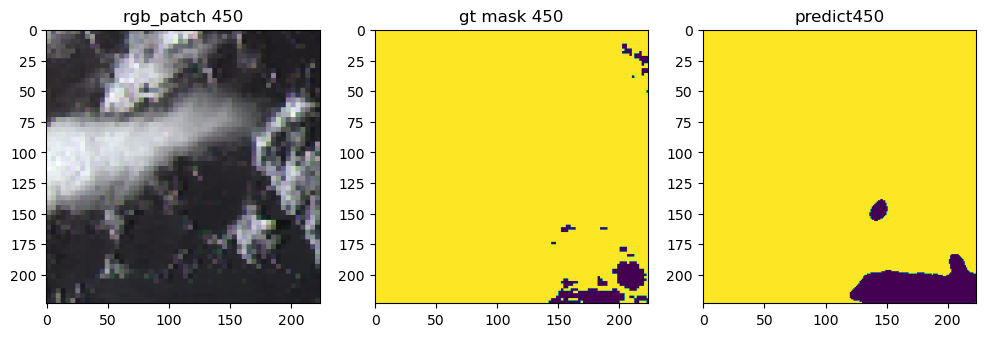

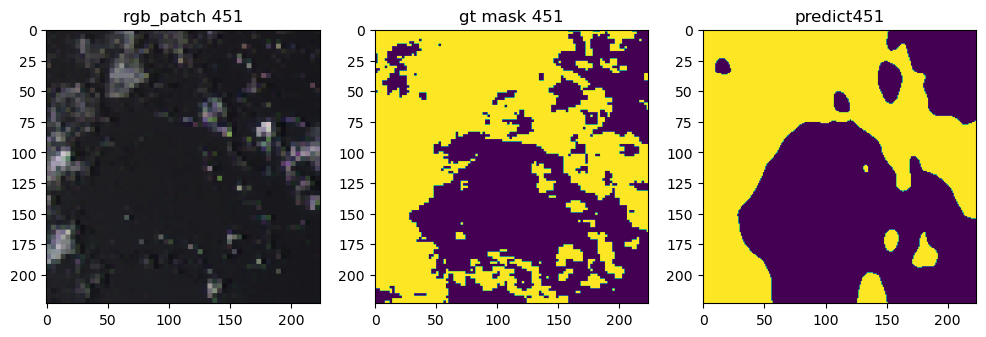

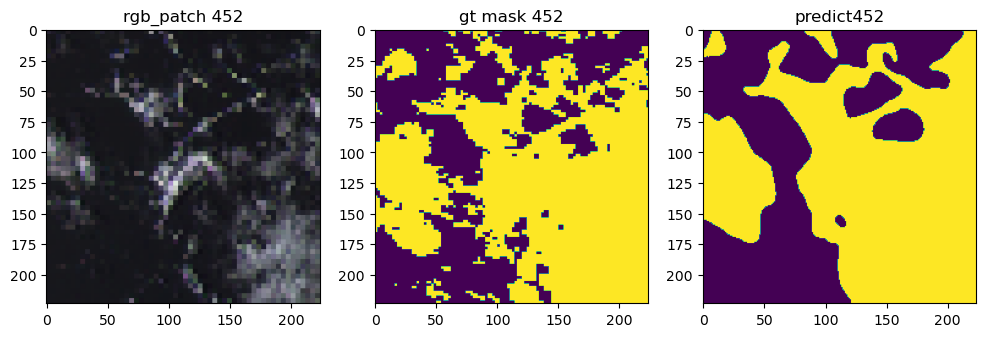

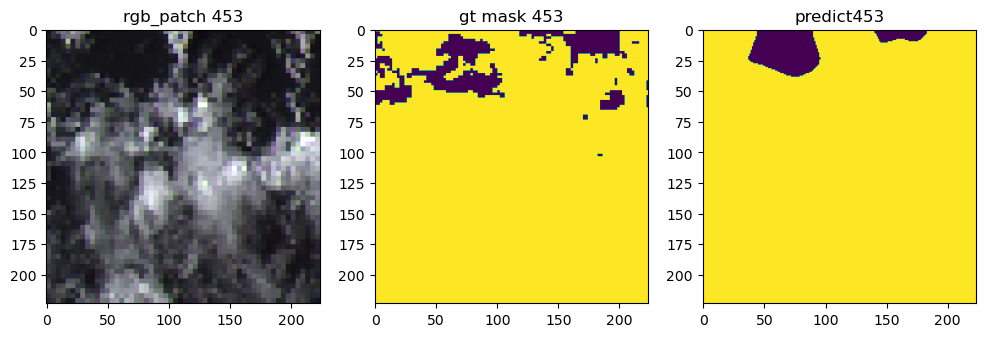

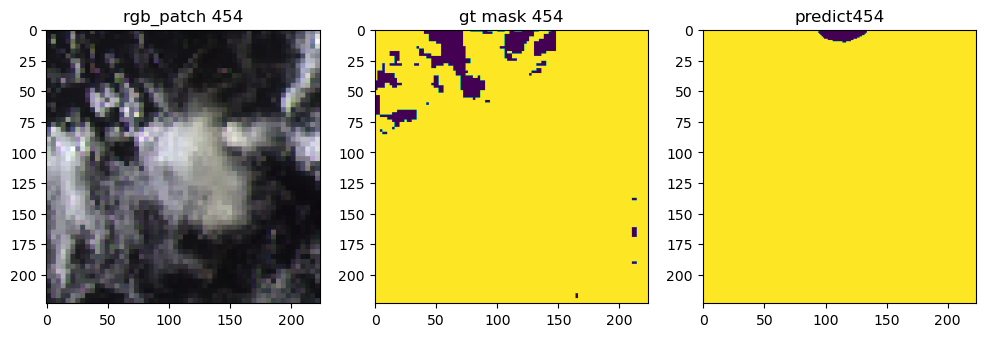

...

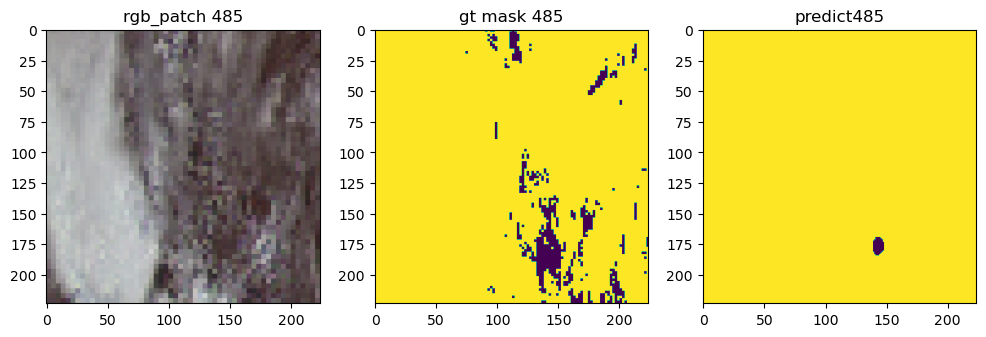

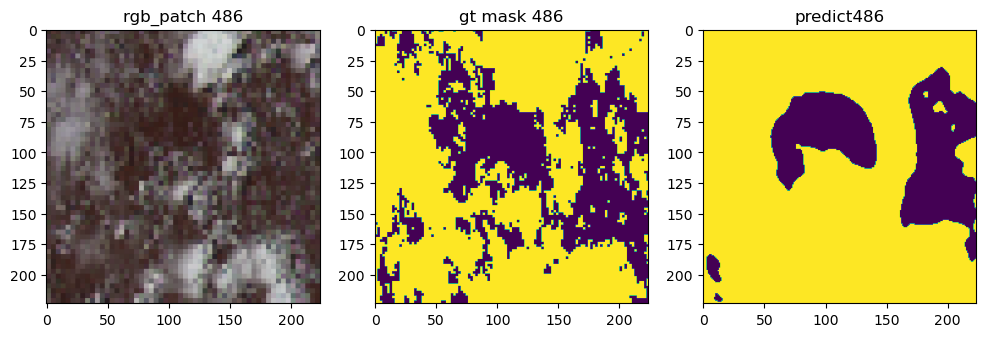

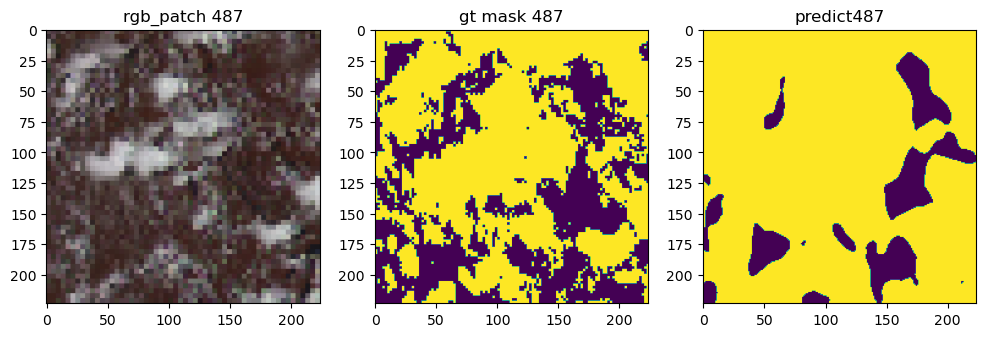

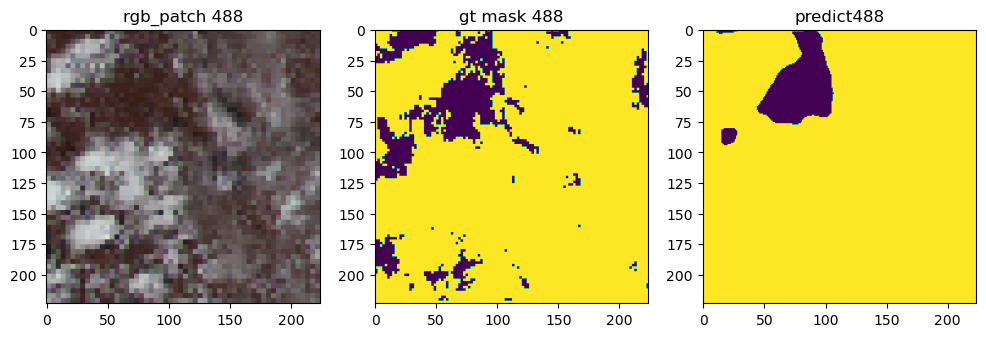

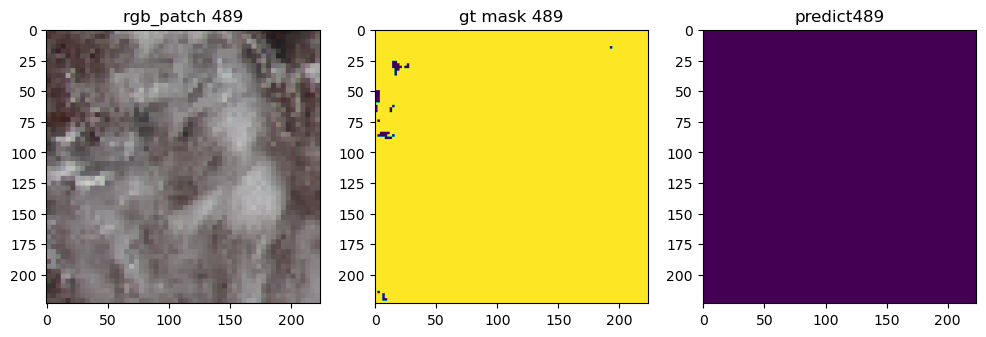

In [40]:
# model_path = r'H:/LEVIR_CS/models/DeepLab_efnet_b0_7_inputs_ep_47'
# model.load_state_dict(torch.load(model_path))
# model_segformer.eval()
def visualize_levir_pred(idx, model, dataset):
    x_rgb_lonlat, gt = dataset[idx]  # .to(device)
    x_rgb_lonlat, gt = x_rgb_lonlat.to(device), gt.to(device)
    fig, ax = plt.subplots(1, 3, figsize=(12, 4))
    cloud_mask = model(x_rgb_lonlat.unsqueeze(0))  #
    pred = predb_to_mask(cloud_mask).numpy()
    ax[0].imshow(open_sample_as_pil_no_norm(x_rgb_lonlat.cpu()))
    ax[1].imshow(open_mask_as_pil(gt.cpu()))
    ax[2].imshow(pred)
    ax[0].set_title("rgb_patch " + str(idx))
    ax[1].set_title("gt mask " + str(idx))
    ax[2].set_title("predict" + str(idx))
    plt.show()


def visualize_levir_pred_dl(model, dl, num_batches=1):
    # test_goes
    iterator = iter(dl)
    for j in range(num_batches):
        x, y = next(iterator)
        for i in range(len(x)):
            x_rgb_lonlat, gt = x[i], y[i]  # .to(device)
            x_rgb_lonlat, gt = x_rgb_lonlat.to(device), gt.to(device)
            fig, ax = plt.subplots(1, 3, figsize=(12, 4))
            cloud_mask = model(x_rgb_lonlat.unsqueeze(0))  #
            pred = predb_to_mask(cloud_mask).numpy()
            ax[0].imshow(open_sample_as_pil_no_norm(x_rgb_lonlat.cpu()))
            ax[1].imshow(open_mask_as_pil(gt.cpu()))
            ax[2].imshow(pred)
            ax[0].set_title("rgb_patch " + str(i))
            ax[1].set_title("gt mask " + str(i))
            ax[2].set_title("predict" + str(i))
            plt.show()


# model_path = r'H:/GOES_16_17_DATASET/models/finetunned_MAnet_Efficient_b1_12ch_inputs_ep_124'#r'H:/LEVIR_CS/models/U-Net_segformer_7_inputs_ep_47'
# model_segformer_overkill.load_state_dict(torch.load(model_path))
model_segformer_overkill.eval()
for idx in range(450, 490, 1):
    visualize_levir_pred(
        idx, model=uniform_model_overkill, dataset=Electro_ds_full_test
    )  # Levir_CS_Dataset_test)

# visualize_levir_pred_dl(model = model_segformer_overkill,dl = test_dl,num_batches =2)

**COMPARE RESULTS WITH THE PREVIOUS MODEL ON EPOCH 70**

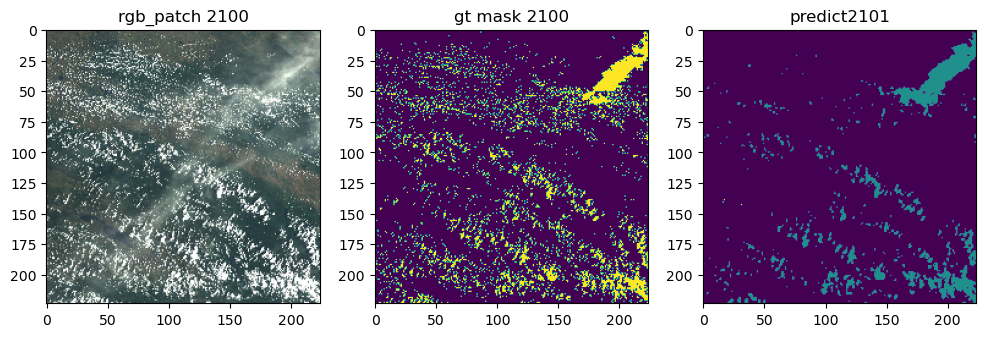

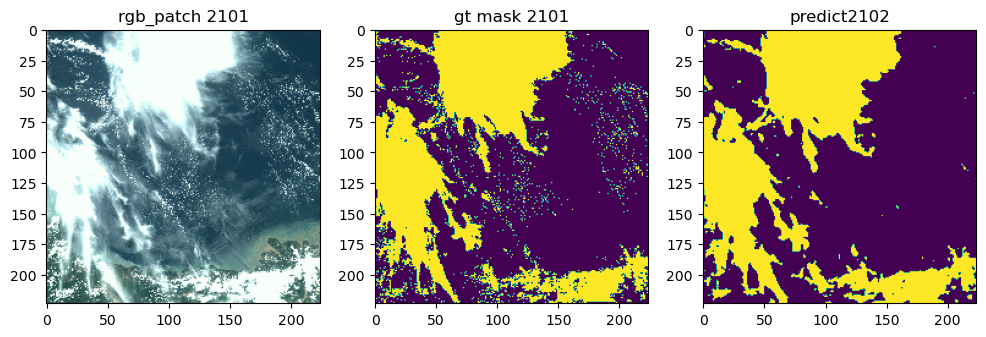

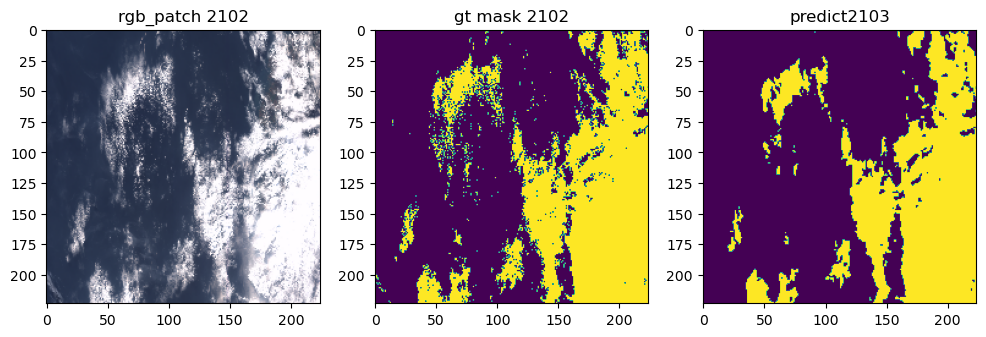

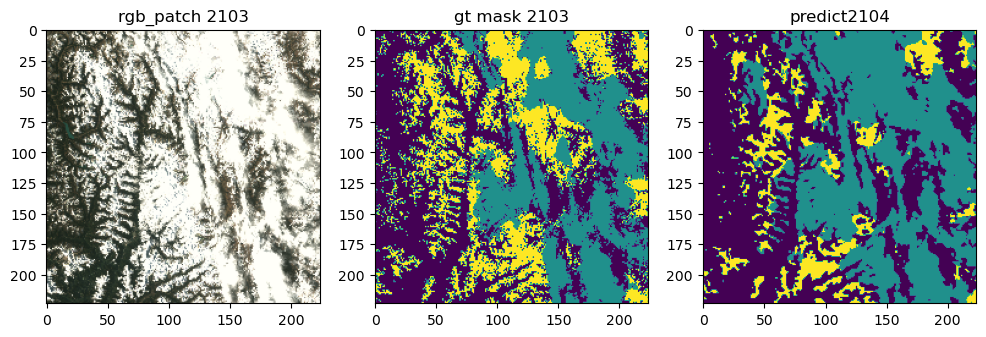

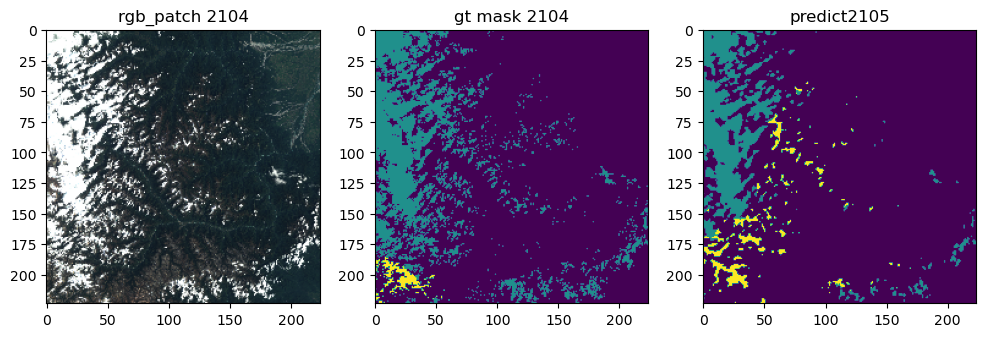

...

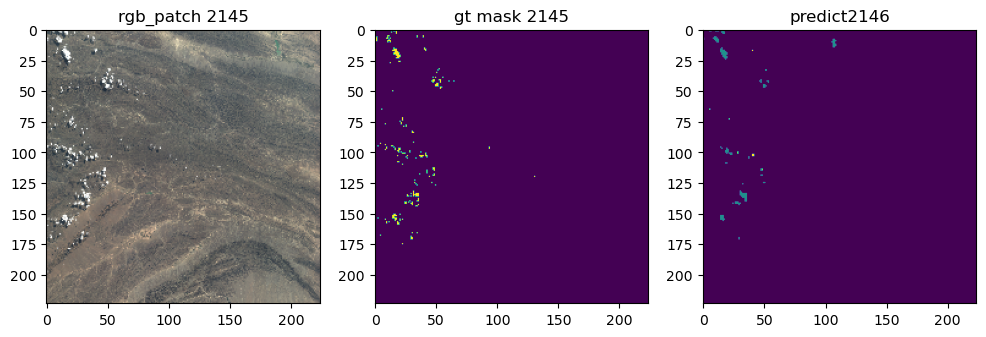

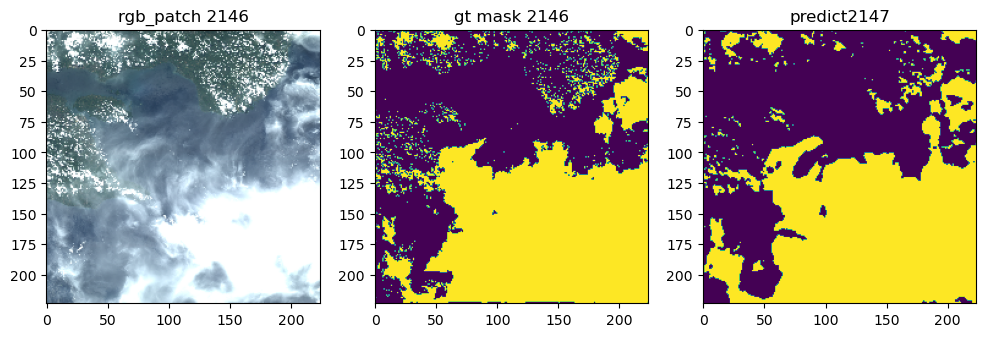

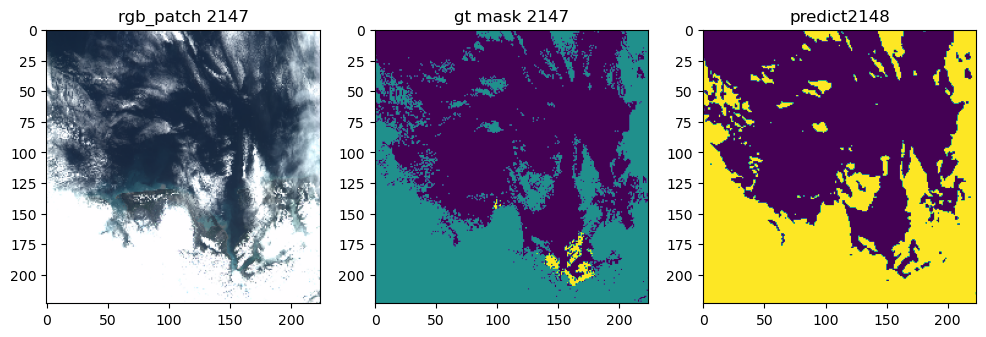

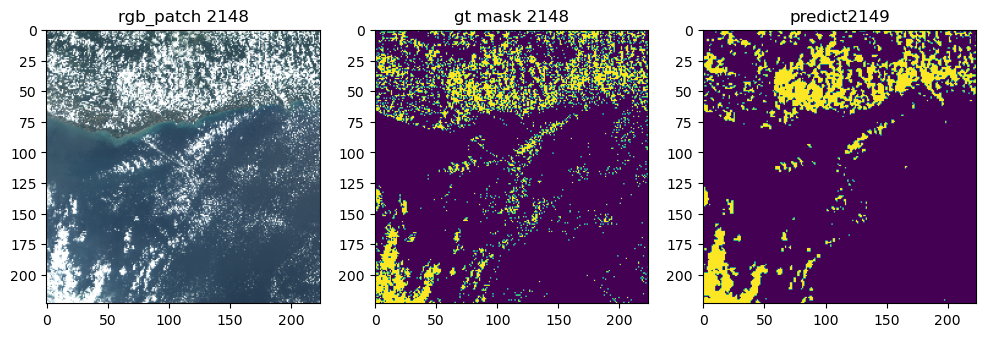

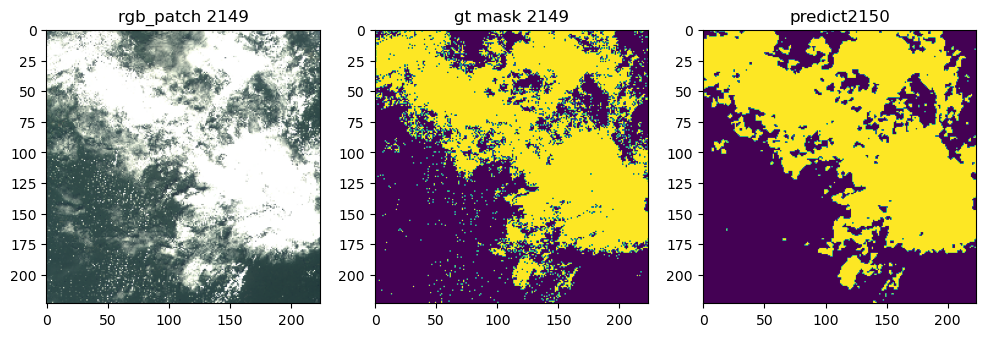

In [39]:
model_path = r"H:/LEVIR_CS/models/U-Net_efnet_b0_7_inputs_ep_78"
model.load_state_dict(torch.load(model_path))
model.eval()


def visualize_levir_pred(idx, model, dataset):
    x_rgb_lonlat, gt = dataset[idx]  # .to(device)
    x_rgb_lonlat, gt = x_rgb_lonlat.to(device), gt.to(device)
    fig, ax = plt.subplots(1, 3, figsize=(12, 4))
    cloud_mask = model(x_rgb_lonlat.unsqueeze(0))  #
    pred = predb_to_mask(cloud_mask).numpy()
    ax[0].imshow(open_sample_as_pil(x_rgb_lonlat.cpu()))
    ax[1].imshow(open_mask_as_pil(gt.cpu()))
    ax[2].imshow(pred)
    ax[0].set_title("rgb_patch " + str(idx))
    ax[1].set_title("gt mask " + str(idx))
    ax[2].set_title("predict" + str(idx + 1))
    plt.show()


for idx in range(2100, 2150, 1):
    visualize_levir_pred(idx, model=model, dataset=Levir_CS_Dataset)